<span style="font-size: 14pt">MIPT, Advanced ML, Autumn 2017</span>

<span style="font-size: 16pt"> HW #3: ARIMAX, Compositions

<span style="color:blue; font-size: 12pt">Alexey Romanenko </span>,
<span style="color:blue; font-size: 12pt; font-family: 'Verdana'">alexromsput@gmail.com</span>

**Дополнительный материал для выполнения дз**:
- Магнус Я.Р., Катышев П.К., Пересецкий А.А. Эконометрика. Начальный курс., глава 11
- Лукашин Ю.П. Адаптивные методы краткосрочного прогнозирования временных рядов. Финансы и статистика. 2003, главы 1,4,5,7.

**Оформление дз**: 
- Присылайте выполненное задание на почту ``ml.course.mipt@gmail.com``
- Укажите тему письма в следующем формате ``ML2017_Aut_fall <номер_группы> <фамилия>``, к примеру -- ``ML2017_Aut_fall 401 ivanov``
- Выполненное дз сохраните в файл ``<фамилия>_<группа>_task<номер>.ipnb``, к примеру -- ``ivanov_401_task1.ipnb``

**Вопросы**:
- Присылайте вопросы на почту ``ml.course.mipt@gmail.com``
- Укажите тему письма в следующем формате ``ML2017_Aut_fall Question <Содержание вопроса>``

<span style="color:red; font-size: 14pt;"> DEADLINE: 10 October 2017 23:59:59 </span>

--------
- **PS1**: Мы используем автоматические фильтры, и просто не найдем ваше дз, если вы не аккуратно его подпишите.
- **PS2**: Напоминаем, что дедлайны жесткие, письма пришедшие после автоматически удаляются =( чтобы соблазна не было 


<h1 align="center">Check Questions (20%)</h1> 

Ответе на вопросы своими словами (загугленный материал надо пересказать), ответ обоснуйте (напишите и ОБЪЯСНИТЕ формулки если потребуется), если не выходит, то вернитесь к лекции дополнительным материалам:

**Вопрос 1** Опишите ситуацию (аргументированно), в котором композиция Adaptive Selection будет прогнозировать хуже, чем лучший из базовых алгоритмов.

<Ответ>

**Вопрос 2**  Опишите ситуацию (аргументированно), в котором композиция Adaptive Composition будет прогнозировать хуже, чем лучший из базовых алгоритмов.

<Ответ>

**Вопрос 3** Что значит смешиваемость (mixability) игры (в теории агрегирующего алгоритма)?

<Ответ>

**Вопрос 4**: Верно ли, что для смешиваемых игр процесс потерь любой композиции (любого алгоритма) будет расти со временем (с ростом $t$) не быстрее, чем процесс потерь лучшего из базовых алгоритмов? Если нет - приведит пример, когда это не так.

### $$ \mathrm{Loss}_{Composition}(T)\leq \inf\limits_{BA} \mathrm{Loss}_{BA}(T)+C$$

<Ответ>

<h1 align="center">2. Contest: electricity comsumption contest (80%)</h1>
Take part in <a href='https://www.kaggle.com/t/de102b28cae74e6ead7492ff12efbc63'>contest</a>.
<span style='color:red'> You need to send the final code that is used for building forecast.</span>

# Идея решения

1) Берем, добавляем к фичам данные за последние 30 дней

2) Делаем 30 моделей (для предсказаний на разное количество дней вперед)

3) За модель я взял catboost с глубиной деревьев 7

4) Поставил линейную зависимость на sample_weight

5) Profit!

In [51]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec
from sklearn.model_selection import TimeSeriesSplit
from catboost import CatBoostRegressor
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
# final_forecast = ???

## Читаю данные

In [40]:
data = pd.read_csv('train.csv')
print(data.columns, data.index)

Index(['ID', 'Date', 'tsID', 'ACTUAL', 'Temp', 'Saturday', 'Sunday'], dtype='object') RangeIndex(start=0, stop=21207, step=1)


In [41]:
ts_data = [pd.DataFrame(columns=data.columns) for i in range(data['tsID'].max() + 1)]

In [42]:
baseline = np.array([0.023977930918917909, 
                     0.029571846905564719, 
                     0.029885648529839843,
                     0.031907743233767258, 
                     0.031433789469107666, 
                     0.033617828479616779, 
                     0.033960294796827502, 
                     0.042562038341047534, 
                     0.045526932243324686, 
                     0.048084252472094552, 
                     0.046347073151777093, 
                     0.04534490113614139, 
                     0.047903948038534185, 
                     0.048963139888738766, 
                     0.053337510357388151, 
                     0.05715703300832771, 
                     0.055721858664855226, 
                     0.053973204422873414, 
                     0.055121613109561686, 
                     0.052226563614790715, 
                     0.052449147340960671, 
                     0.059099026607389395, 
                     0.058708836766757186, 
                     0.060598554407239928, 
                     0.058269071480513607, 
                     0.056156105090419697, 
                     0.05665816905260028, 
                     0.053537777962977179, 
                     0.059394888870847769, 
                     0.060373528575970829, 
                     0.054903722021969706])

In [43]:
for i in data.index:
    if i % 1000 == 0:
        print(i)
    ts_data[data.iloc[i]['tsID']].loc[len(ts_data[data.iloc[i]['tsID']])] = data.iloc[i]

0
1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000


In [44]:
# Quality functions
def qualitySSE(x,y):
    # Sum squared error
    # x,y - pandas structures
    # x - real values
    # y - forecasts
    return ((x-y)**2).sum(), (x-y)**2

def qualityMSE(x,y):
    # Mean squared error
    # x,y - pandas structures
    # x - real values
    # y - forecasts
    return ((x-y)**2).mean() , (x-y)**2

def qualityRMSE(x,y):
    # Root mean squared error
    # x,y - pandas structures
    # x - real values
    # y - forecasts
    return (((x-y)**2).mean())**(0.5) , (x-y)**2

def qualityMAE(x,y):
    # Mean absolute error
    # x,y - pandas structures
    # x - real values
    # y - forecasts
    return (x-y).absolute().mean(), (x-y).absolute()

def qualityMAPE(x,y):
    # Mean absolute percentage error
    # x,y - pandas structures
    # x - real values
    # y - forecasts
    qlt = (np.absolute(x-y)/x)
    return qlt.mean() , np.absolute(x-y)

def qualityMACAPE(x,y):
    # Mean average corrected absolute percentage error
    # x,y - pandas structures
    # x - real values
    # y - forecasts
    qlt = (2*np.absolute(x-y)/(x+y))
    return qlt.mean() , np.absolute(x-y)

def qualityMedianAE(x,y):
    # Median absolute error
    # x,y - pandas structures
    # x - real values
    # y - forecasts
    return ((x-y).absolute()).median(), (x-y).absolute()

## Самописная кросс-валидация

In [54]:
NUMBER_OF_PREV_DAYS = 30

def plot_ts(ts):
    fig = plt.figure(figsize=(20,10))
    gs = gridspec.GridSpec(1, 2)
    cols = ['ACTUAL', 'Temp']
    for i in range(1):
        for j in range(2):
            fig.add_subplot(gs[i,j])
            ts.iloc[::7][cols[j]].plot()
    plt.show()
    
def calc_quality(model, train_x, train_y, test_x, test_y, plot_flag, curr_pow):
    model.fit(train_x, train_y, sample_weight=(1+np.arange(len(train_x)))**curr_pow)
    predicted = model.predict(test_x)
    result = (qualityMAPE(np.array(test_y), np.array(predicted))[0])
    if plot_flag:
        fig = plt.figure(figsize=(20, 5))
        plt.plot(np.arange(len(test_y)), test_y, color='red')
        plt.plot(np.arange(len(test_y)), predicted, color='blue')
        plt.show()
    return result

def cross_validation(models, factors, targets, curr_pow):
    global baseline
    N_SPLITS = 4
    tscv = TimeSeriesSplit(n_splits=N_SPLITS)
    for i in range(len(models)):
        scores = []
        counter = N_SPLITS
        for train, test in tscv.split(factors[i]):
            counter -= 1
            scores.append(calc_quality(models[i], factors[i].iloc[train], targets[i][train], factors[i].iloc[test], targets[i][test], (counter == 0), curr_pow))
        print(i, ': ', scores, 'delta = ', baseline[i] - scores[-1])
        
def normalize_data(data):
    for col in data.columns:
        data[col] -= data[col].min()
        data[col] /= data[col].max()
    return data

## Функция создания дополнительных фич

+ \+ 30 последних дней

- \- информация о дате/id

In [ ]:
def create_factors_targets(data):
    factors = data.copy(deep=True)
    
#     factors['Date'] = pd.to_datetime(factors['Date'], format='%d.%m.%Y').astype(int)
#     factors['Date'] -= factors['Date'].min()
#     factors['Date'] /= factors['Date'].max()
    factors['Delta'] = np.zeros(len(factors.index))
#     factors['TodayTemp'] = factors['Temp']
#     factors['TodaySaturday'] = factors['Saturday']
#     factors['TodaySunday'] = factors['Sunday']
    factors.drop(labels=['tsID', 'ID', 'Date'], inplace=True, axis=1)
    factors = factors[NUMBER_OF_PREV_DAYS:]
    for i in range(1, NUMBER_OF_PREV_DAYS):
        factors['Day' + str(i)] = np.roll(np.array(factors['ACTUAL']), i)
    delta_factors = [0 for i in range(31)]
    targets = [0 for i in range(31)]
    actual = np.array(factors['ACTUAL'])
    temp = np.array(factors['Temp'])
    saturday = np.array(factors['Saturday'])
    sunday = np.array(factors['Sunday'])
    for i in range(0, len(delta_factors)):
        delta_factors[i] = factors.copy(deep=True)
        delta_factors[i]['Delta'] = (np.ones(len(actual)) * i)
        delta_factors[i]['ACTUAL'] = np.roll(actual, len(actual) - i)
#         delta_factors[i]['TodayTemp'] = np.roll(temp, len(temp) - i)
#         delta_factors[i]['TodaySaturday'] = np.roll(saturday, len(saturday) - i)
#         delta_factors[i]['TodaySunday'] = np.roll(sunday, len(sunday) - i)
        delta_factors[i] = delta_factors[i].iloc[2*NUMBER_OF_PREV_DAYS:-max(60, 2*NUMBER_OF_PREV_DAYS)].astype(float)
        targets[i] = np.array(delta_factors[i]['ACTUAL'])
        delta_factors[i].drop(labels=['ACTUAL'], inplace=True, axis=1)
        delta_factors[i] = delta_factors[i].fillna(0)
#     new_factors = factors.iloc[60:-60].copy(deep=True)
#     for i in delta_factors[1:]:
#         new_factors = new_factors.append(i.iloc[60:-60], ignore_index=True) 
#     targets = np.array(new_factors['ACTUAL'])
#     new_factors.drop(labels=['ACTUAL'], inplace=True, axis=1)
    return delta_factors, targets

In [216]:
factors, targets = create_factors_targets(ts_data[11])
factors[0]

,Date,Temp,Saturday,Sunday,Delta,Day1,Day2,Day3,Day4,Day5,...,Day20,Day21,Day22,Day23,Day24,Day25,Day26,Day27,Day28,Day29
90,0.084586,14.5,0.0,0.0,0.0,371577.0,372562.0,374852.0,335340.0,362663.0,...,400887.0,400871.0,401160.0,398275.0,371202.0,370614.0,378410.0,395795.0,401416.0,401007.0
91,0.085526,20.0,0.0,0.0,0.0,371205.0,371577.0,372562.0,374852.0,335340.0,...,378912.0,400887.0,400871.0,401160.0,398275.0,371202.0,370614.0,378410.0,395795.0,401416.0
92,0.086466,0.0,1.0,0.0,0.0,368410.0,371205.0,371577.0,372562.0,374852.0,...,371367.0,378912.0,400887.0,400871.0,401160.0,398275.0,371202.0,370614.0,378410.0,395795.0
93,0.087406,-8.1,0.0,1.0,0.0,347600.0,368410.0,371205.0,371577.0,372562.0,...,398883.0,371367.0,378912.0,400887.0,400871.0,401160.0,398275.0,371202.0,370614.0,378410.0
94,0.088346,-10.3,0.0,0.0,0.0,335647.0,347600.0,368410.0,371205.0,371577.0,...,399465.0,398883.0,371367.0,378912.0,400887.0,400871.0,401160.0,398275.0,371202.0,370614.0
95,0.089286,-16.4,0.0,0.0,0.0,364013.0,335647.0,347600.0,368410.0,371205.0,...,401715.0,399465.0,398883.0,371367.0,378912.0,400887.0,400871.0,401160.0,398275.0,371202.0
96,0.090226,-23.4,0.0,0.0,0.0,358091.0,364013.0,335647.0,347600.0,368410.0,...,399831.0,401715.0,399465.0,398883.0,371367.0,378912.0,400887.0,400871.0,401160.0,398275.0
97,0.091165,-23.3,0.0,0.0,0.0,351579.0,358091.0,364013.0,335647.0,347600.0,...,397918.0,399831.0,401715.0,399465.0,398883.0,371367.0,378912.0,400887.0,400871.0,401160.0
98,0.092105,-20.5,0.0,0.0,0.0,350436.0,351579.0,358091.0,364013.0,335647.0,...,378665.0,397918.0,399831.0,401715.0,399465.0,398883.0,371367.0,378912.0,400887.0,400871.0
99,0.093045,-18.4,1.0,0.0,0.0,348105.0,350436.0,351579.0,358091.0,364013.0,...,369118.0,378665.0,397918.0,399831.0,401715.0,399465.0,398883.0,371367.0,378912.0,400887.0


In [109]:
factors.iloc[factors.index[factors['Delta'] == 3]]
len(targets)

28365

In [46]:
def check_ts(models, number, curr_pow):
    print('----------------------------')
    print('ts id = ', number)
    global ts_data
    factors, targets = create_factors_targets(ts_data[number])
    if len(factors[0]) > 0:
        cross_validation(models, factors, targets, curr_pow)
    else:
        print('empty data')

----------------------------
ts id =  0
empty data
----------------------------
ts id =  1


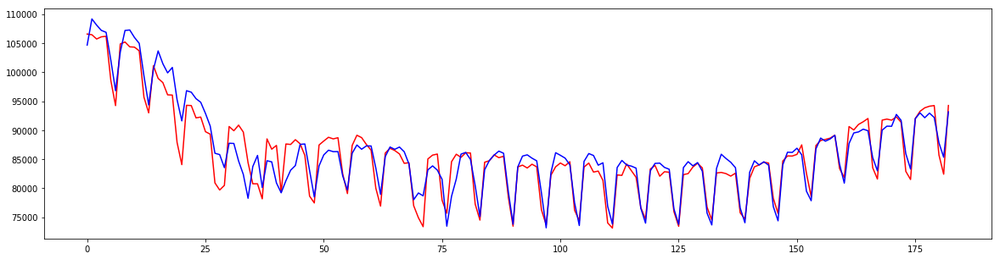

0 :  [0.3350343660473985, 0.033381018015247517, 0.039009422023457356, 0.021763280408992842] delta =  0.00221465050993


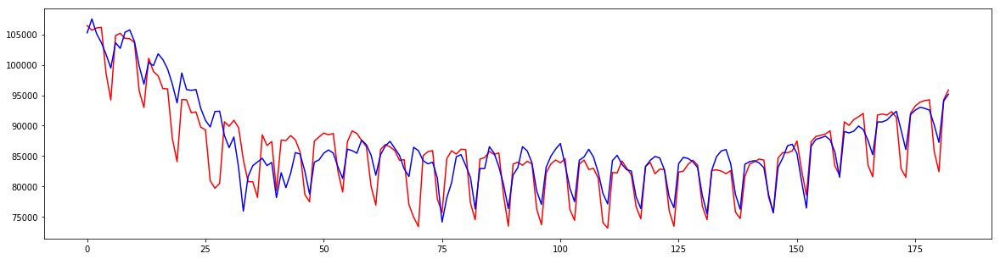

1 :  [0.30007366538788144, 0.047483084459209533, 0.04545479845584155, 0.029545525383637326] delta =  2.63215219274e-05


KeyboardInterrupt: 

In [55]:
models = [CatBoostRegressor(depth=7) for i in range(31)]
for i in range(15):
    check_ts(models, i, 1)

In [16]:
models = [CatBoostRegressor(depth=7) for i in range(30)]
for i in range(15):
    check_ts(models, i)

----------------------------
ts id =  0
empty data
----------------------------
ts id =  1
0 :  [0.27612912498010184, 0.033238180053685777, 0.040327475584082347, 0.023977930918917909]
1 :  [0.32564304153187013, 0.037849006550672255, 0.041261556533644758, 0.029571846905564719]
2 :  [0.34307710366235639, 0.043197512065962909, 0.052737114295982233, 0.029885648529839843]
3 :  [0.30914337124524605, 0.043347345425132799, 0.046156114557368441, 0.031907743233767258]
4 :  [0.32551767908040813, 0.041126441538273016, 0.053410758727464779, 0.031433789469107666]
5 :  [0.30905857597573011, 0.041471799335304226, 0.056539959800046495, 0.033617828479616779]
6 :  [0.32482250475431063, 0.04808355954910238, 0.06125813371659998, 0.033960294796827502]
7 :  [0.30311546199931366, 0.051390600559855726, 0.062739170844443637, 0.042562038341047534]
8 :  [0.29009444494401876, 0.055310414940147504, 0.052069481790319838, 0.045526932243324686]
9 :  [0.29308784246675496, 0.059331850397568518, 0.054454561276236609, 0.0

KeyboardInterrupt: 

In [27]:
models = [CatBoostRegressor(depth=7) for i in range(31)]
for i in range(15):
    check_ts(models, i, 1.1)

----------------------------
ts id =  0
empty data
----------------------------
ts id =  1
0 :  [0.30812314714913047, 0.03547786037563451, 0.033628037328493295, 0.021819603814831116] delta =  0.00215832710409
1 :  [0.28866369774598288, 0.041175307199432236, 0.039110055046119176, 0.028978184675238636] delta =  0.000593662230326
2 :  [0.33718580642012969, 0.045371513141164742, 0.053864099909698322, 0.03209890651379646] delta =  -0.00221325798396
3 :  [0.36668035266835292, 0.042171822817281754, 0.052399300286289745, 0.031445333697239508] delta =  0.000462409536528
4 :  [0.31545622613489677, 0.047364973649142883, 0.048135788533638042, 0.030233241447853935] delta =  0.00120054802125
5 :  [0.34597852140317775, 0.040962877450140031, 0.054979975631627445, 0.032492896808453305] delta =  0.00112493167116
6 :  [0.31053923046685677, 0.044042183621081012, 0.052162744285433292, 0.029967001466651148] delta =  0.00399329333018
7 :  [0.32702312314152371, 0.052234178058559864, 0.059527859697072499, 0.04

KeyboardInterrupt: 

In [47]:
models = [RandomForestRegressor(n_estimators=500, criterion='mse', n_jobs=10) for i in range(31)]
# models = [LinearRegression(n_jobs=10) for i in range(31)]
for i in range(15):
    check_ts(models, i, 1.1)

----------------------------
ts id =  0
empty data
----------------------------
ts id =  1
0 :  [0.13534865652032302, 0.024580947562215016, 0.026814456011428865, 0.023396129040201] delta =  0.000581801878717
1 :  [0.14640791692562125, 0.028808748831531217, 0.040351454099538719, 0.02839212740267914] delta =  0.00117971950289
2 :  [0.15154595022904768, 0.029276886748944478, 0.043583966320476911, 0.029189547994564448] delta =  0.000696100535275
3 :  [0.15119984364391767, 0.028870355364787187, 0.044962949138703821, 0.030144136349132787] delta =  0.00176360688463
4 :  [0.15035190248714073, 0.028690236914554319, 0.045955942542284758, 0.031491685214974439] delta =  -5.78957458668e-05
5 :  [0.15483793883591657, 0.028280743937008947, 0.04588143858252007, 0.032607460499391228] delta =  0.00101036798023
6 :  [0.15514970420536953, 0.028023618879124166, 0.047092217766379146, 0.033593177366689549] delta =  0.000367117430138
7 :  [0.15549484259947013, 0.036507475157668293, 0.046772472999310144, 0.044

KeyboardInterrupt: 

----------------------------
ts id =  0
empty data
----------------------------
ts id =  1


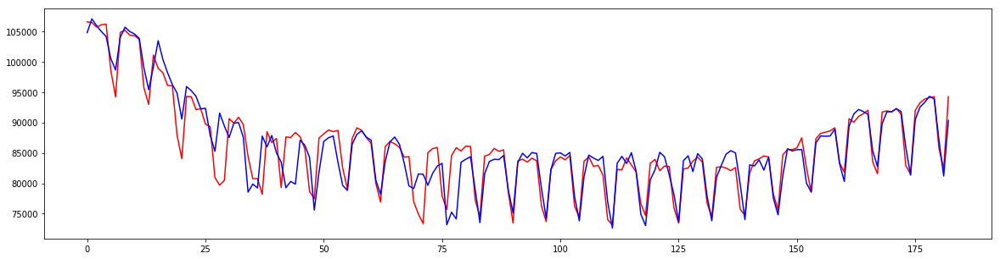

0 :  [0.13246053168287406, 0.022460936989100115, 0.028349442664395333, 0.023735000171492666]


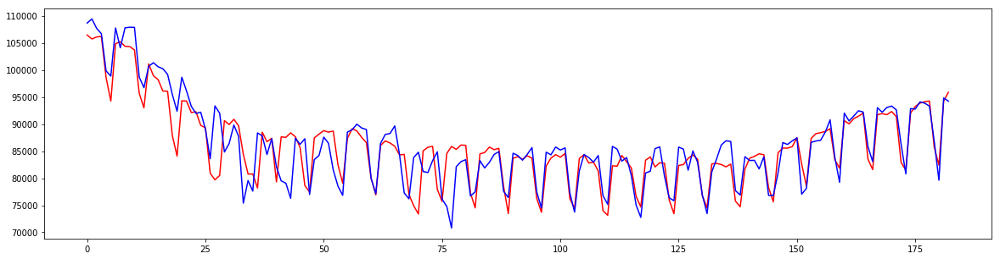

1 :  [0.14923229473697036, 0.02739572977339684, 0.040978619581287637, 0.029582277664966381]


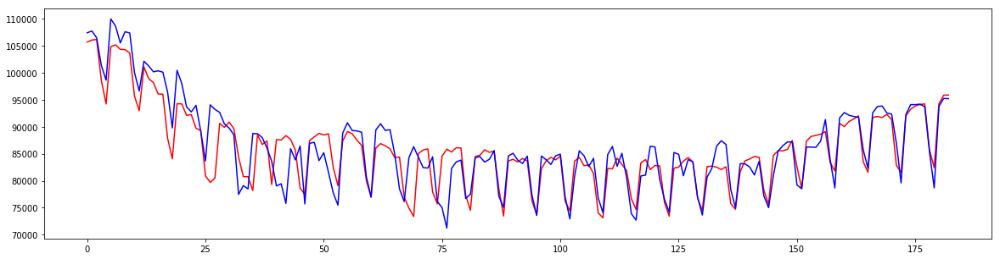

2 :  [0.15359580607004028, 0.02852774302403132, 0.044066948906654919, 0.030104447291405125]


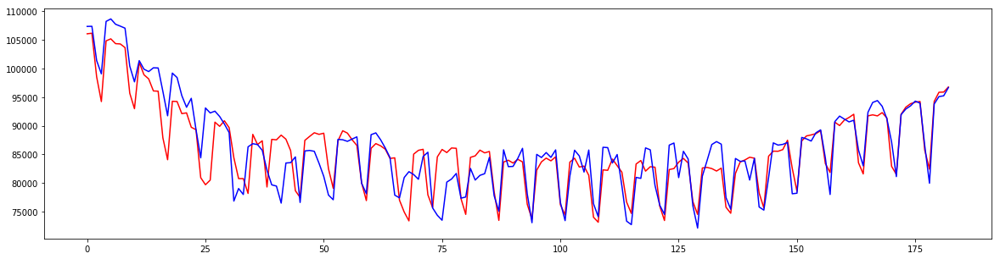

3 :  [0.15045444052103518, 0.028281202659251974, 0.045666762745867708, 0.030532539123382139]


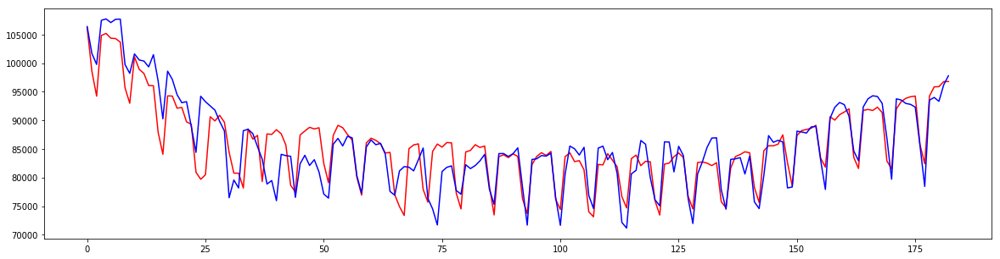

4 :  [0.15182128898244288, 0.027604506732914834, 0.04618375019416214, 0.031543043718269645]


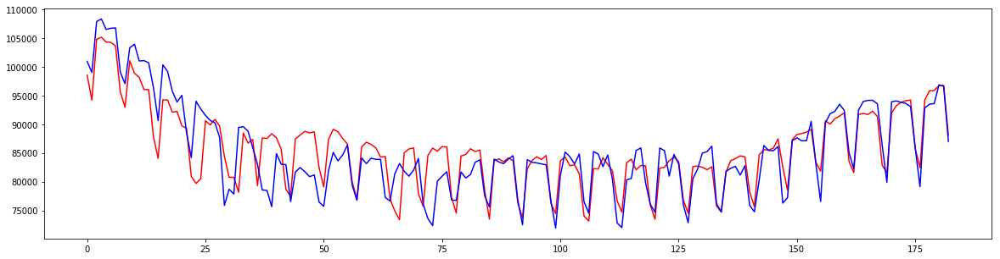

5 :  [0.15280257372367953, 0.027463879236543108, 0.046949717679689758, 0.033737166601640736]


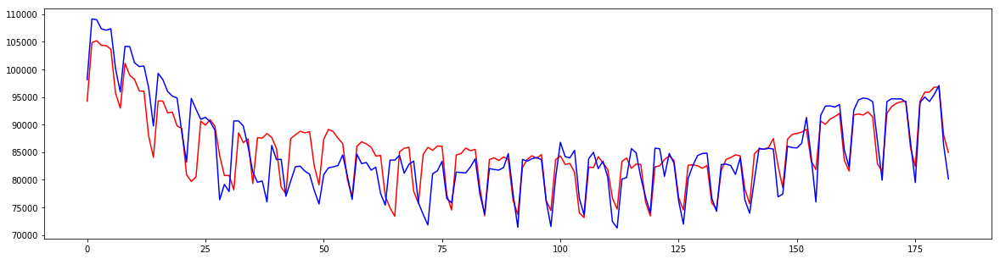

6 :  [0.15159847301594057, 0.027861645733859183, 0.046469468884792343, 0.035347230470080253]


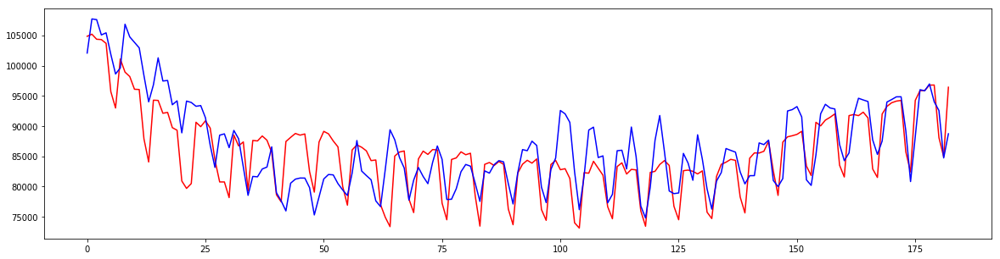

7 :  [0.15597336972025821, 0.03686387442310668, 0.044894474687959686, 0.043853276140596385]


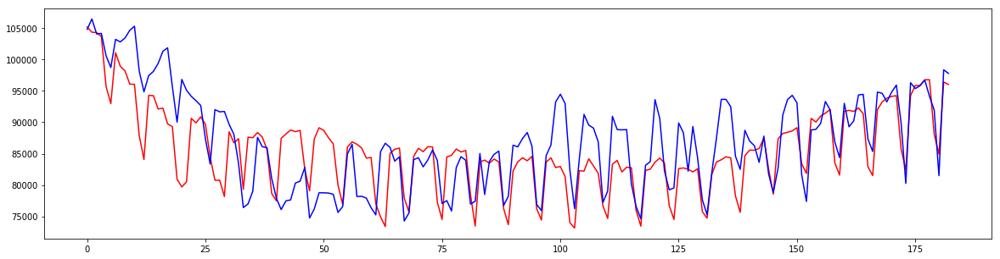

8 :  [0.15255715166707229, 0.039273019575745083, 0.047733349724247288, 0.050626941274720408]


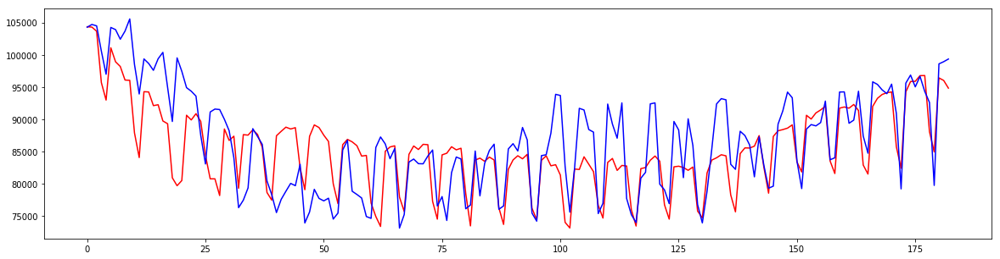

9 :  [0.14873315220886729, 0.037701041218456369, 0.048015907416986851, 0.051563717971814721]


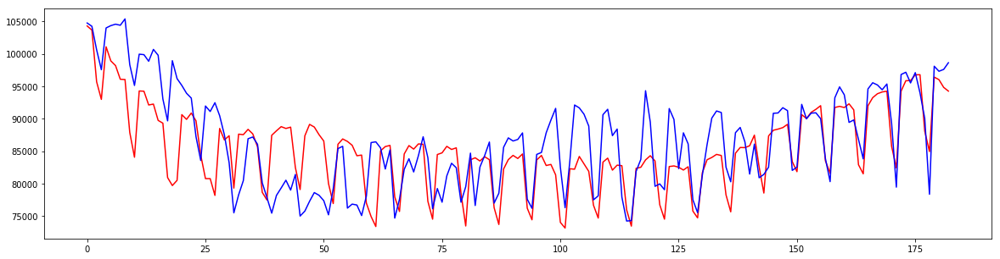

10 :  [0.15153393191056336, 0.040986928617442256, 0.047640233536567954, 0.051361671581734193]


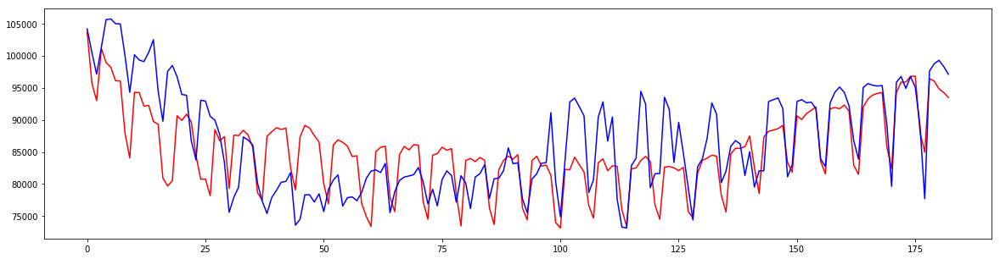

11 :  [0.14993386569486661, 0.04076195625691844, 0.046541316129089509, 0.054257659980956725]


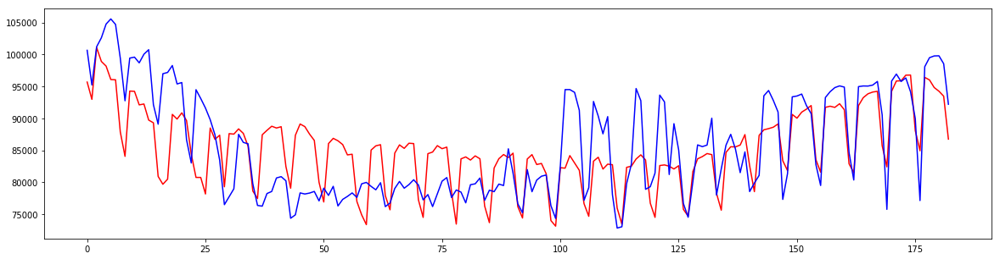

12 :  [0.1512670377693055, 0.041454628773185516, 0.046333761906679212, 0.055860285033342283]


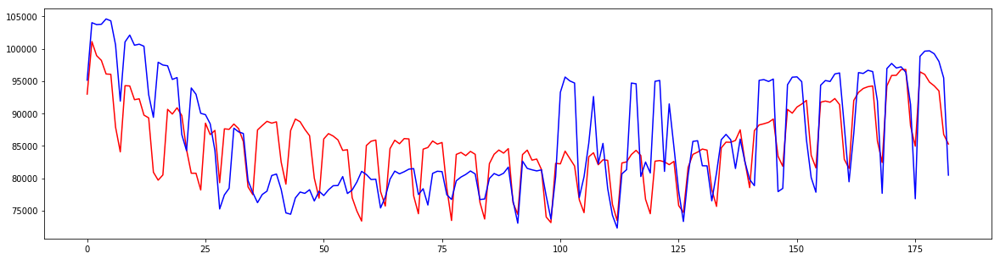

13 :  [0.1468763695520465, 0.041813991967219709, 0.045804778707917986, 0.05755955960431642]


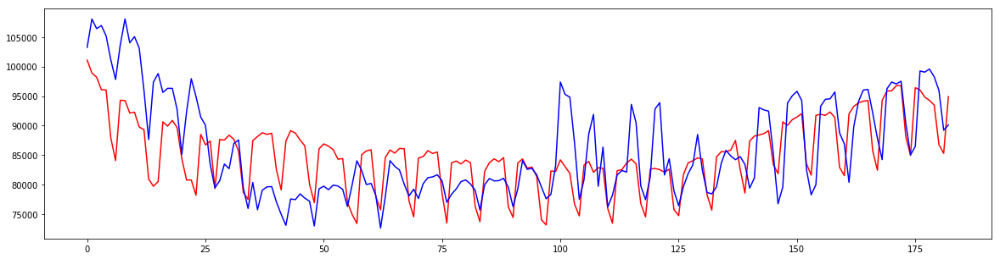

14 :  [0.15319137612619538, 0.04411042514181264, 0.049464928014526281, 0.060222061147385937]


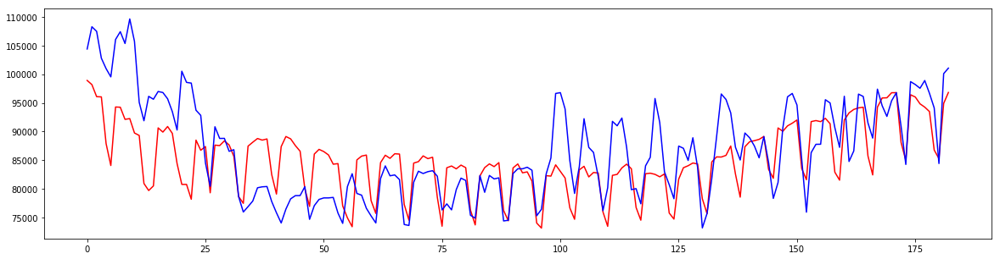

15 :  [0.15833705489404479, 0.046412924106573501, 0.049712399122653468, 0.061305546322085076]


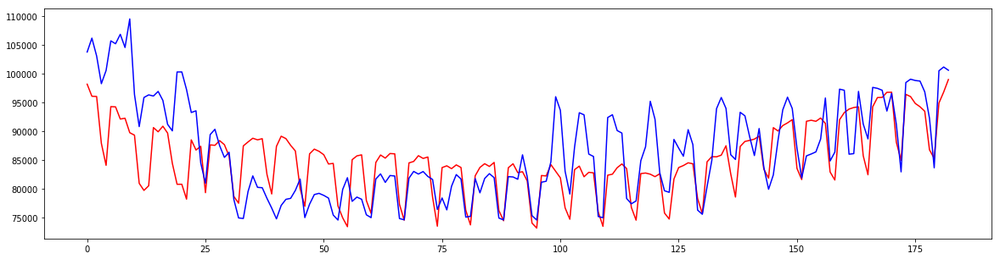

16 :  [0.16109068584822991, 0.047370537751962927, 0.05088654836421698, 0.059706201020682637]


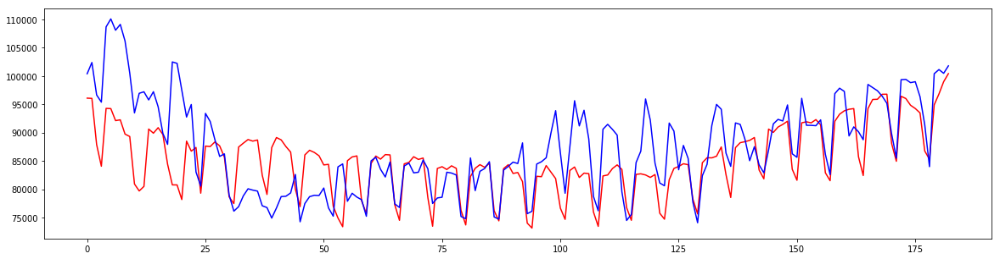

17 :  [0.1585962659531196, 0.048721028998661077, 0.049669947851965879, 0.057634244265533596]


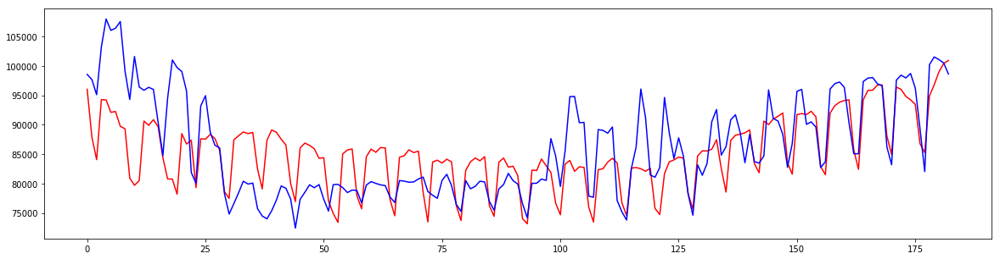

18 :  [0.1610645561190332, 0.044207453772667889, 0.049498005444733727, 0.058568567591823134]


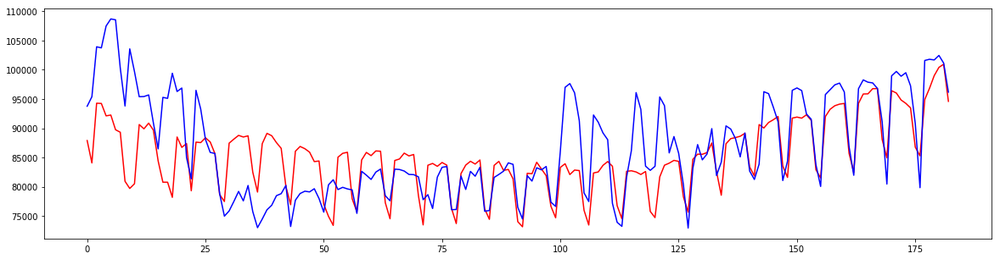

19 :  [0.1586543876511905, 0.04088037205075936, 0.04921801347863277, 0.056570288801253837]


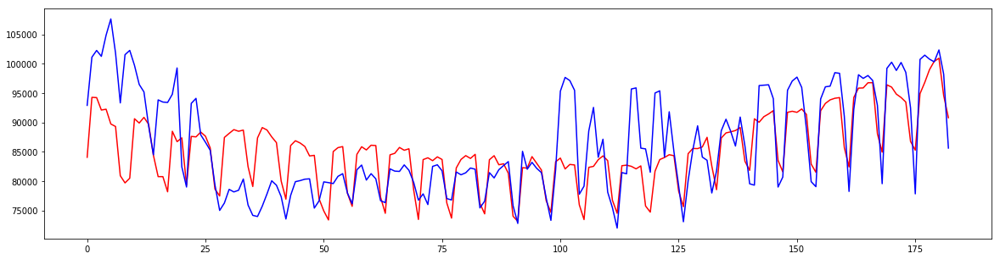

20 :  [0.16680891259327746, 0.041529041156950157, 0.047981198420811354, 0.057482714753386004]


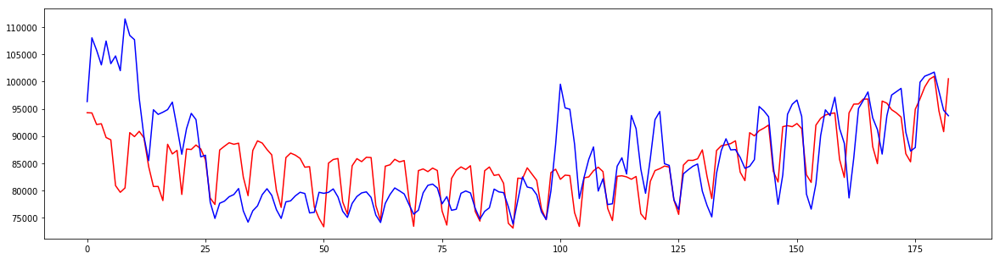

21 :  [0.1695648585129319, 0.048264621727659968, 0.05337405178319516, 0.063983570616376981]


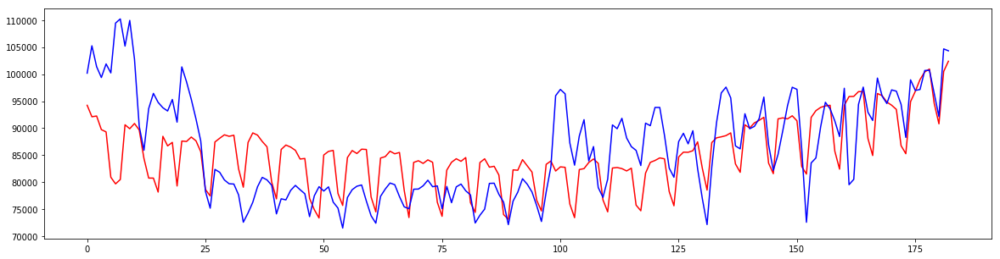

22 :  [0.17232904456558568, 0.050186487931681172, 0.058237639326519368, 0.071447025446066653]


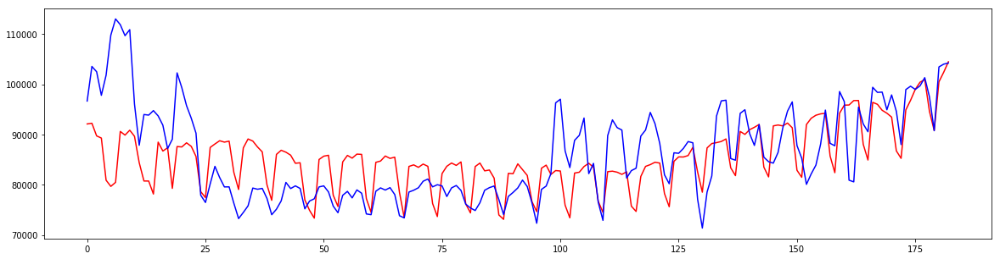

23 :  [0.18299450272805845, 0.054439004684986261, 0.057712432097322394, 0.069712082390247843]


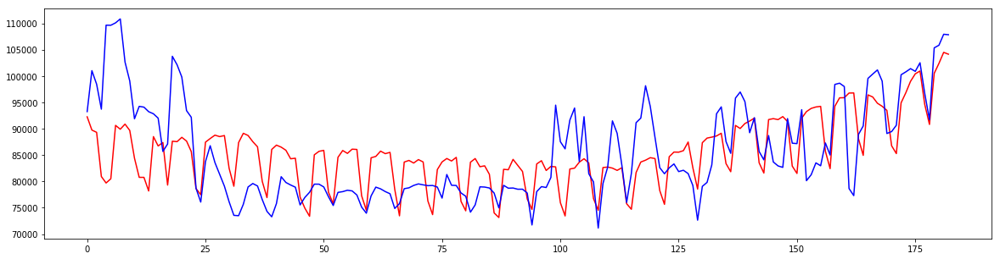

24 :  [0.18455279371463015, 0.056250663483435104, 0.060076612252167989, 0.071642705698050327]


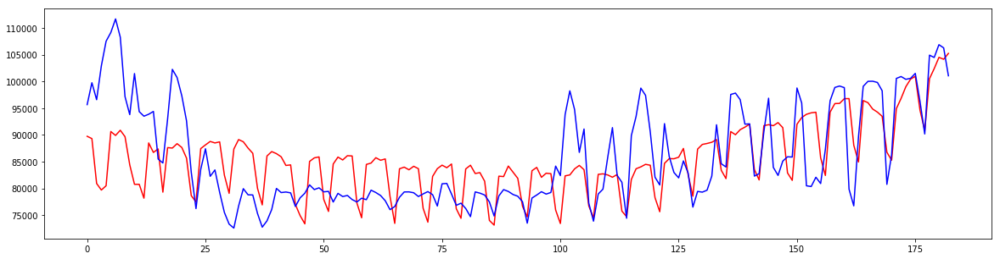

25 :  [0.18210941094946032, 0.055712279995334534, 0.058574781254676959, 0.070268568237475848]


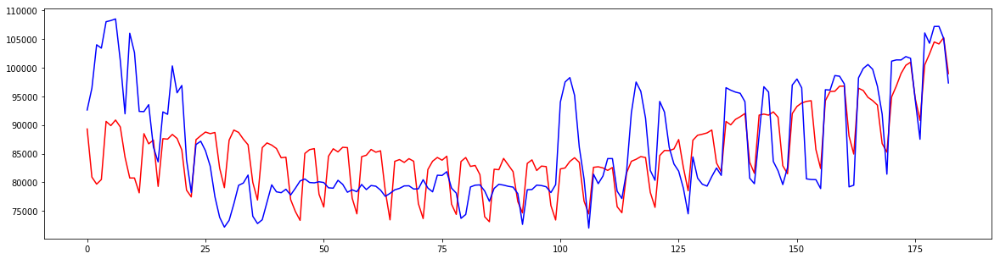

26 :  [0.18314995563809394, 0.052150698680544241, 0.05488750650420561, 0.067199209668750939]


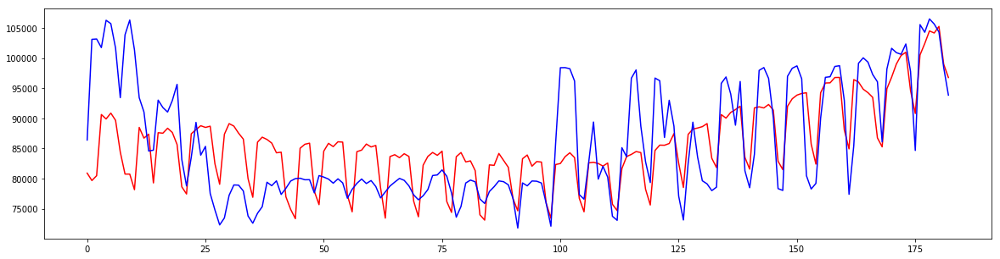

27 :  [0.18989298919464642, 0.056506038761204691, 0.054403606308998903, 0.065664558745477192]


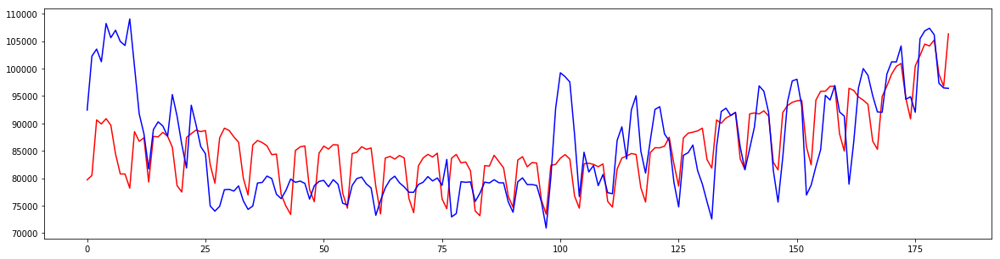

28 :  [0.19730911728449868, 0.058114446593861717, 0.058317646625727471, 0.065922038764051061]


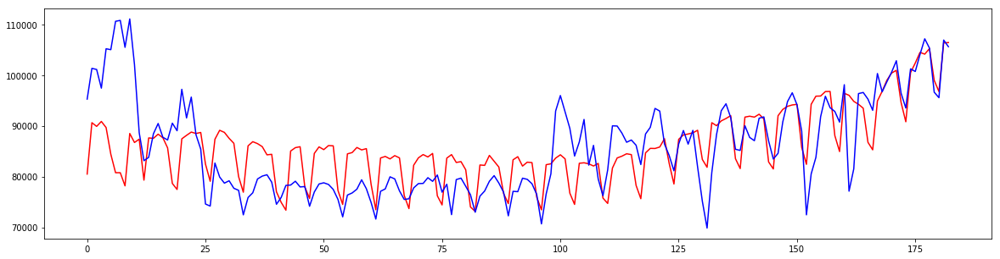

29 :  [0.2213419736234192, 0.061705025199609985, 0.062441680342212293, 0.064792701610443953]


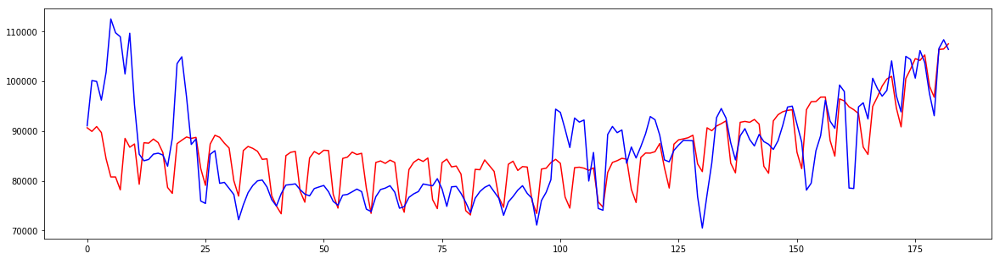

30 :  [0.21733001198851892, 0.060092935162756683, 0.061298722962228658, 0.066591724415335452]
----------------------------
ts id =  2


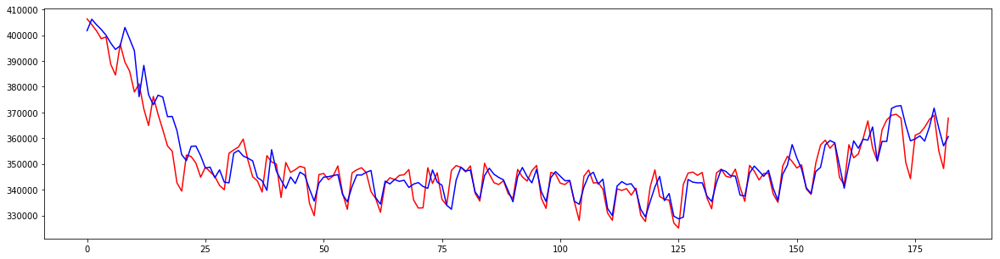

0 :  [0.10238673214110942, 0.015766034965444296, 0.030599973393875483, 0.012023088470999296]


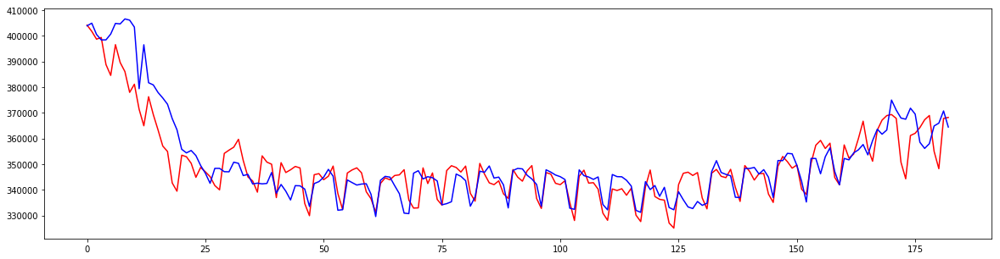

1 :  [0.10963745157768126, 0.02227964007772042, 0.036736264266577494, 0.016319891144356818]


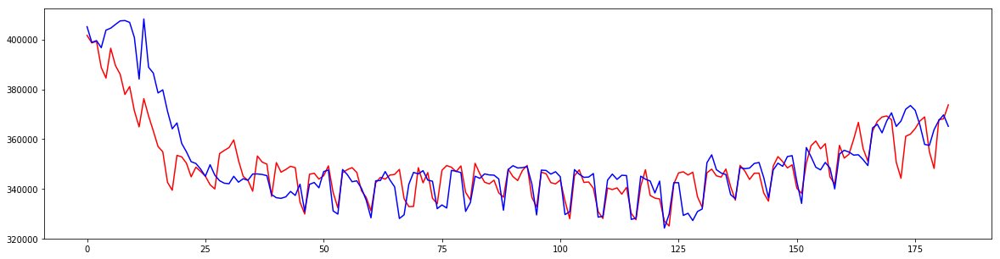

2 :  [0.11481329802391185, 0.024374784683411699, 0.04094567824818815, 0.018323008039408707]


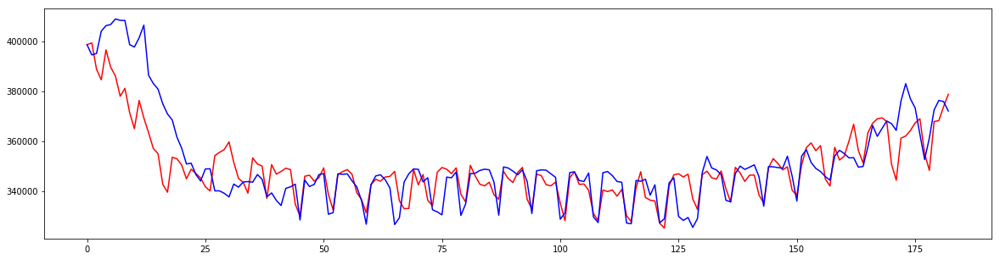

3 :  [0.1142506435140978, 0.025181996346260258, 0.039070824921386083, 0.02003013624433975]


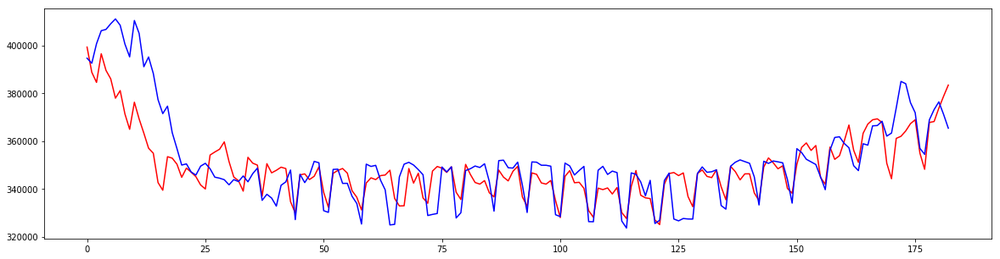

4 :  [0.11112755209356297, 0.026818485911842299, 0.038610001805436951, 0.022123418509968924]


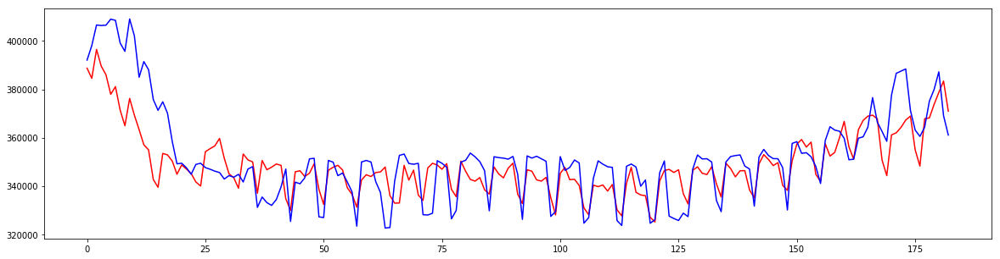

5 :  [0.11492296302323916, 0.029286303420107594, 0.040134218652439275, 0.024612021026547821]


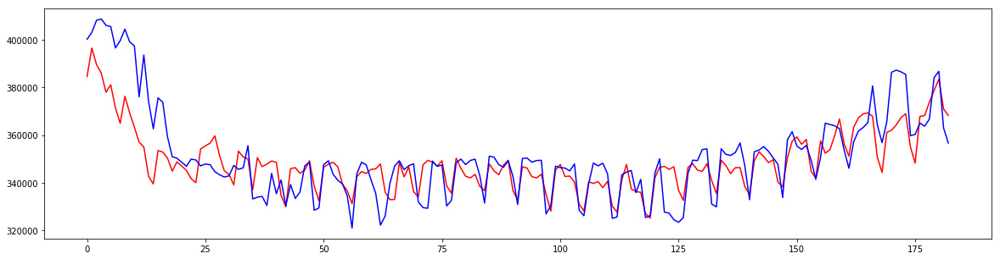

6 :  [0.11383056694109431, 0.029417006219282948, 0.04050334108131922, 0.022887061529222884]


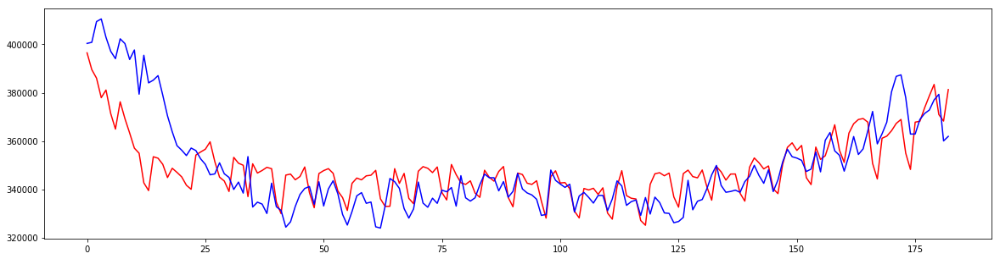

7 :  [0.11913750138005817, 0.037288008860758406, 0.043105131615111043, 0.027042763866137597]


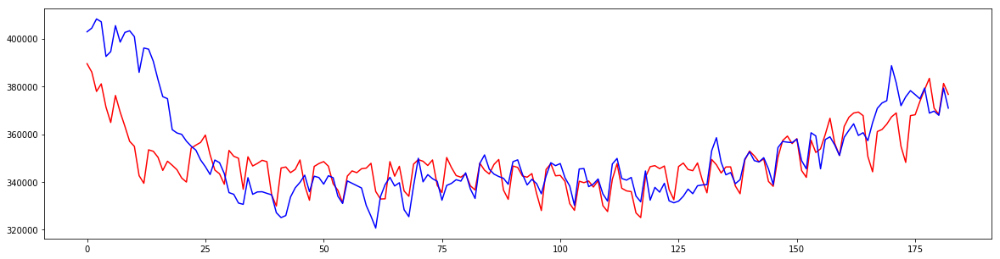

8 :  [0.12297162649000246, 0.038860923953734555, 0.045931034550904977, 0.025755066918171518]


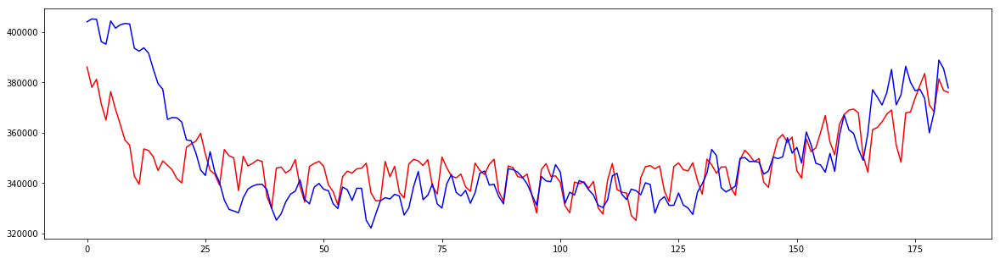

9 :  [0.12706490904114109, 0.039226609402209622, 0.045499694289674708, 0.029238271617437698]


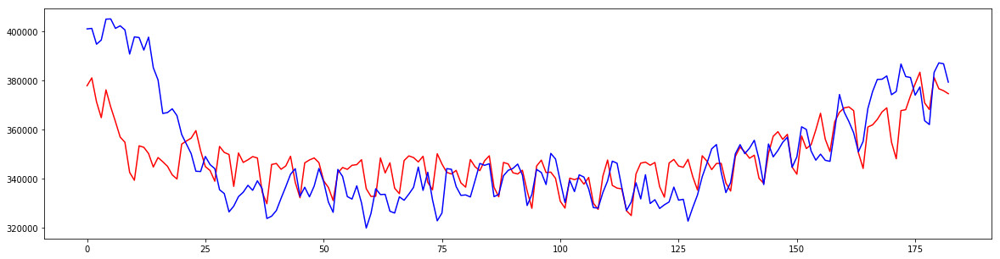

10 :  [0.12476683739922108, 0.042455077810741919, 0.04866229442941801, 0.030723192370912155]


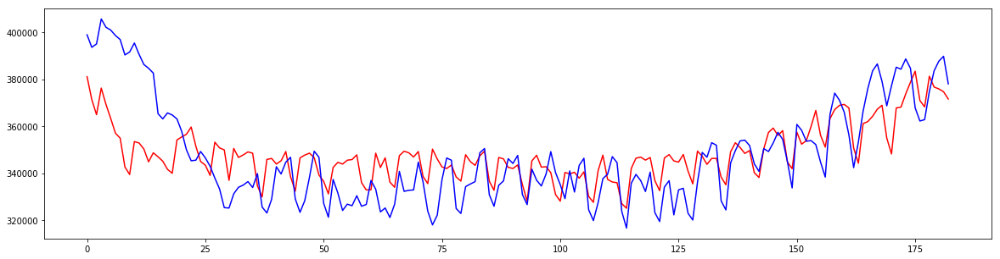

11 :  [0.12478800526562155, 0.042106534952806134, 0.050146262333655524, 0.034161161994789337]


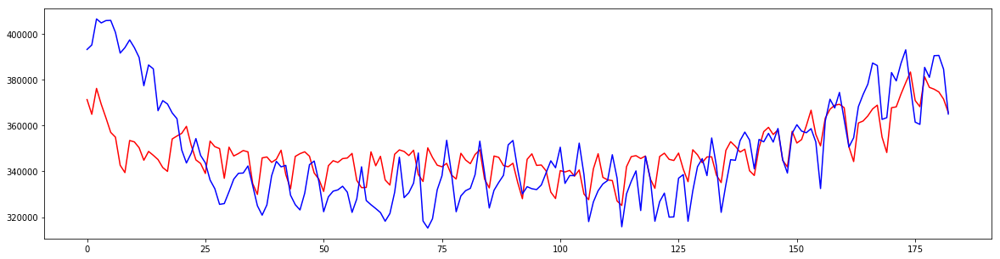

12 :  [0.1206926585826173, 0.041052848775613021, 0.052930581222305394, 0.036816004652353379]


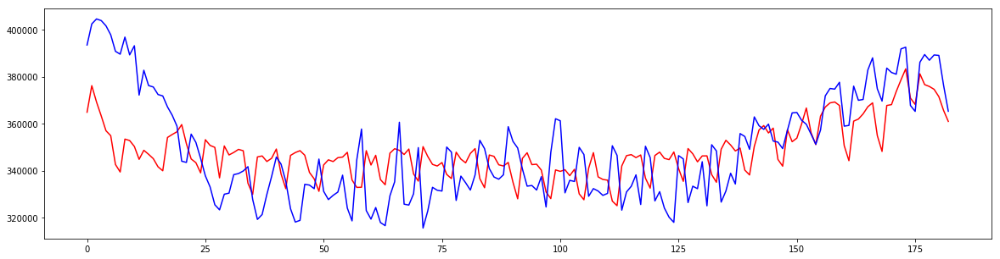

13 :  [0.1297303616322307, 0.039915419301906743, 0.055133833006540844, 0.043322089247712477]


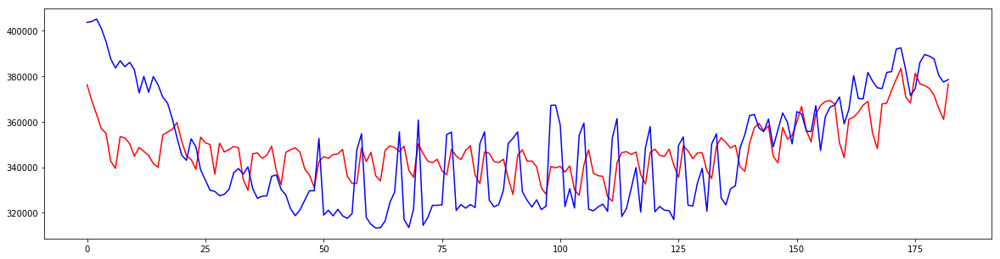

14 :  [0.13033383061305404, 0.043281498857601887, 0.054168006825114183, 0.048568959828852731]


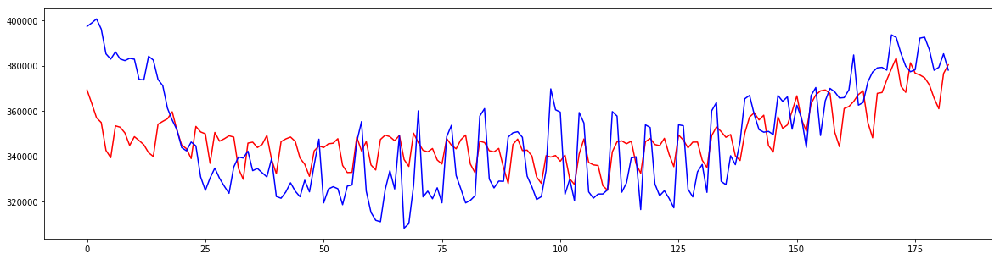

15 :  [0.13461898425586497, 0.042828717503592635, 0.054884447611388228, 0.041926053496375612]


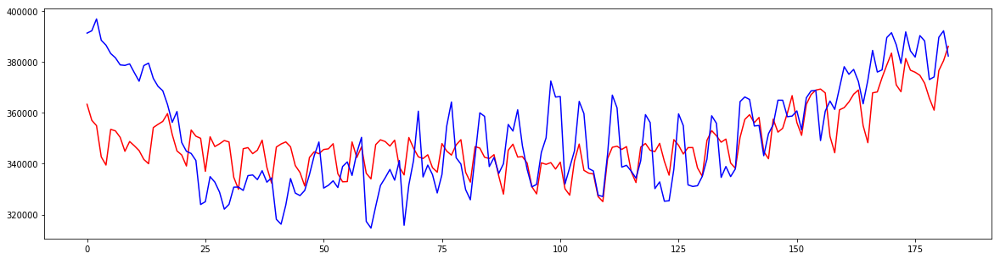

16 :  [0.1303439020598888, 0.04371262644698834, 0.060447606972683532, 0.034553306351162175]


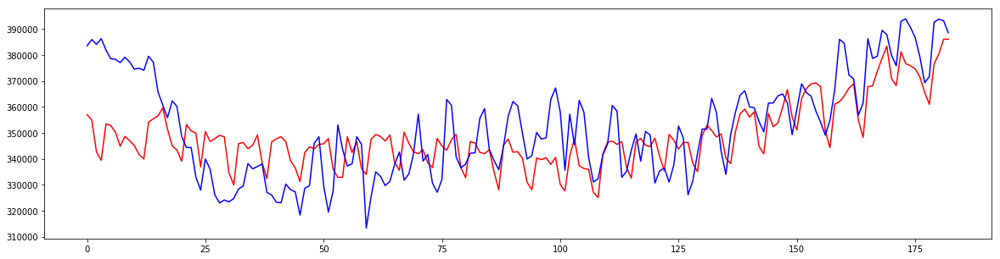

17 :  [0.13597887765644759, 0.046406343873283198, 0.061292899250662509, 0.034662240156962836]


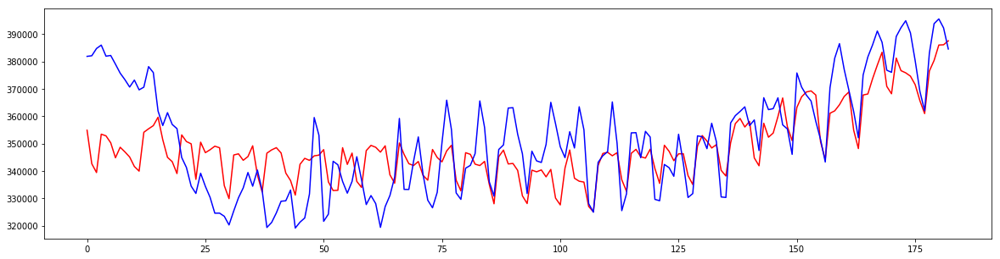

18 :  [0.13739614663475713, 0.047606384467824878, 0.060367278205055191, 0.032639145488021389]


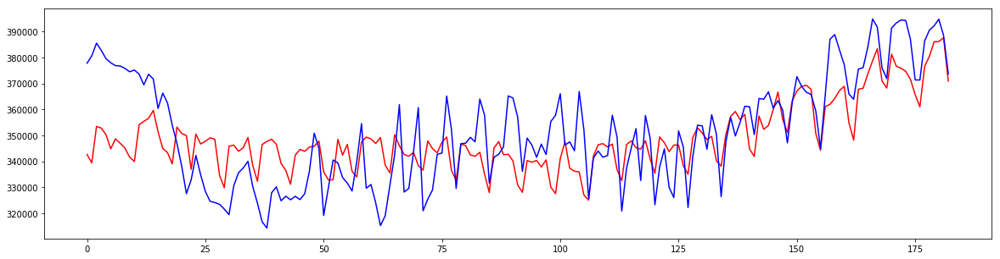

19 :  [0.13422540552490339, 0.051433301168686878, 0.059422502206670003, 0.035418674390760858]


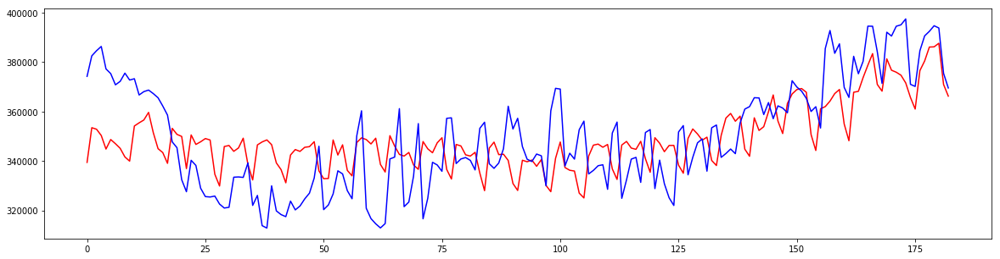

20 :  [0.13446423041564479, 0.058903217005415544, 0.059025365688681872, 0.041640936550390785]


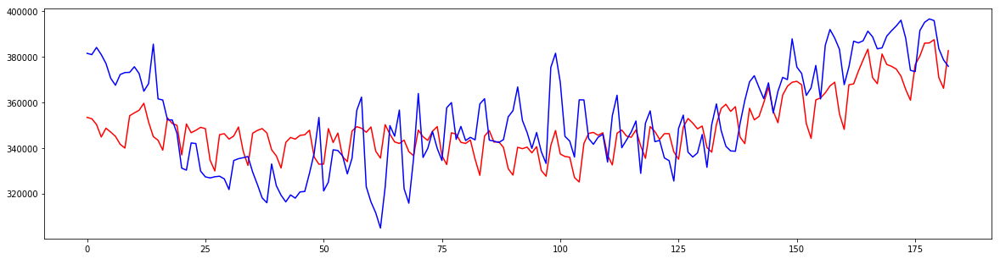

21 :  [0.13779687828661127, 0.050322506267393208, 0.064162356715909877, 0.039513837431435467]


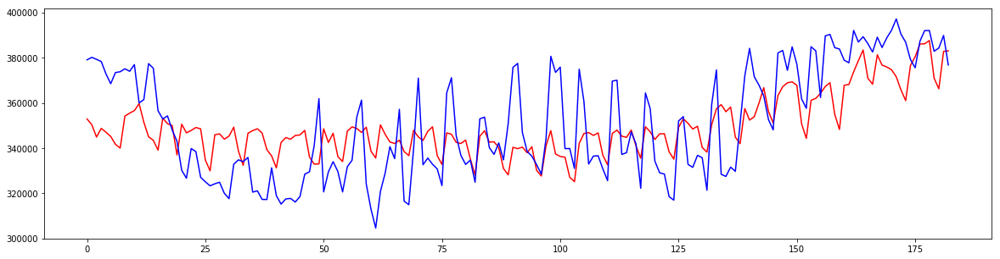

22 :  [0.13320101070252052, 0.052555979970976184, 0.061106050789280067, 0.043454194170019271]


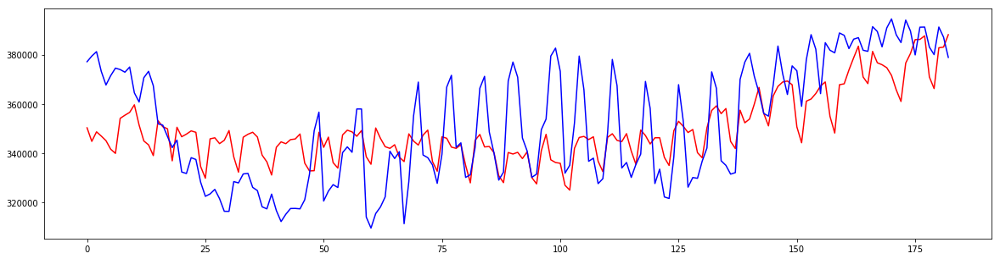

23 :  [0.13471803660496778, 0.056615740407606849, 0.06294440054307042, 0.042473226293265352]


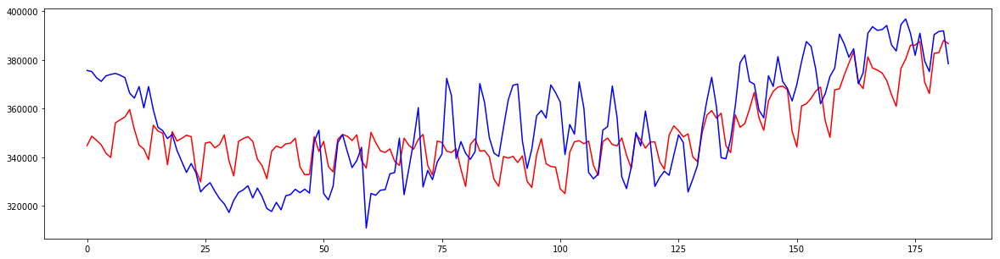

24 :  [0.13406251772786767, 0.058541526883349258, 0.062072325274736807, 0.038033975052177024]


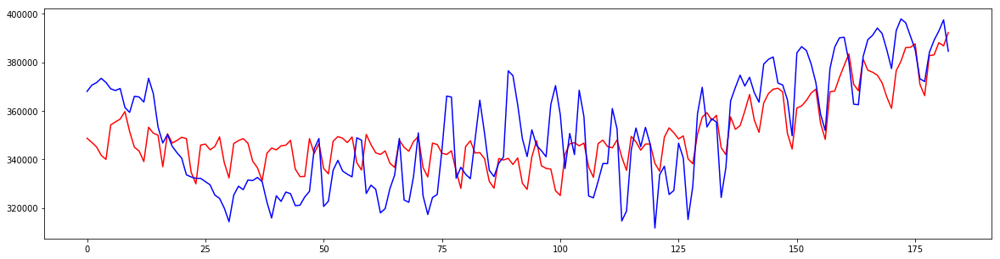

25 :  [0.12871586403141164, 0.064203809797243702, 0.063051764055924067, 0.037404975782065079]


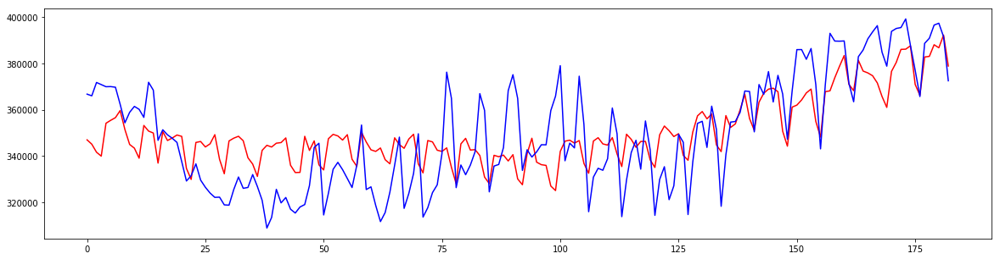

26 :  [0.12263651706369789, 0.067814686306177513, 0.061292159187786723, 0.03933949795699114]


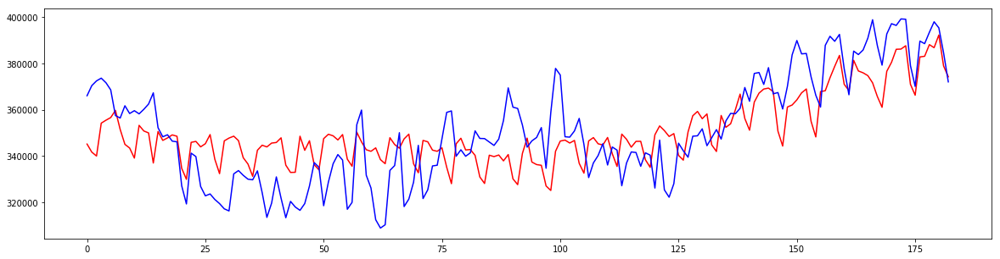

27 :  [0.12420466954461097, 0.078050596155624055, 0.06131135366432218, 0.038060155333261778]


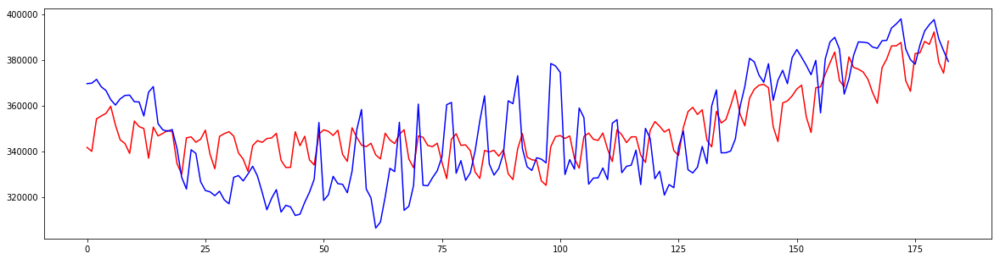

28 :  [0.12661796569264763, 0.076847044554966729, 0.065815380829223974, 0.043169348237993302]


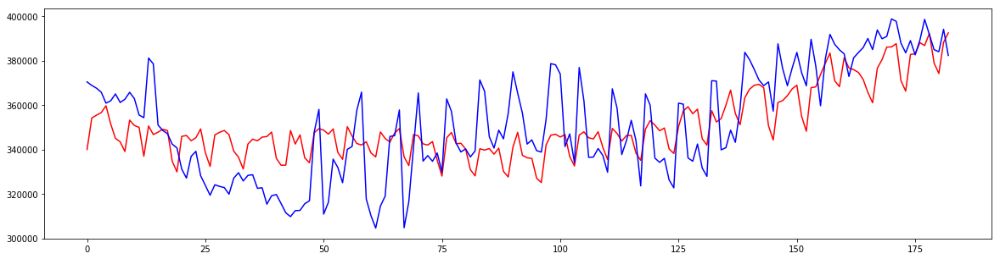

29 :  [0.13485712485311091, 0.080276586469486585, 0.069344348797082442, 0.040312059388605631]


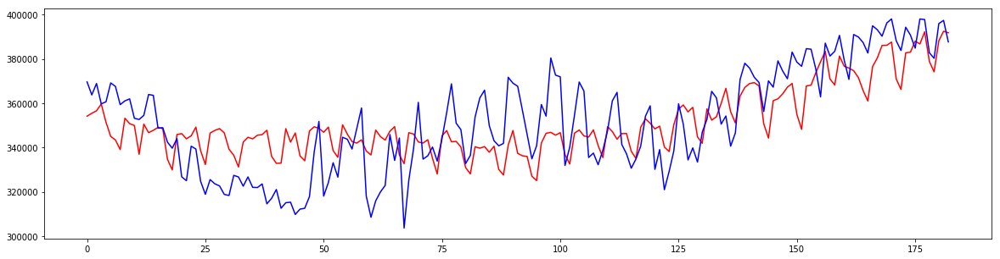

30 :  [0.13790980616803869, 0.08175671954633125, 0.071155604386513929, 0.038124128042366368]
----------------------------
ts id =  3


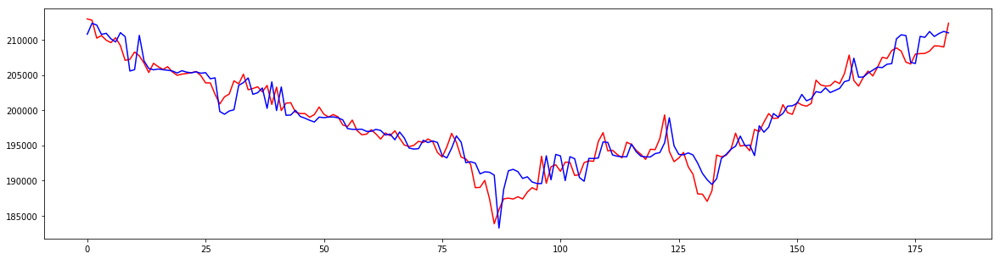

0 :  [0.057897742470267757, 0.0069852177352228316, 0.03254356154649754, 0.0070907284164359735]


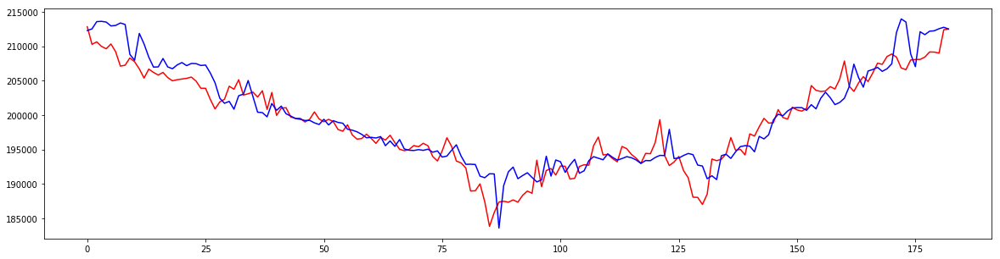

1 :  [0.060291049608699666, 0.0090407689031728362, 0.047415086362418271, 0.0093273051099855338]


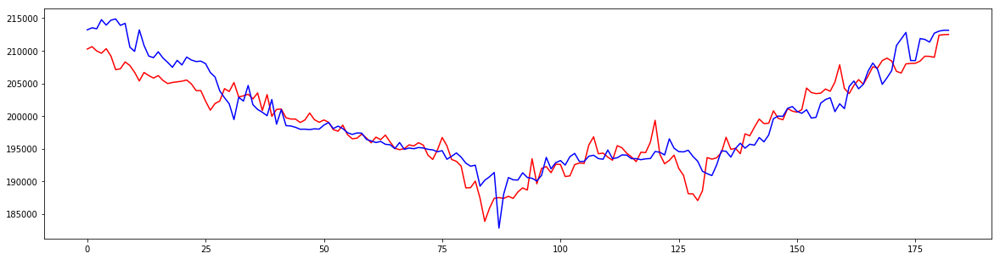

2 :  [0.061961372152590205, 0.010295183775682979, 0.048453212209777267, 0.010543902400993468]


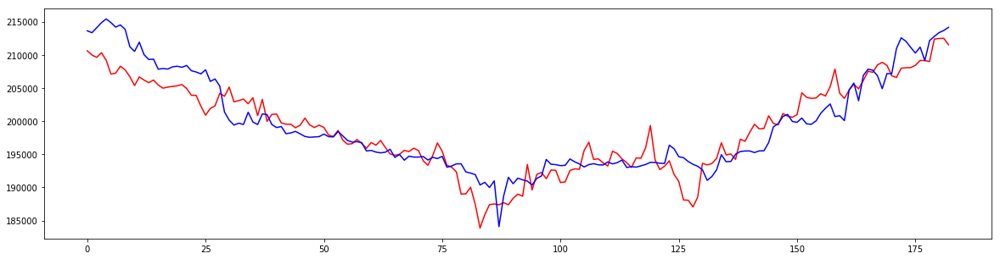

3 :  [0.063573528118606129, 0.010555026274825073, 0.048926696696277382, 0.011552011787294007]


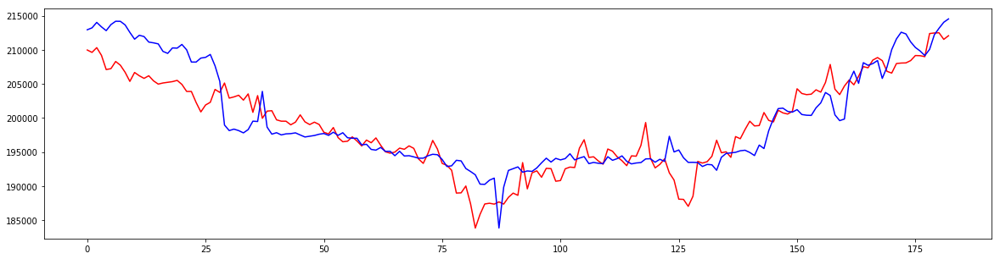

4 :  [0.063318215580215595, 0.010354245346607879, 0.048059619575439062, 0.013102052453729555]


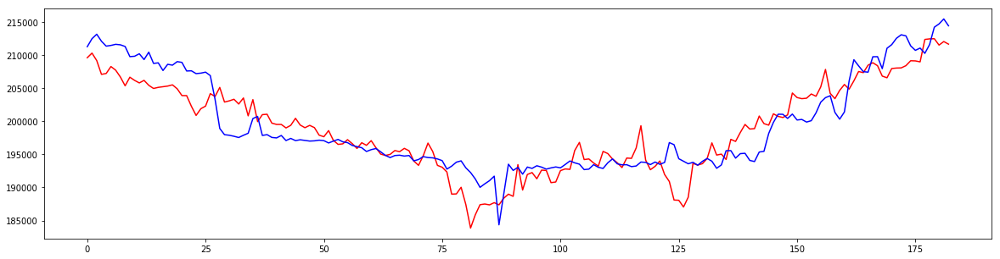

5 :  [0.064135675512726226, 0.010705424342491139, 0.054439630220007064, 0.012592800139004197]


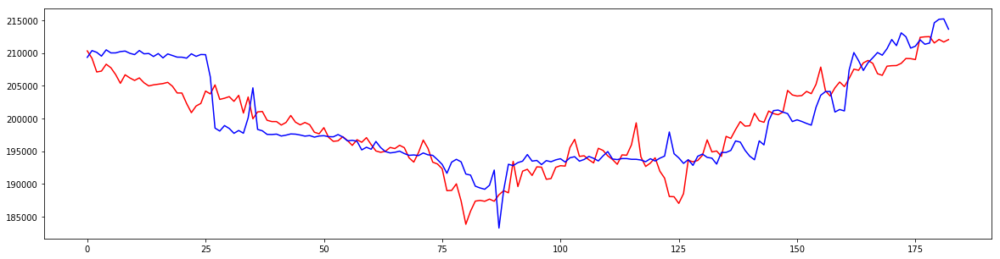

6 :  [0.070968420009177316, 0.011686773506346872, 0.051541183059854945, 0.012824760537983433]


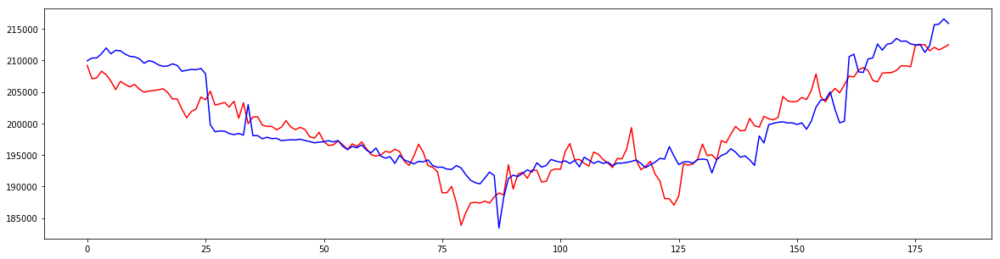

7 :  [0.069699982945716138, 0.013140666376685197, 0.05484259180161509, 0.013588481227821185]


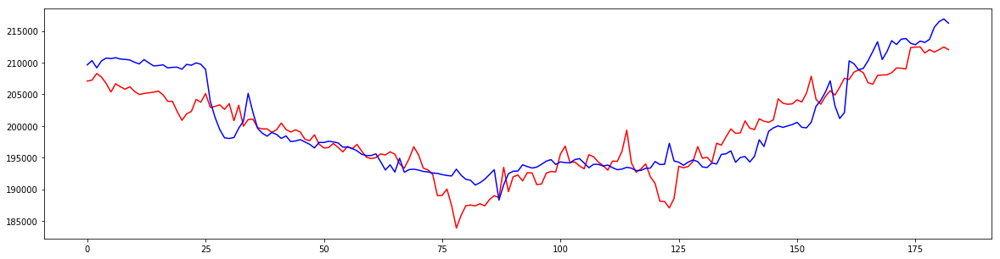

8 :  [0.076595155442456292, 0.012533320826567348, 0.057878028800774327, 0.013606599762011107]


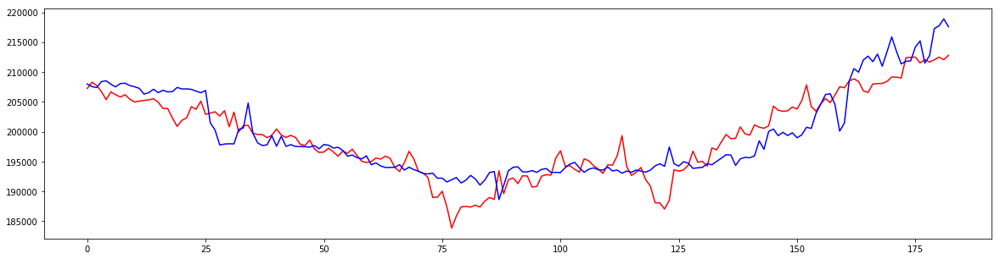

9 :  [0.077412805315117295, 0.01446648572600389, 0.058173400783701083, 0.012490387198969648]


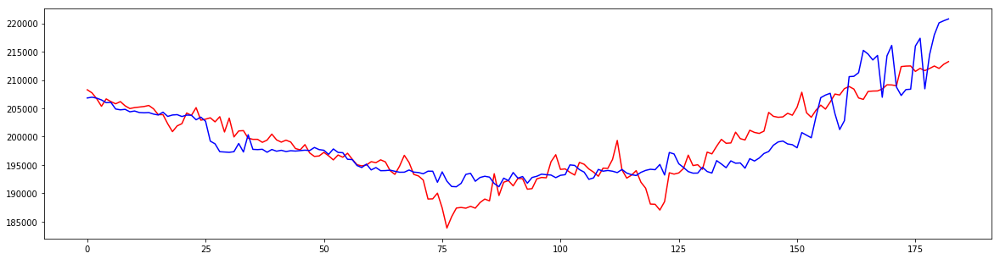

10 :  [0.077660901146680533, 0.014975366013256639, 0.051616689184665235, 0.013347848029394219]


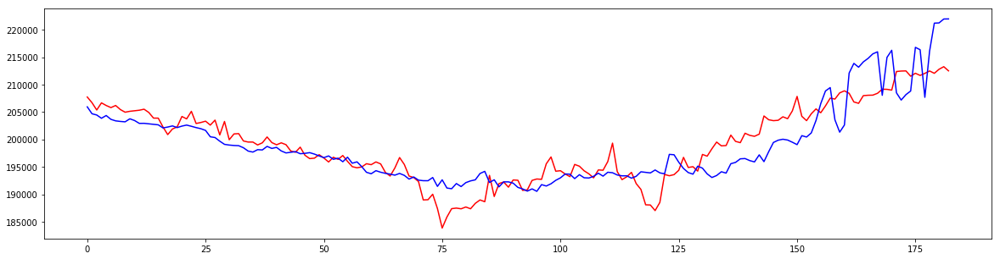

11 :  [0.078650395543017115, 0.015365447906075965, 0.050732954178288645, 0.013914733597794632]


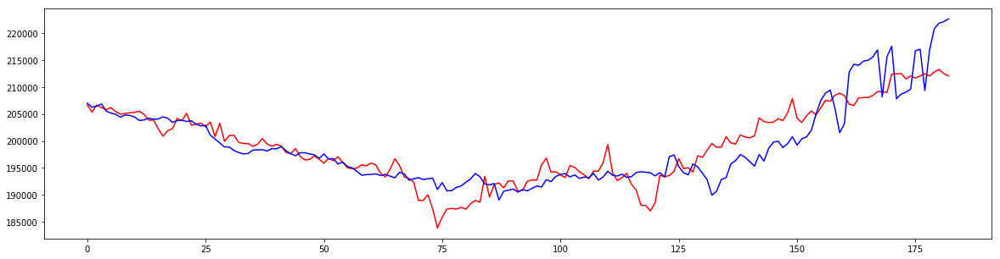

12 :  [0.080494013419155935, 0.015581592553894876, 0.048984995380776476, 0.013580213684283924]


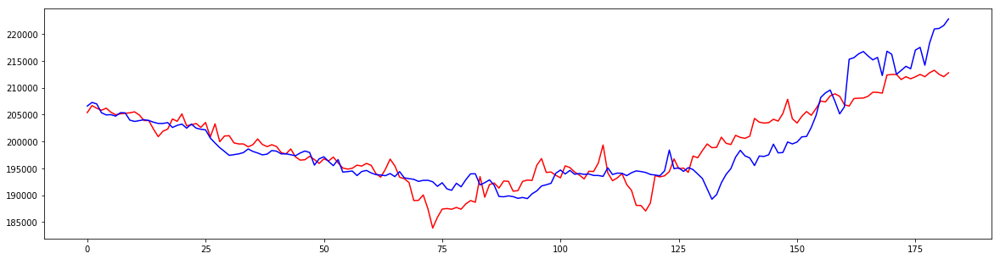

13 :  [0.082806627856653284, 0.017545517330425073, 0.049272364380041428, 0.014001936557677988]


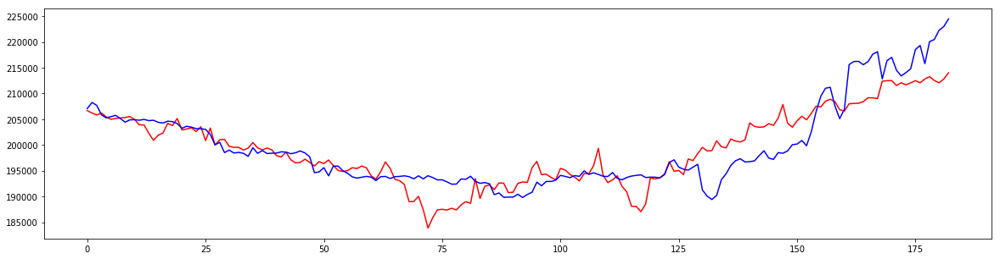

14 :  [0.08994570998530789, 0.01881186420231036, 0.051253126038165848, 0.014505430636287838]


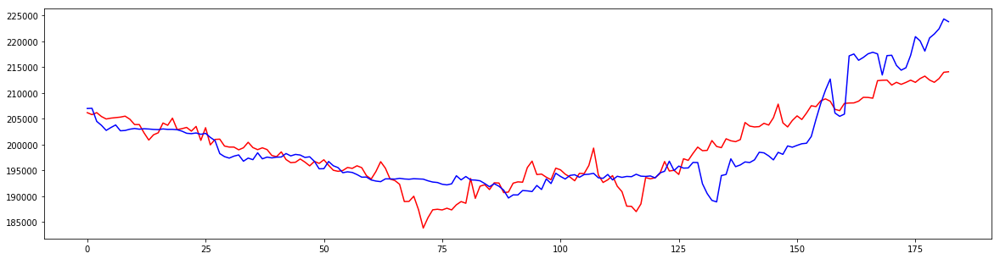

15 :  [0.093731155105056141, 0.01793938088279623, 0.047602620614866122, 0.01548686219767313]


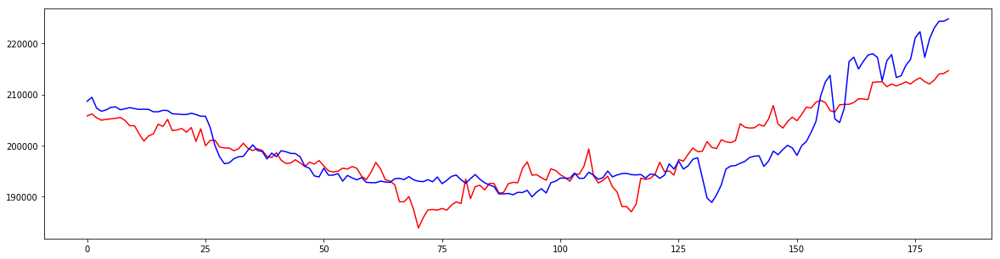

16 :  [0.093474217410351626, 0.020823933555279995, 0.046963968500409813, 0.01771205344110257]


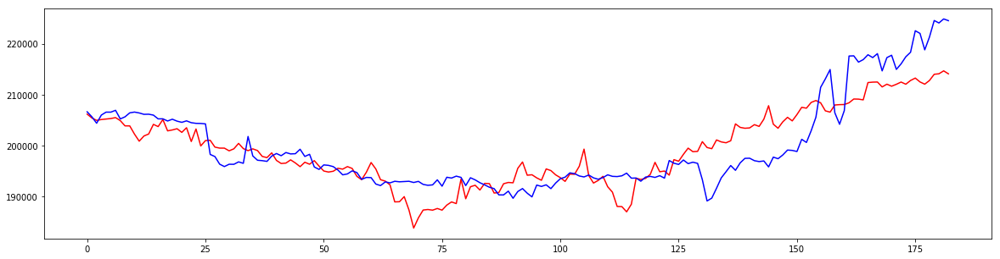

17 :  [0.090682096059949008, 0.02139166170921393, 0.047198123116660468, 0.017696315934832424]


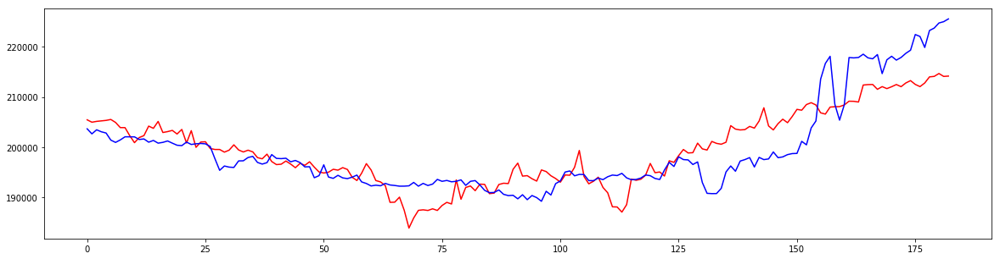

18 :  [0.093116984702981992, 0.022395875414019283, 0.049825544818779204, 0.018167953587181755]


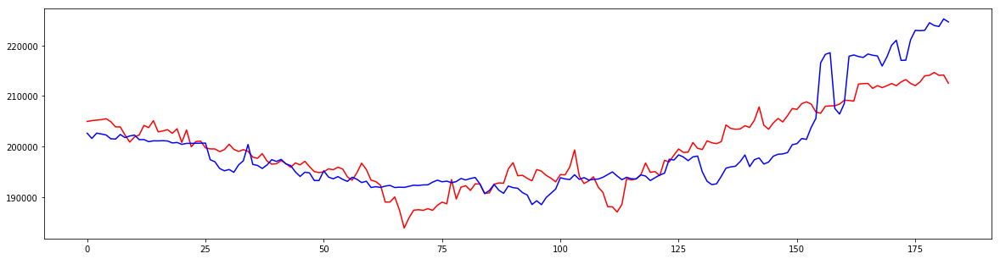

19 :  [0.095149549251132129, 0.023215194020490652, 0.059323658119736167, 0.018399633350690663]


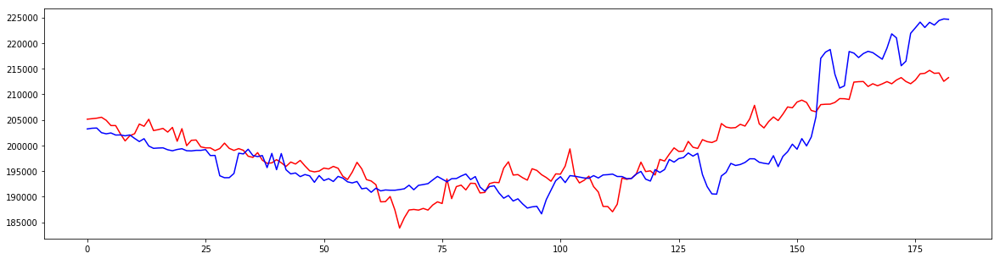

20 :  [0.098890121181082327, 0.023553413475144207, 0.057064677432482211, 0.020161753932054705]


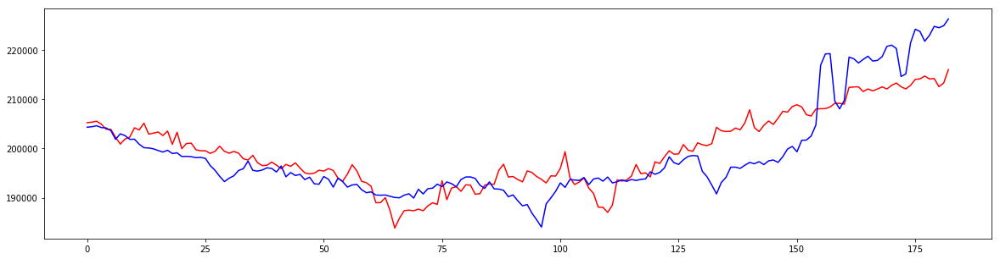

21 :  [0.10114183890509405, 0.02162234421014083, 0.060625690794119037, 0.01957323631717893]


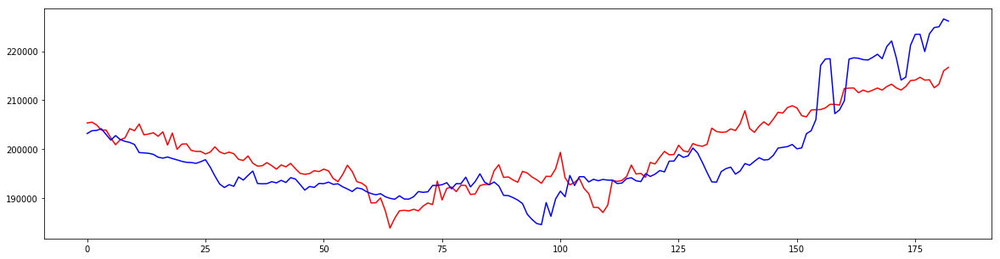

22 :  [0.10794516532600512, 0.021450626077917596, 0.05474822122699035, 0.020808694986139197]


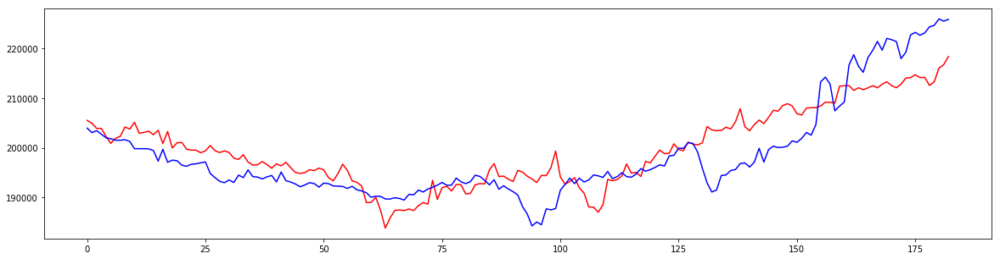

23 :  [0.10604335575645199, 0.021835310358243851, 0.059147017934103423, 0.020443935879983135]


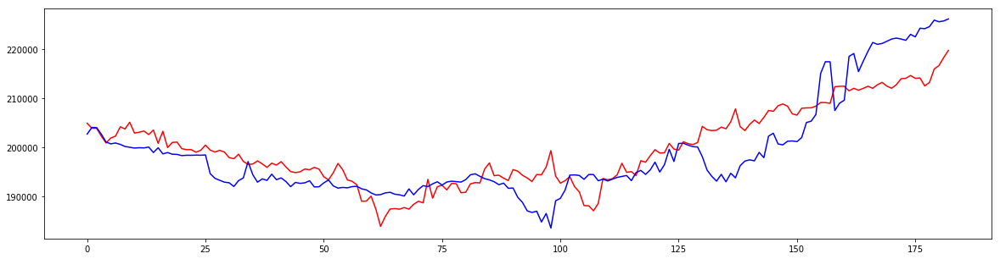

24 :  [0.10510160336254129, 0.021644732952874553, 0.057375266032153871, 0.02067444801824226]


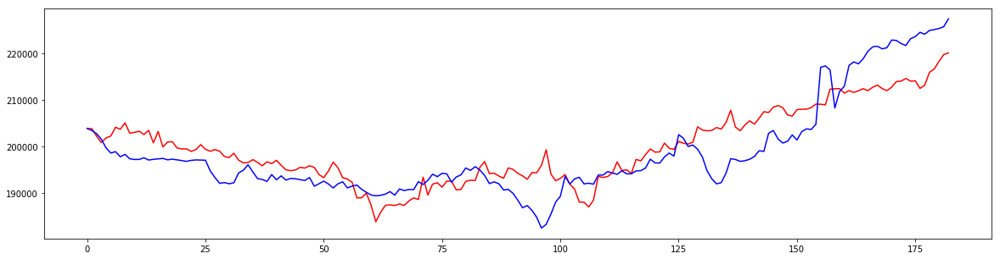

25 :  [0.10382554247330054, 0.023376629291531004, 0.062392608491807701, 0.021589282342480622]


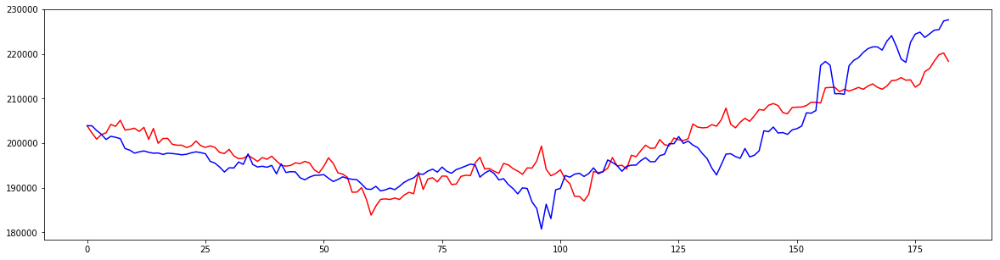

26 :  [0.10185020286996455, 0.025375974781156312, 0.065016596348863823, 0.019227144384658106]


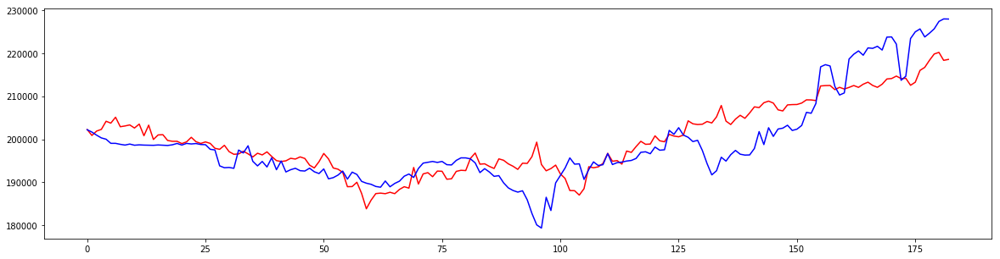

27 :  [0.10109115871146877, 0.028293963752366452, 0.060743486396446292, 0.019932621184404125]


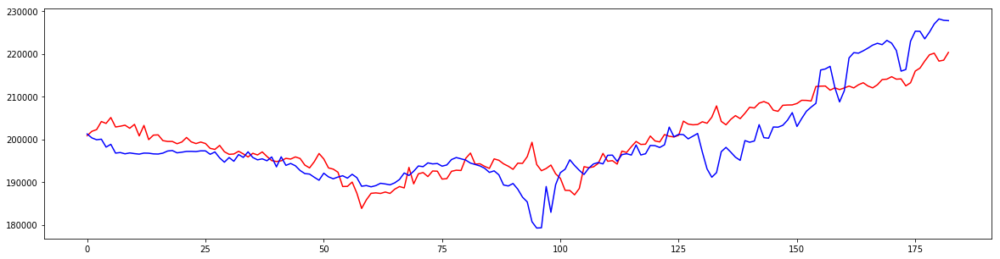

28 :  [0.10332960845709166, 0.027170144067128543, 0.059478056734881095, 0.01988245482955674]


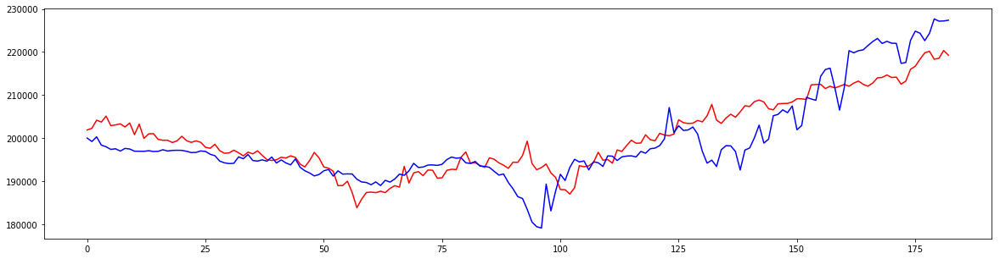

29 :  [0.09734637396316051, 0.030436560160380235, 0.056810146939357375, 0.019670925062492035]


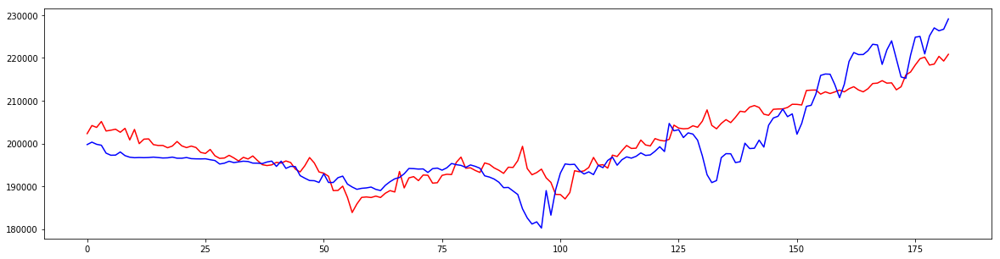

30 :  [0.10026120973424101, 0.030885457260889152, 0.050213113415228973, 0.019064974528914379]
----------------------------
ts id =  4


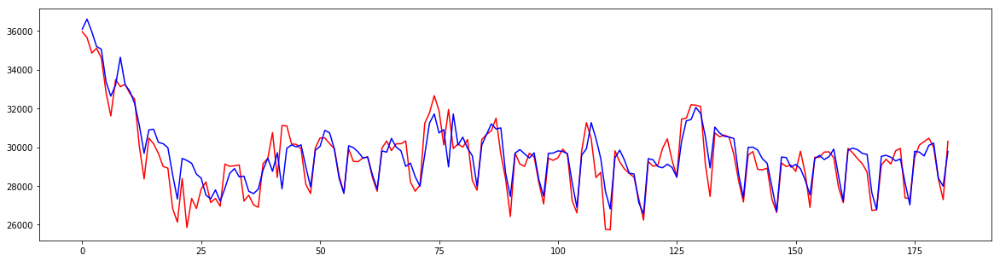

0 :  [0.11759778786719007, 0.023198026516596588, 0.024221247876134916, 0.020397112982739777]


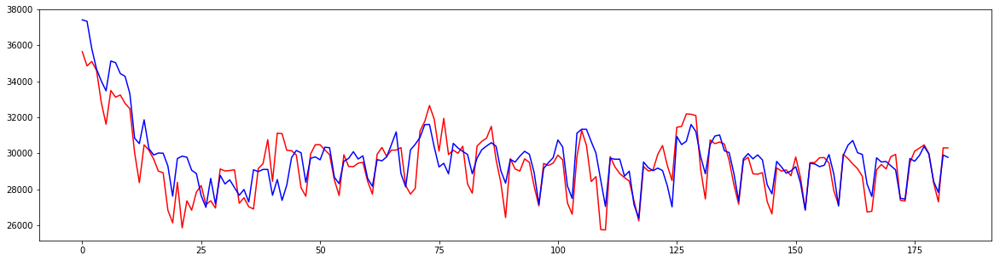

1 :  [0.13170718425963326, 0.027783147594379977, 0.028900334401911986, 0.027424581793293119]


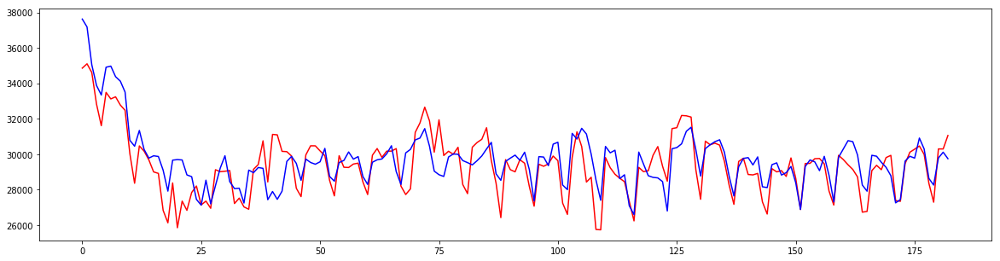

2 :  [0.13009531011386338, 0.029181887176398521, 0.031493144153240483, 0.030171947867805696]


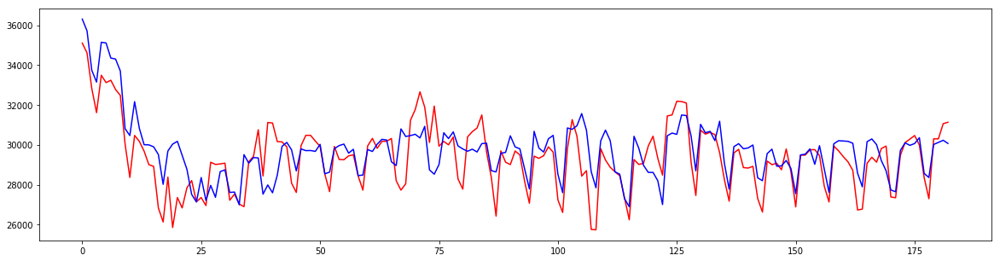

3 :  [0.12872036505129811, 0.032114976179624971, 0.032028863500659463, 0.031915568137101127]


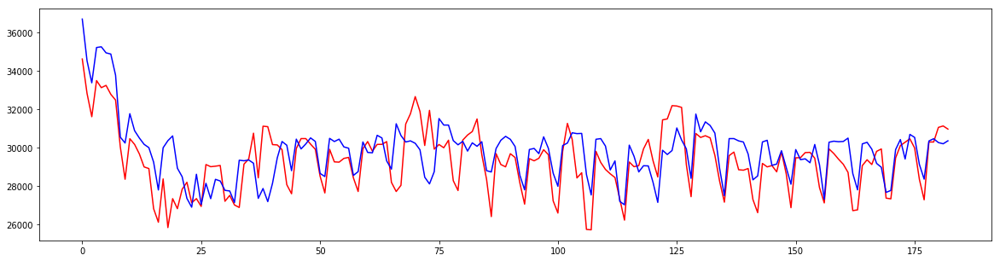

4 :  [0.12386903803093724, 0.034246811522919793, 0.034590932561641349, 0.036258924699278314]


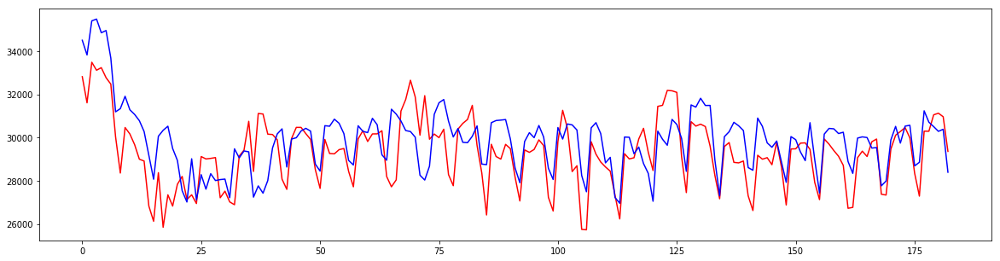

5 :  [0.12670095573543236, 0.0367156223838054, 0.035654075450823948, 0.039274109399512973]


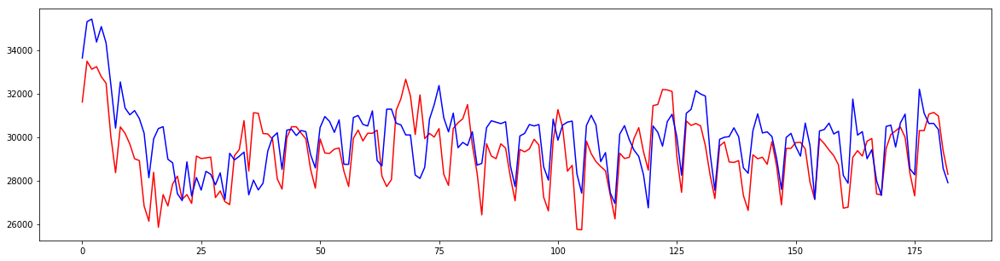

6 :  [0.12176392773204797, 0.037354825965622743, 0.039432810675878845, 0.041347063884559637]


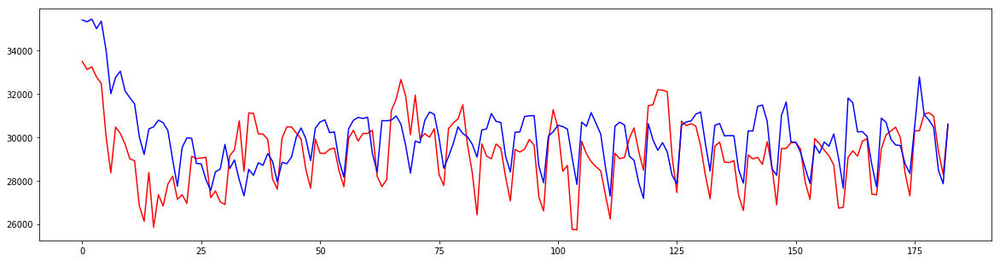

7 :  [0.12529075232295334, 0.043421369542925116, 0.041226884837386249, 0.045650655392547902]


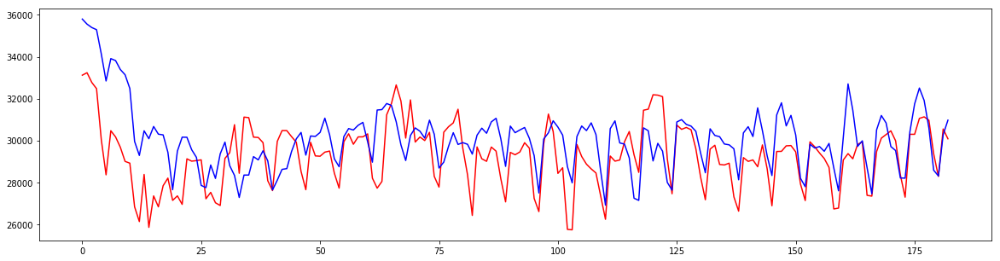

8 :  [0.12615728598909309, 0.045464505448457523, 0.04277053644089978, 0.046867709757489863]


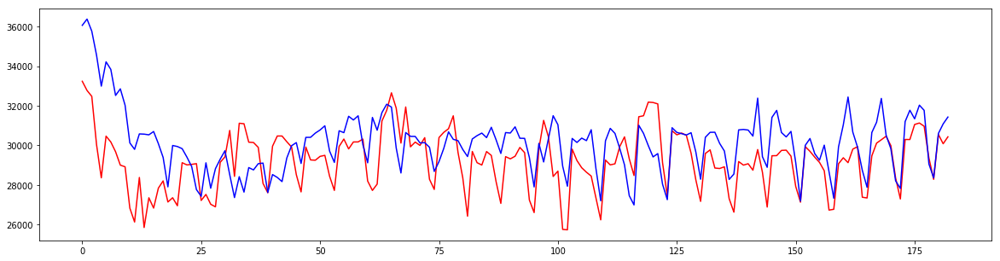

9 :  [0.14061327431983722, 0.045039341804133118, 0.044828928492661457, 0.048526628741183291]


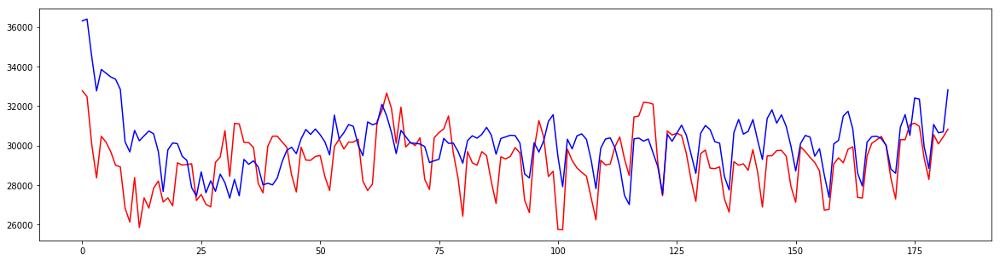

10 :  [0.14947176111859622, 0.045378694617979248, 0.044776227640140658, 0.049820511542143738]


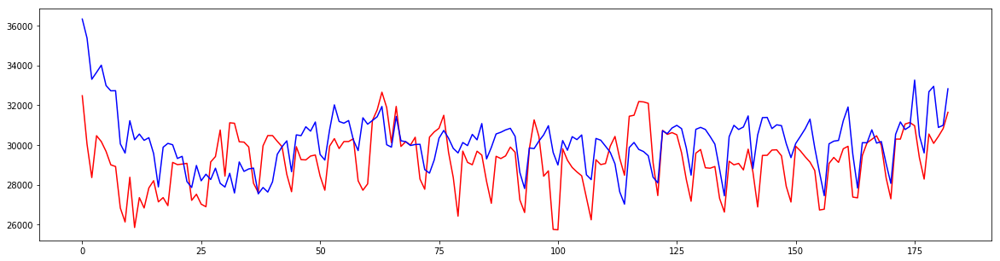

11 :  [0.14152262562641388, 0.043366678558154903, 0.044948937165579482, 0.050663526370746281]


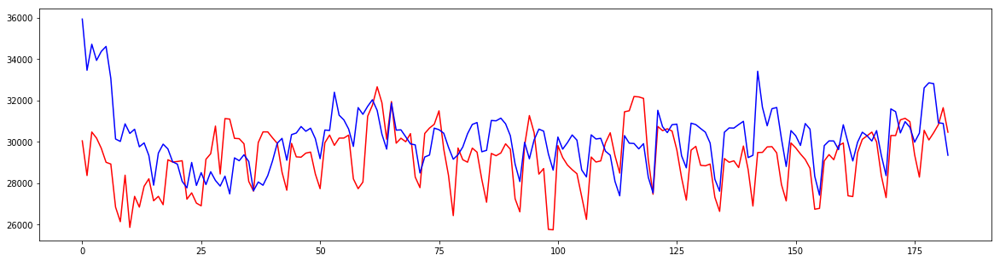

12 :  [0.15296517146699351, 0.044764479298724208, 0.04690598948164329, 0.050498885318464838]


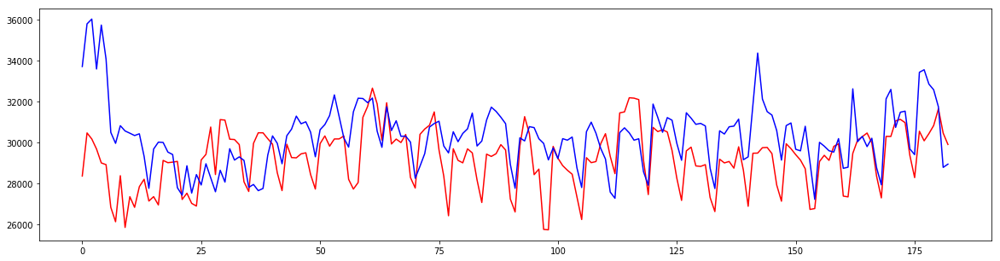

13 :  [0.16006125934392079, 0.047820101604566782, 0.049892072048622456, 0.054164540642613487]


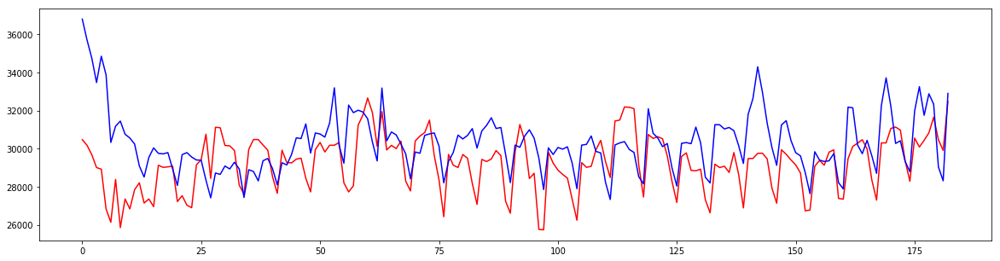

14 :  [0.16447446738812399, 0.04993732629846178, 0.055257441530618519, 0.05351078711775633]


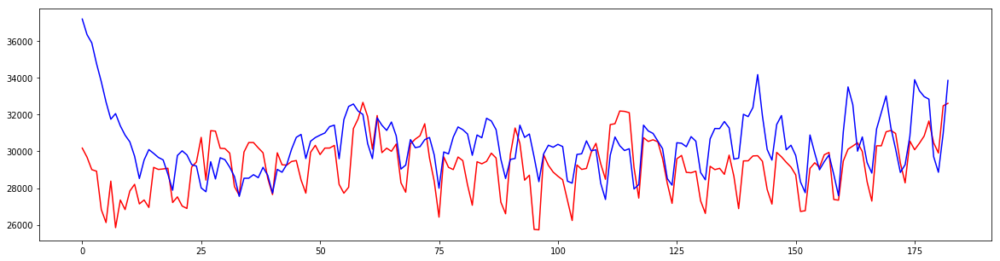

15 :  [0.17337842927615255, 0.054512791860035881, 0.052978853116073754, 0.055837456858031098]


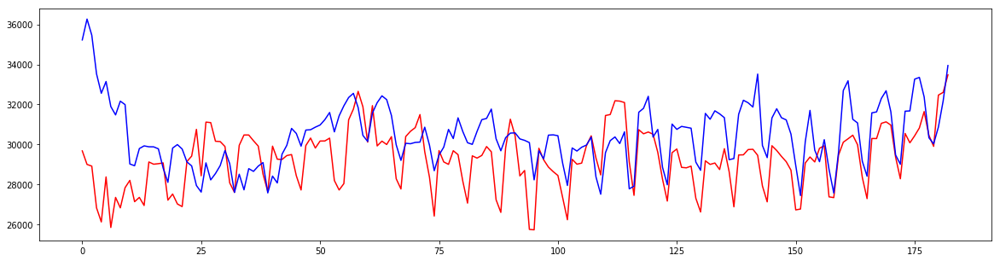

16 :  [0.17159689425998367, 0.059044756045059939, 0.053748481866160873, 0.057680529719609658]


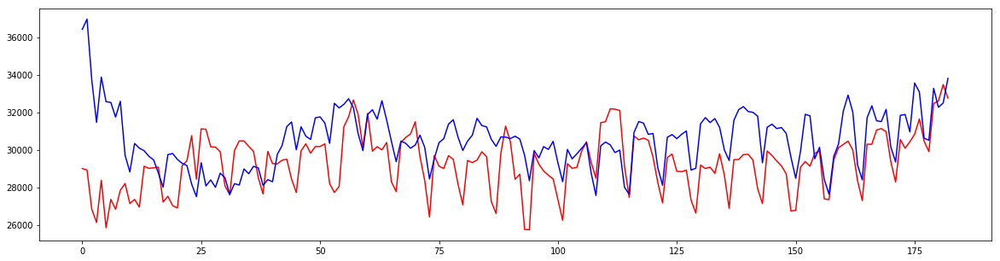

17 :  [0.17300120827954044, 0.063204320700279037, 0.056272231842073375, 0.059159553387635289]


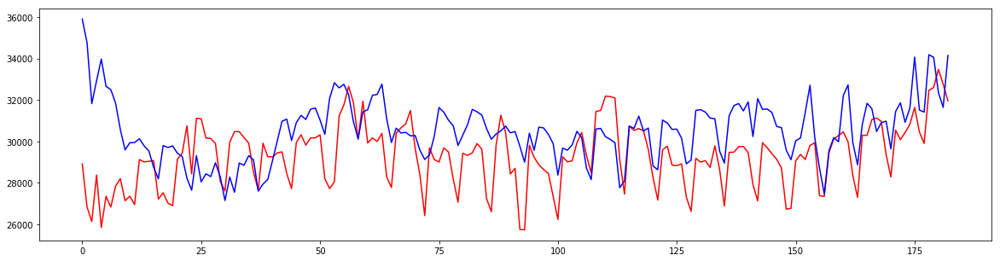

18 :  [0.16268052611800765, 0.065394539977273569, 0.057778758488809465, 0.059138408356968639]


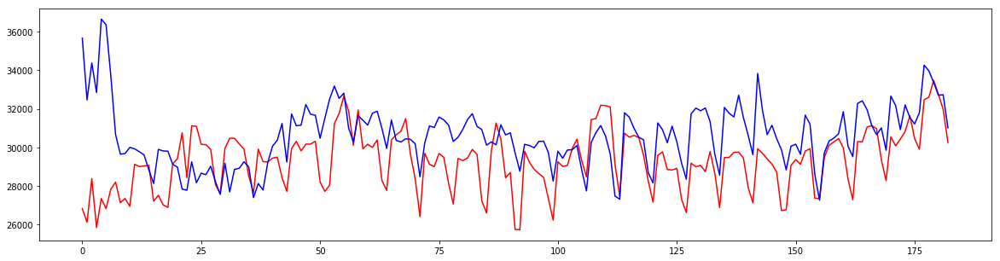

19 :  [0.17834421984877413, 0.069070576449603099, 0.060981207811531109, 0.059881231933513378]


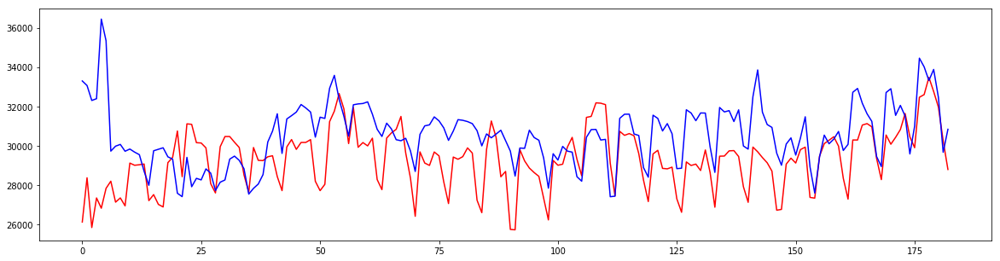

20 :  [0.18243892912532109, 0.073933772008902471, 0.062414111208238691, 0.058435903233430904]


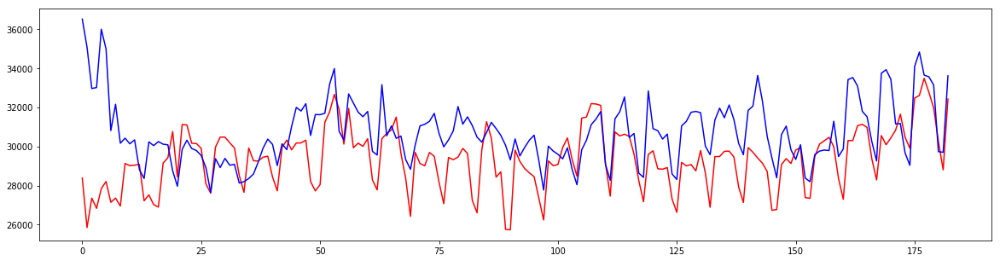

21 :  [0.18815864407710817, 0.078053938132019718, 0.063561061545427233, 0.058466700118173641]


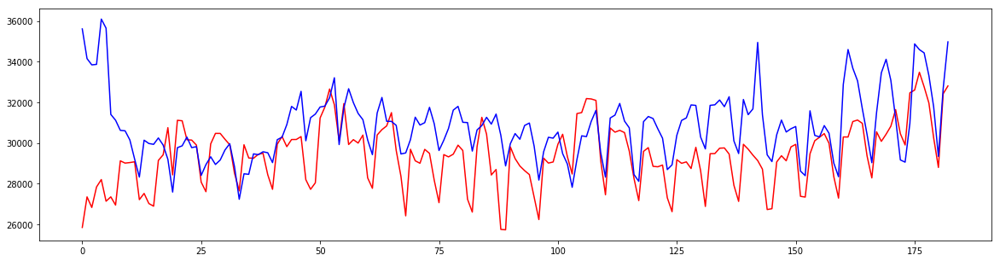

22 :  [0.18033171738718537, 0.076646014369465637, 0.06626226893770959, 0.059804342698772078]


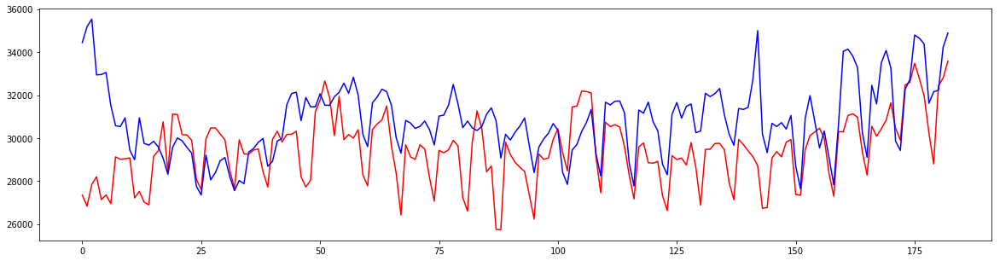

23 :  [0.17770142081783941, 0.079112645416739055, 0.067363430817533237, 0.060921114893264183]


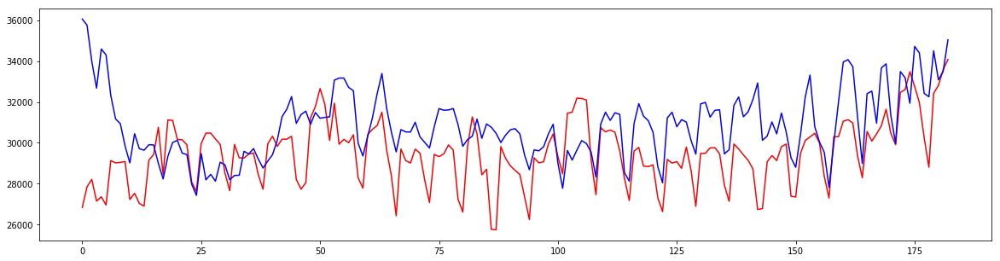

24 :  [0.17400580875056429, 0.07796981396303547, 0.069075334848110112, 0.061803834699891251]


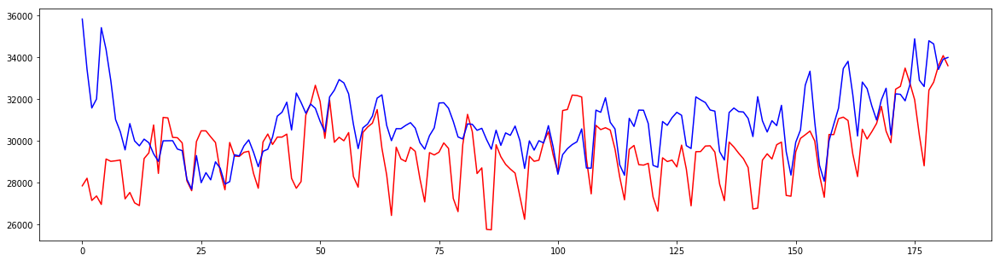

25 :  [0.17890747208142155, 0.078563421063839747, 0.069848640938460285, 0.05769702677438291]


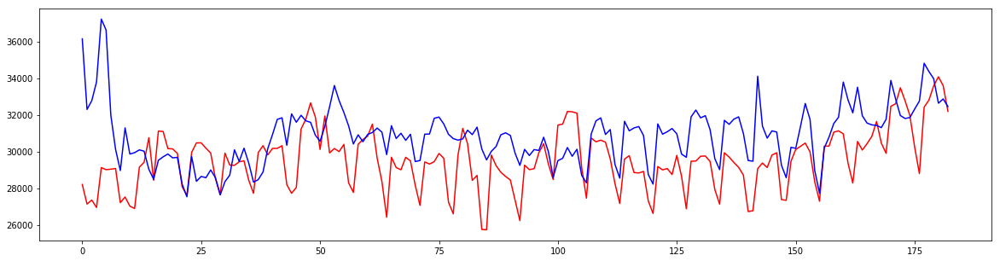

26 :  [0.1757810920828502, 0.081470650363328595, 0.070389452920940454, 0.060544037265318394]


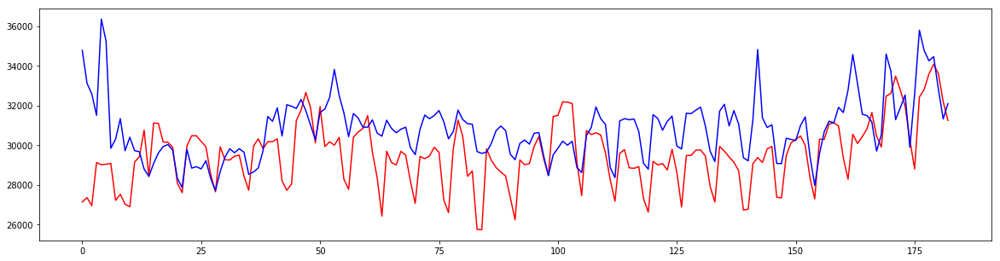

27 :  [0.18172528879800928, 0.081708460576756264, 0.073227480857163754, 0.058343162717567634]


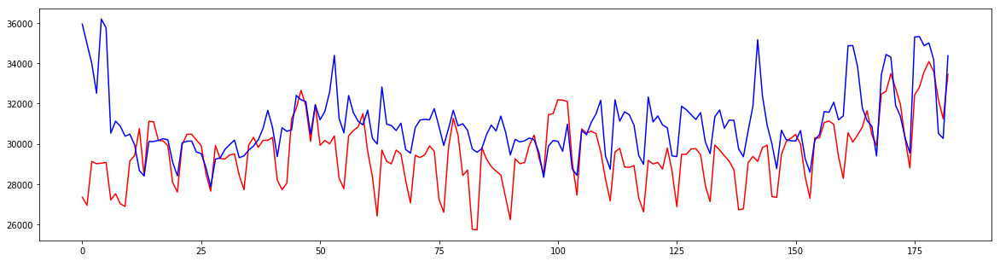

28 :  [0.19512394805679187, 0.081691693083318181, 0.077034139344928143, 0.058053601228476845]


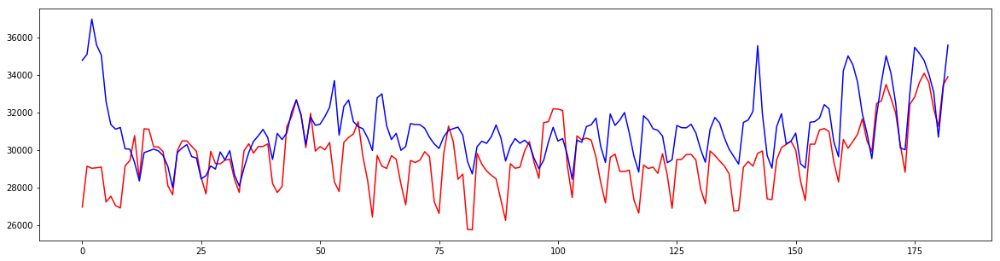

29 :  [0.20548771804864013, 0.078403086149240117, 0.078454871327265321, 0.057822487948203688]


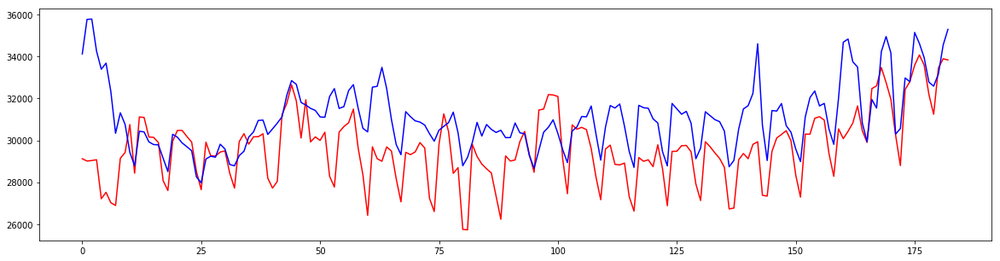

30 :  [0.21946741225084873, 0.080968951176920656, 0.079950433218596656, 0.056766110569839053]
----------------------------
ts id =  5


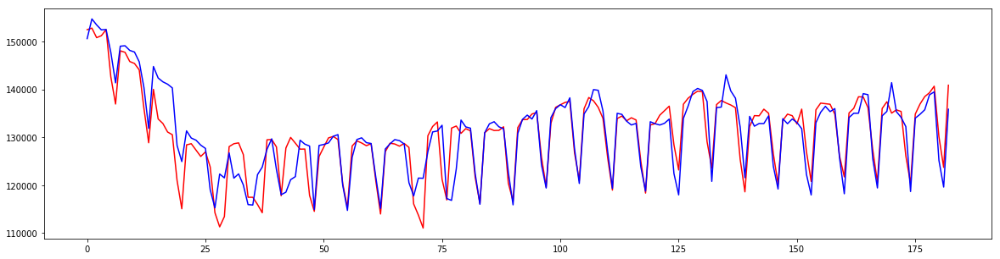

0 :  [0.11359167675401495, 0.018318074042059877, 0.022249102931820433, 0.020855570431388085]


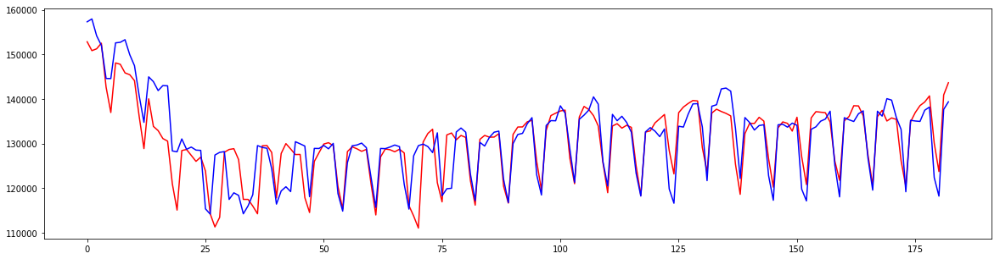

1 :  [0.12216659323616275, 0.021184418130771751, 0.036321995468140959, 0.026754932780292218]


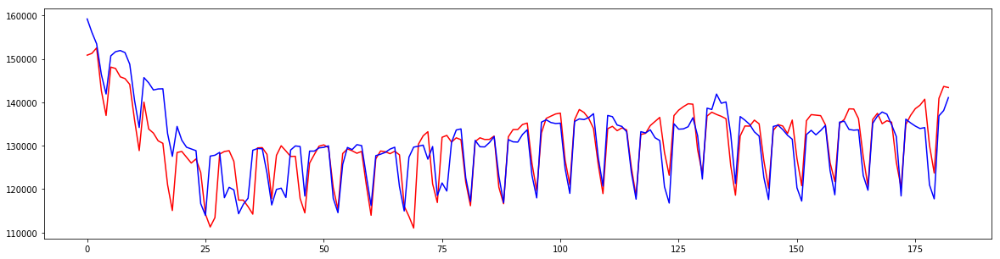

2 :  [0.12822416702926115, 0.024309168844940048, 0.0386125039492786, 0.028103641060563428]


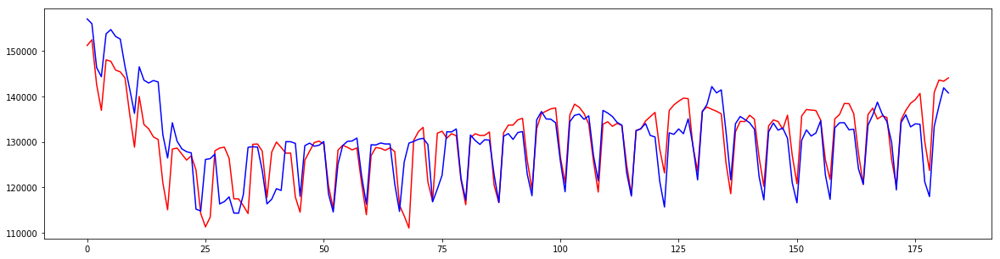

3 :  [0.12840649369109106, 0.024494993557840187, 0.040097163051591042, 0.029504709364173126]


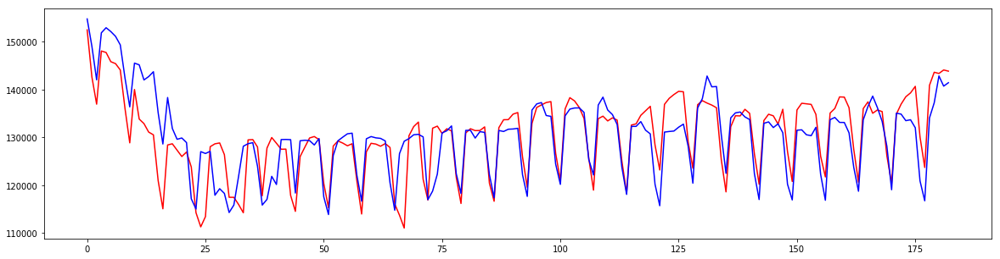

4 :  [0.12762325009635669, 0.025790214470625478, 0.04103944831972061, 0.030745004827734602]


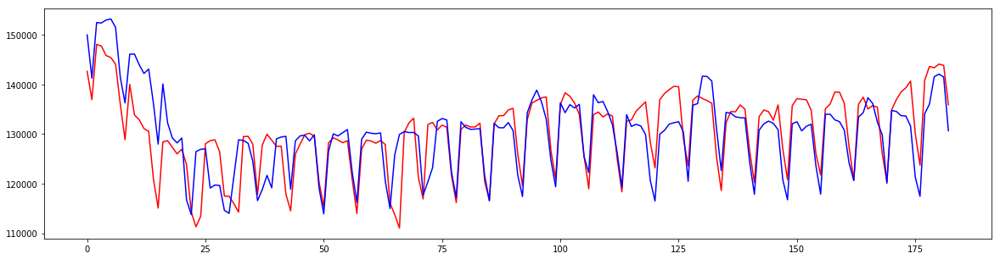

5 :  [0.13103123368495109, 0.026738459129046214, 0.040624182210795889, 0.031233950481644884]


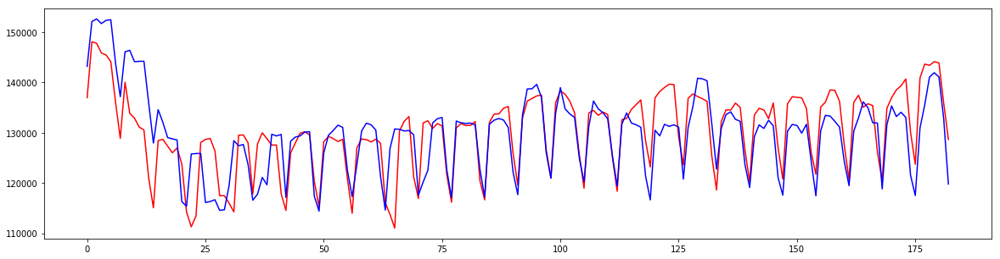

6 :  [0.13202982879032171, 0.027946423786703888, 0.041796850645550936, 0.03261859363007806]


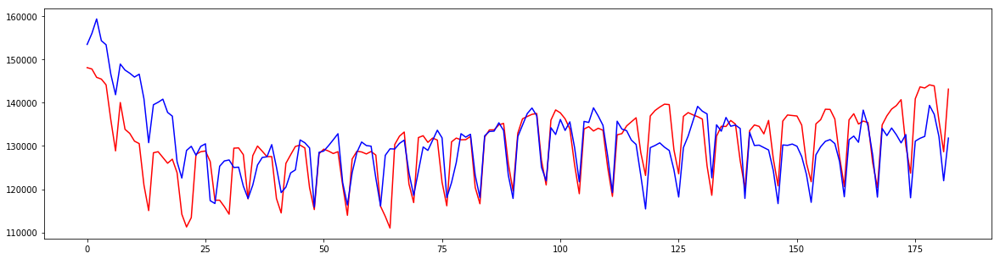

7 :  [0.14159768761985955, 0.035301833792387716, 0.045819711551241545, 0.038747122723236882]


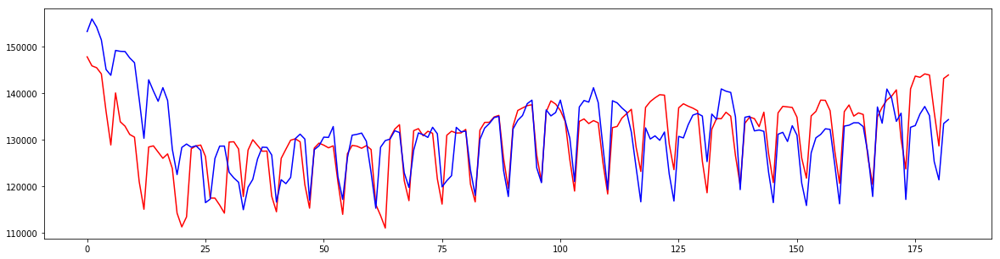

8 :  [0.13679790243756712, 0.040624055785148792, 0.048364288129371442, 0.040001096231946122]


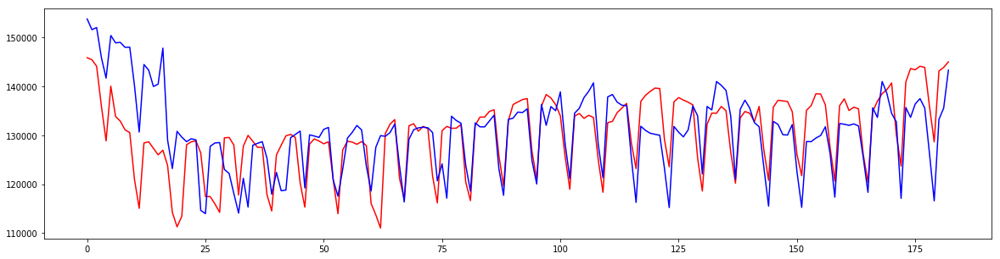

9 :  [0.14072379276822708, 0.040450878086992881, 0.047280810748036209, 0.041987208037127355]


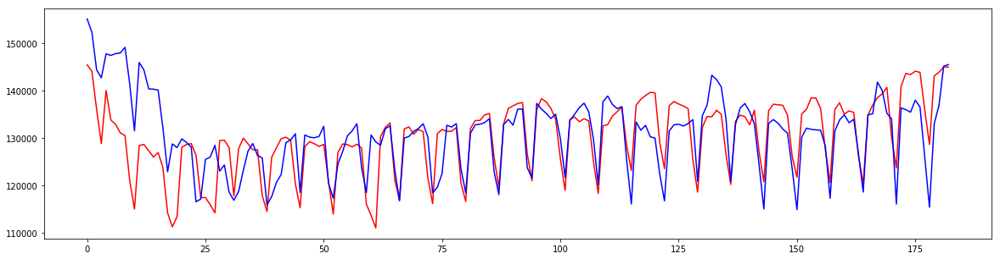

10 :  [0.14053780042257402, 0.040301857456977876, 0.047049676662990023, 0.038831348089297862]


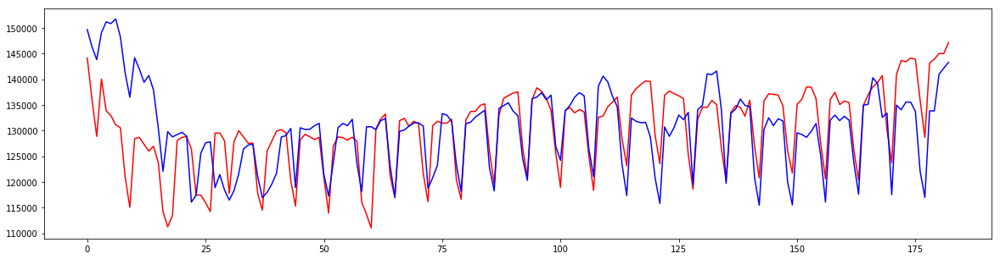

11 :  [0.14020502945842964, 0.043806518659901407, 0.048657283703031601, 0.041379808137774712]


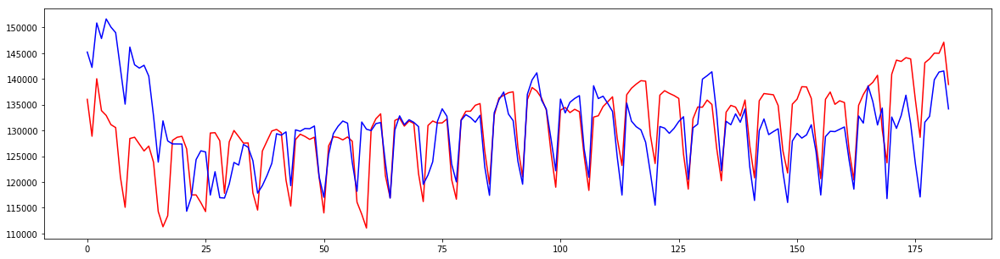

12 :  [0.14738541095781449, 0.040635867756076353, 0.048527117786712703, 0.043197036125472418]


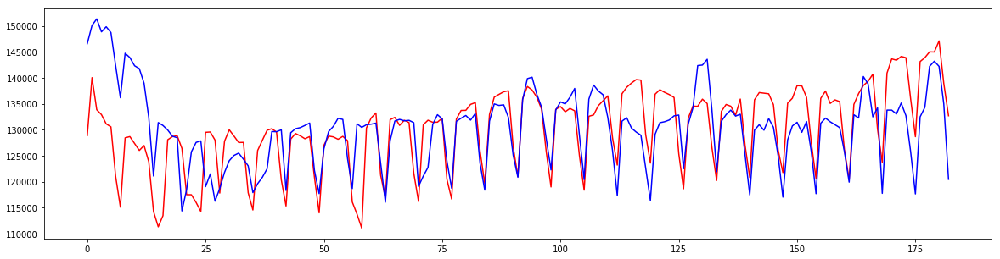

13 :  [0.15214098495535397, 0.043214612031532013, 0.048414007340973925, 0.041934465705052153]


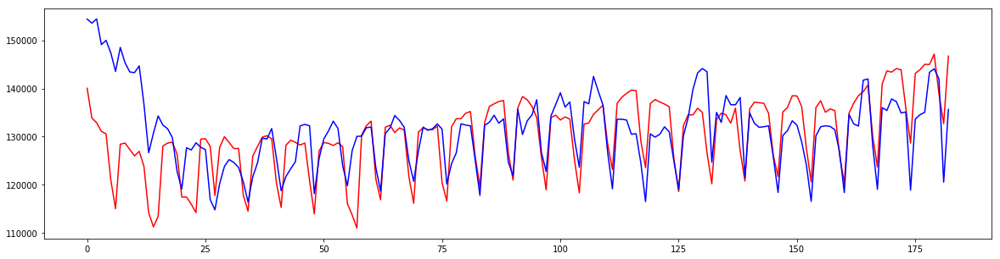

14 :  [0.17128398171190323, 0.044449682636657196, 0.053897859044880703, 0.043311688770388157]


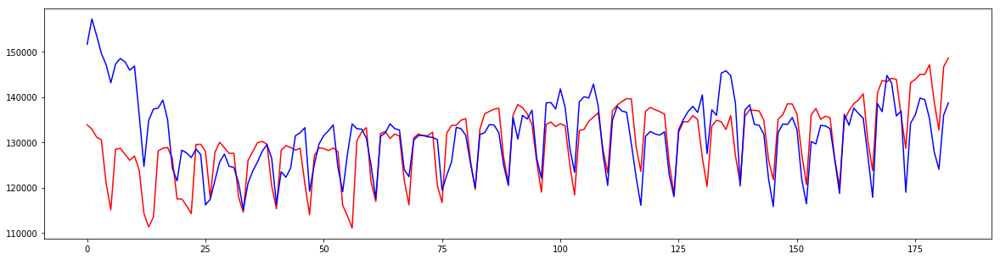

15 :  [0.16808265659120009, 0.046588255209573465, 0.055137535471507154, 0.044402258975016234]


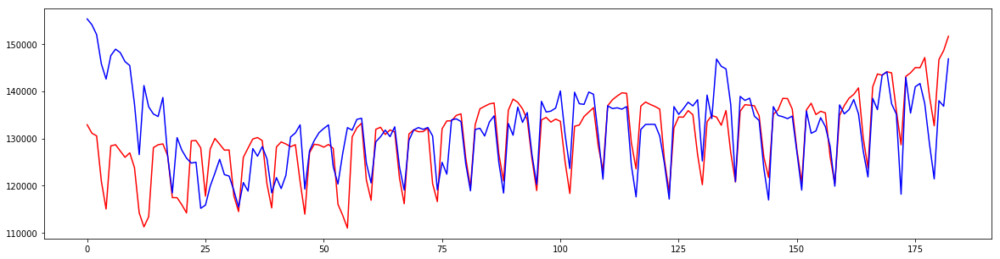

16 :  [0.17455506835873527, 0.048979658078270691, 0.055042238157048874, 0.04233468297733068]


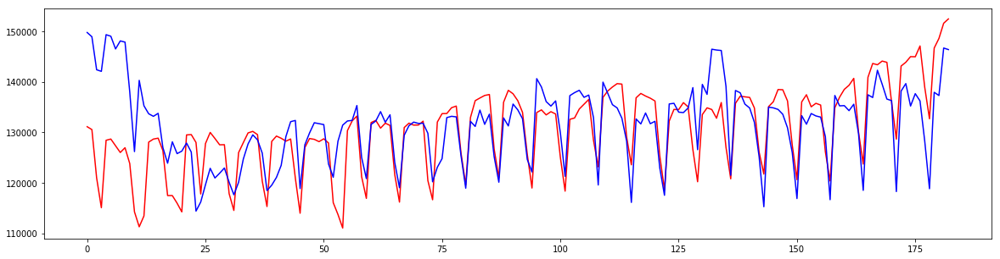

17 :  [0.17859867441024807, 0.046413261324216352, 0.054595639207848545, 0.042652517442724476]


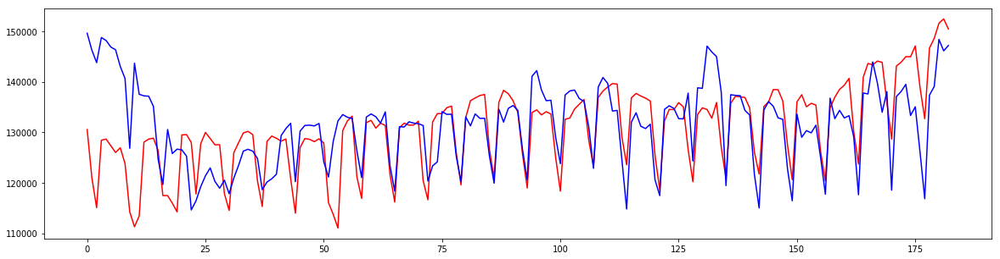

18 :  [0.18854452867751045, 0.04772468855567235, 0.056821218487981821, 0.044770784961939855]


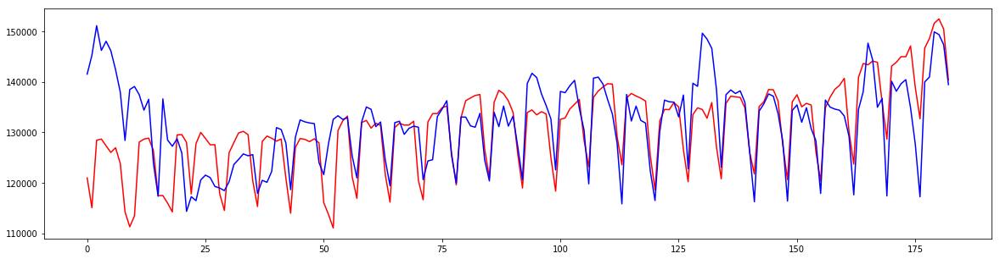

19 :  [0.19456551049758219, 0.050229736466627928, 0.055162150524992896, 0.042424104617951576]


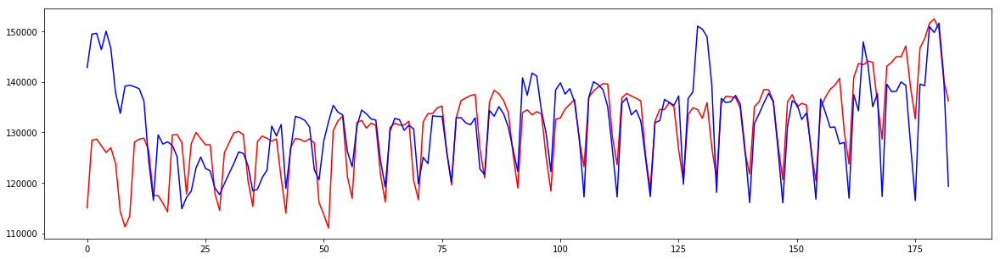

20 :  [0.20292269315892061, 0.050835199730915527, 0.057339098835240597, 0.042353956550786213]


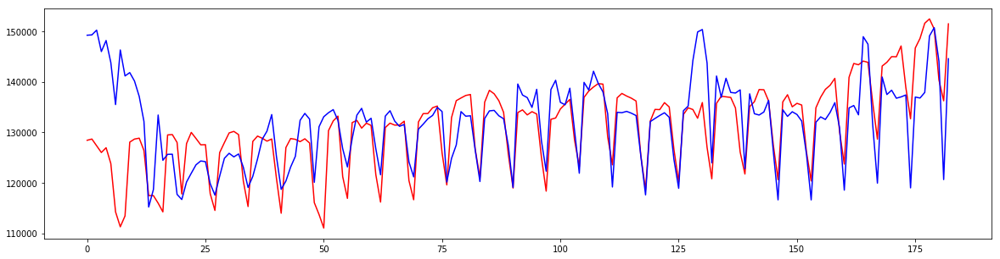

21 :  [0.21827848022423946, 0.055847900515835318, 0.064569020787053344, 0.041603609697680212]


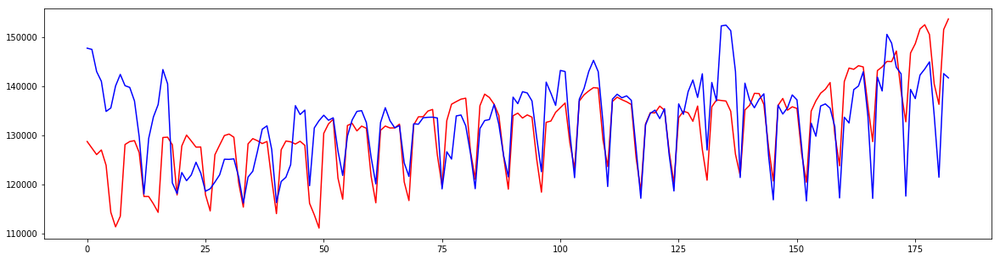

22 :  [0.21887153049995528, 0.058287422510194156, 0.06733383844495866, 0.042409701538136689]


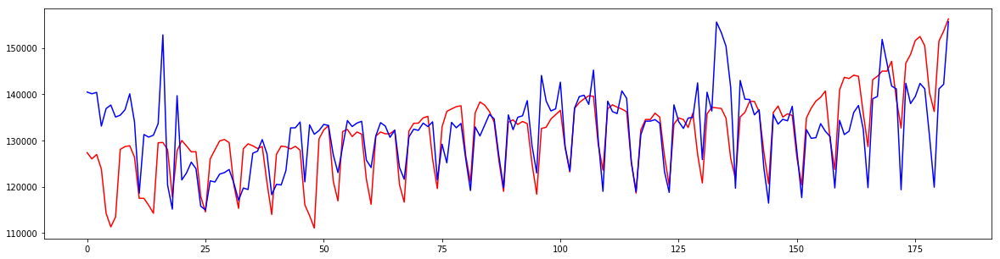

23 :  [0.21695560022081931, 0.059461735889796974, 0.064973335806998447, 0.041623170227966397]


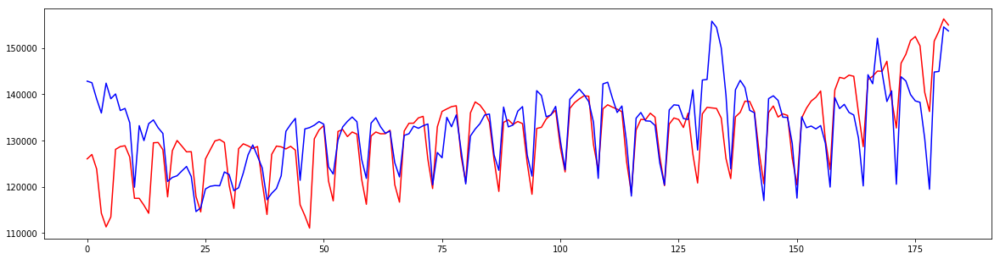

24 :  [0.21357654522313707, 0.055686470165949936, 0.065049996610430386, 0.040993304128468494]


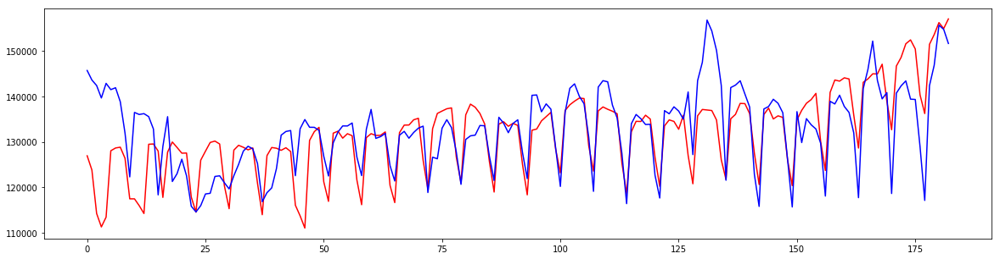

25 :  [0.21284004919251795, 0.056542122407762269, 0.066573004838337863, 0.043854191561896384]


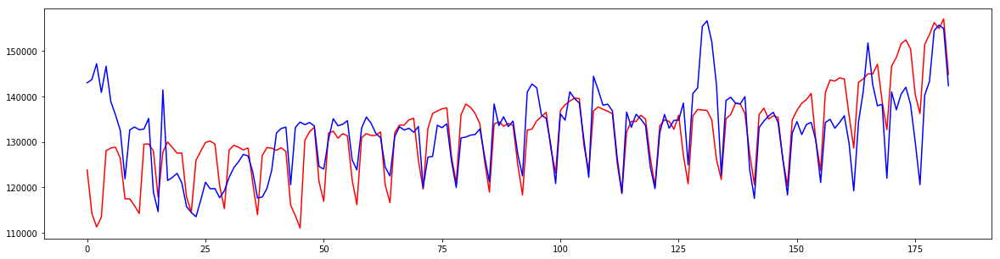

26 :  [0.23240599645500923, 0.057729847141285019, 0.065938296331396556, 0.043278537984669872]


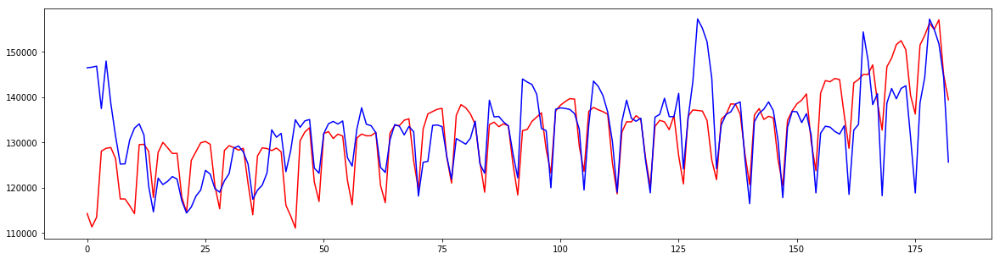

27 :  [0.23084446868711014, 0.061344542101206601, 0.064622618614936095, 0.044094058981464089]


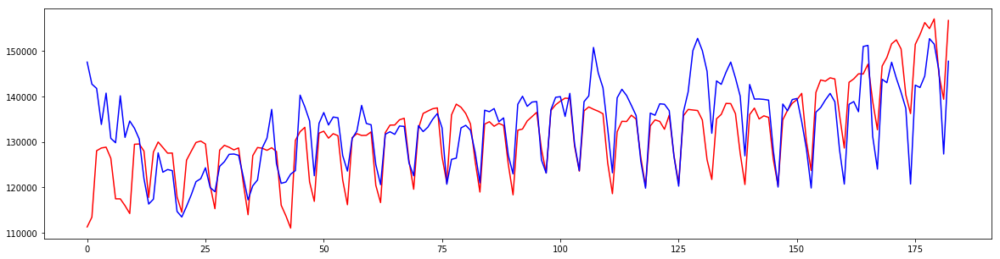

28 :  [0.23475861234448561, 0.063683425768845309, 0.071706181020675705, 0.041347902386445742]


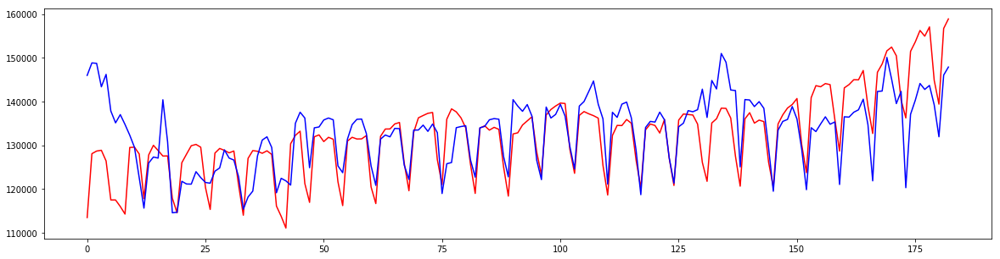

29 :  [0.24626097334695346, 0.064967314637076376, 0.074630586226863554, 0.041099019102299496]


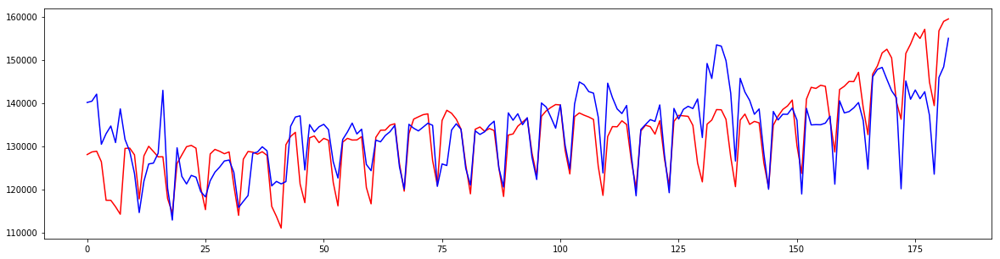

30 :  [0.24476841546182618, 0.065755939347098391, 0.07597962364127861, 0.038606267438163124]
----------------------------
ts id =  6


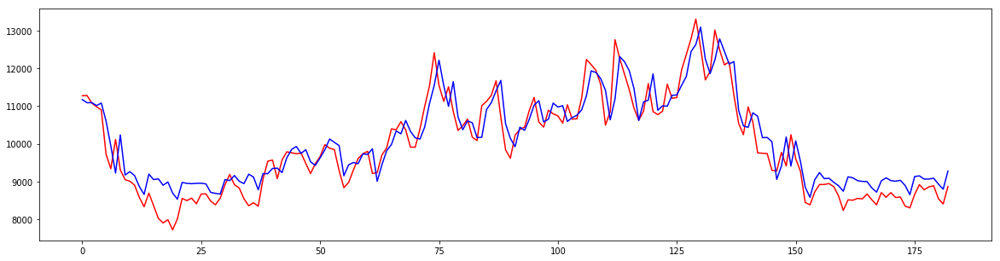

0 :  [0.071468795761135878, 0.032963829992235308, 0.032679194024974489, 0.038936870890677565]


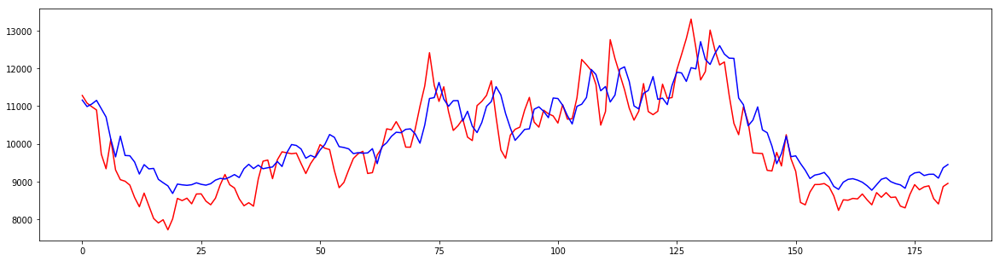

1 :  [0.09588328137797418, 0.046109887308815128, 0.052386180455747264, 0.05231857099084497]


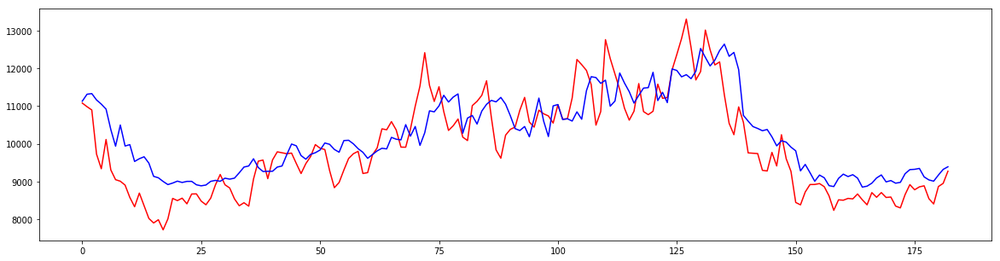

2 :  [0.1223215237539602, 0.054321680124397004, 0.065986242430725414, 0.061147294315043926]


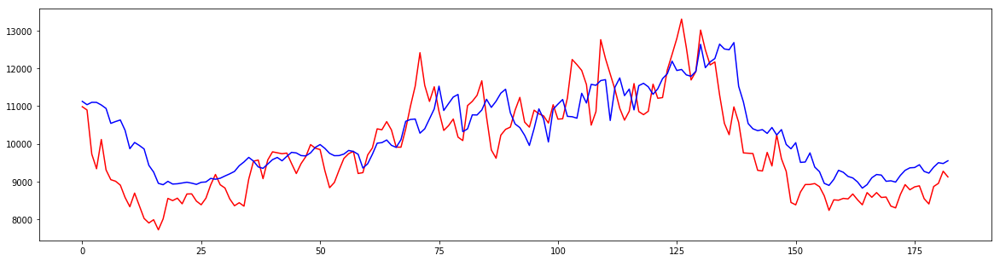

3 :  [0.15566241680001727, 0.055659631702848752, 0.071949425164765074, 0.06736360461587021]


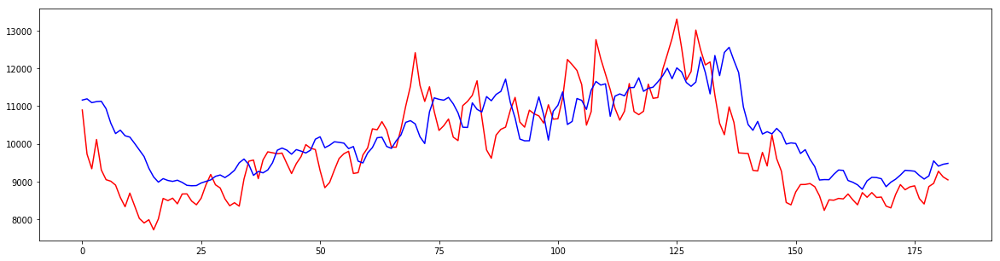

4 :  [0.17479126951167631, 0.059554959985701199, 0.072885200294001959, 0.072034138187337268]


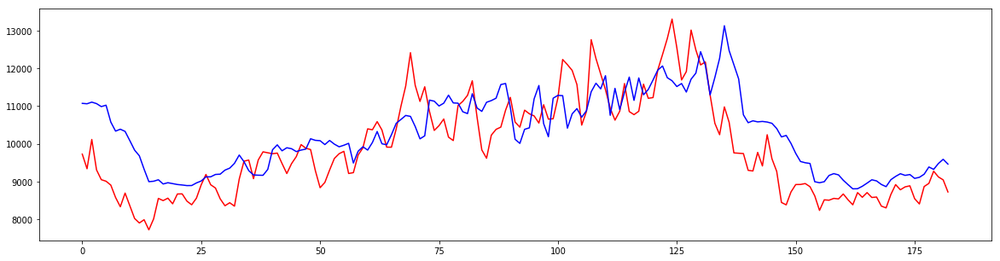

5 :  [0.17229046380706259, 0.061242346734588456, 0.075135800461285887, 0.072792242067040061]


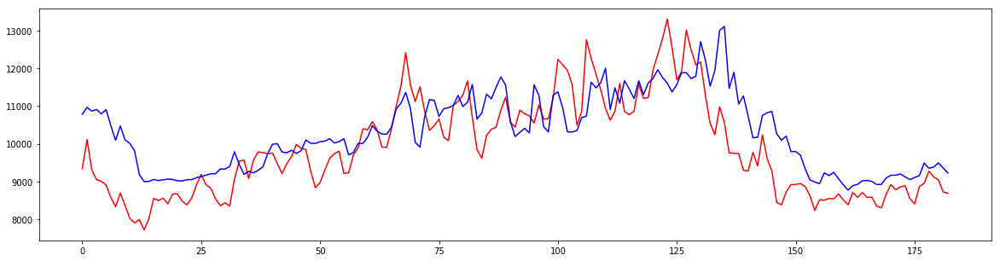

6 :  [0.15389535653881212, 0.061196253318405509, 0.075587226129450624, 0.073423680758024371]


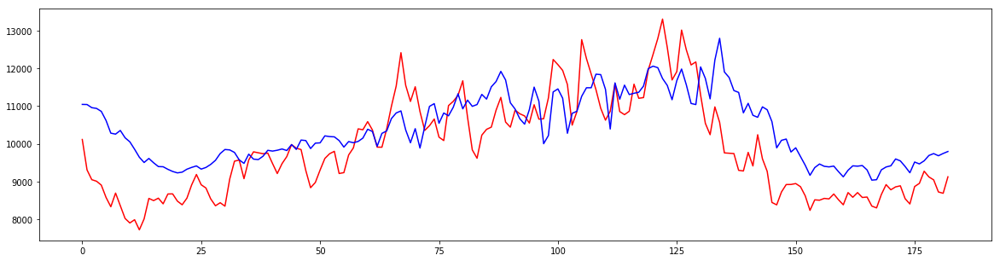

7 :  [0.1709284306491532, 0.063939539953109553, 0.082851192459365036, 0.085519074983878327]


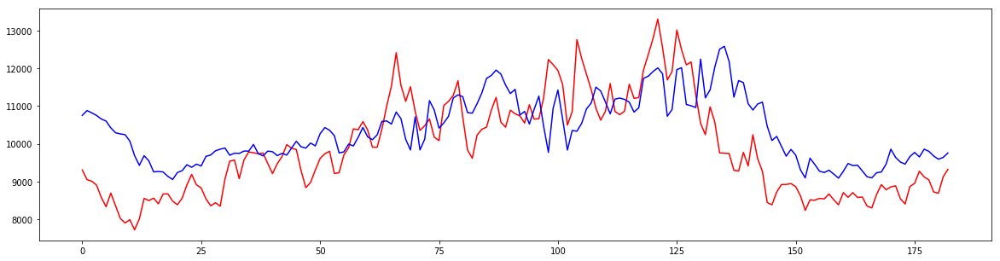

8 :  [0.17268546278686819, 0.058391584011475435, 0.085926353554297549, 0.09103294197505693]


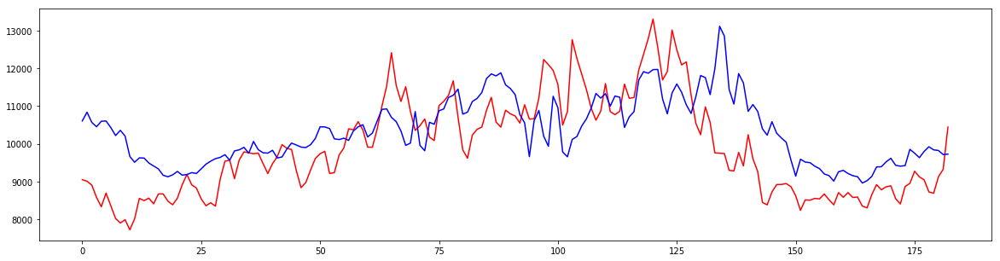

9 :  [0.17133259851960778, 0.057264875933515071, 0.088949559018891303, 0.091501635300651835]


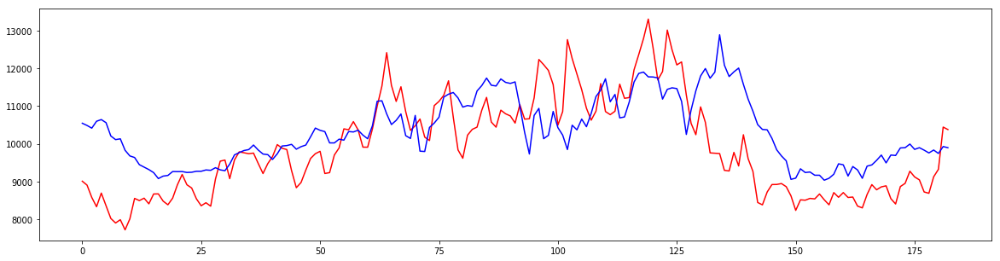

10 :  [0.17224952490226081, 0.058876861985992762, 0.08926899178745186, 0.089400147263750659]


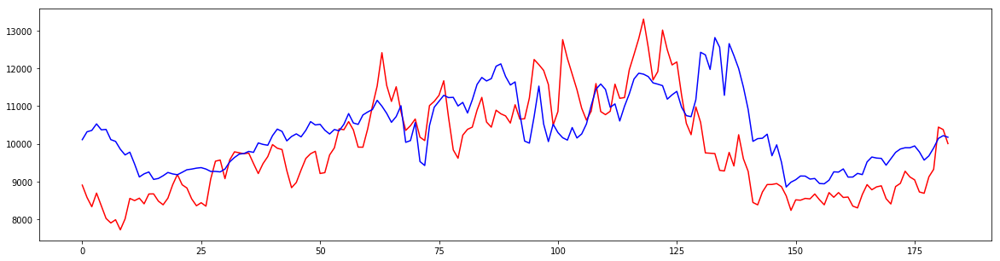

11 :  [0.16884646777395942, 0.058654541219183093, 0.091611419198112762, 0.088844946097166519]


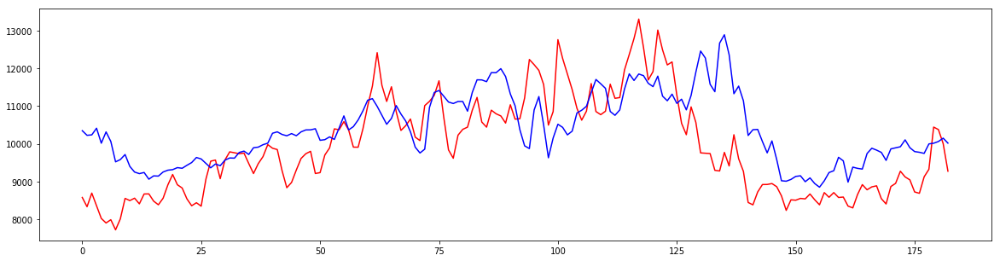

12 :  [0.16156215504008234, 0.055703441210906708, 0.093034366870933929, 0.089712377798834883]


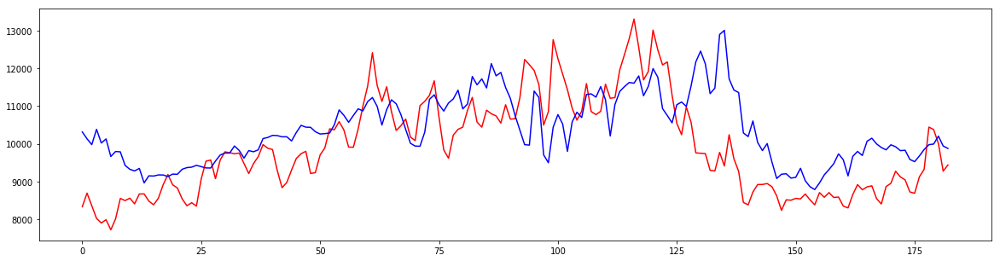

13 :  [0.16684395355737333, 0.058211665018528765, 0.093851179595658071, 0.090239666593420781]


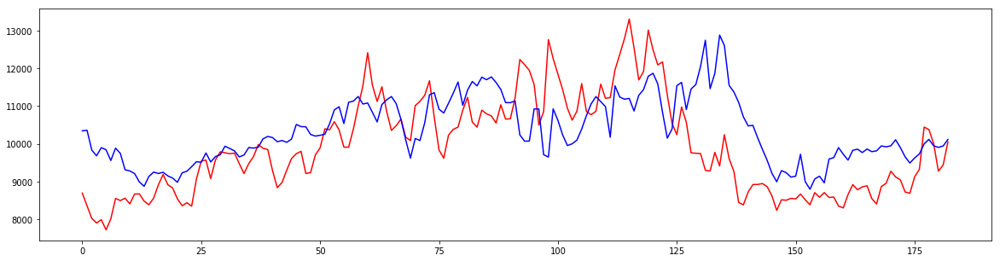

14 :  [0.15902243874170785, 0.056449016027900333, 0.098525801510729413, 0.091922302387146285]


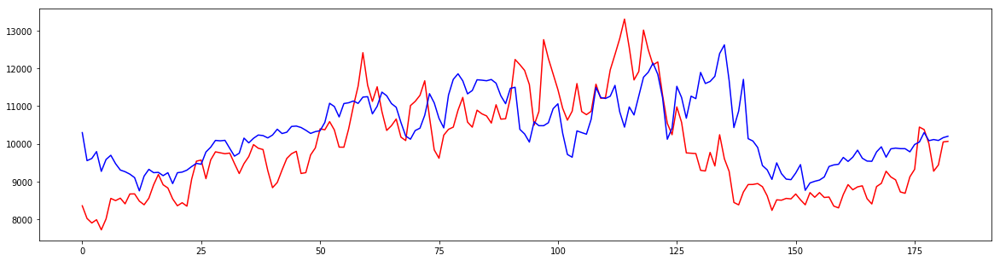

15 :  [0.15938154637412416, 0.056694805701458434, 0.099636667397363751, 0.086272203019786428]


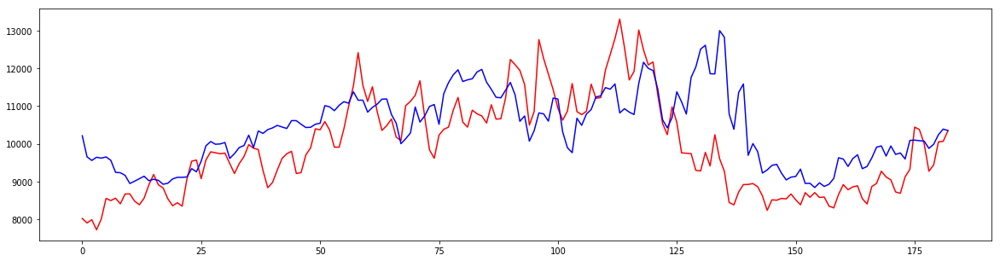

16 :  [0.16180660696985266, 0.057144148433108263, 0.10334302389167703, 0.084671942395597652]


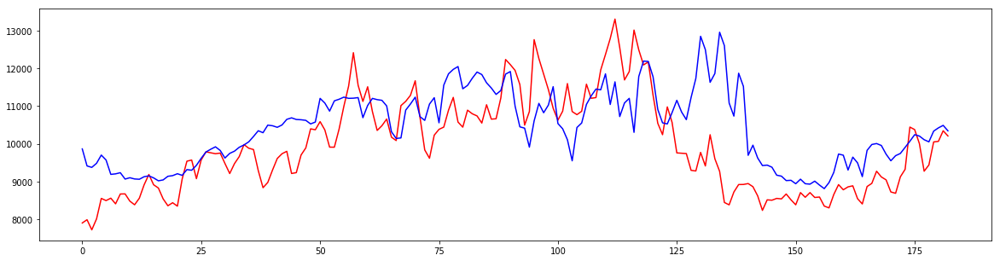

17 :  [0.16247432930009301, 0.055010713979405171, 0.10079120496570908, 0.083891422088071807]


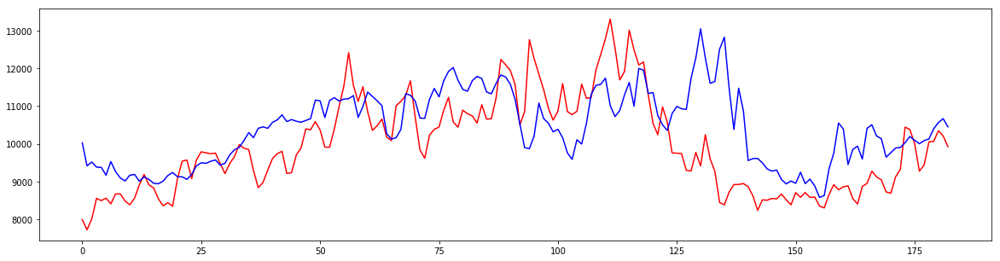

18 :  [0.17243650904752739, 0.055201930293616176, 0.099332224045112397, 0.088504070528382564]


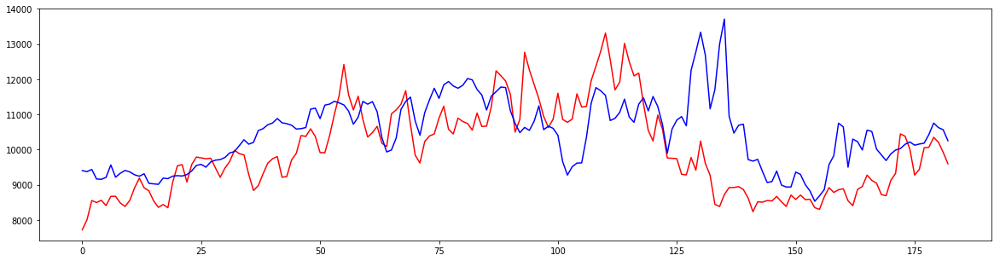

19 :  [0.17083311357990311, 0.055906030804571225, 0.10275019592035717, 0.093498668956168166]


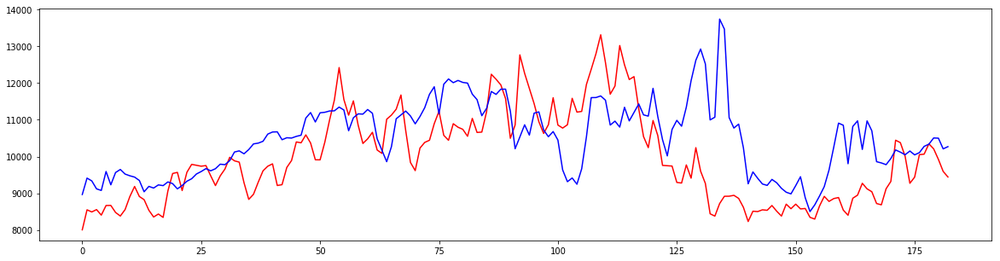

20 :  [0.1655716235748276, 0.055175472899168208, 0.099860364895795153, 0.09502604658192472]


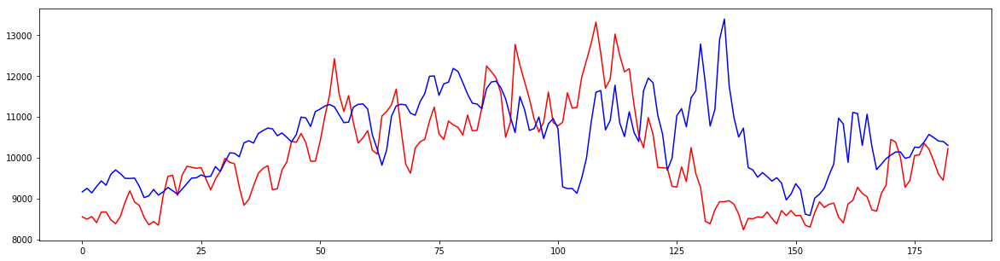

21 :  [0.16309203932018101, 0.056651527447543475, 0.10755435318619327, 0.096512222180719517]


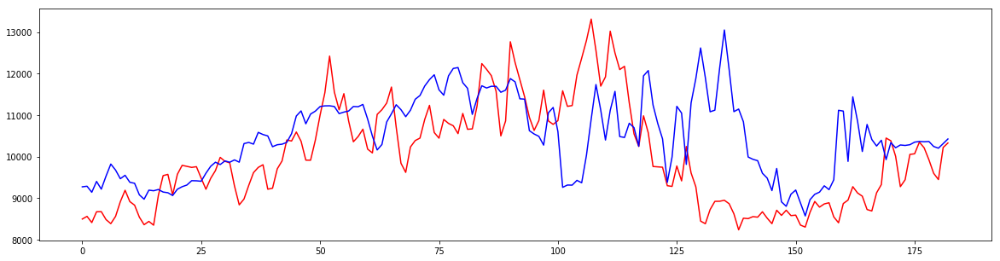

22 :  [0.16553526597795587, 0.056093999520539131, 0.10999903396073851, 0.095386874106189776]


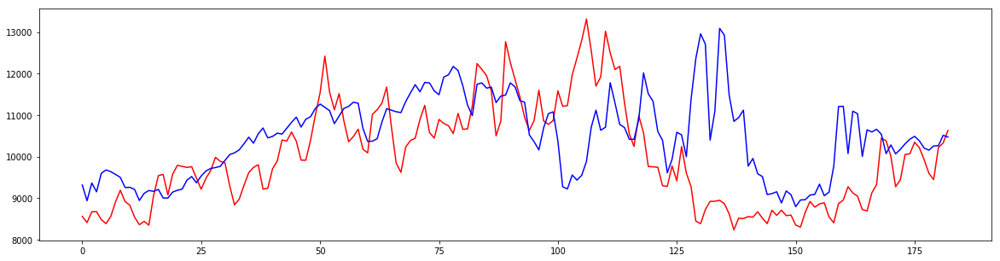

23 :  [0.16844215723742059, 0.059436313825214068, 0.11398660079611637, 0.094724687431734775]


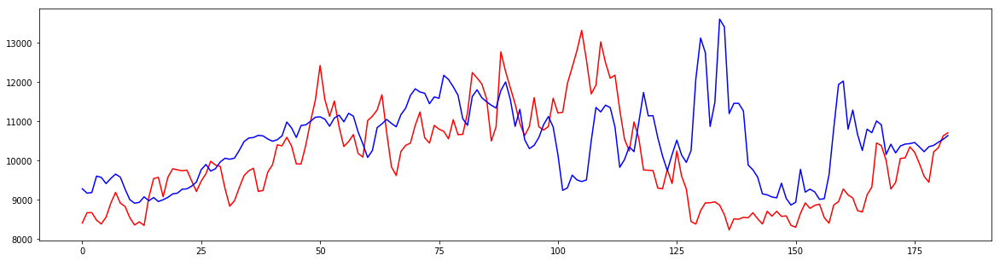

24 :  [0.16127600757437088, 0.058687887763906384, 0.11139390181897289, 0.099310242326791087]


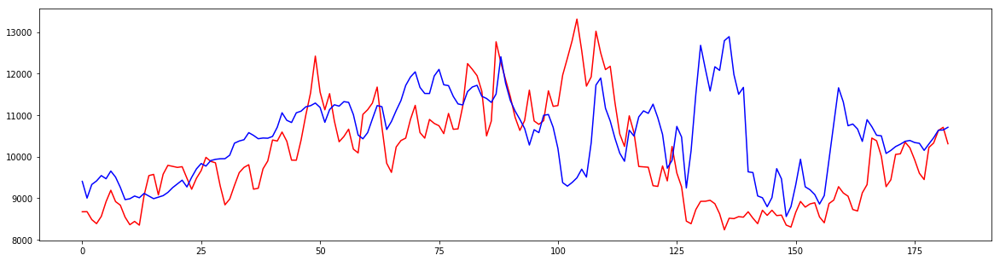

25 :  [0.16031601436195783, 0.061729022385258348, 0.11296583596813897, 0.095250653815021527]


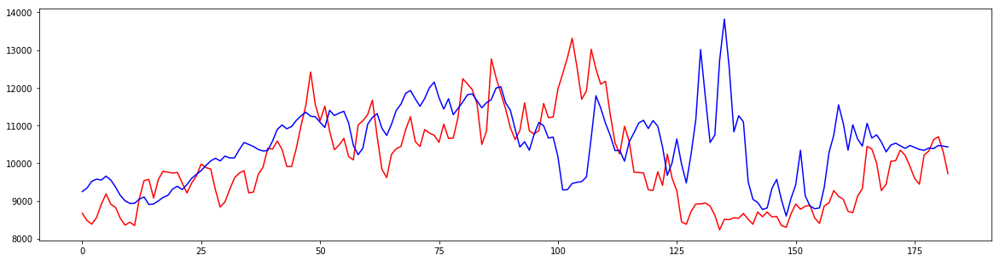

26 :  [0.16043286599881723, 0.063461608228758792, 0.11549145560836573, 0.094972602723157523]


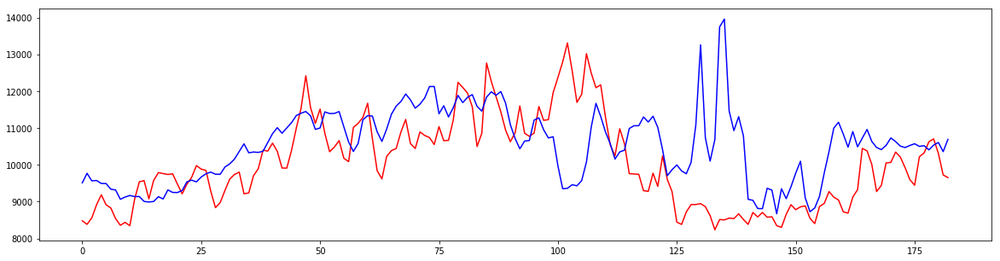

27 :  [0.16011573420019967, 0.061201075498704315, 0.11784247974560016, 0.09372268437129086]


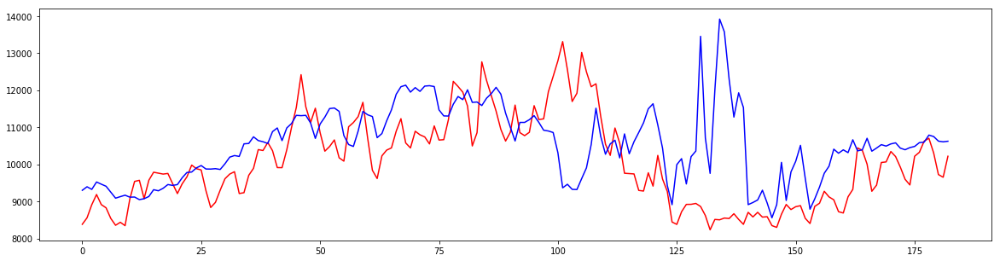

28 :  [0.16604784060590913, 0.059620141699246426, 0.11918417042875641, 0.094859911975486849]


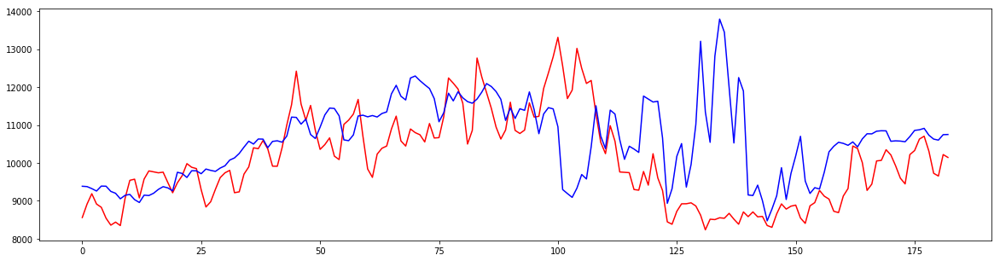

29 :  [0.16442629542880535, 0.056854162829218027, 0.11878723482503267, 0.097455287578818897]


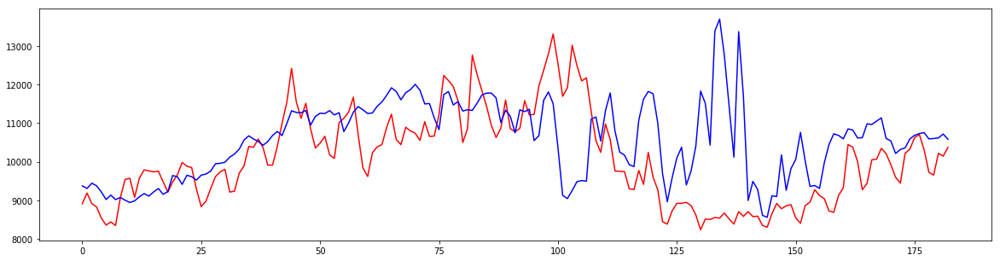

30 :  [0.16807710868775572, 0.057027897563537926, 0.1240955420872342, 0.094924448188778876]
----------------------------
ts id =  7


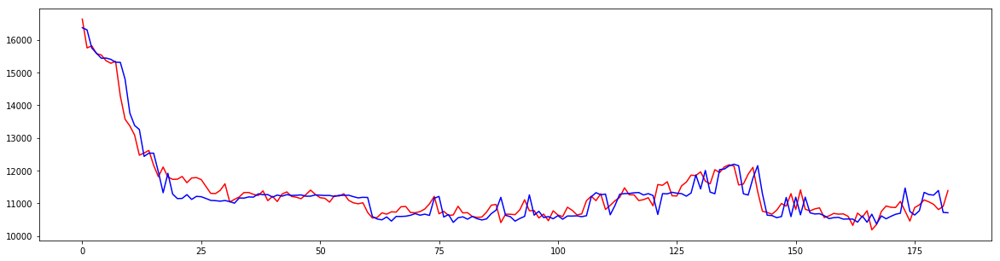

0 :  [0.15128509585039213, 0.021192005775037694, 0.039950877623093968, 0.021708170494783241]


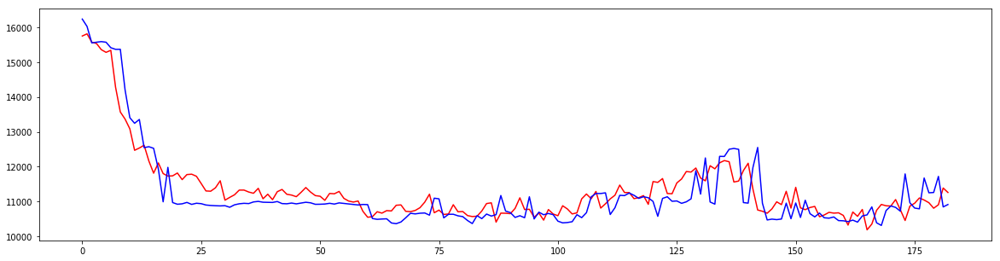

1 :  [0.15915815591408078, 0.029848081214152097, 0.058738090514188566, 0.031541160940361211]


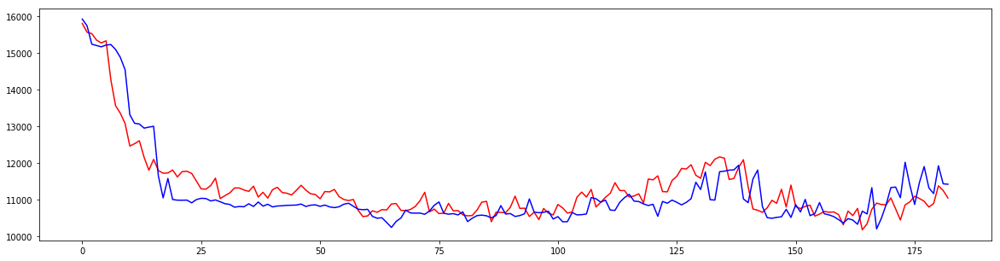

2 :  [0.16958113908767194, 0.035804128822758581, 0.093371756243899248, 0.033438302140402082]


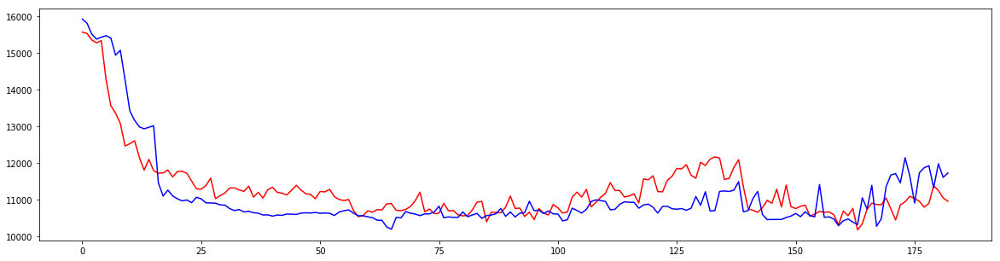

3 :  [0.17225541080141696, 0.03921159137009015, 0.12544369941529049, 0.041544873185614561]


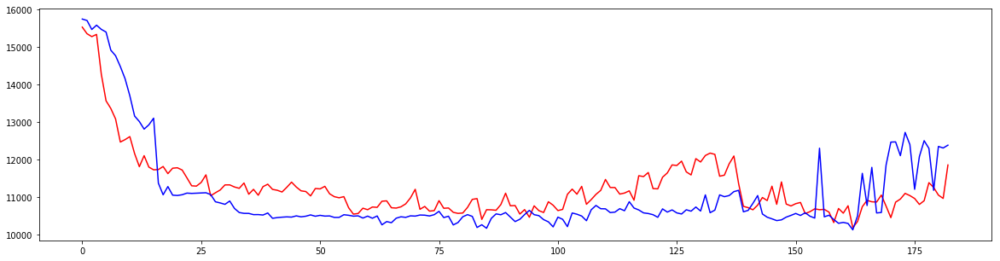

4 :  [0.19063968749178289, 0.041277651059938421, 0.1321015810308743, 0.05310059765978653]


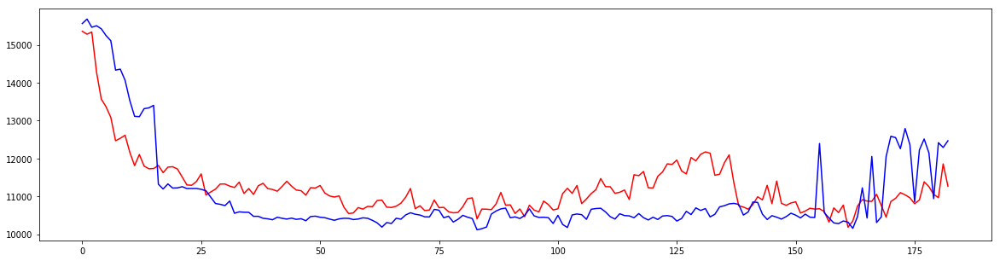

5 :  [0.20101983019169195, 0.046165009471758438, 0.14014066944119555, 0.057381879191251359]


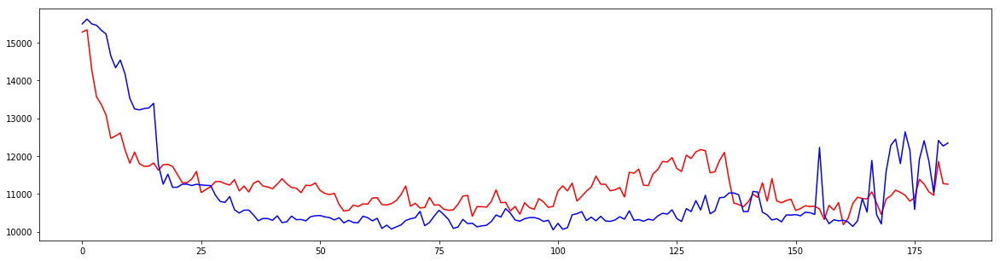

6 :  [0.21377604400503672, 0.052848567326343396, 0.14710364976317156, 0.061958071975744593]


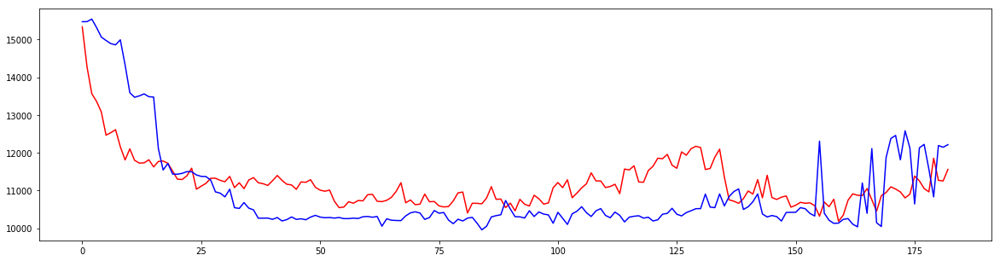

7 :  [0.22600292829477145, 0.05788471102778861, 0.14701636691167164, 0.067612215351791141]


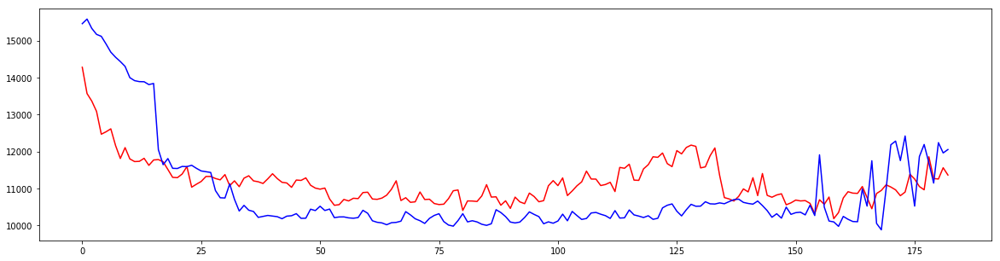

8 :  [0.23024779523597877, 0.062457212221609326, 0.13721258348183543, 0.071037881929706545]


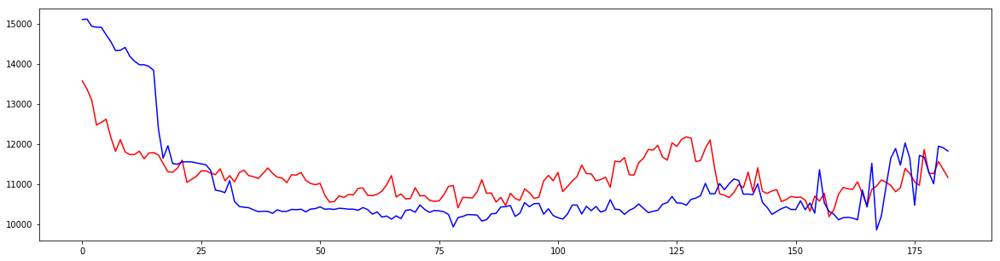

9 :  [0.22797333561250091, 0.066538909553538056, 0.12972168204230855, 0.064128033927274966]


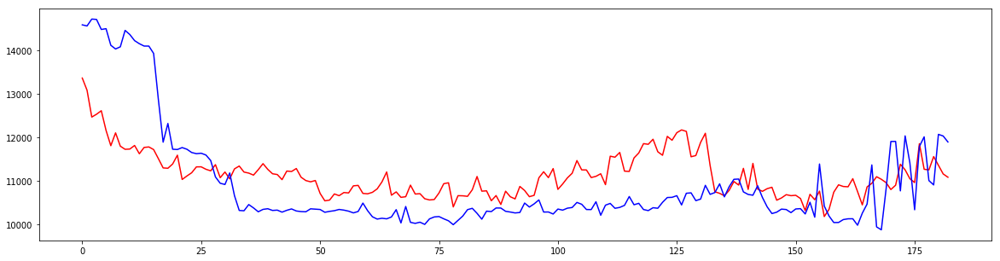

10 :  [0.22695857650699452, 0.06832163028239692, 0.12803864399101406, 0.067234110363594848]


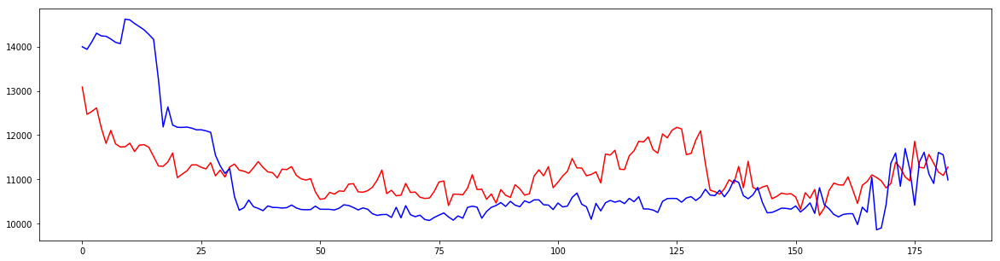

11 :  [0.22624095562565244, 0.072610290639640918, 0.12605299369049605, 0.067746402477667653]


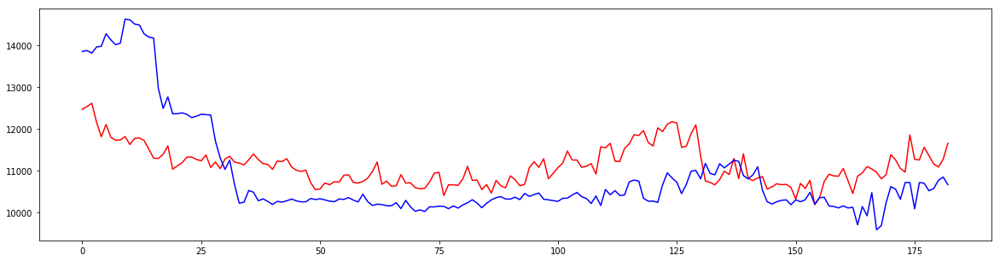

12 :  [0.22864107738816628, 0.072660259764722554, 0.13827691193571673, 0.073172170400254463]


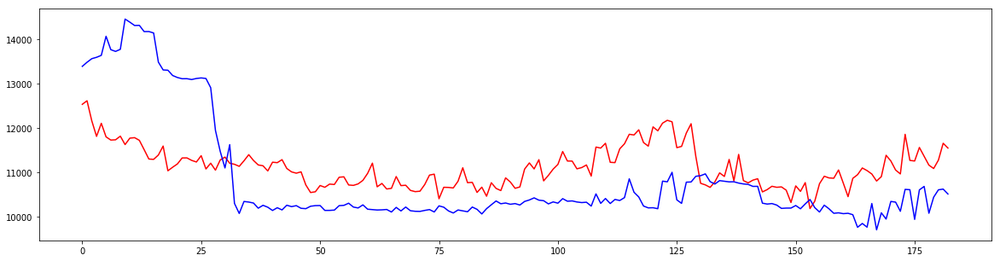

13 :  [0.22322233426886129, 0.0755743325587028, 0.15940297508351997, 0.080842061593405803]


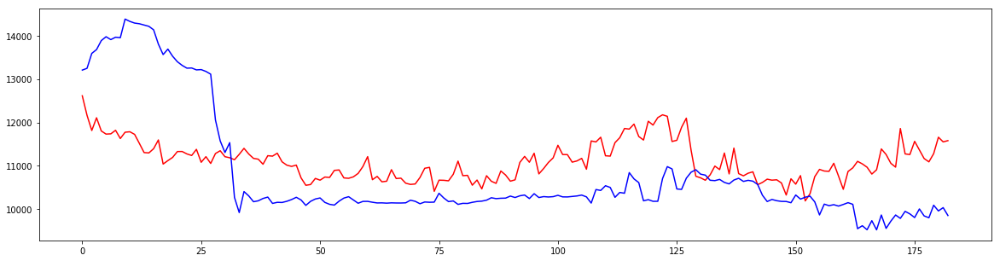

14 :  [0.22032041752692541, 0.078026493503572297, 0.15153356648271815, 0.088818289475932177]


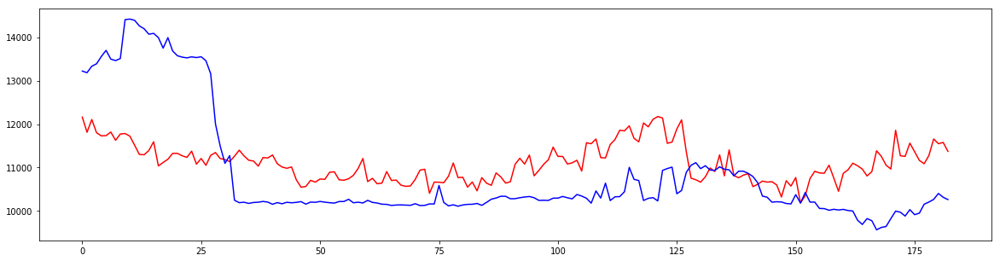

15 :  [0.22466293619990435, 0.07740800105838673, 0.16868783280802446, 0.087046176550002533]


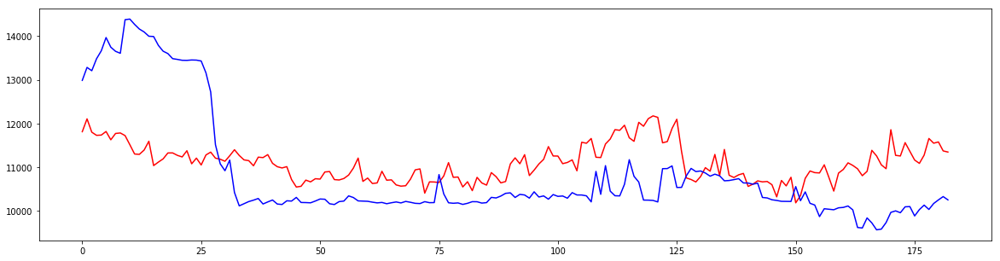

16 :  [0.22544648857800789, 0.080733808836120649, 0.16781800917336806, 0.084463385669710594]


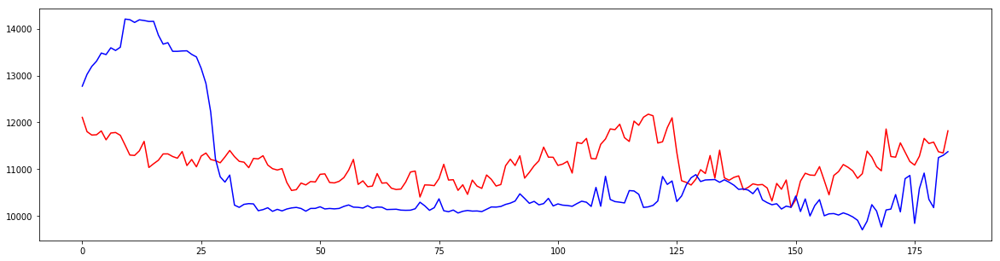

17 :  [0.22708037287911531, 0.083070549473239053, 0.1677605188345446, 0.08344984251556678]


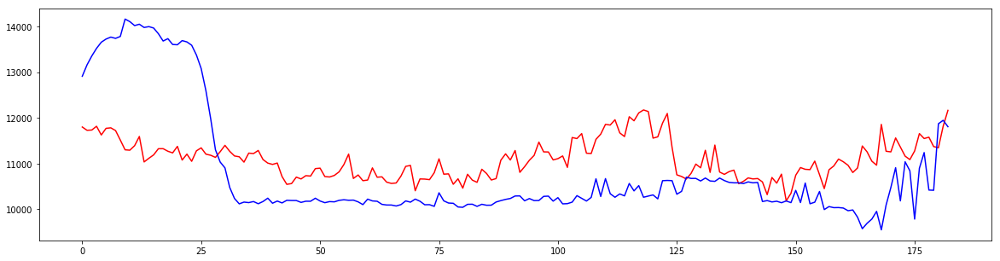

18 :  [0.23030914088115559, 0.086718433525869193, 0.16693572184640967, 0.085835528403426203]


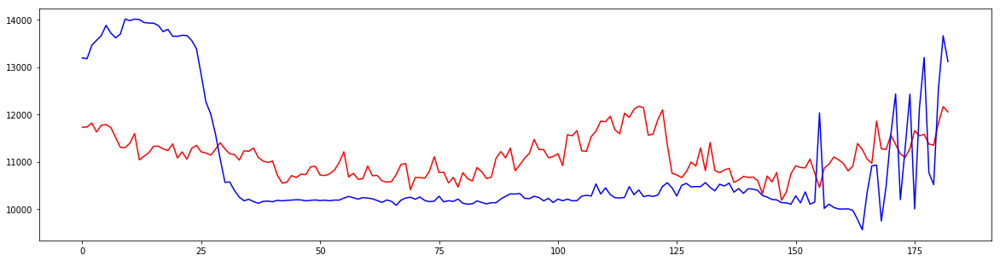

19 :  [0.24675699308709712, 0.094914590949126298, 0.16641296892048241, 0.088007918716981479]


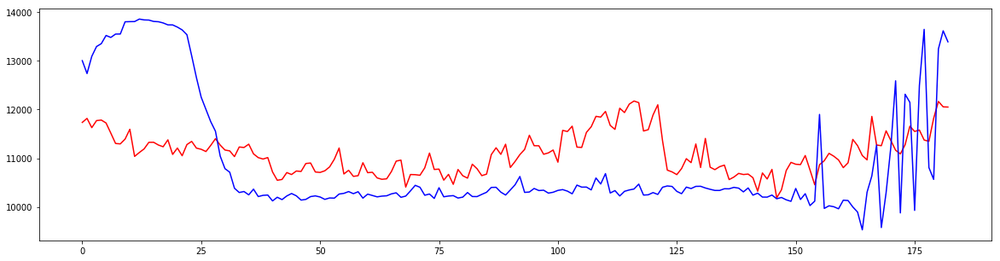

20 :  [0.24900096536518709, 0.092678393656721716, 0.17423138544808303, 0.08374899290466005]


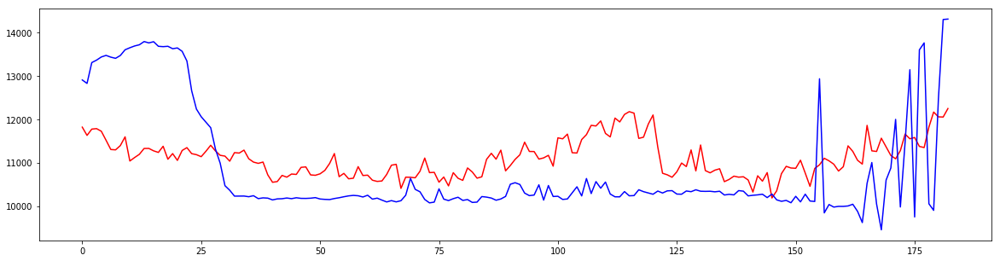

21 :  [0.26042583610286113, 0.1021956255028815, 0.17360425551617625, 0.088922923220462011]


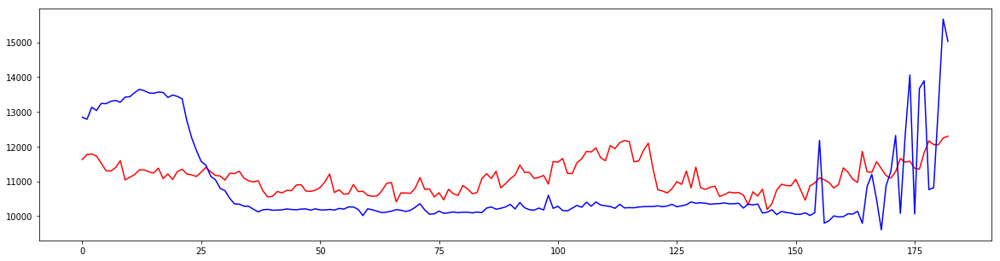

22 :  [0.25631966521934718, 0.10174278957281931, 0.18018090611452695, 0.087259581402661324]


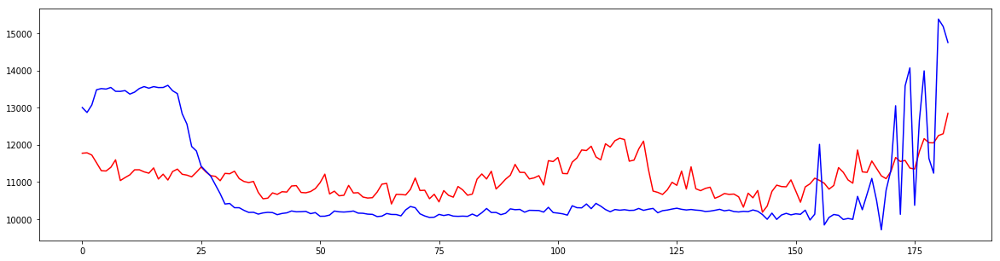

23 :  [0.25852225234976689, 0.10162419609760774, 0.18830877244144748, 0.088114392475227246]


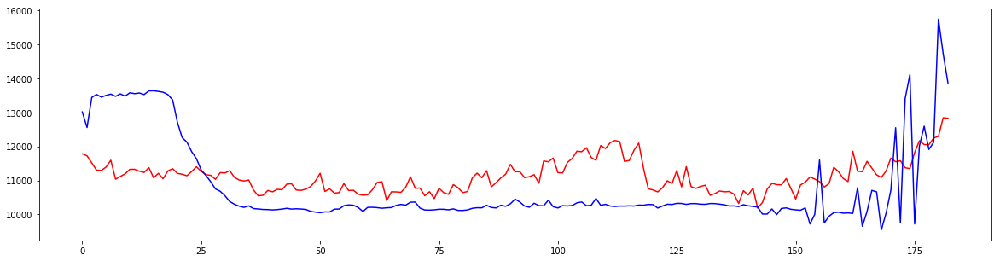

24 :  [0.25788760644412617, 0.098662372826228056, 0.1788307982382345, 0.086298172216906707]


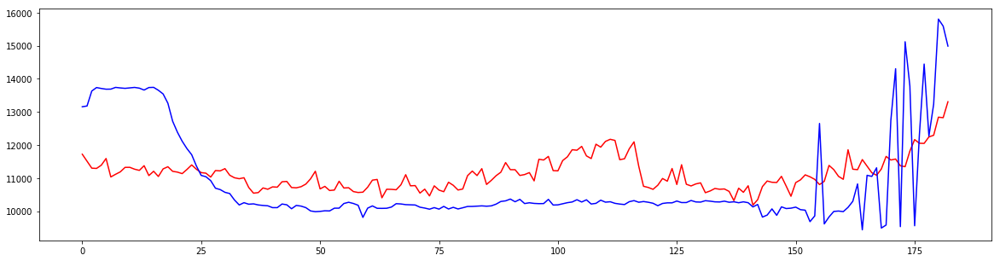

25 :  [0.25933957937014074, 0.10126192098236662, 0.16736577861882421, 0.093041018956216096]


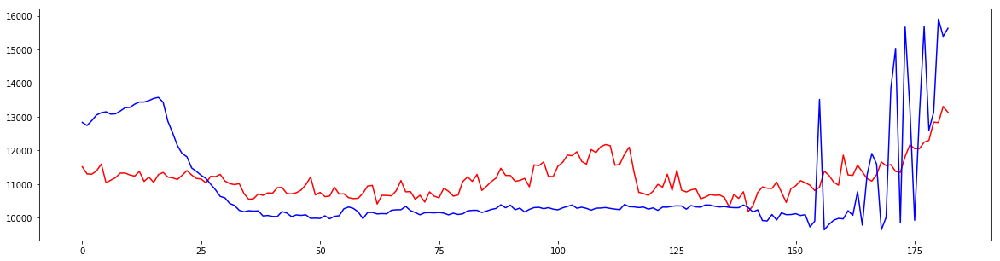

26 :  [0.2557843862414636, 0.10588278822470672, 0.17349843964959233, 0.089400111806619234]


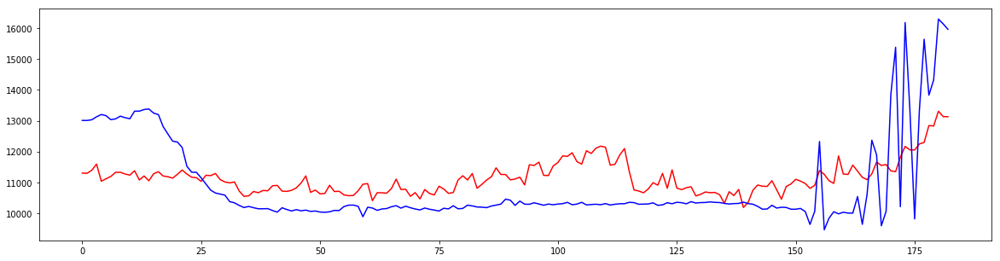

27 :  [0.24888344670024198, 0.10595497878150867, 0.17341165669048694, 0.088852851457449672]


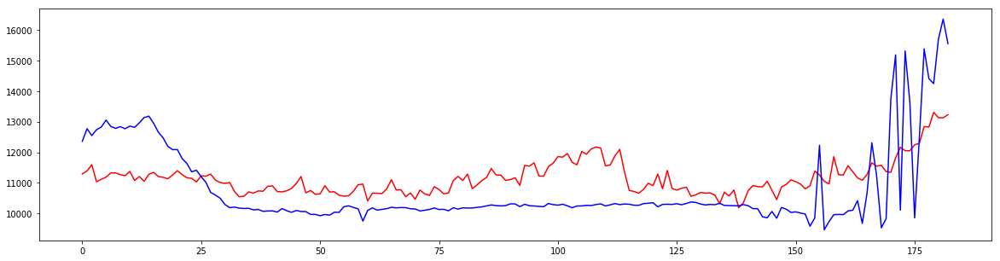

28 :  [0.25498670285682817, 0.10791042514234798, 0.17584295222121776, 0.087101171252013179]


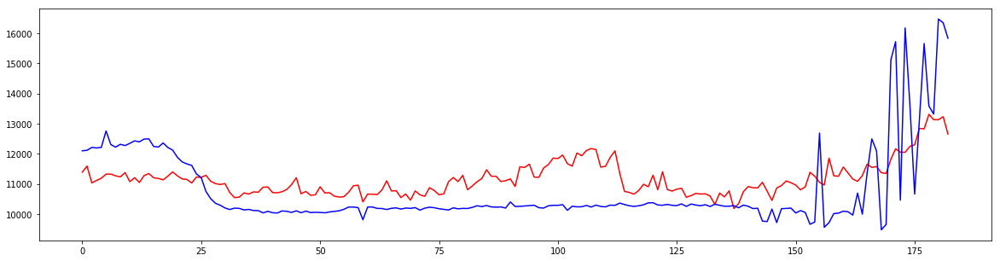

29 :  [0.25104896531335386, 0.10885501554955117, 0.18315957406526415, 0.082699996611271018]


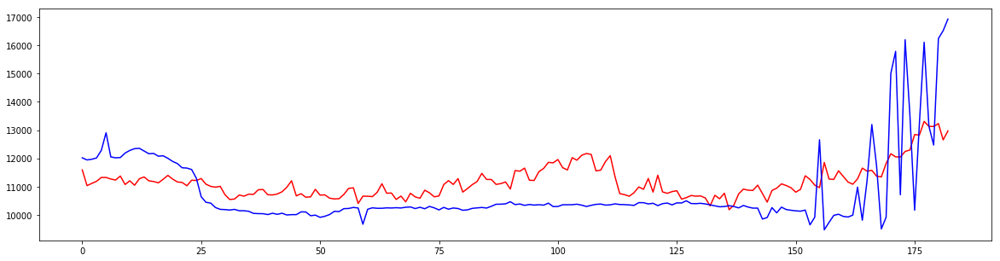

30 :  [0.25230174748375461, 0.10226540413897918, 0.18036009802485226, 0.080180164422731778]
----------------------------
ts id =  8


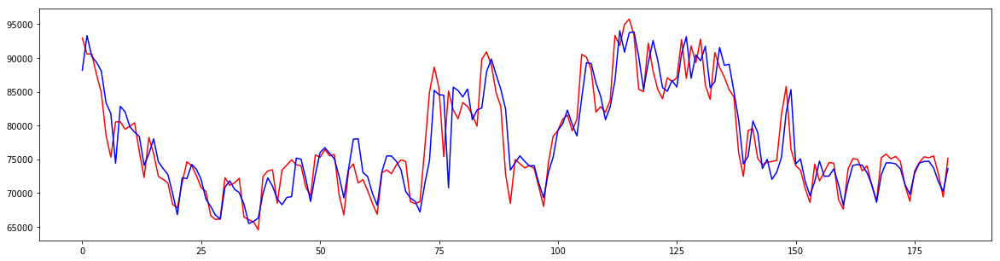

0 :  [0.043215284517571666, 0.024854738632061266, 0.041567773763008076, 0.028256986449549052]


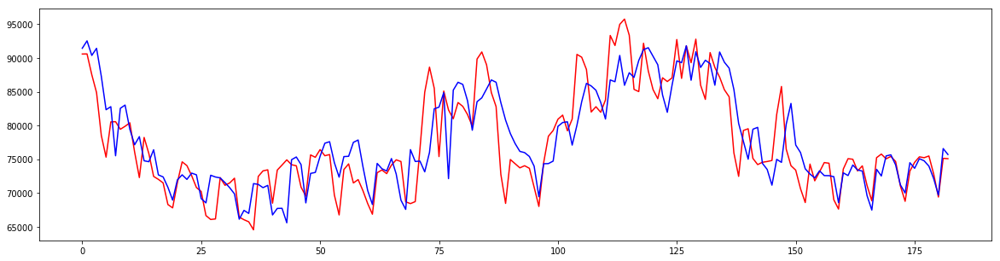

1 :  [0.0597506544452144, 0.036531910650874279, 0.051623810163814017, 0.040853457770117181]


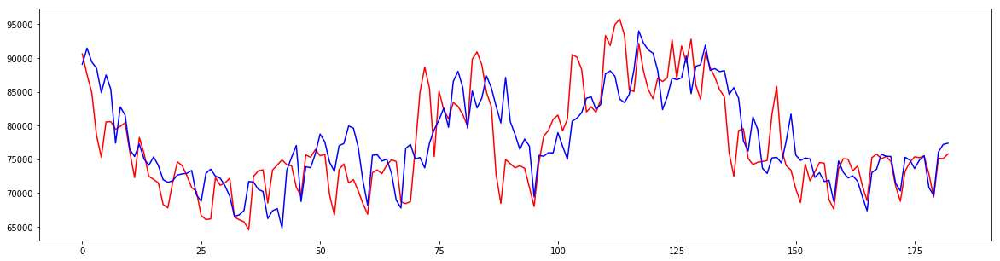

2 :  [0.075326666179007115, 0.042406329794698772, 0.055395042191898974, 0.046582410852416163]


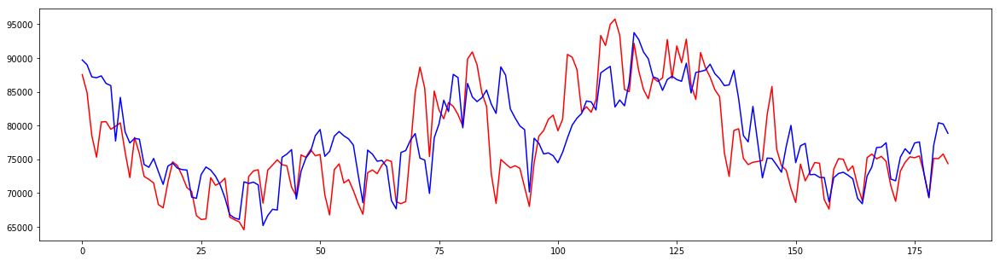

3 :  [0.086509702707881761, 0.046728434751194592, 0.056832573783447179, 0.051550609701899133]


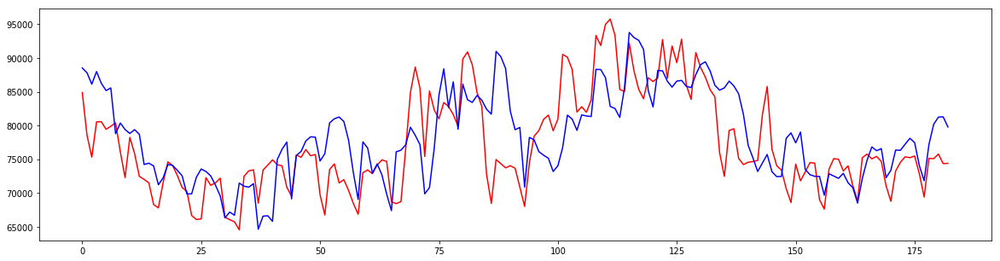

4 :  [0.1030662892041532, 0.051942105270011904, 0.061216498964236983, 0.05656301279232448]


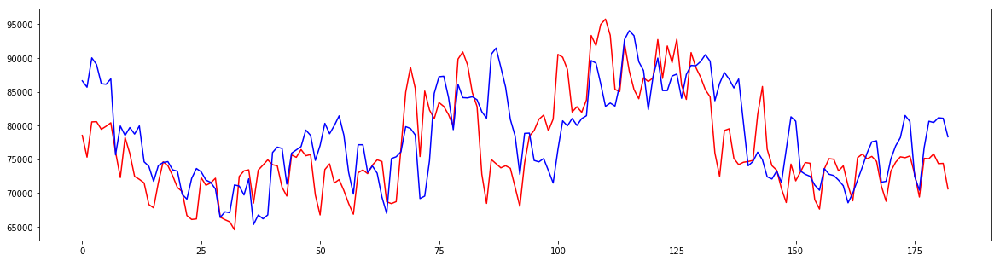

5 :  [0.10050439589880648, 0.052731442032189851, 0.06416670644719355, 0.059916616106496082]


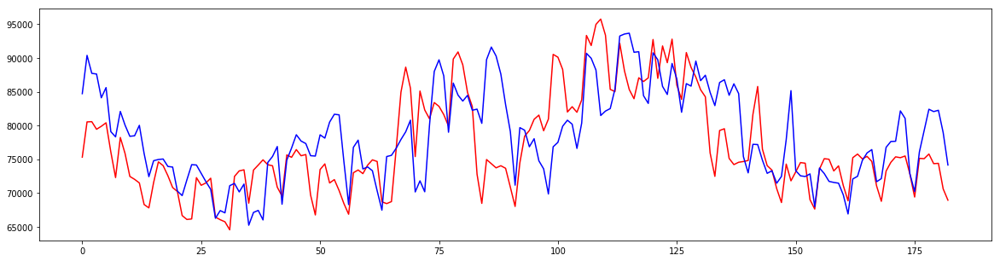

6 :  [0.11001014574873937, 0.056539935342798088, 0.069433954015252264, 0.061074738215137502]


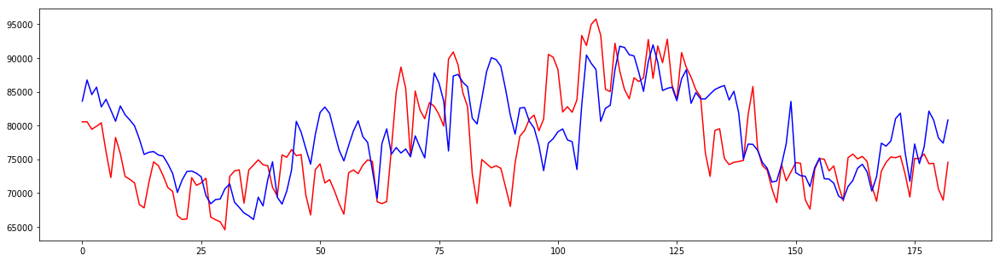

7 :  [0.12143707104790759, 0.06589141900402963, 0.075217080252946378, 0.066537955912857563]


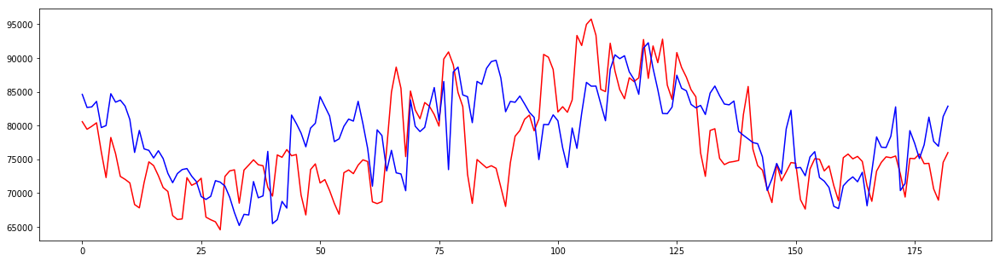

8 :  [0.12708979133856629, 0.073731467869018394, 0.078786633278602552, 0.073178604566345035]


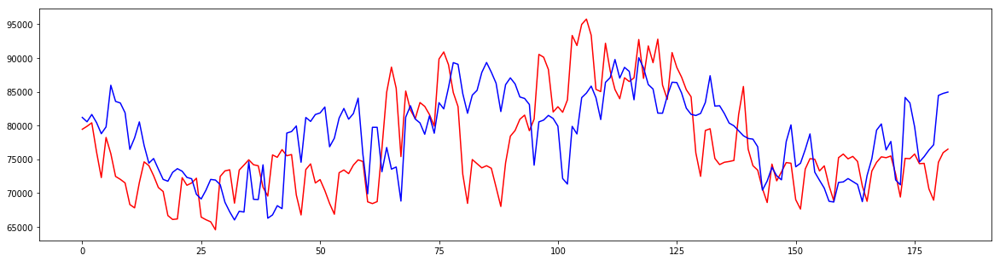

9 :  [0.13104142704153657, 0.081024033670032206, 0.083462666246596193, 0.07346167873318199]


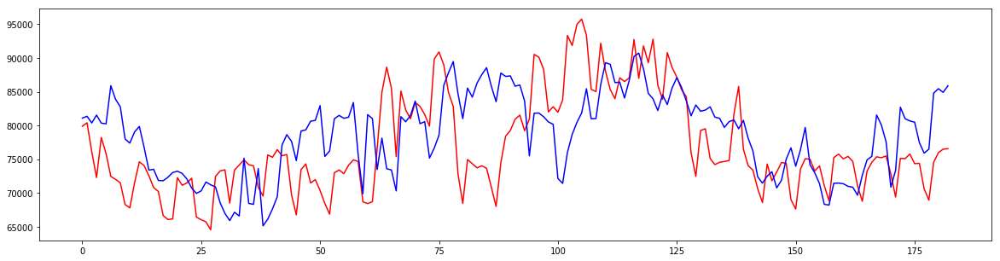

10 :  [0.13561747858554693, 0.08424386053662769, 0.091707223421337483, 0.074604637289458917]


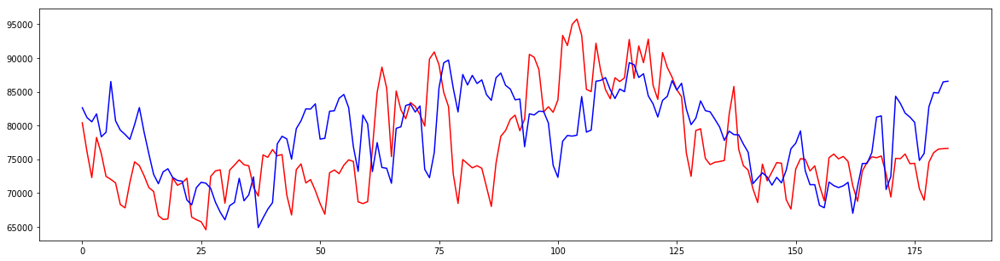

11 :  [0.13975305601544738, 0.084950343621760682, 0.096108418791795144, 0.078306519304111963]


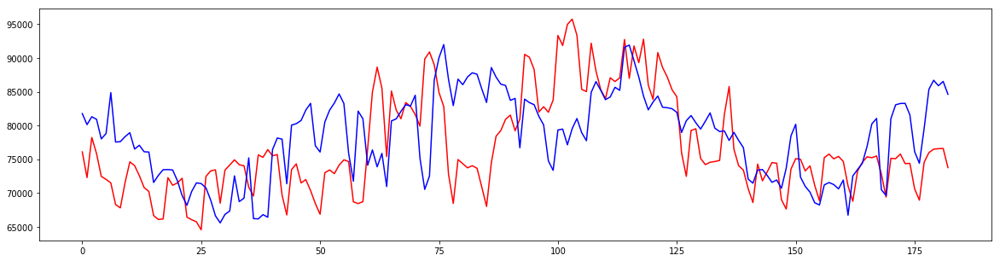

12 :  [0.13838836429239046, 0.080785505859729032, 0.095131724930263978, 0.077597666597320467]


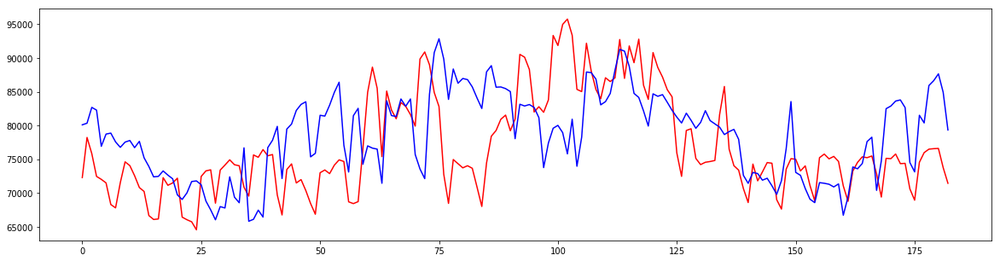

13 :  [0.13982465711183922, 0.077586188283898641, 0.096021657163939289, 0.07795940702319816]


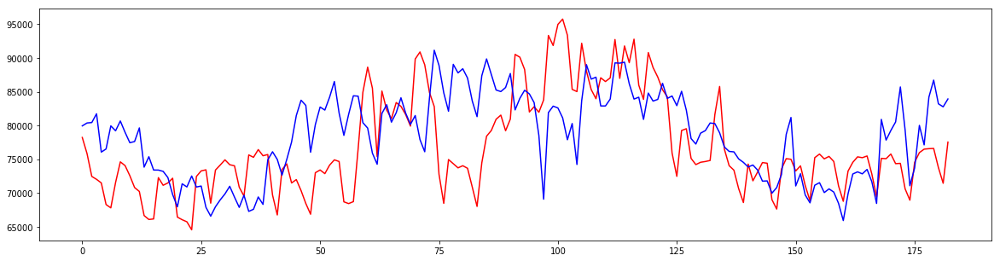

14 :  [0.13377794618833497, 0.087348315910957056, 0.096275445263292195, 0.075056332239628126]


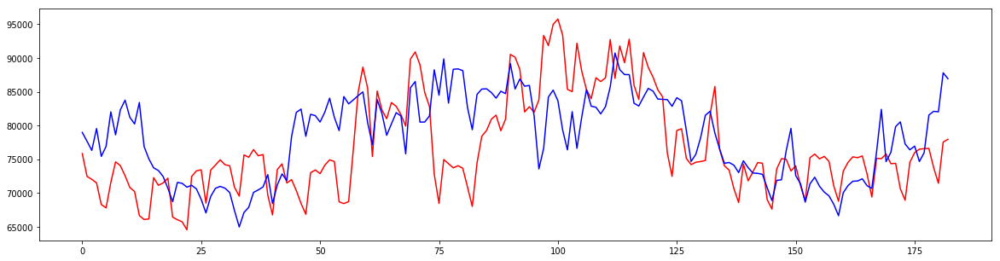

15 :  [0.14668959748136448, 0.087194912070799171, 0.10107142525416711, 0.069717842423277124]


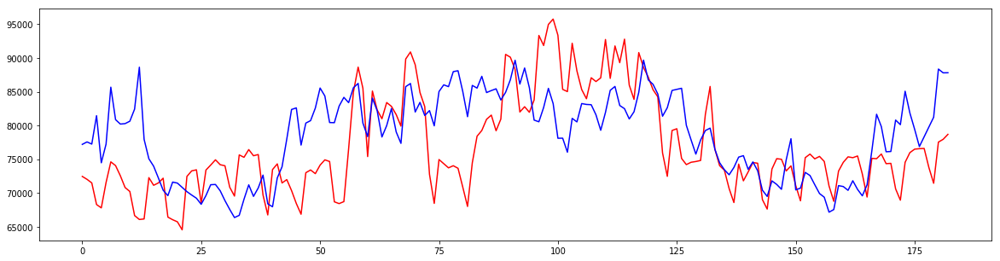

16 :  [0.14776574484482669, 0.082921121336779258, 0.10594468957582877, 0.074092389185133264]


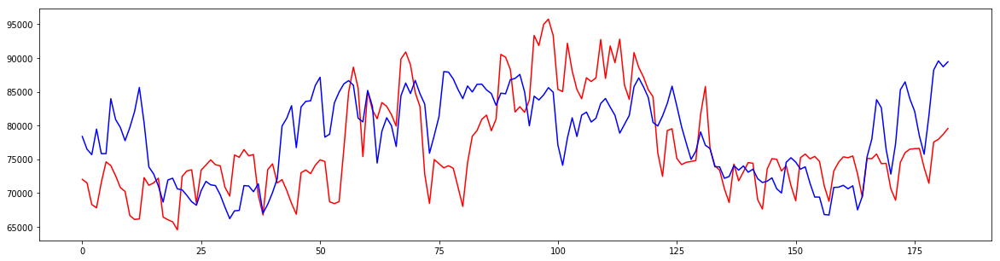

17 :  [0.15374082428188945, 0.078495927505988189, 0.10332207425705915, 0.075223785199202725]


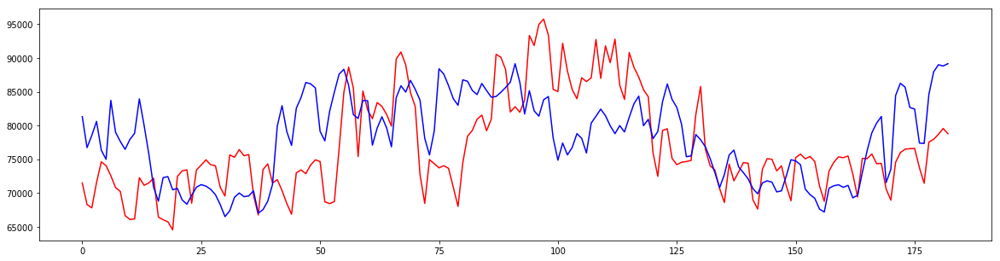

18 :  [0.15663331068512604, 0.080567347149062968, 0.10436496117362132, 0.078037589668478013]


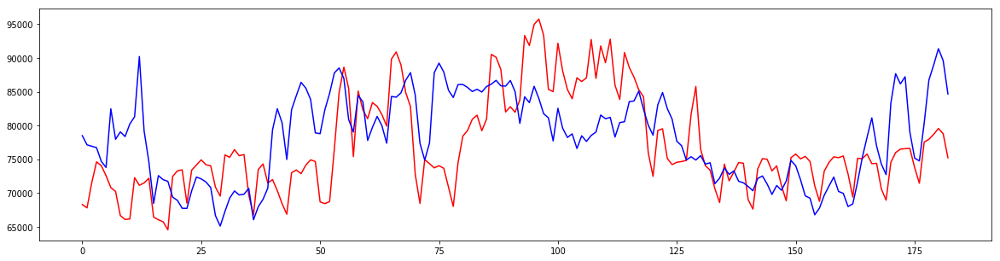

19 :  [0.15609437025552145, 0.08060699127960988, 0.10944059679948752, 0.076205281559750537]


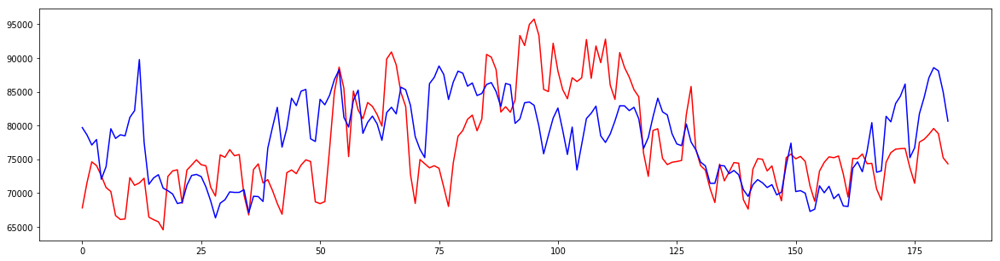

20 :  [0.1638971786375345, 0.085299548889033641, 0.11318784144469644, 0.073637626537921164]


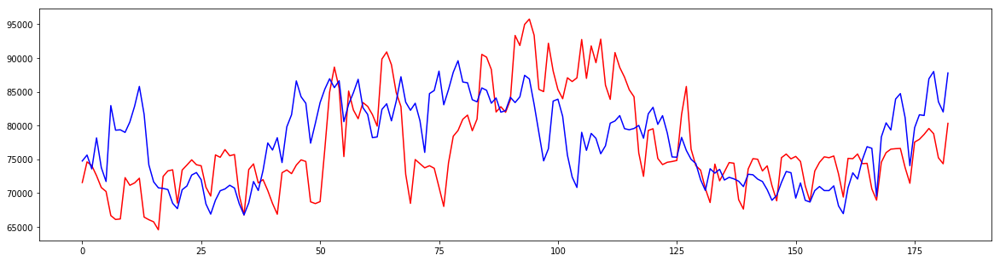

21 :  [0.17487881715427134, 0.087547885059168939, 0.11670545183807915, 0.071888687880320115]


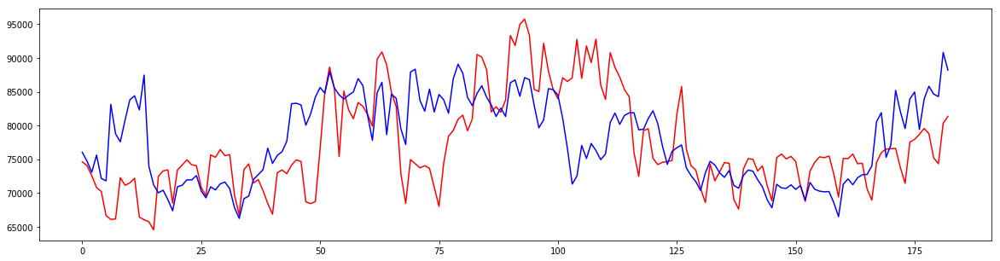

22 :  [0.17825642058015176, 0.084738671815139277, 0.11354775042318892, 0.069644641992173559]


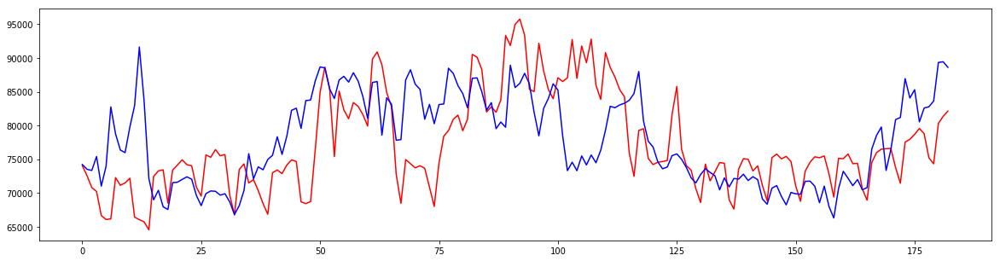

23 :  [0.17662502983176243, 0.078937469130809013, 0.11835114120184137, 0.069670847171057884]


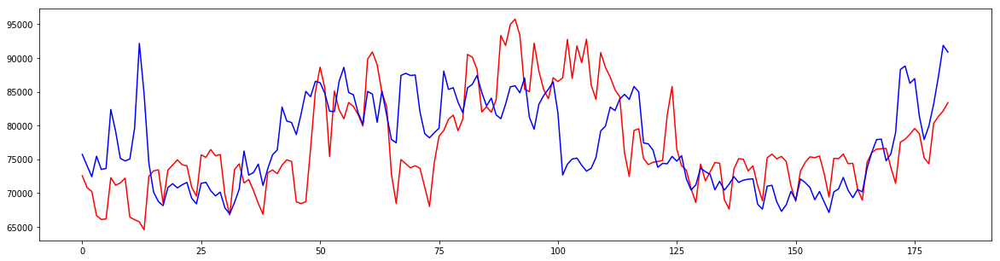

24 :  [0.17727813931577646, 0.08291734098077172, 0.12320523669053575, 0.067910504998162605]


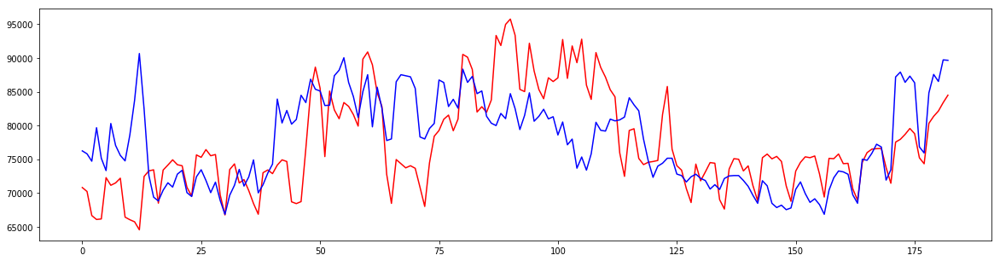

25 :  [0.17326643700813346, 0.090860571616750374, 0.12630983959132946, 0.067124980764331668]


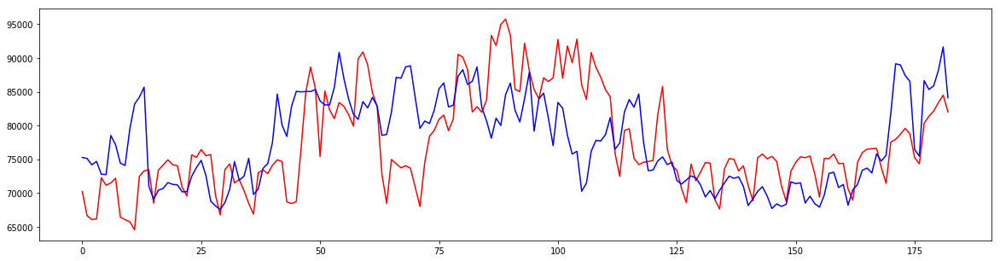

26 :  [0.16668572862263967, 0.09385371754013476, 0.12724524032914869, 0.067183411084259889]


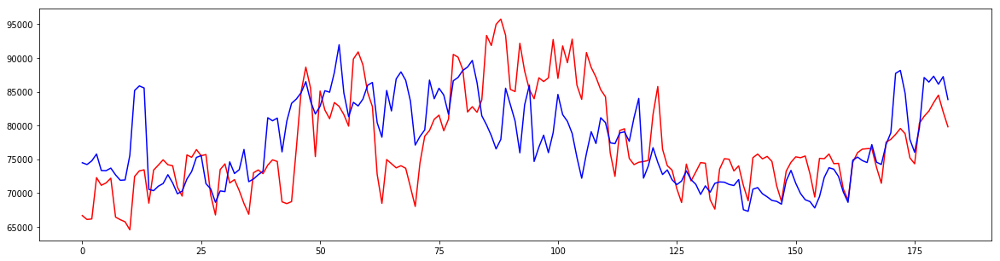

27 :  [0.16309729386029811, 0.091940036844830444, 0.12729358242417196, 0.063216346332782586]


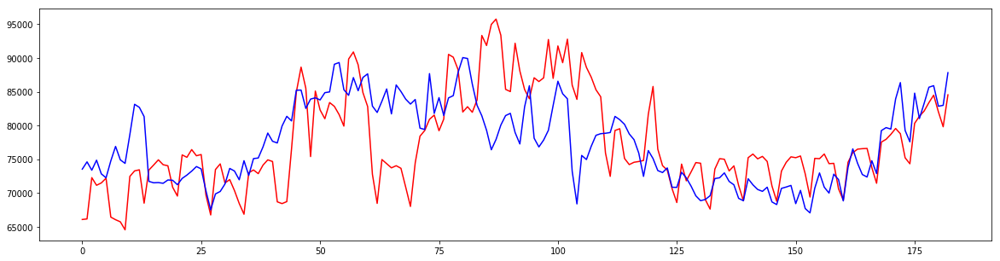

28 :  [0.16157645109255908, 0.10091193926008145, 0.13194256319099784, 0.061925484150960011]


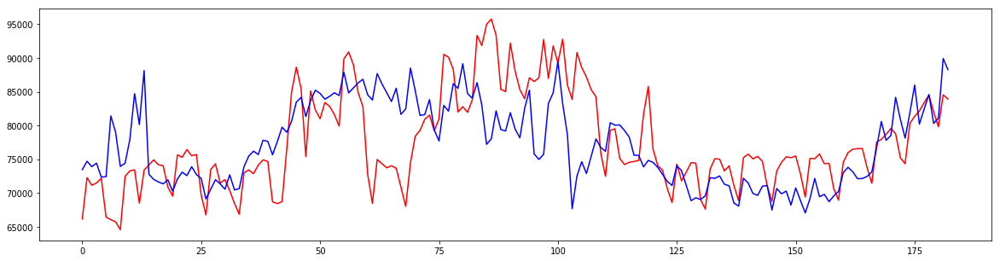

29 :  [0.15238834179599811, 0.098461269176781177, 0.1406662125942176, 0.061821693508472664]


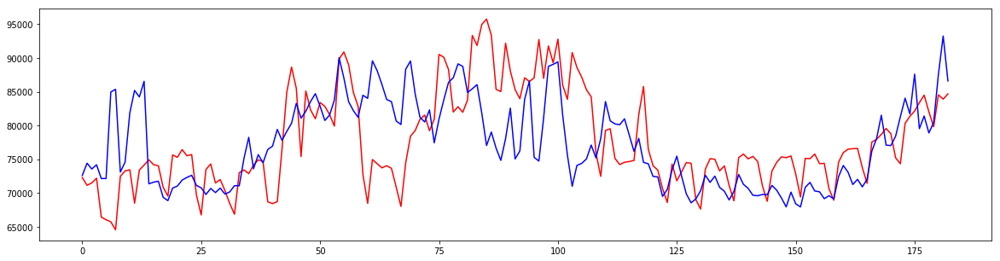

30 :  [0.16882445247990549, 0.097547962746604239, 0.14000470341711124, 0.064546235023180895]
----------------------------
ts id =  9


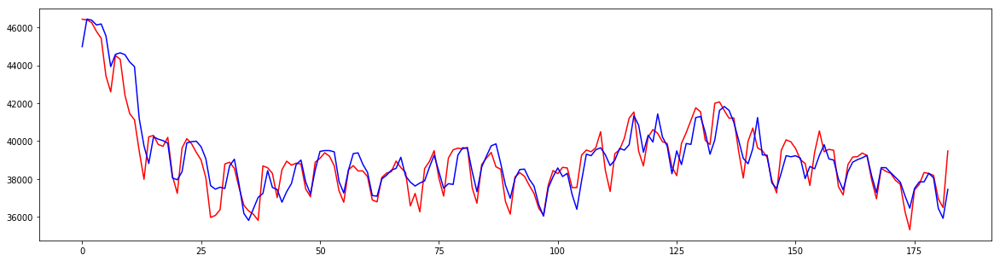

0 :  [0.12074588576280687, 0.017741489857376648, 0.043070313419437976, 0.015682704462983553]


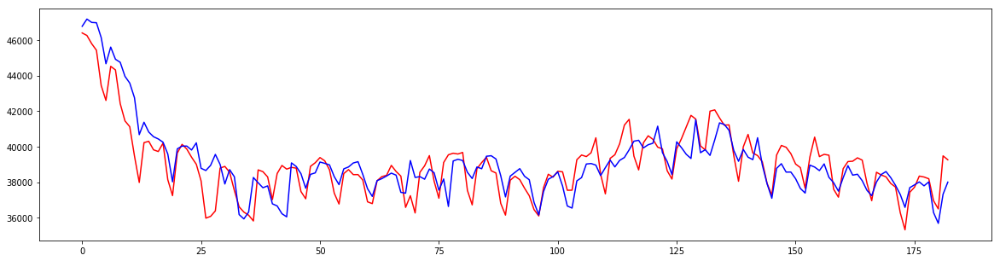

1 :  [0.13540154946902283, 0.023531577530088287, 0.055212594151145704, 0.021128287399775111]


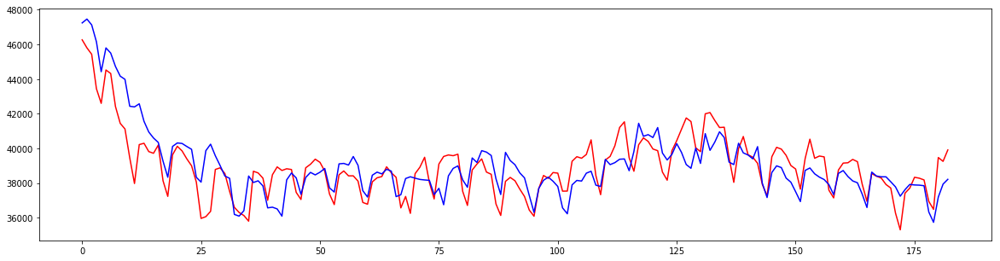

2 :  [0.14552126819945879, 0.025316473986908575, 0.060949094712843641, 0.024499420059375426]


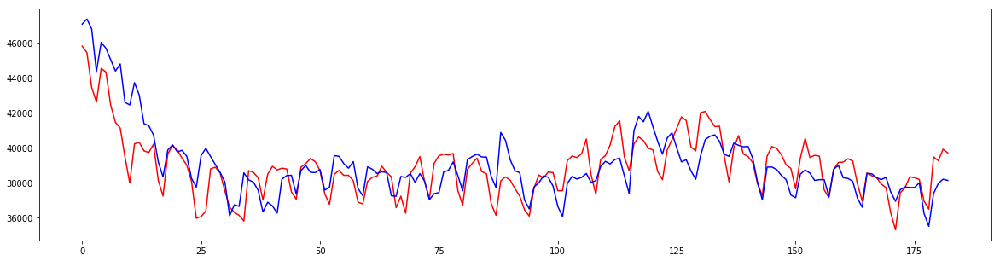

3 :  [0.14815213137810329, 0.026243525108791136, 0.060742547292272506, 0.026521857838618726]


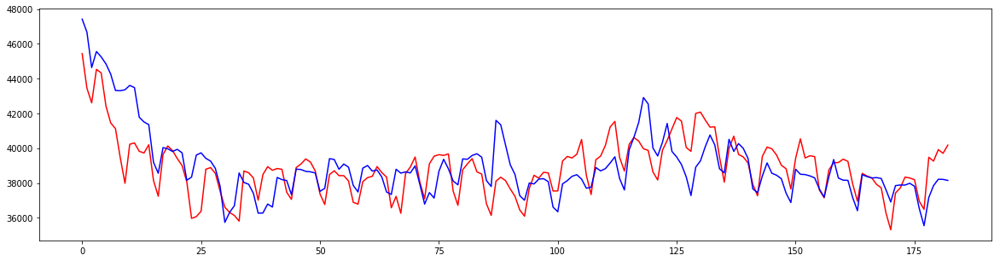

4 :  [0.15405851527900372, 0.029772961014620975, 0.064228325015997692, 0.028330563481560284]


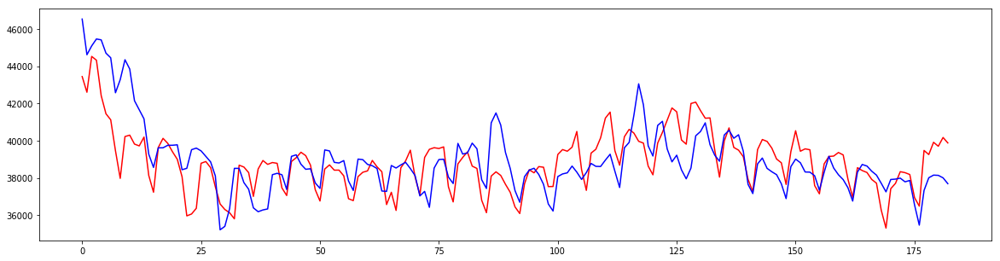

5 :  [0.15080643976491426, 0.027506191111171408, 0.06384975391293031, 0.02911599520691404]


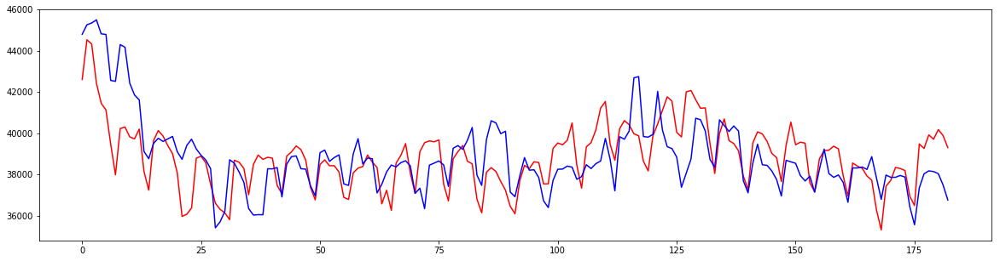

6 :  [0.15827524098159801, 0.028541155517032124, 0.064470177327646455, 0.029883179794423242]


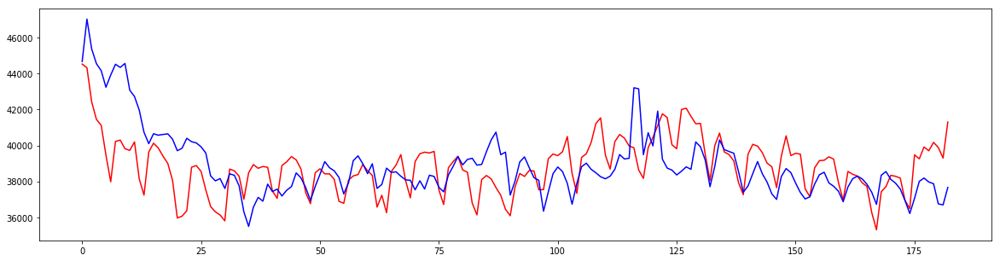

7 :  [0.16805046325615097, 0.036541879767533876, 0.072219007963116949, 0.035668343658245956]


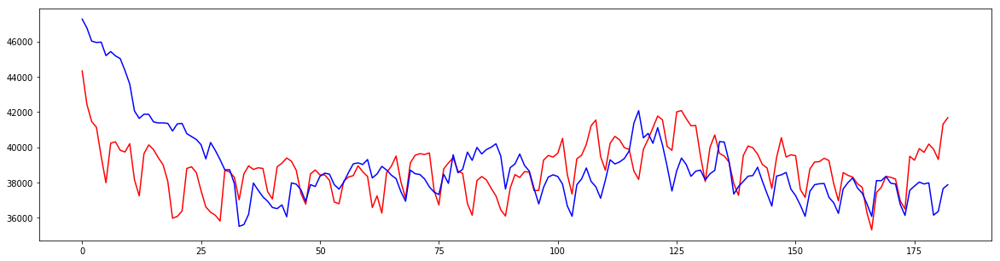

8 :  [0.17139614545387685, 0.040453255406093881, 0.082122598761177085, 0.042774024110031512]


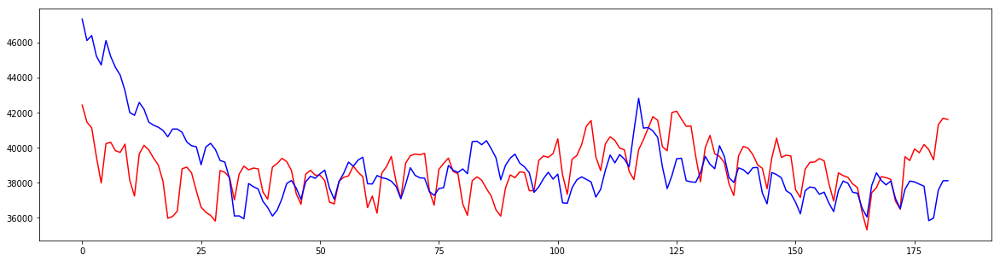

9 :  [0.16878862605588504, 0.036637981677771068, 0.080096239936086264, 0.042041699058329135]


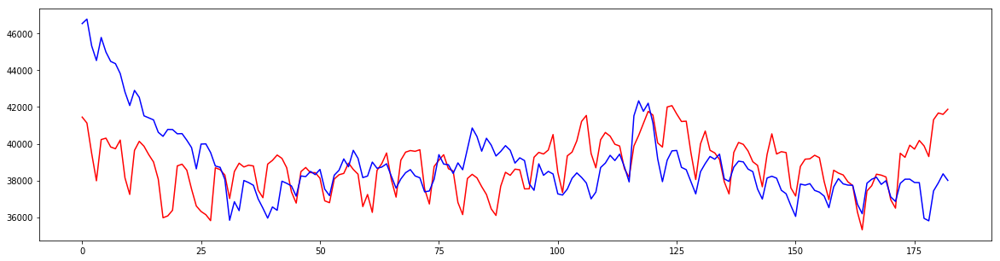

10 :  [0.16731946310549434, 0.039144466853318932, 0.084291131117862558, 0.041630069070305073]


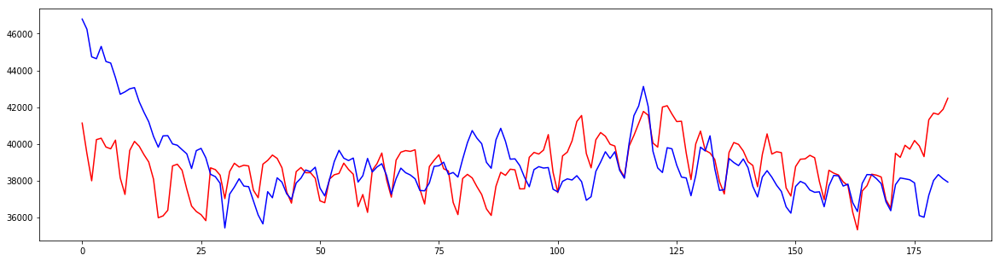

11 :  [0.16201530507015627, 0.042027696429245143, 0.087257751685663965, 0.039989370469746925]


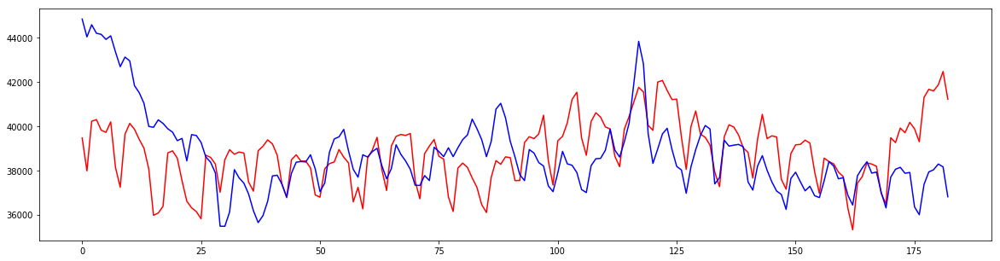

12 :  [0.16212213518163943, 0.040813971238044457, 0.089943185922922567, 0.040505431882243197]


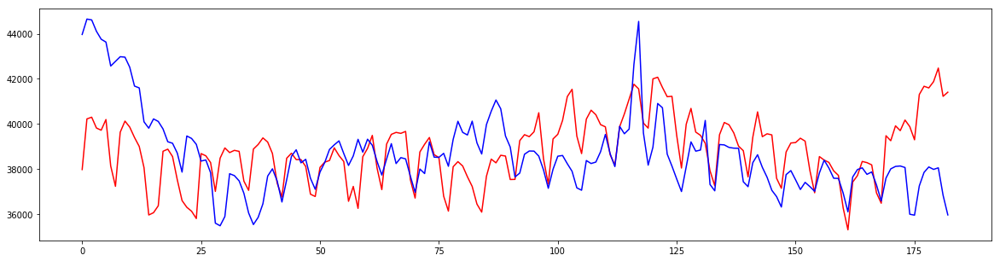

13 :  [0.16486825848546366, 0.045967453870519301, 0.090394660421416306, 0.039941436220972903]


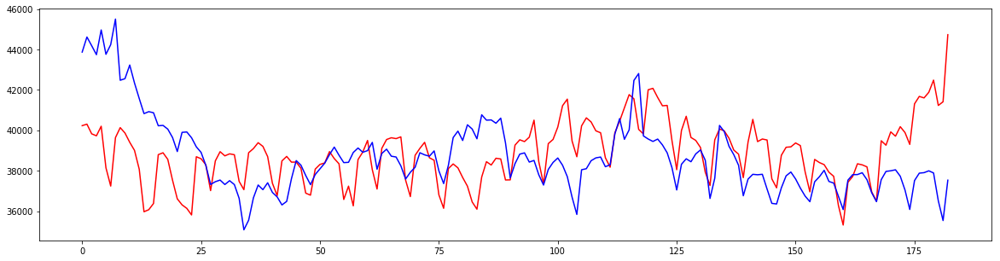

14 :  [0.16823345963579117, 0.045422933914841458, 0.11352284746985497, 0.043680224832091753]


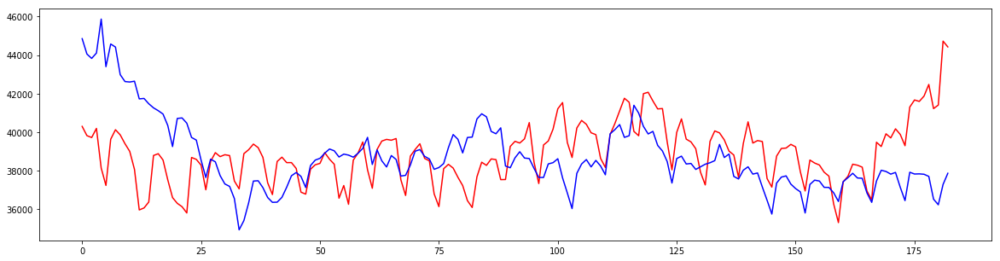

15 :  [0.16733018526785481, 0.041742296819101271, 0.10865710107280577, 0.046353425186442344]


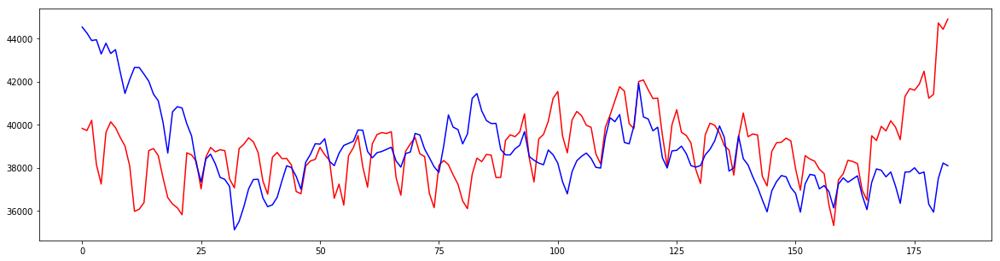

16 :  [0.16684144704256393, 0.041795071211809087, 0.11171183849796137, 0.045228876797952469]


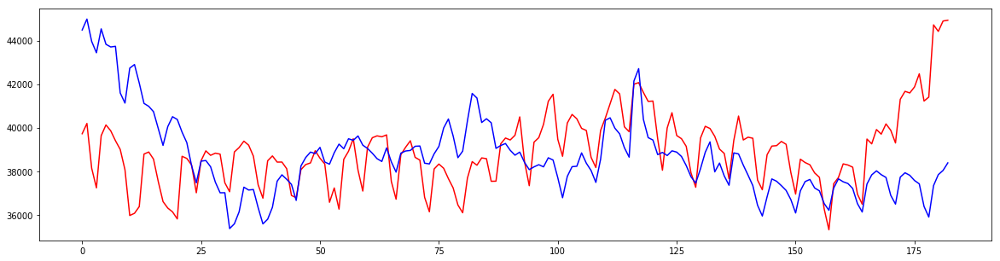

17 :  [0.16636827337808771, 0.043495855240722706, 0.10877262318435953, 0.046318742728408822]


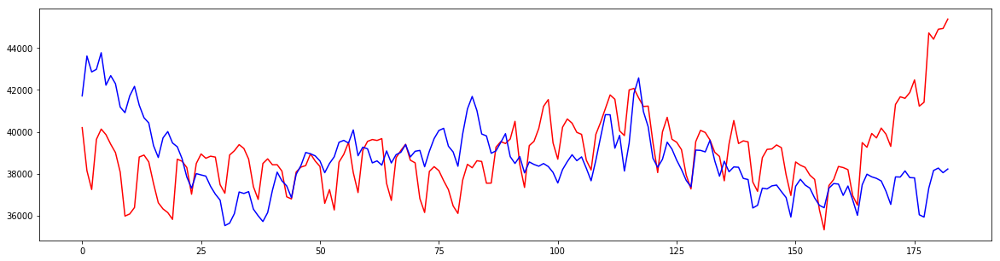

18 :  [0.16327739394851565, 0.04578186297339315, 0.10849596067028498, 0.04360487255227765]


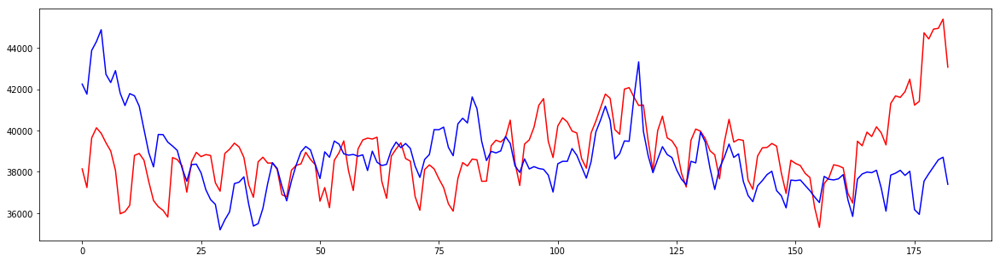

19 :  [0.16440905596829777, 0.048721756429252715, 0.11023003194861594, 0.043634060217661565]


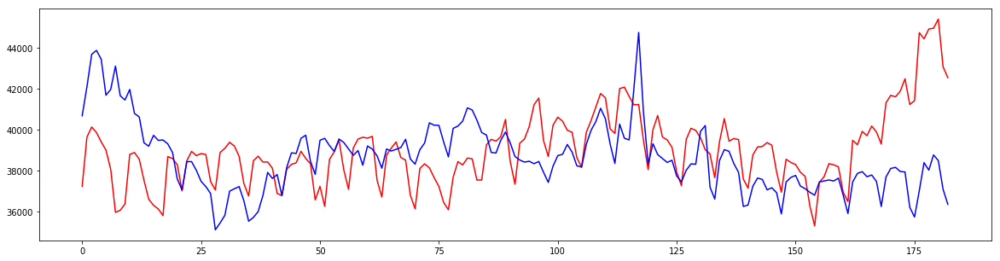

20 :  [0.1638624378524923, 0.048145785787837576, 0.11381509932769064, 0.045635744475942507]


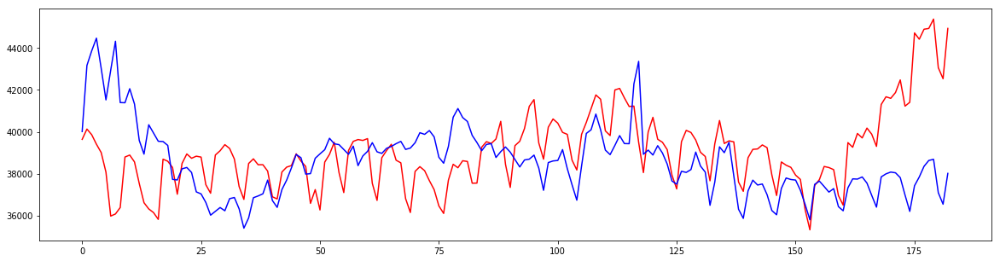

21 :  [0.16875821541657332, 0.050489444374296991, 0.11042419929357852, 0.047190503064042419]


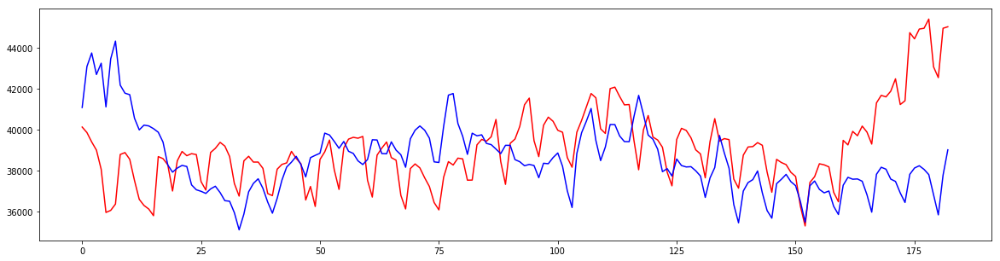

22 :  [0.17018405094680691, 0.052592698579981736, 0.11896496905243477, 0.048850582315812477]


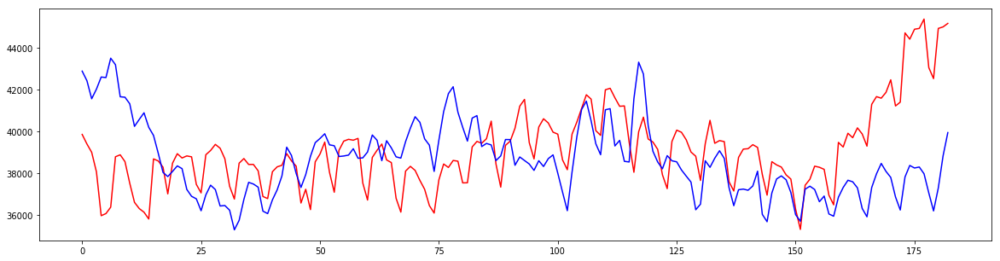

23 :  [0.16982179248377074, 0.054721945097115199, 0.11804586414242788, 0.05028060220137523]


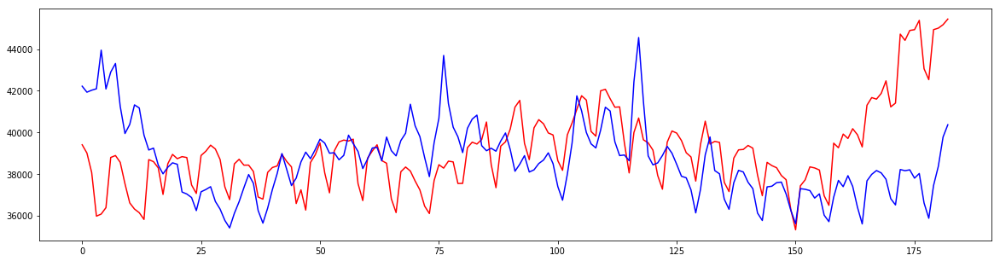

24 :  [0.16803961402671203, 0.055614995808160976, 0.1159063744799515, 0.049684991982780334]


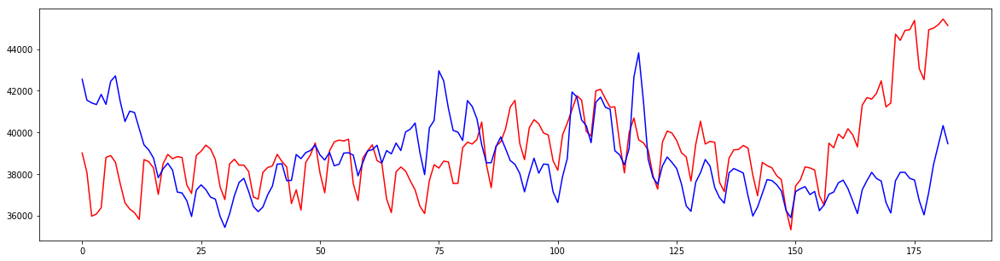

25 :  [0.16744860431230515, 0.0560263982871139, 0.11629141493829383, 0.049537067700959149]


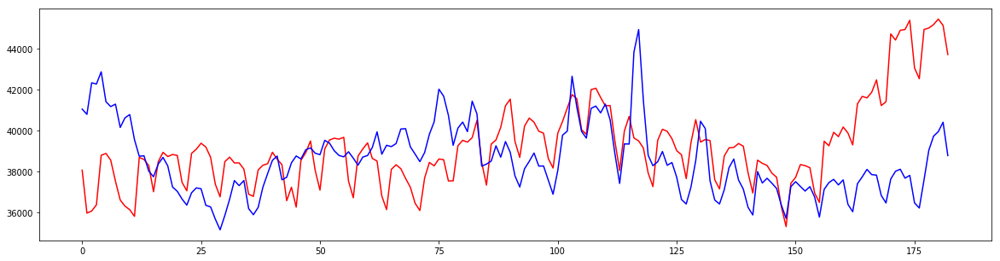

26 :  [0.17590009006462465, 0.053290277560932381, 0.12021269281074927, 0.048747027030425778]


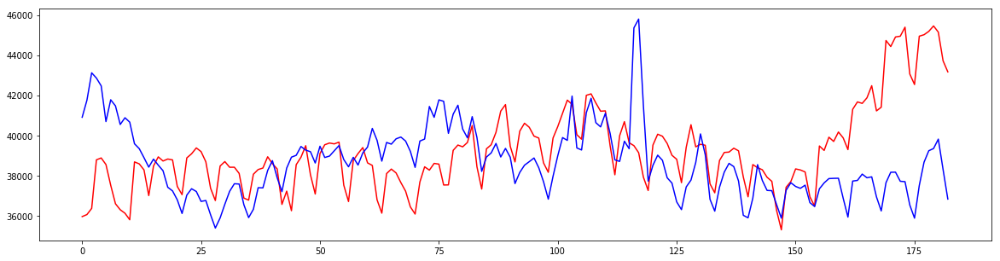

27 :  [0.18164975940411052, 0.058247409844311891, 0.11819145324793438, 0.050472099826951437]


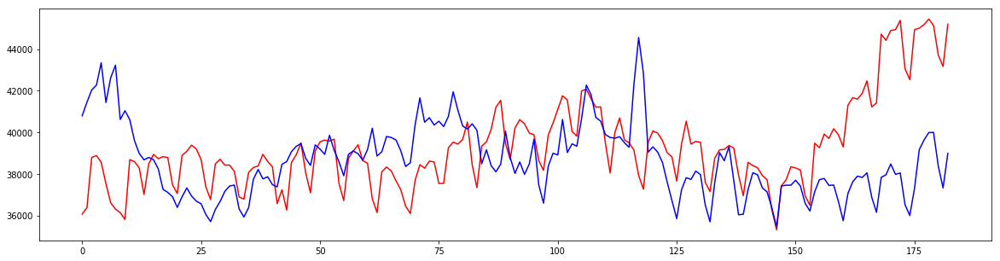

28 :  [0.18549299701149244, 0.060183412351624603, 0.13055707941020586, 0.051144981430356805]


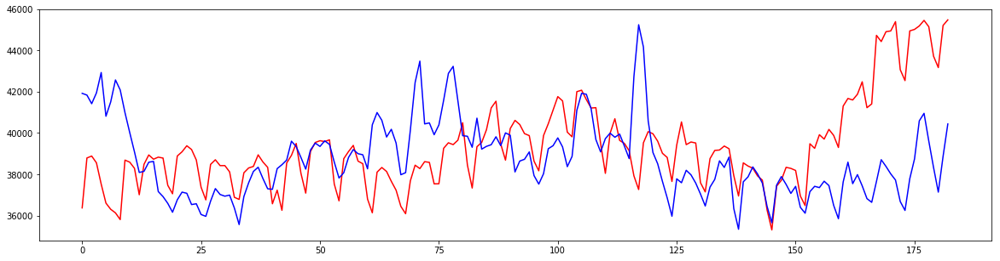

29 :  [0.19106272412809019, 0.064225589081312082, 0.13454409874518558, 0.051420101829086601]


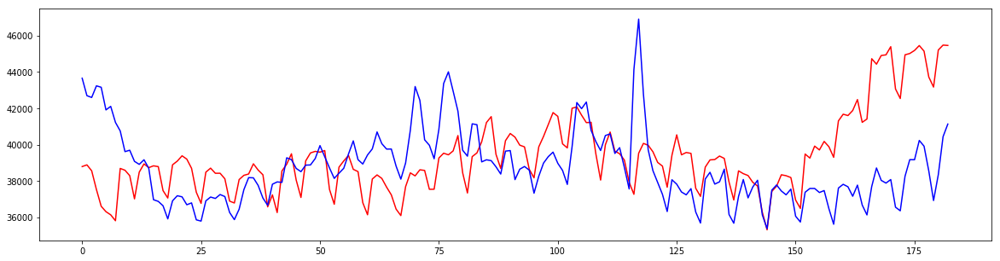

30 :  [0.19215999074454757, 0.059099574489360256, 0.13333429952944853, 0.053527531393266305]
----------------------------
ts id =  10


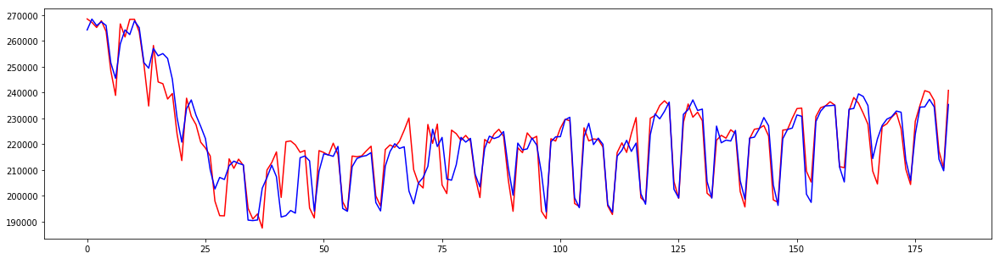

0 :  [0.13803309382569953, 0.032443503547830217, 0.033816399549048436, 0.021030665364276543]


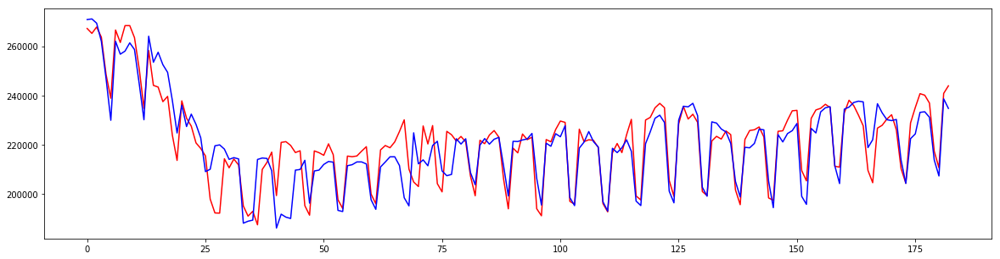

1 :  [0.16421017541756933, 0.040307601941709466, 0.047573828936740906, 0.02828932997615561]


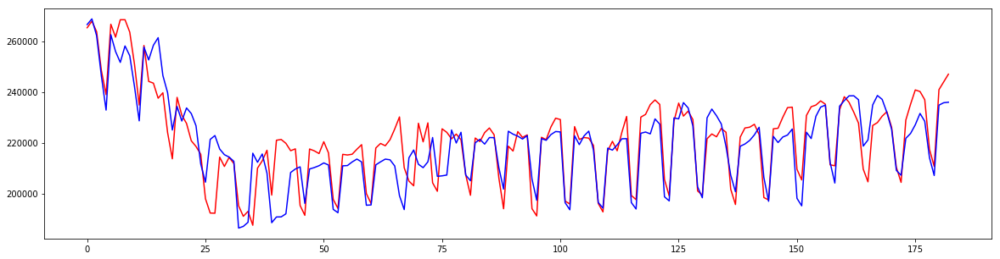

2 :  [0.16989801090948825, 0.045299698531162579, 0.048643462466187108, 0.031314357171888886]


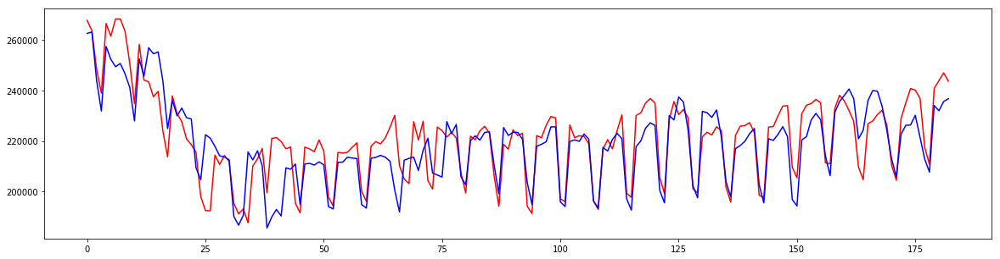

3 :  [0.17388094787419234, 0.045978405397354351, 0.051289421947771696, 0.033170541376411504]


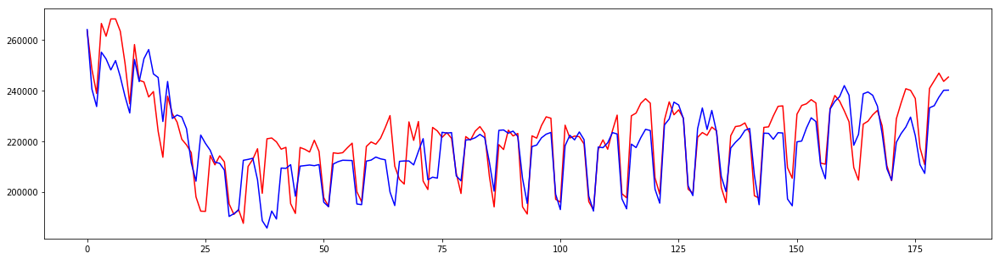

4 :  [0.163681954134312, 0.044968726729748297, 0.052585382002191358, 0.032745946474799933]


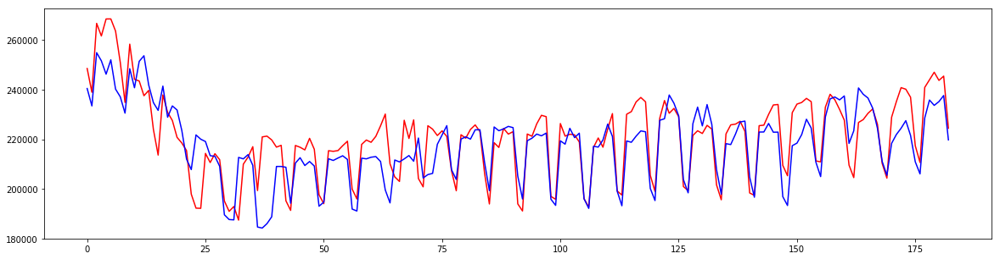

5 :  [0.17015733413269013, 0.045330344893690297, 0.054205821726533002, 0.034273214747626353]


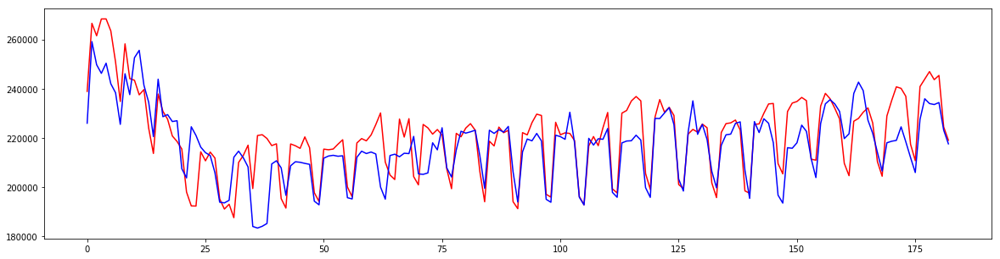

6 :  [0.19001049873154147, 0.048025007211339954, 0.054712901267488644, 0.035514743038597744]


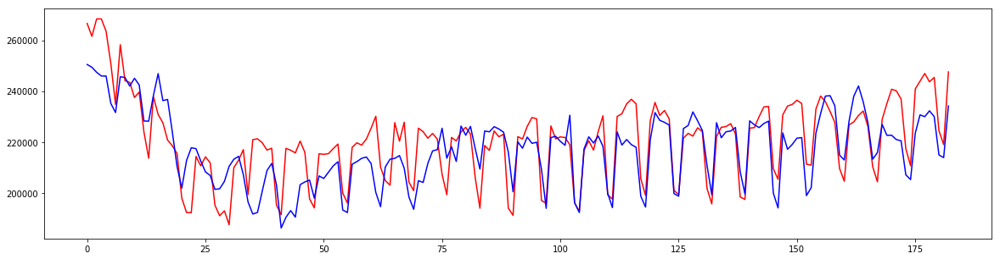

7 :  [0.20718695785537594, 0.053748404101230884, 0.062565825088490151, 0.039674667577690628]


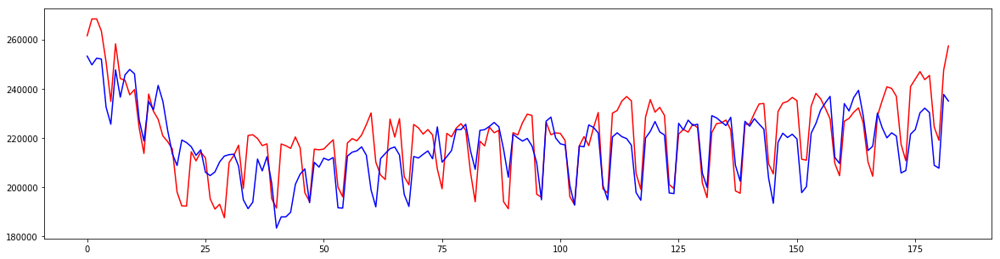

8 :  [0.20724794892852036, 0.055727821293388477, 0.062805022803692892, 0.040306435392014693]


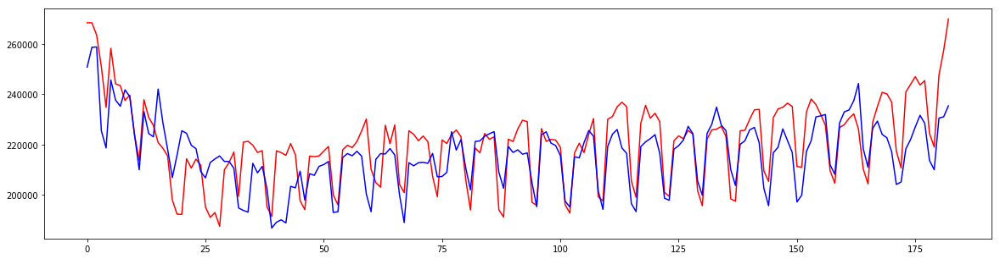

9 :  [0.21703936066755658, 0.054902994043313419, 0.064343620623876926, 0.041660071902971101]


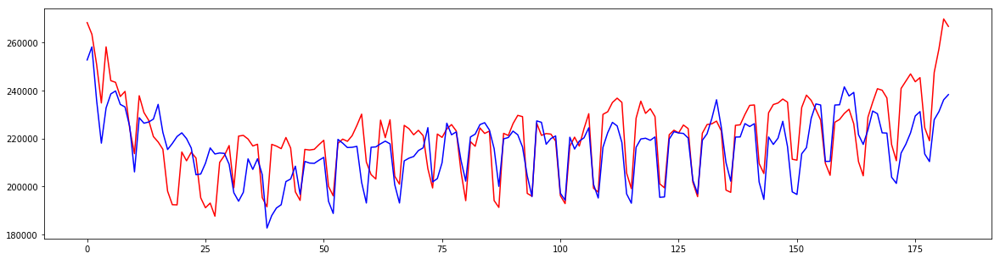

10 :  [0.22056720115718578, 0.056105724823637758, 0.061430076281496514, 0.042843216177539709]


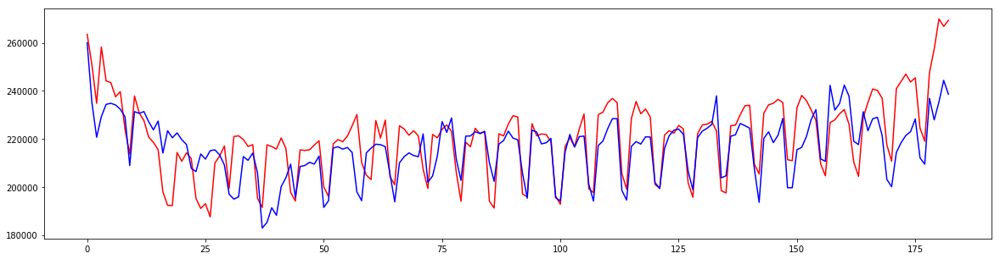

11 :  [0.19378640021076318, 0.059164996800910002, 0.065578609631107565, 0.042642581439948361]


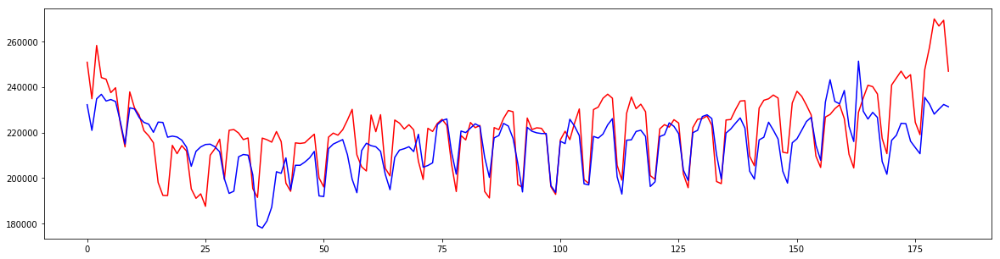

12 :  [0.1987190049926382, 0.061761475643699167, 0.062801503889174881, 0.044902708140270302]


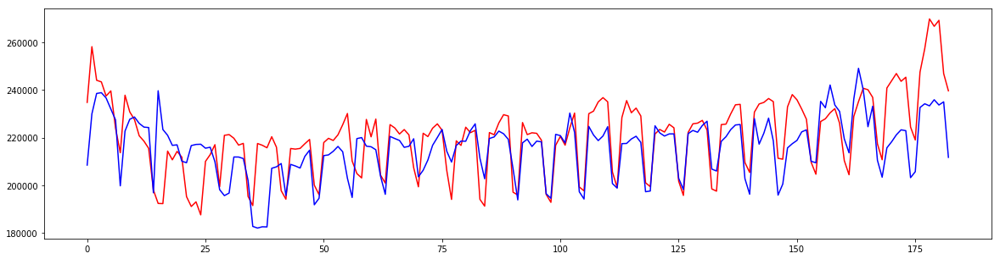

13 :  [0.20154396503952346, 0.059843278650678809, 0.064985921024956539, 0.044237084240649927]


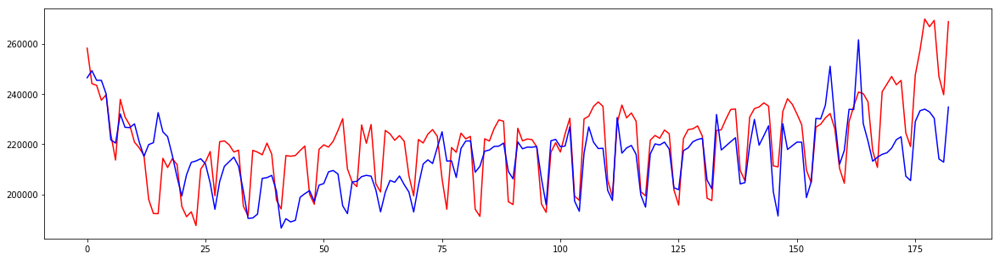

14 :  [0.21934642733694634, 0.068916491579047515, 0.068196341490833756, 0.049019798794681366]


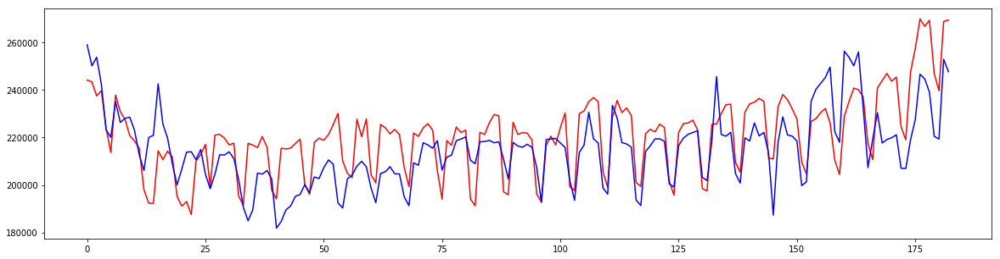

15 :  [0.22575215599027471, 0.070356648831316843, 0.072877622156062416, 0.051995334631067126]


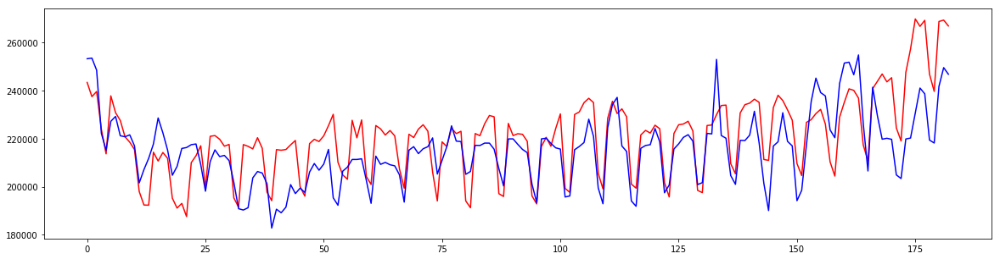

16 :  [0.2230662454732053, 0.063980106237521261, 0.077299464889064806, 0.047935881507260795]


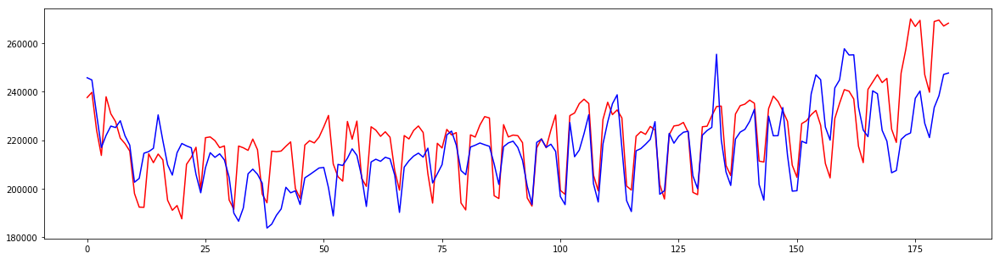

17 :  [0.2278991079274692, 0.069949746545109687, 0.073144278127538737, 0.048025833153205813]


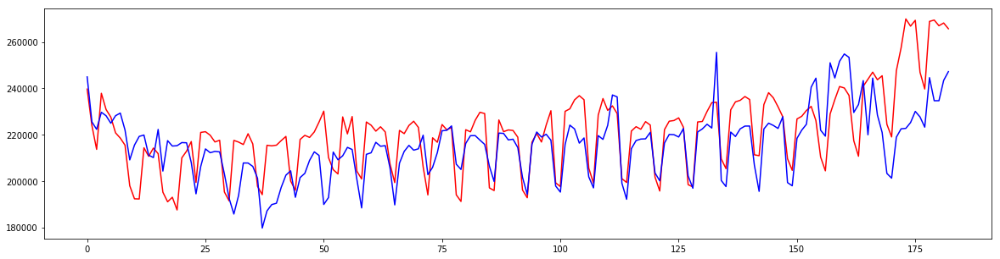

18 :  [0.22114645957983584, 0.07276043480582732, 0.077179347717167918, 0.049591298087927727]


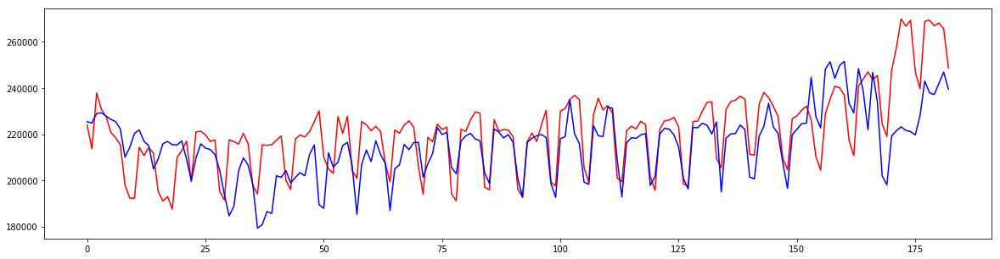

19 :  [0.21760134804630174, 0.073010654191980148, 0.079420227930796325, 0.049692165423971868]


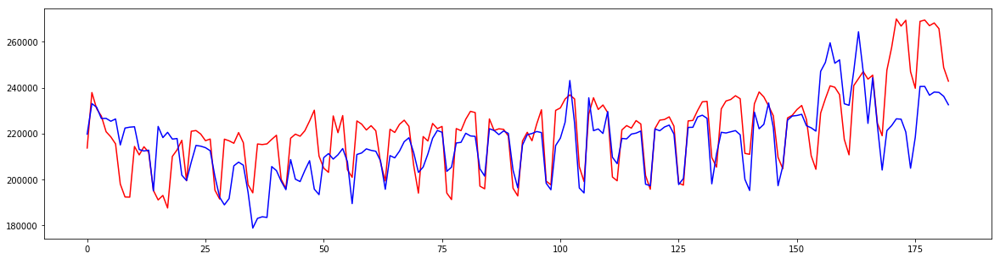

20 :  [0.2156898875776482, 0.071651153767583534, 0.078957781320178402, 0.048381664359829081]


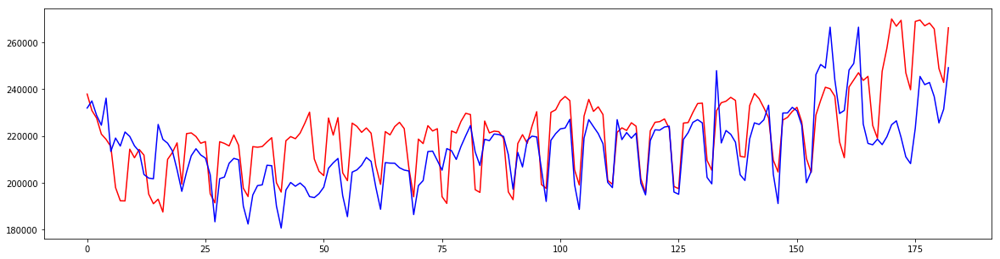

21 :  [0.21508061570599374, 0.077316269979966559, 0.074759389390176373, 0.053916049693536354]


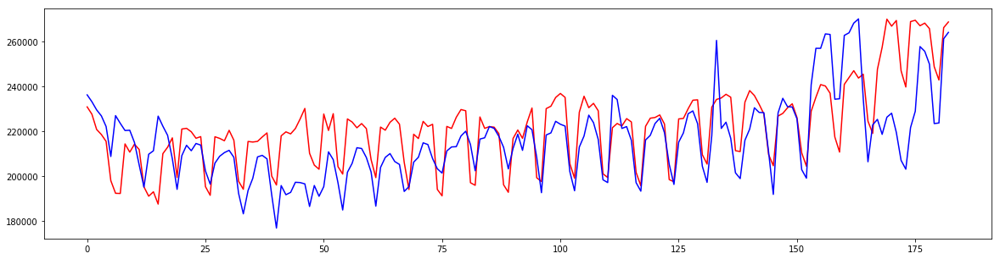

22 :  [0.21248648076557883, 0.080394798579529594, 0.077171038101269879, 0.055881157745032141]


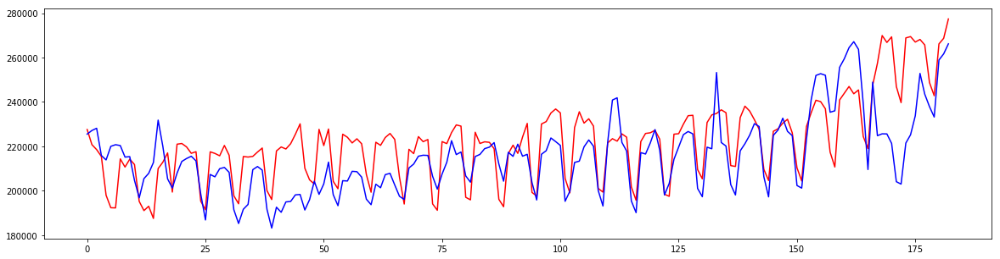

23 :  [0.20989888312219221, 0.077379715414574474, 0.078522218194387788, 0.053527716131563562]


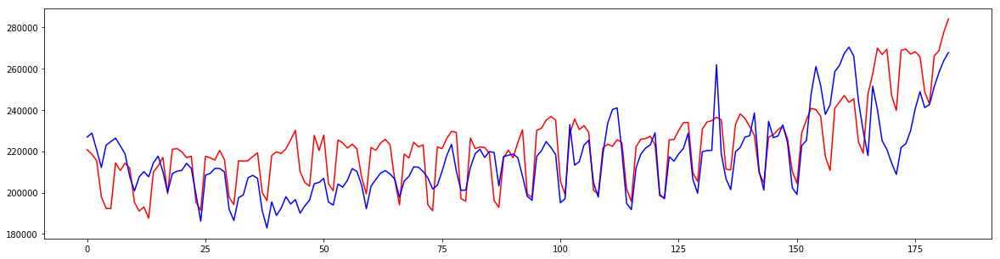

24 :  [0.21029729102013278, 0.083939289285727858, 0.081047267951713117, 0.054492234542311981]


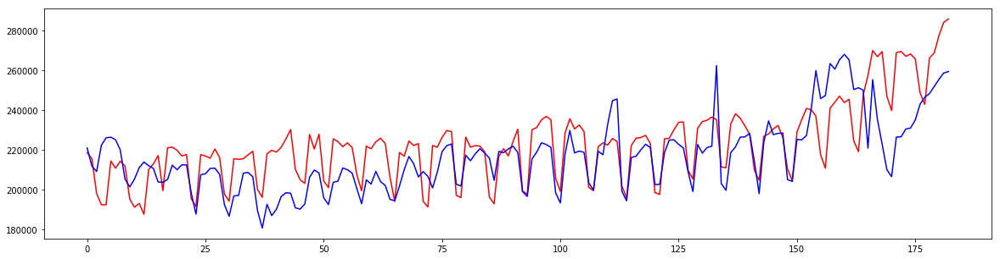

25 :  [0.21646430016261201, 0.083184888440744634, 0.08119776662969061, 0.056780127975796735]


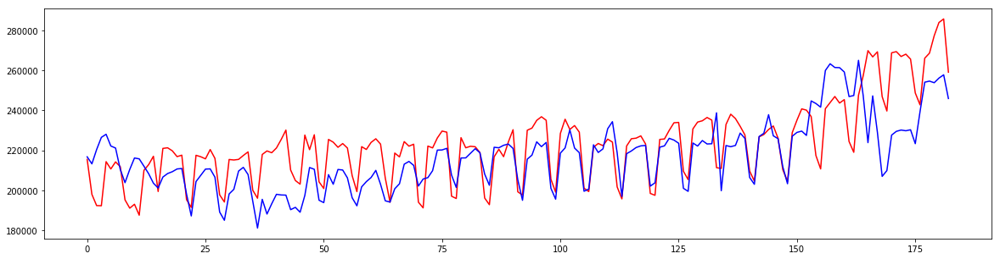

26 :  [0.2183432945594567, 0.078561055316863956, 0.082908755571610634, 0.054991907326872078]


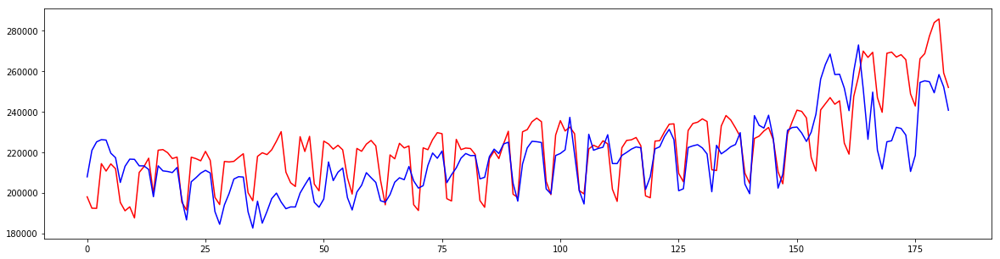

27 :  [0.22422821816404065, 0.080945969521314914, 0.08571546045541191, 0.05536183363095061]


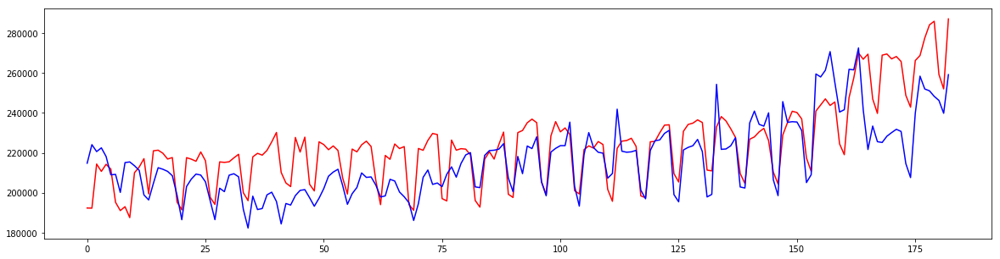

28 :  [0.22697582451678705, 0.075589383447964523, 0.085782622648144152, 0.055786621450340391]


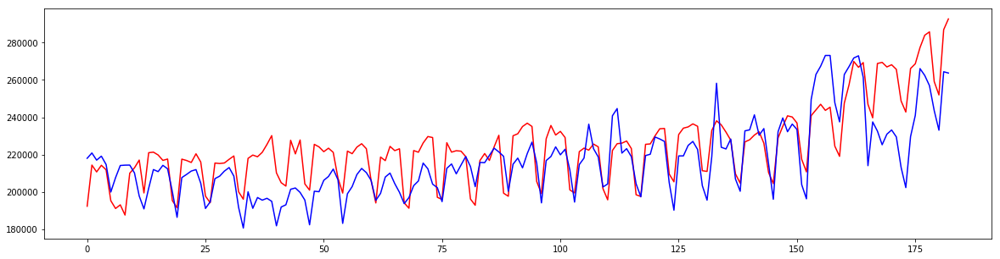

29 :  [0.23334637924937637, 0.071716880985792861, 0.086249936701649488, 0.056106694309788332]


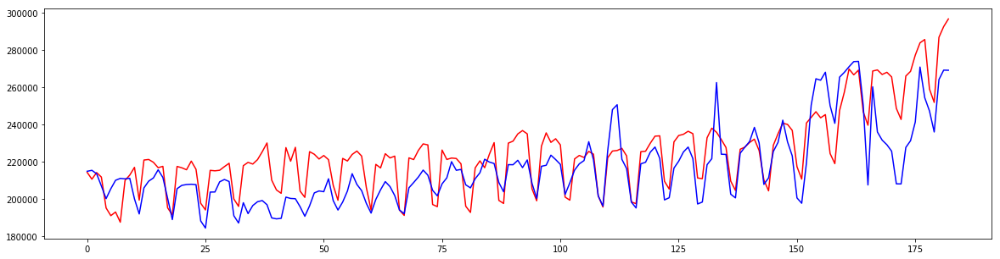

30 :  [0.2418869747821944, 0.067366462238192593, 0.086317204017638274, 0.054558653206040184]
----------------------------
ts id =  11


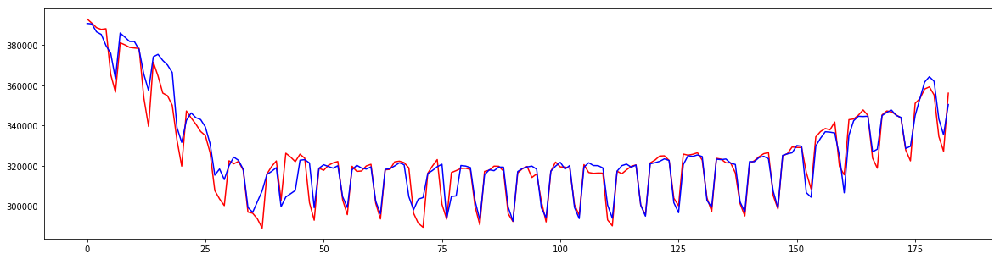

0 :  [0.1066756320568418, 0.014576784228566288, 0.024897321041986099, 0.01215548925046233]


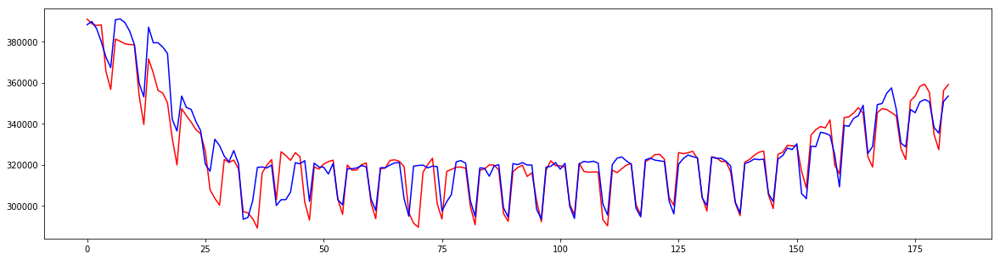

1 :  [0.11280295180759038, 0.015002340543129766, 0.030514075264726413, 0.016671142584772657]


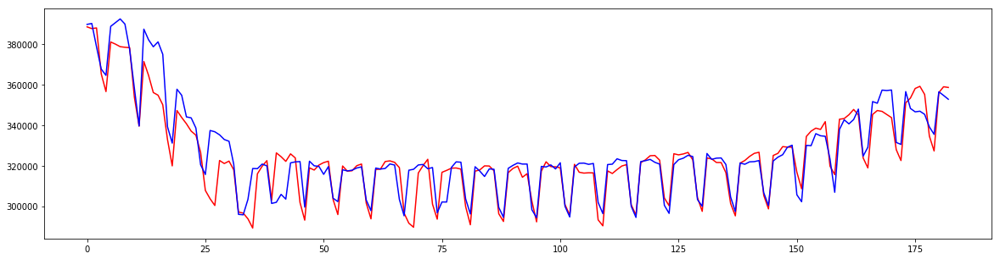

2 :  [0.12558664328384722, 0.016009915114215324, 0.030031657083901989, 0.018029664537242907]


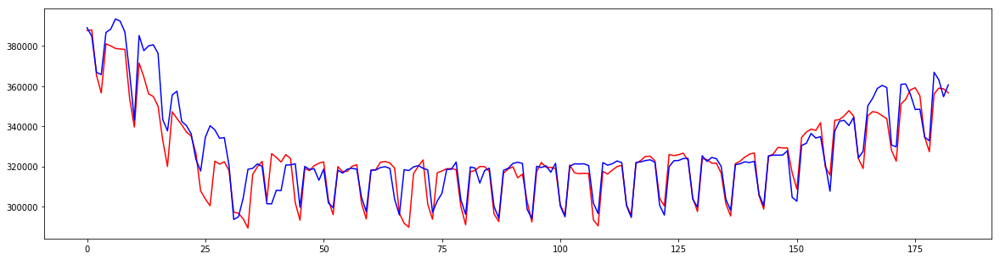

3 :  [0.12239007328134252, 0.016181198262329104, 0.03129078115147324, 0.018124273775280562]


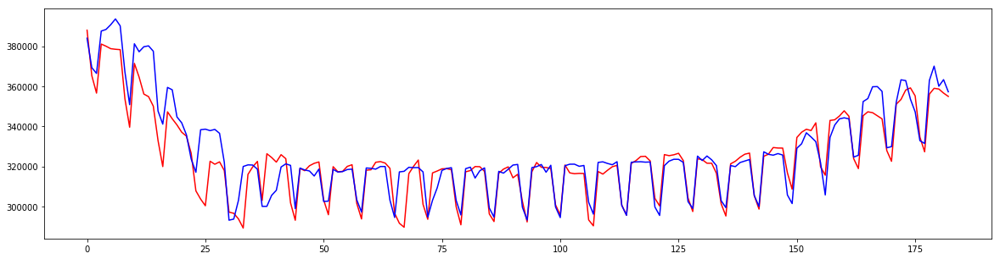

4 :  [0.12423659562788668, 0.015594580311793957, 0.032304388643543853, 0.018637792020595009]


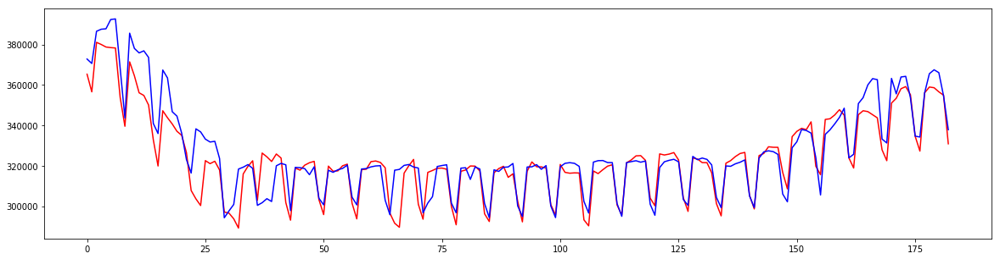

5 :  [0.13511033170016268, 0.015653606937279393, 0.031491356962964144, 0.018701058670034135]


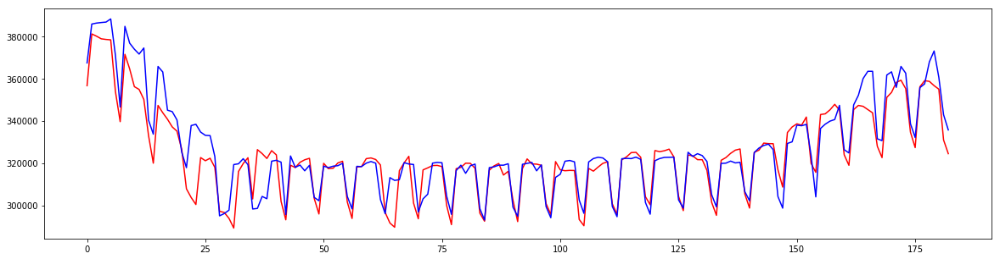

6 :  [0.14351811530360611, 0.017491561937612622, 0.032212252839843601, 0.018669250920121266]


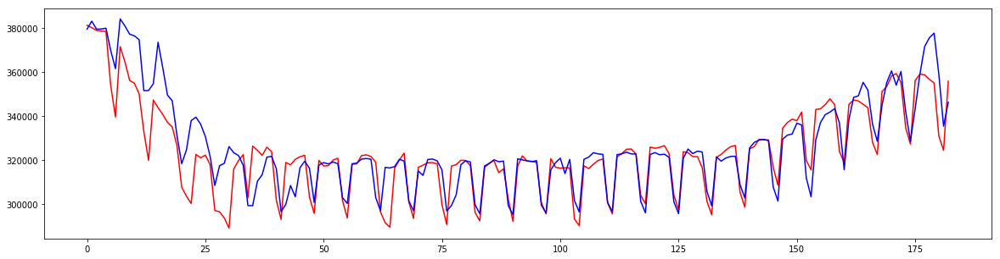

7 :  [0.14672195234945276, 0.024050052081550838, 0.037272828773446461, 0.021620023389431274]


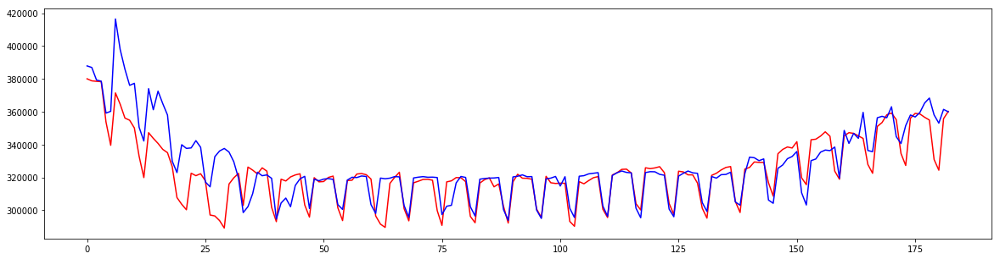

8 :  [0.14095969139753942, 0.025924349951172477, 0.036543697831949919, 0.025690424871188972]


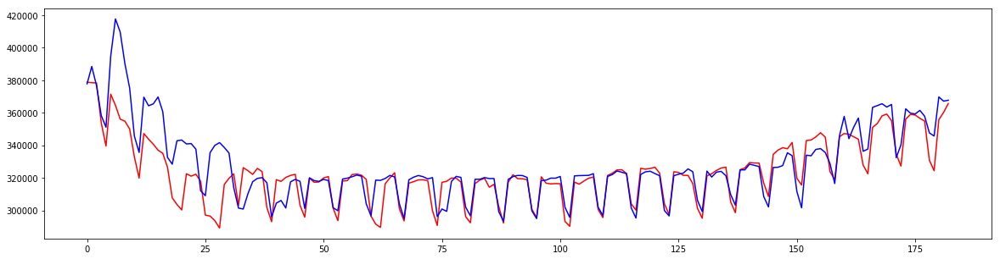

9 :  [0.14262686204869782, 0.025963480115793584, 0.038770532024695124, 0.02624457356347221]


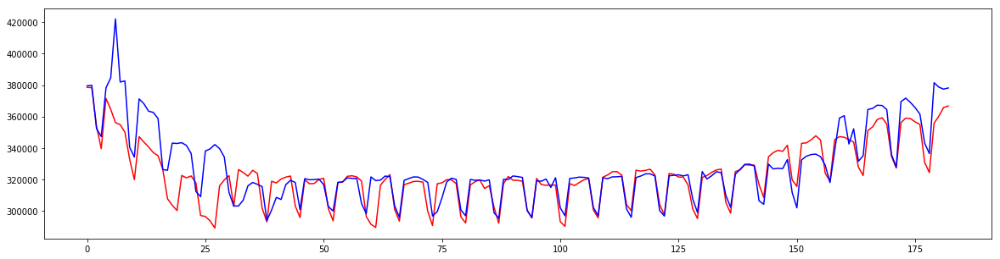

10 :  [0.13909100757322185, 0.026564220696625274, 0.039125457287818605, 0.026229028167029]


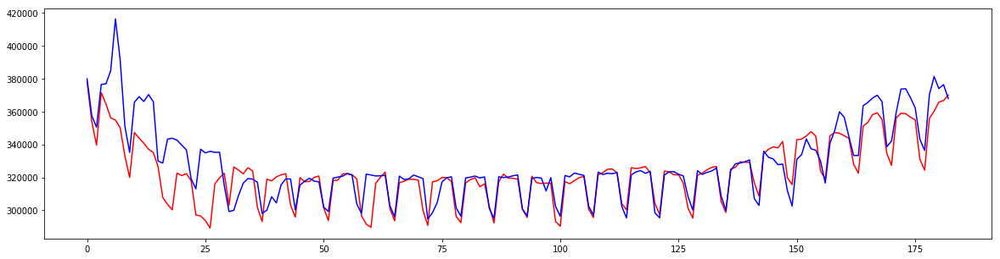

11 :  [0.13553182896979959, 0.026239780471834614, 0.038735010048469888, 0.026440059773409488]


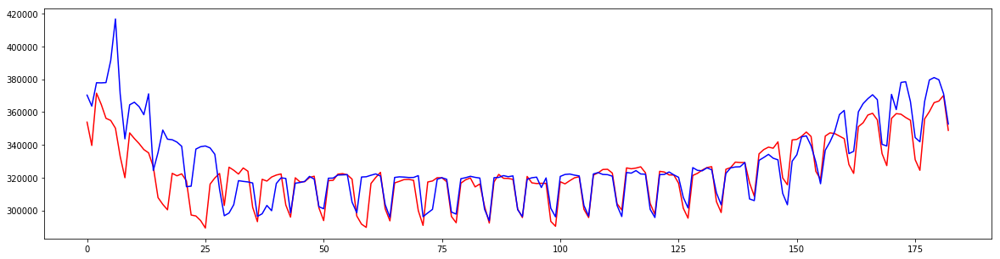

12 :  [0.13782149814422345, 0.024550658350832293, 0.037921286115484565, 0.028274974489122896]


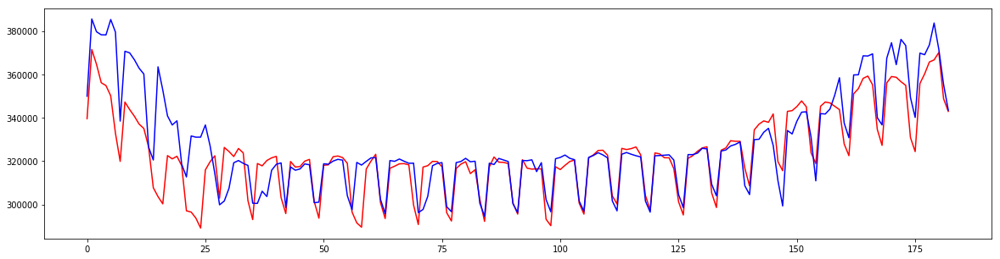

13 :  [0.13718560365296981, 0.02525078680791637, 0.036494912754322803, 0.02580079846473721]


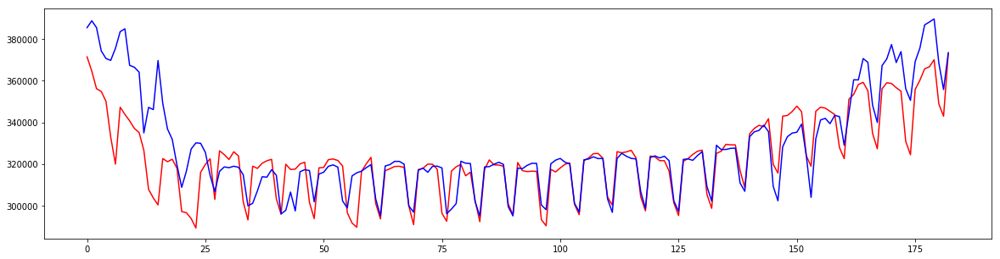

14 :  [0.13728083392497339, 0.030940530152382836, 0.041077240227856367, 0.028505228035361544]


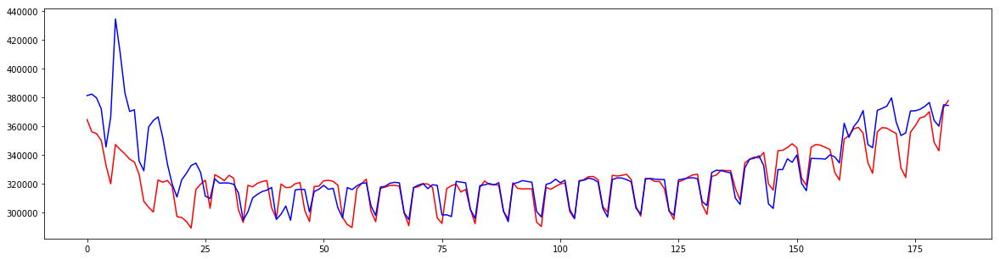

15 :  [0.14056059484829098, 0.031233075327287176, 0.042065067026515884, 0.029830620033462627]


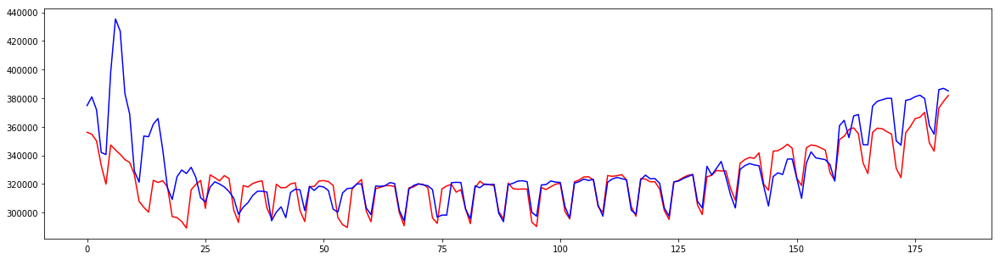

16 :  [0.14981070641025895, 0.032659560995121635, 0.04212397225161723, 0.030668731236543154]


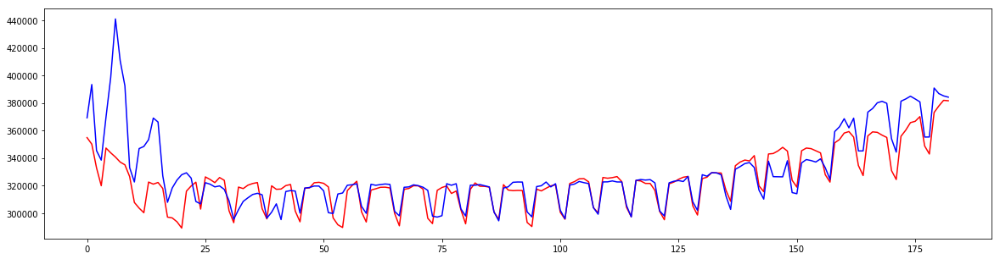

17 :  [0.14431458870049516, 0.035733405862592875, 0.043801911359321849, 0.030277756620779011]


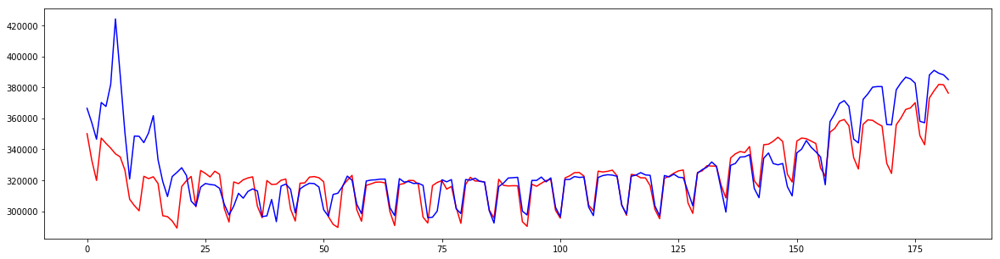

18 :  [0.13552395308162865, 0.033415903161123896, 0.043028913798855949, 0.029536008454493955]


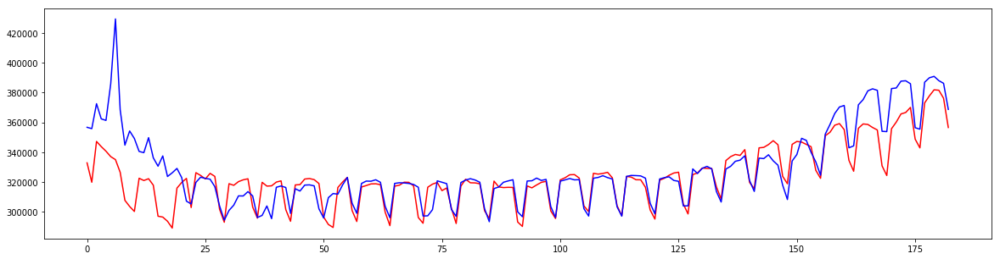

19 :  [0.13683505108176036, 0.033181023950468118, 0.043054341471549094, 0.029694674865611951]


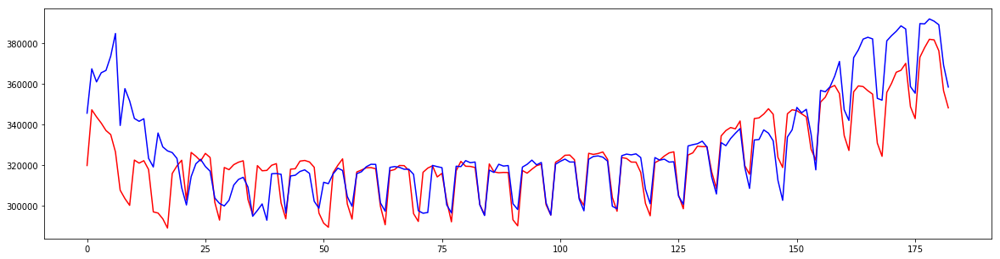

20 :  [0.13471444418690956, 0.032619066836284287, 0.039200023689167848, 0.028715403648341742]


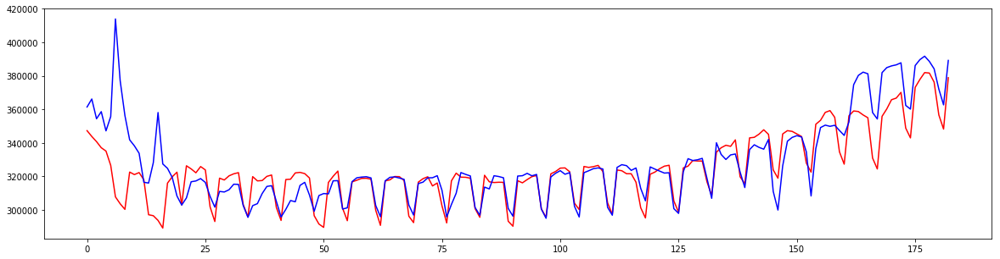

21 :  [0.14143492165768407, 0.034919915867705598, 0.041406488172556807, 0.028791918929883455]


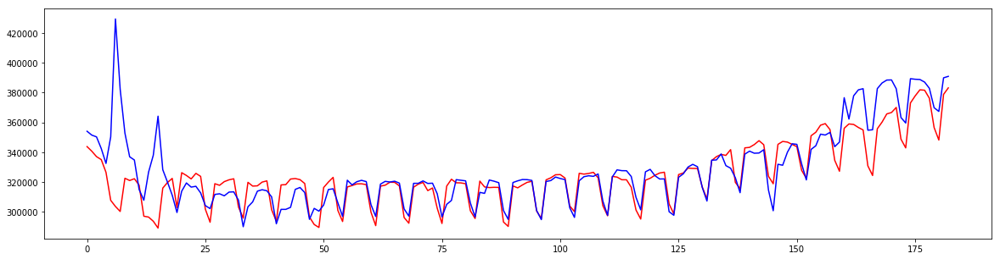

22 :  [0.14225165590534083, 0.035273133739652344, 0.043758477198483456, 0.028219466306410233]


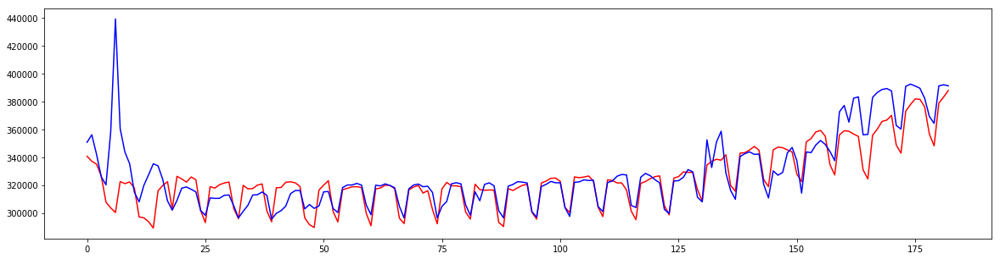

23 :  [0.14268430726900663, 0.034993191551573891, 0.043411846069730864, 0.02838660438609843]


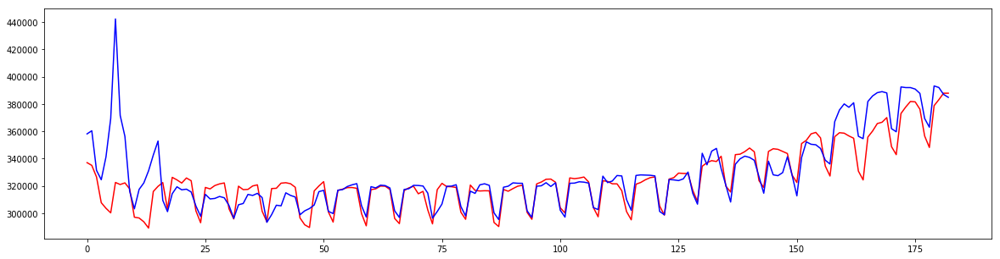

24 :  [0.15040274474363963, 0.035339681269090879, 0.043174050698343333, 0.028542431154670062]


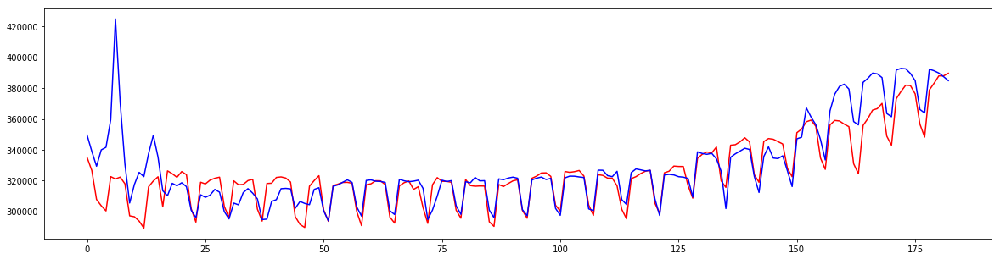

25 :  [0.14792223905754592, 0.034842233754819651, 0.043587946087521284, 0.027164168187293839]


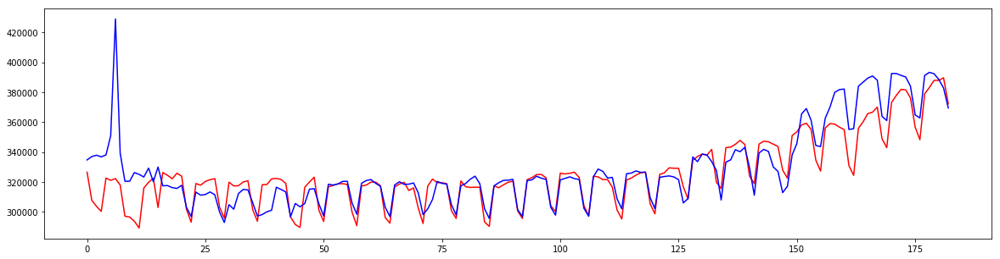

26 :  [0.15555712037411984, 0.033355692173035439, 0.04166225786983023, 0.027189561258481338]


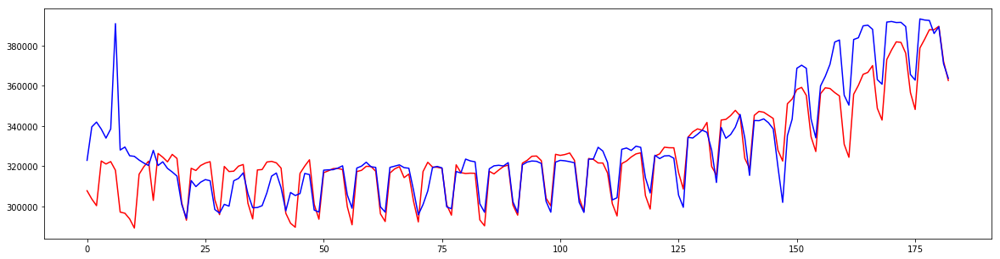

27 :  [0.16189615624616727, 0.031909612921566598, 0.039253142874478231, 0.025513839283553712]


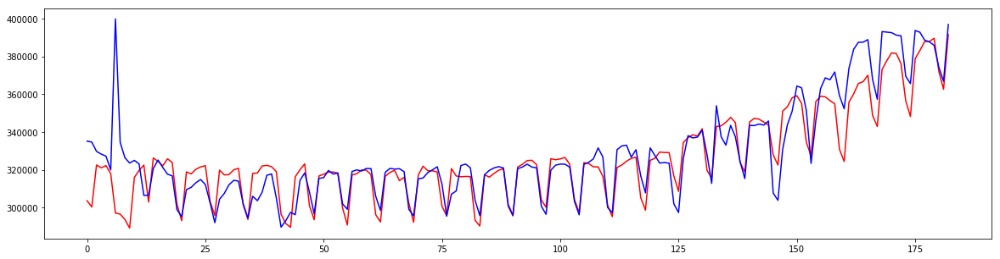

28 :  [0.17433544479886917, 0.031699879229394372, 0.040245986047111139, 0.024582261346728165]


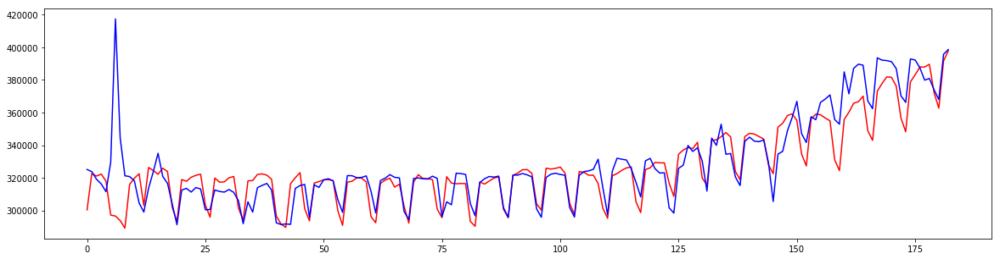

29 :  [0.18480136051519658, 0.032255030739549821, 0.044797232961044542, 0.025037555505386864]


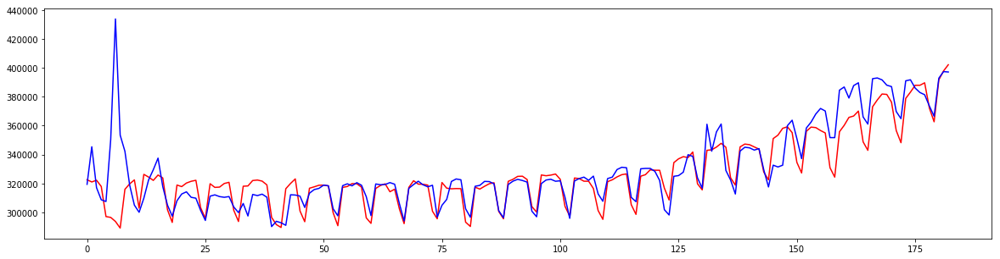

30 :  [0.20020842285289786, 0.030499081326059194, 0.045338593509332926, 0.026480137341655066]
----------------------------
ts id =  12


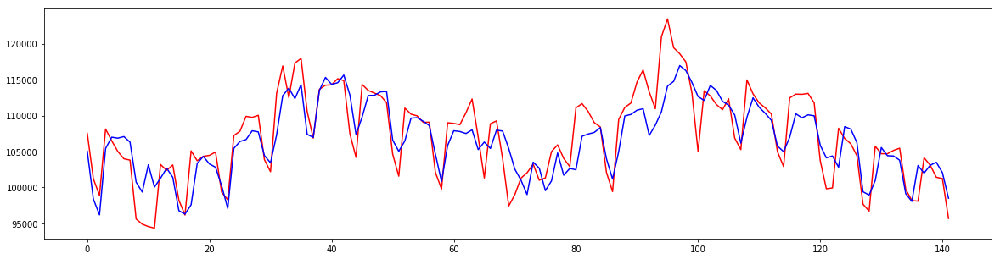

0 :  [0.065621234580663046, 0.02715805865949204, 0.016353501347384822, 0.023233213987111843]


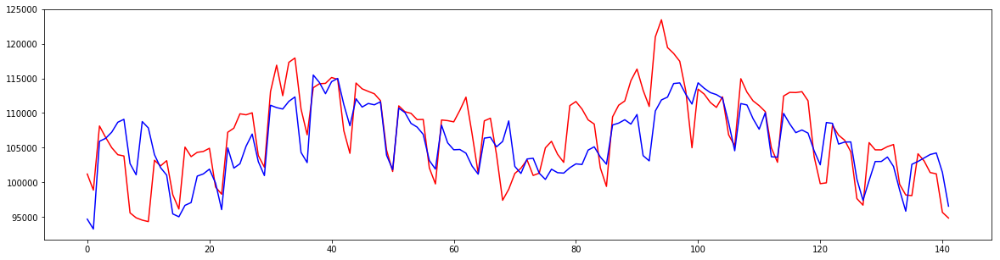

1 :  [0.068642432462319145, 0.041177134176301644, 0.020141102742575349, 0.031293632470254032]


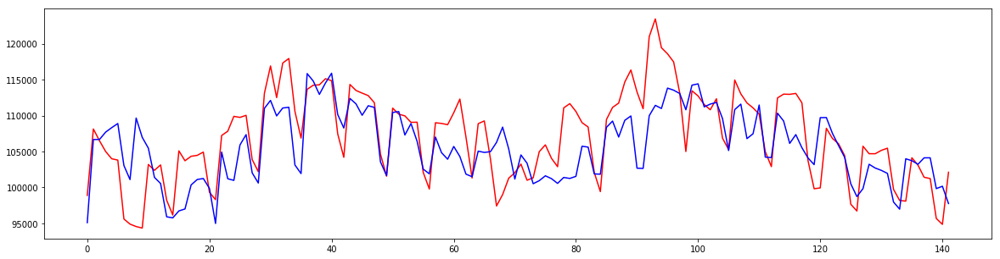

2 :  [0.072127768173862614, 0.040310424120286105, 0.022171947041570866, 0.033449592932461837]


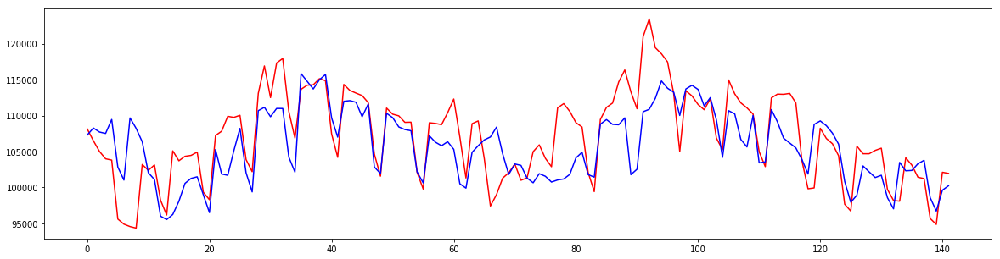

3 :  [0.073406445314646462, 0.043632388120275423, 0.022378793327969576, 0.032305226667026975]


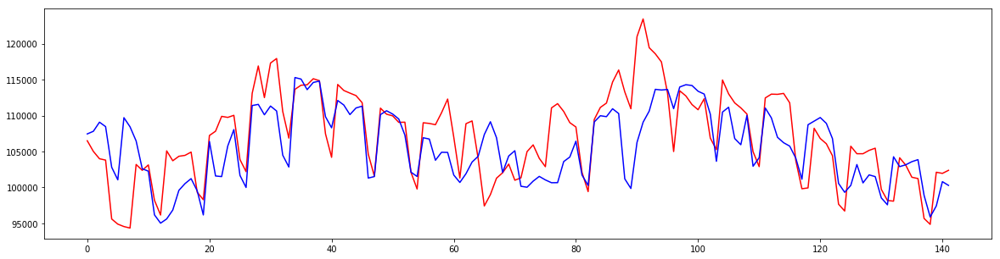

4 :  [0.079767019431250155, 0.044484479720579333, 0.023338028547897433, 0.034296634808531866]


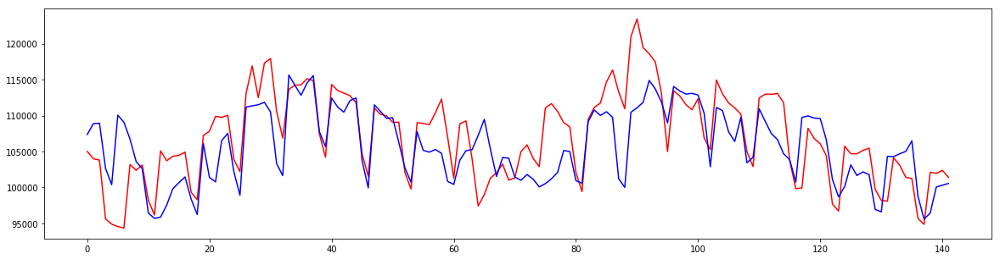

5 :  [0.080647044201829374, 0.043231125909334228, 0.023728997353235949, 0.033665859982692524]


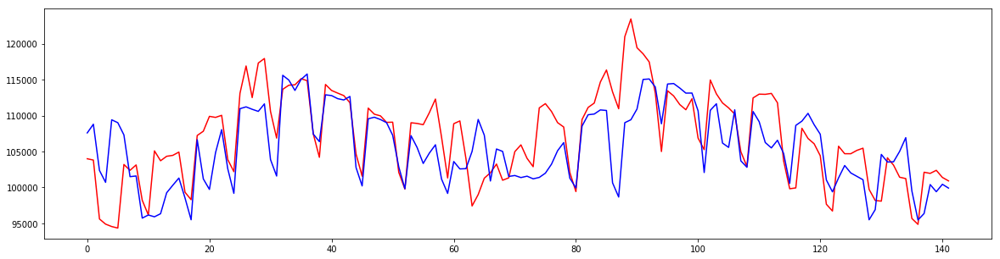

6 :  [0.083068336880674373, 0.043962187315532759, 0.023106251924021694, 0.034341581274988618]


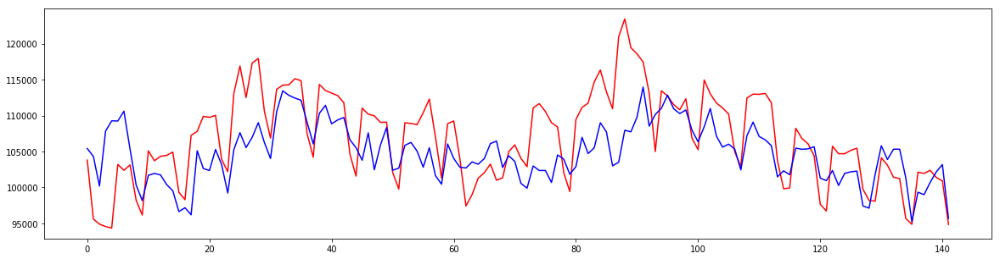

7 :  [0.093995173327792864, 0.050374721138852233, 0.026289047283829834, 0.03865171962719352]


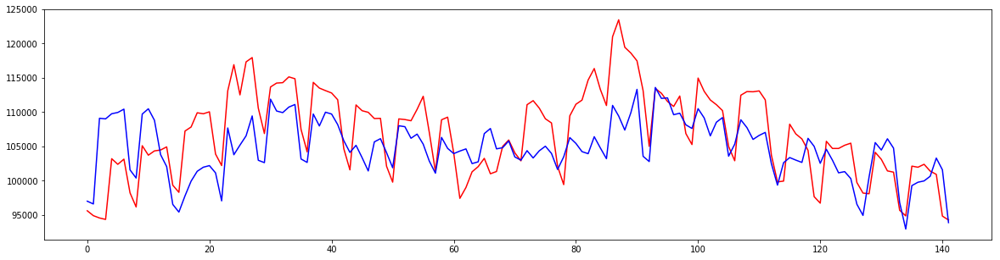

8 :  [0.094084104516592534, 0.055058186251058398, 0.027295273917347939, 0.040508667767022215]


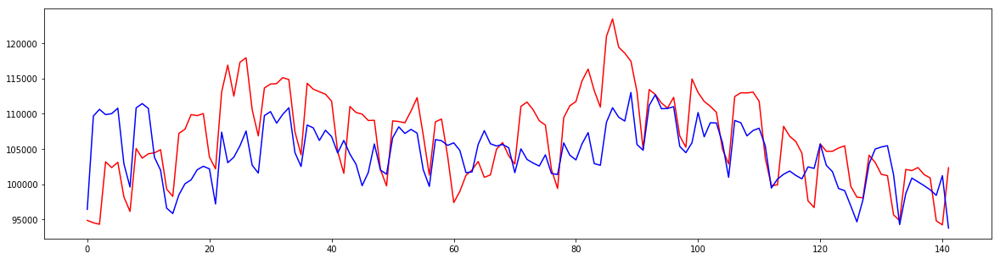

9 :  [0.095872087011237214, 0.054023495420214389, 0.025981854553056977, 0.043128831904118967]


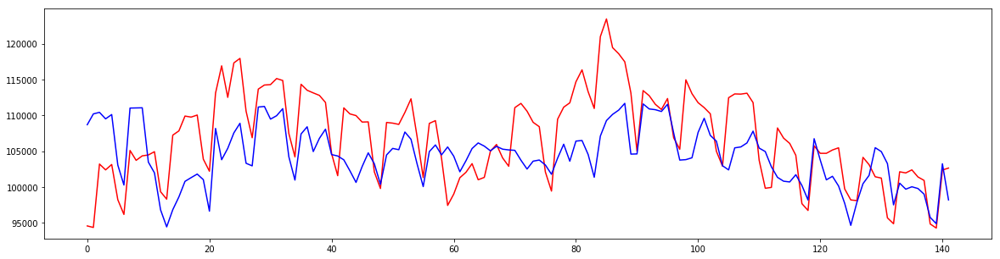

10 :  [0.10145168035434472, 0.055823285576191921, 0.024711341231121838, 0.044146573335153372]


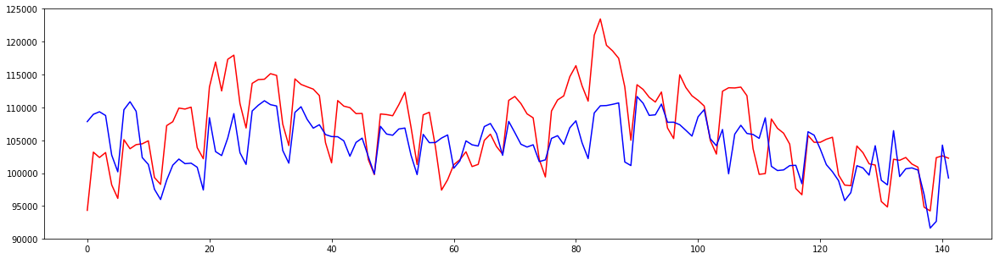

11 :  [0.10284294970476794, 0.056316729198915845, 0.027403207828412081, 0.04167579659946688]


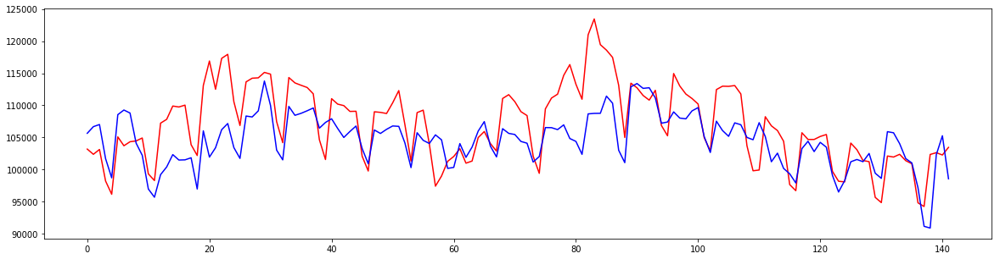

12 :  [0.10648637333518204, 0.060118514446327959, 0.028681695984707798, 0.036880393383043449]


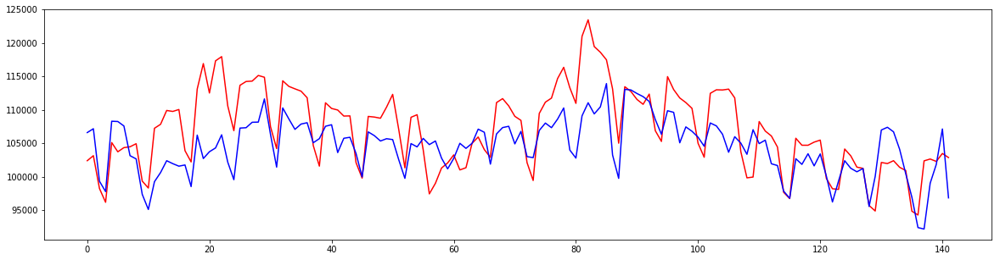

13 :  [0.11548027451129948, 0.058159561617746013, 0.028851550587805062, 0.037047517526715243]


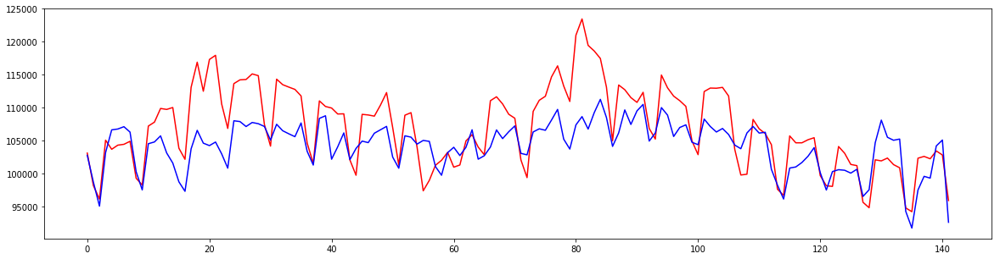

14 :  [0.1263872521054262, 0.064777653333440544, 0.027848776324628569, 0.035563484314943293]


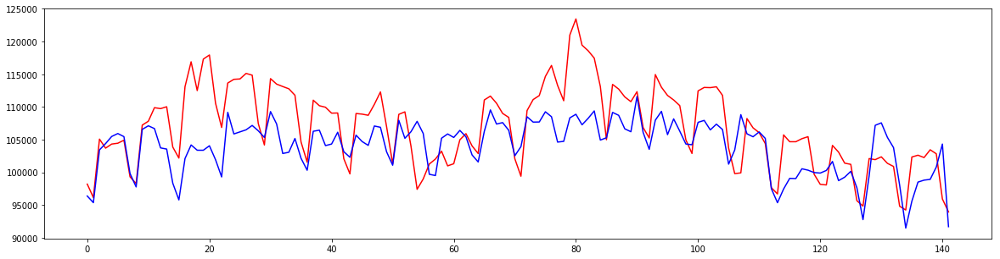

15 :  [0.13198792605131587, 0.064537670762405089, 0.030429527710381352, 0.039405347918759506]


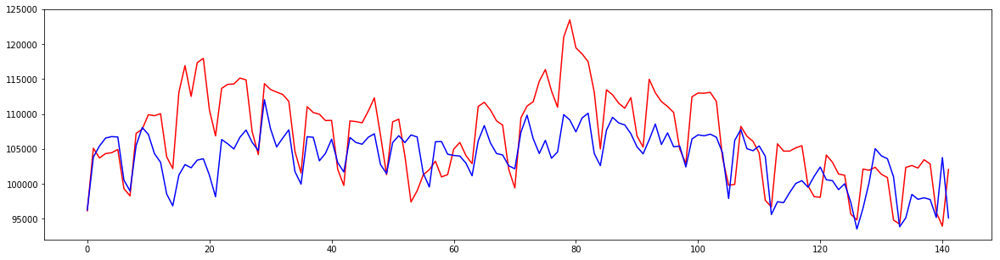

16 :  [0.13024378245383986, 0.062936840745001374, 0.030269970240592876, 0.041204646424025597]


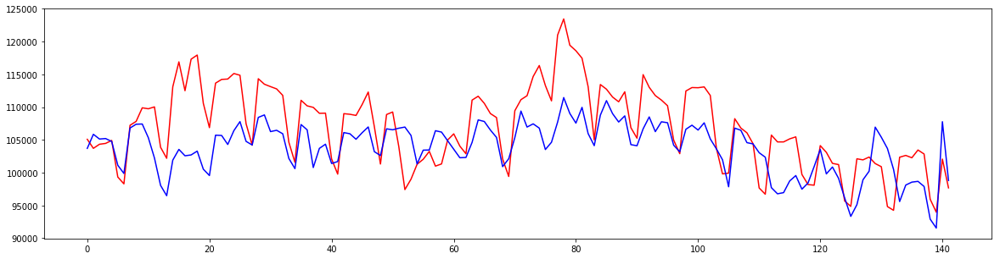

17 :  [0.12912230783753598, 0.061840588937295778, 0.029969956825173852, 0.040989577497445272]


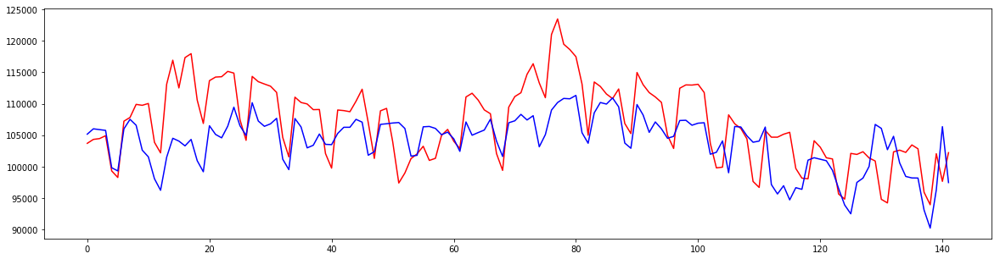

18 :  [0.13118136227689839, 0.059813496288307795, 0.031621642157512689, 0.04229652849960689]


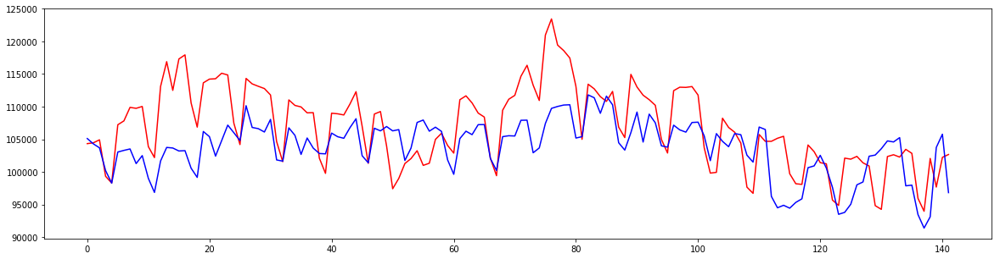

19 :  [0.13258819808461925, 0.060075197229716784, 0.03435275517693636, 0.043532441766044094]


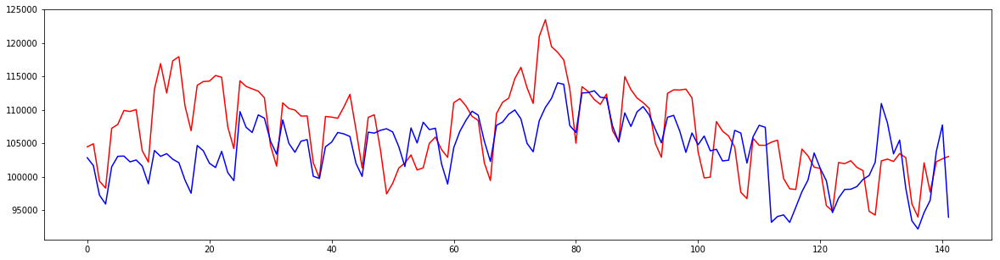

20 :  [0.1374335702375708, 0.056069438634769077, 0.034152959330815039, 0.043311755571857548]


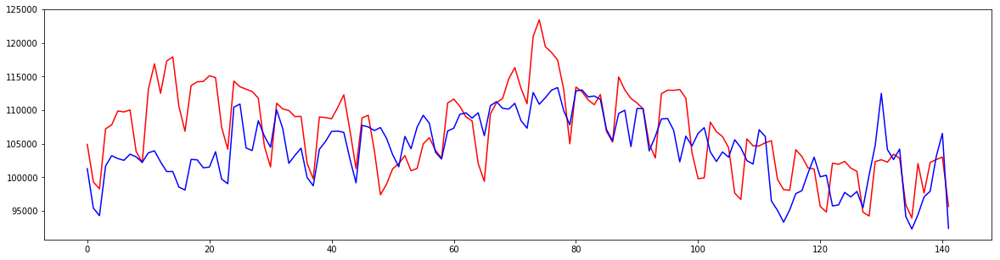

21 :  [0.14667229228114584, 0.05967500513583536, 0.035402492451583042, 0.041975257173318521]


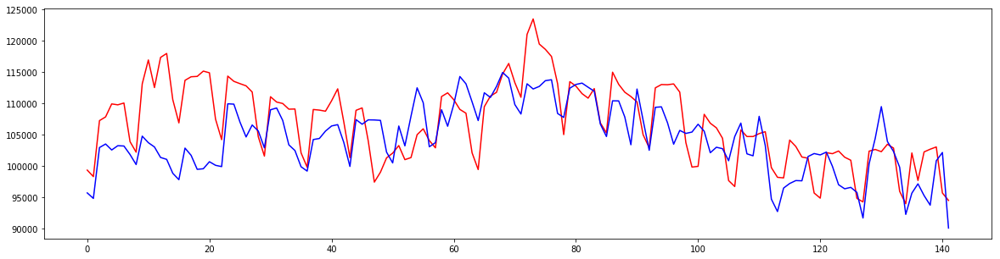

22 :  [0.14638238354366651, 0.067561123954051519, 0.034557532063050331, 0.042226138097676134]


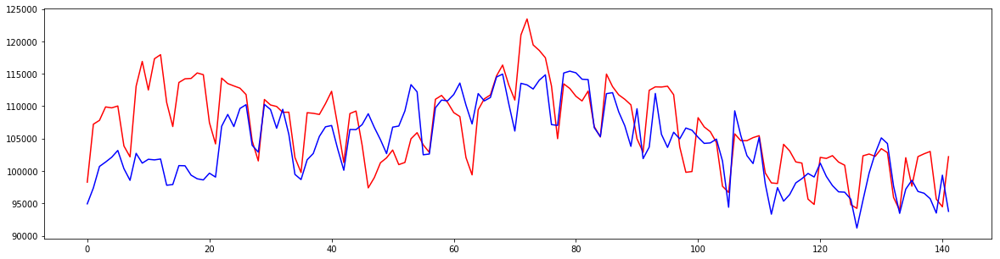

23 :  [0.14692913512220349, 0.064021765980289191, 0.033978670578951681, 0.042951559868427316]


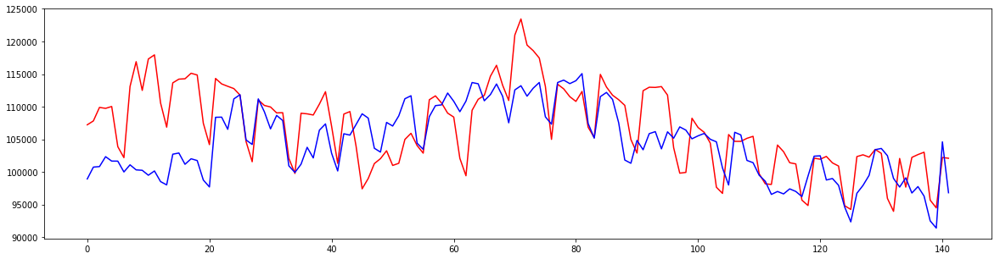

24 :  [0.14875309910807313, 0.063379483642968831, 0.033260789035581925, 0.04290481223641452]


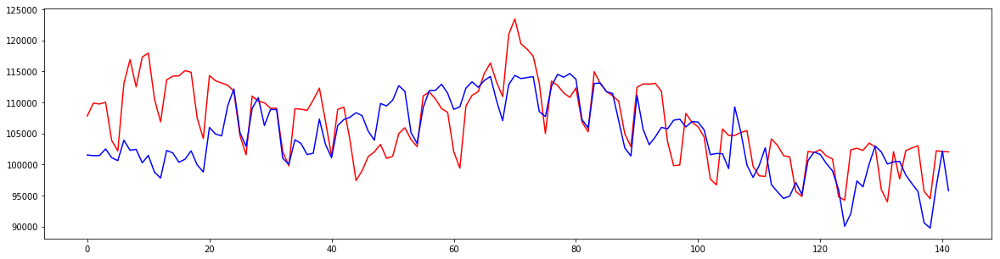

25 :  [0.14964161486882369, 0.069292493963753102, 0.034062808986364018, 0.043265337039072434]


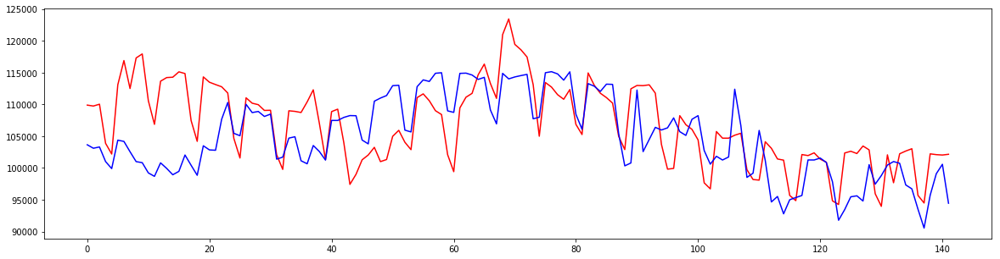

26 :  [0.15526508671561579, 0.065287009508367702, 0.035791912950194876, 0.046129501318219732]


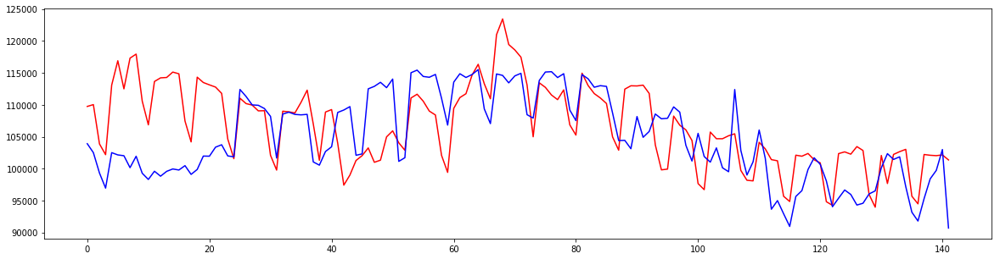

27 :  [0.15702947926465408, 0.059148605478337737, 0.036949425610864096, 0.047974990060327169]


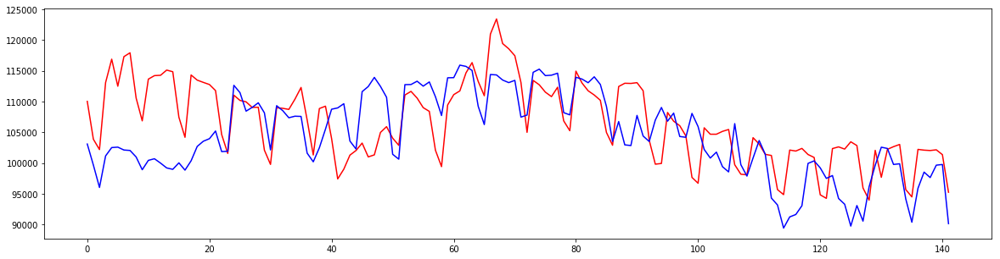

28 :  [0.16155174136552264, 0.059673828272574718, 0.040668957829744924, 0.04912748347367029]


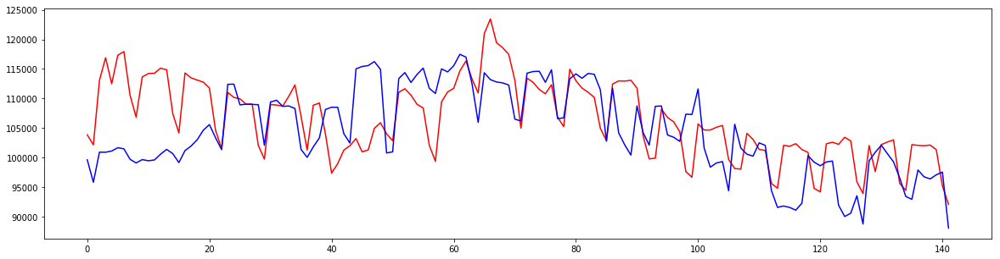

29 :  [0.16071372297191783, 0.060866679326141392, 0.041192605095823051, 0.05157723311944154]


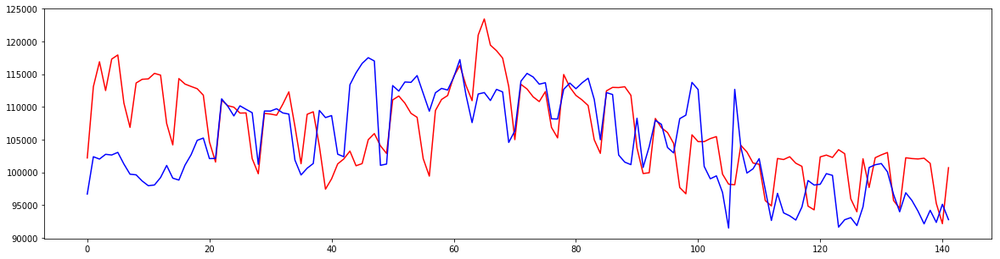

30 :  [0.15742408652326073, 0.056801440572445246, 0.042854675073400267, 0.051781472892713072]
----------------------------
ts id =  13


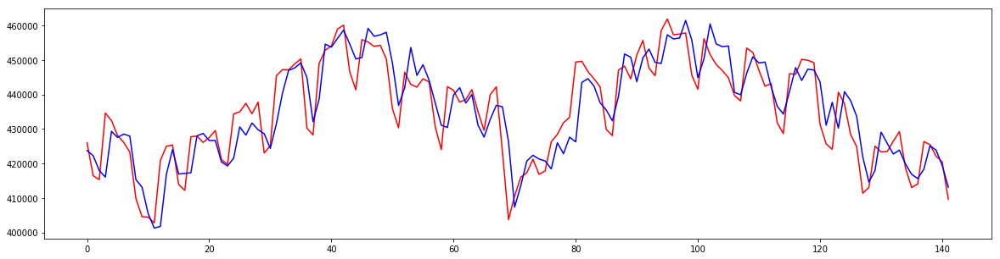

0 :  [0.05486330385027452, 0.035389266686237507, 0.0098297534831870686, 0.012256577644943614]


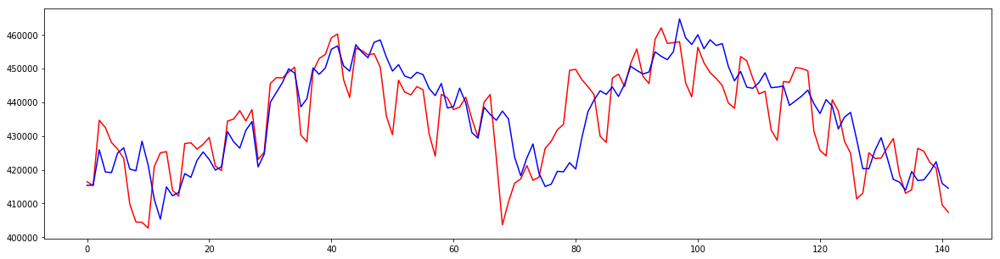

1 :  [0.05959832624249186, 0.038660739142922208, 0.014037385923203959, 0.016931220291958638]


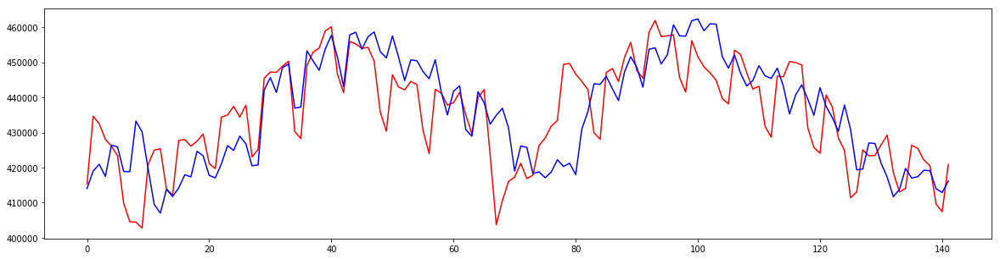

2 :  [0.063601342500823568, 0.041814654144107705, 0.015912070142909858, 0.018859657805210074]


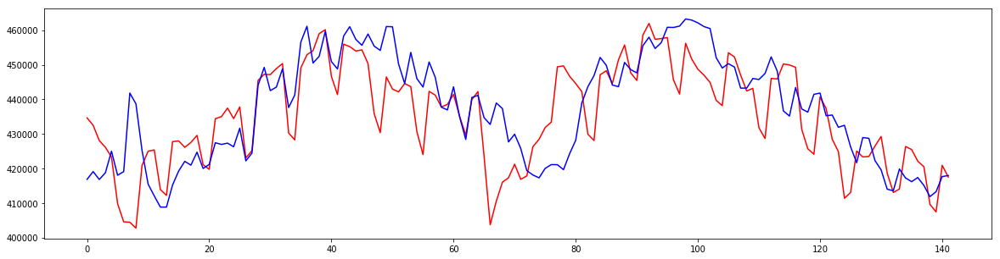

3 :  [0.066859540427325143, 0.044942784956232322, 0.017305643205400512, 0.019833038181008598]


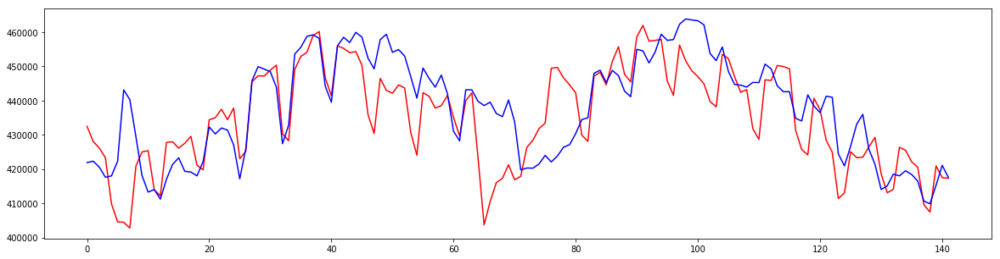

4 :  [0.067947626055213275, 0.046891666732372925, 0.017785967666569091, 0.018992504831355363]


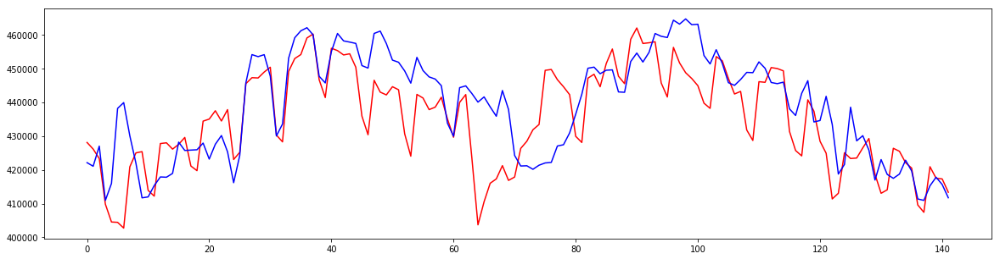

5 :  [0.072314755235374797, 0.043766264368880425, 0.02050422271435811, 0.020317953346744869]


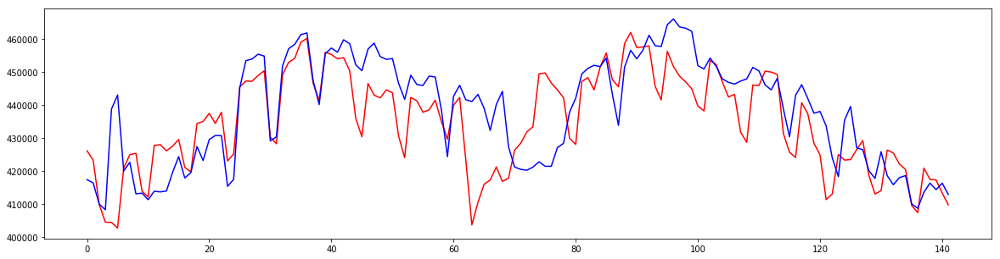

6 :  [0.088186194253180042, 0.04583467684462688, 0.019886527322999947, 0.020469269174458463]


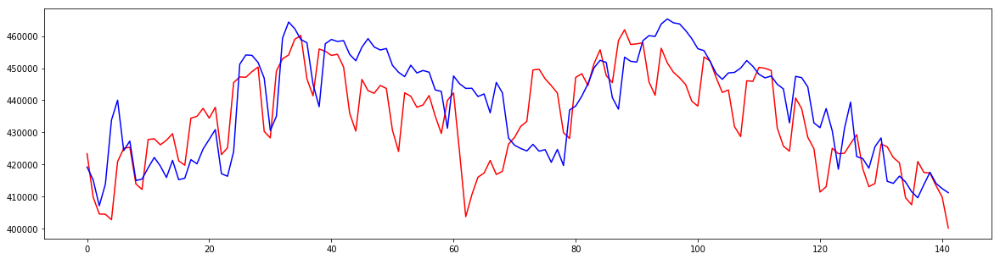

7 :  [0.096865432071935778, 0.045420858655147313, 0.025752470621985903, 0.023883973473417277]


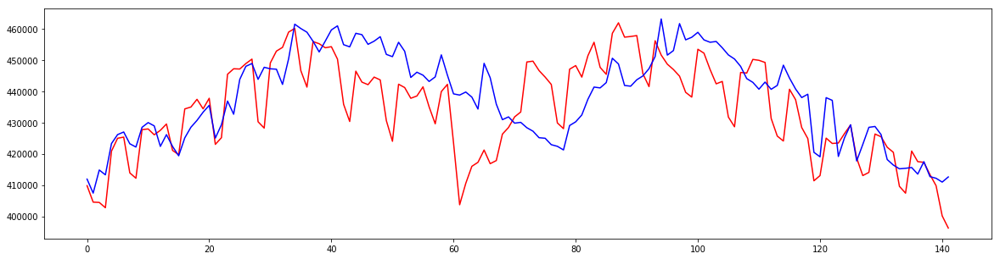

8 :  [0.10220218376164368, 0.043401144437991063, 0.024969474109575385, 0.022280723513764693]


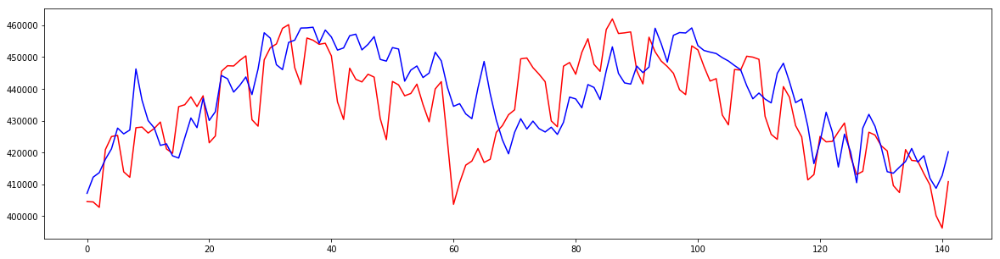

9 :  [0.10097407971078327, 0.038123120718461974, 0.021730593367892102, 0.021883247037619086]


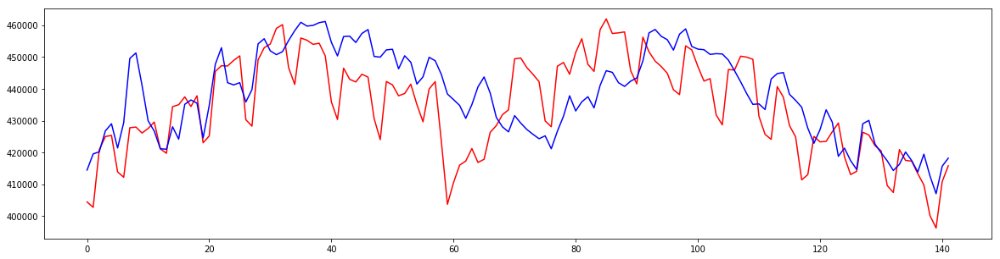

10 :  [0.10487749047943401, 0.038448113531082025, 0.02195846905980002, 0.022963380933980586]


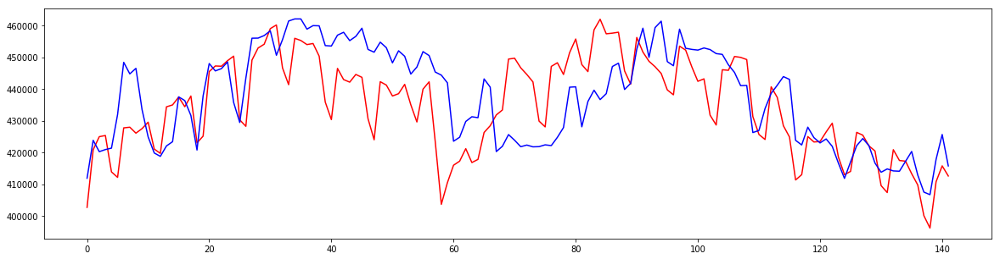

11 :  [0.10528852586035492, 0.047721482569933756, 0.026109324672086751, 0.023076066551381596]


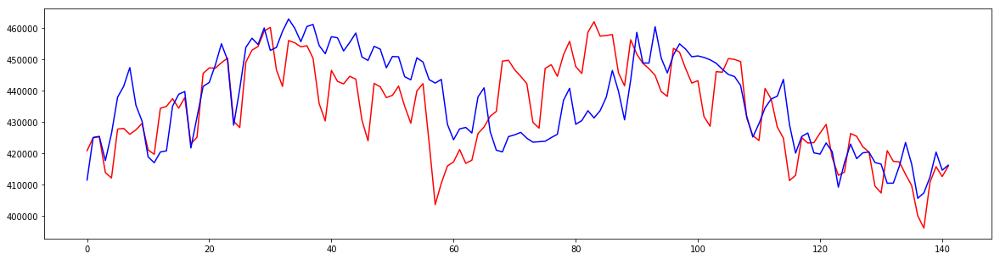

12 :  [0.10684239769725043, 0.059782615246726852, 0.025867681923214439, 0.021982651587175855]


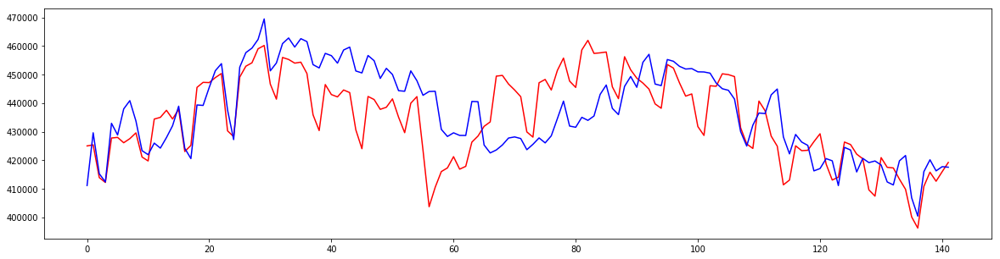

13 :  [0.11156016116451153, 0.059484107098104699, 0.026098518859355935, 0.021881164197441107]


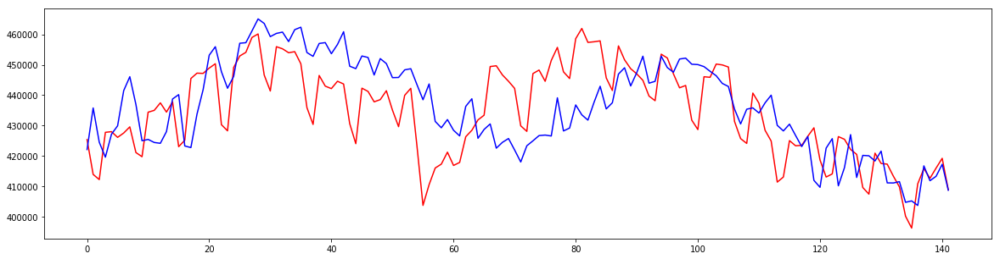

14 :  [0.11440639391366851, 0.064336808099981324, 0.029761065657657106, 0.024457137271229088]


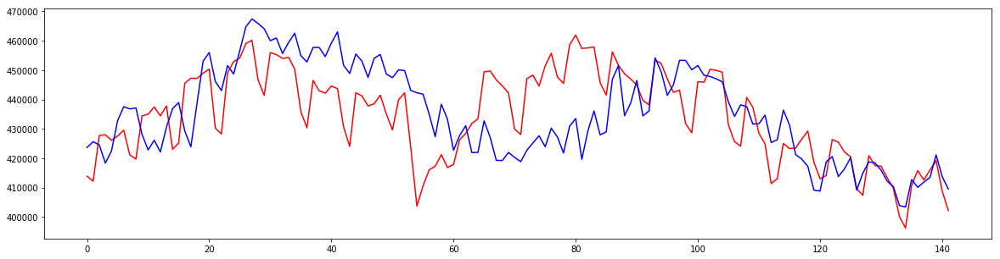

15 :  [0.11599489288288382, 0.065227824113475816, 0.030929164709555094, 0.025861538924444268]


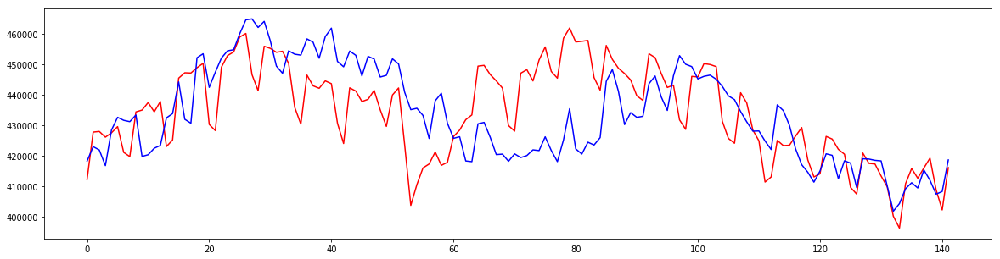

16 :  [0.11936061533667161, 0.062426507005258751, 0.033047267962822646, 0.025848382189999665]


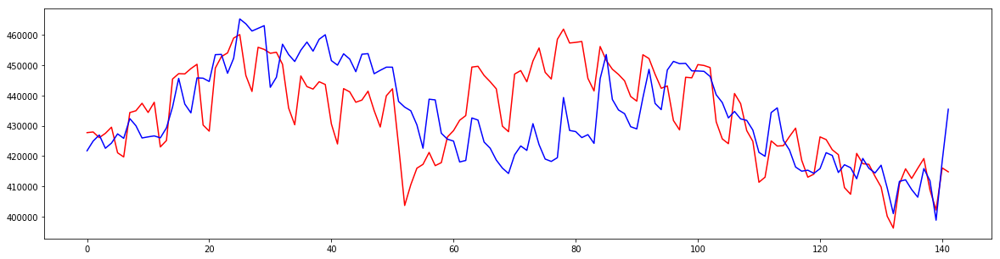

17 :  [0.12157168718267536, 0.071713362644486842, 0.034529132774144065, 0.025411823661325009]


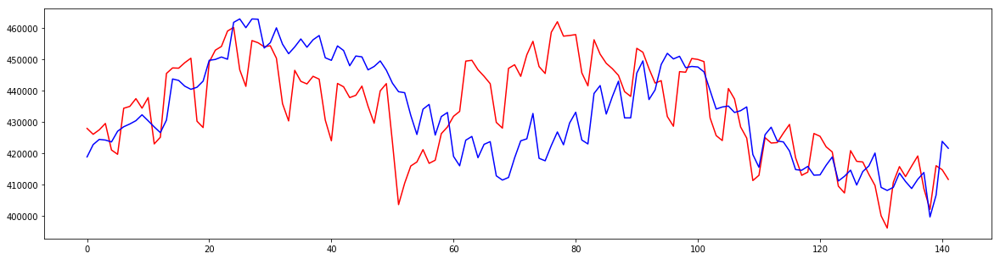

18 :  [0.12227875269400111, 0.076892483650365703, 0.034790250670997613, 0.025319213126160867]


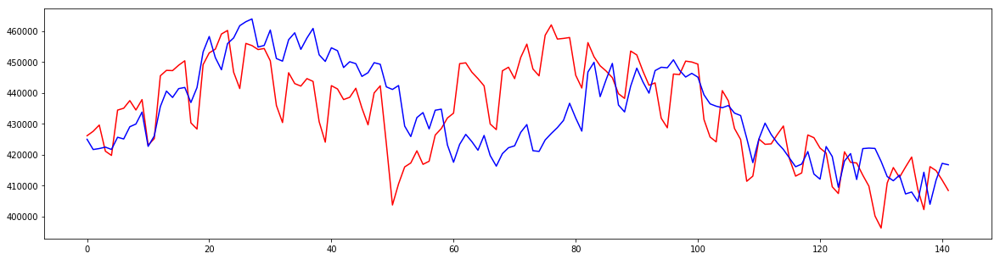

19 :  [0.12710740330382553, 0.079958791807653709, 0.03204820612127833, 0.02463135523648996]


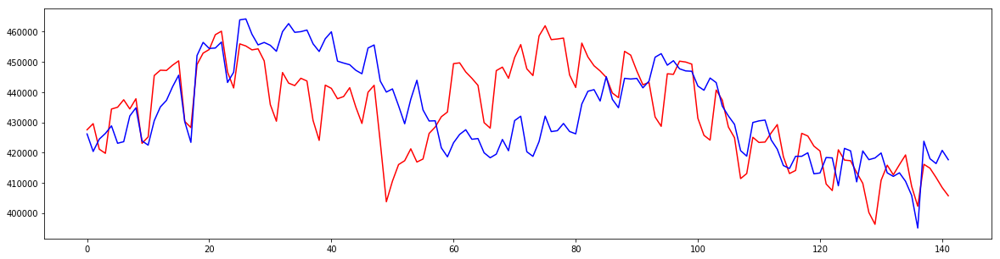

20 :  [0.13190051532176864, 0.075778719695181157, 0.032141125881221609, 0.02609957491412556]


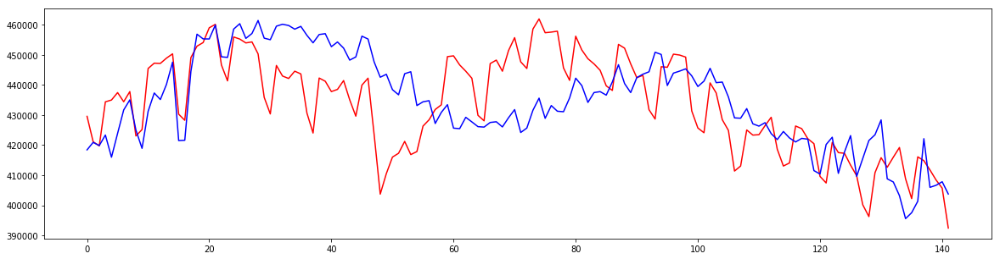

21 :  [0.13630951819207163, 0.074488638234240151, 0.03355611133312051, 0.026380057903615355]


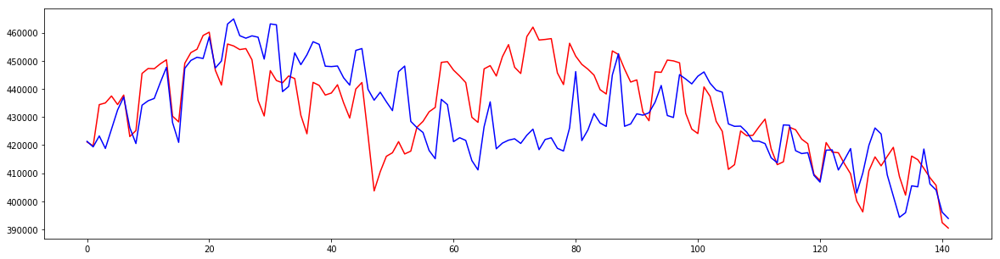

22 :  [0.13773195738305488, 0.073476545009636324, 0.035496015451164202, 0.027631950517053552]


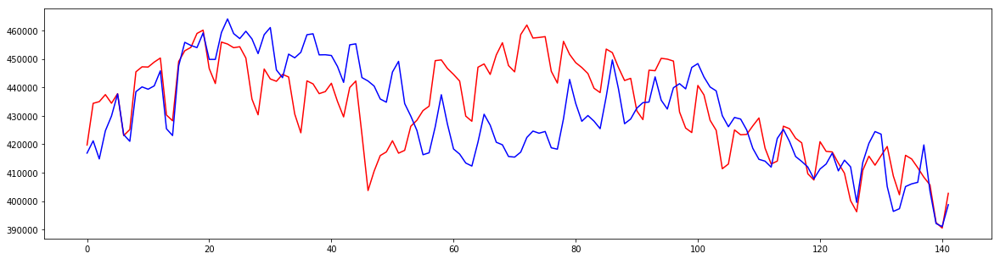

23 :  [0.14097905328037258, 0.070836252361908547, 0.038618684036304689, 0.028470425634653608]


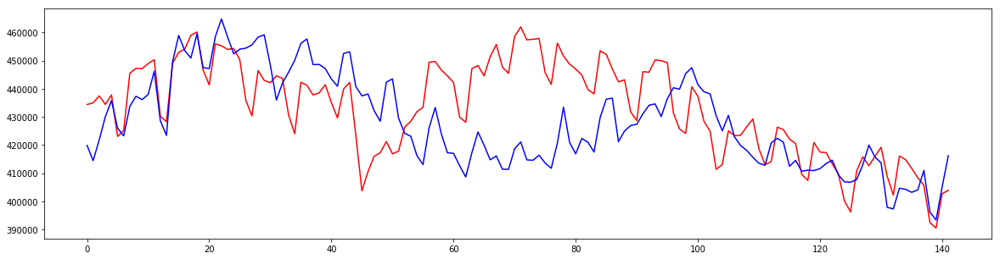

24 :  [0.1433687742453629, 0.069480258368450232, 0.03997651540232991, 0.030687759592024938]


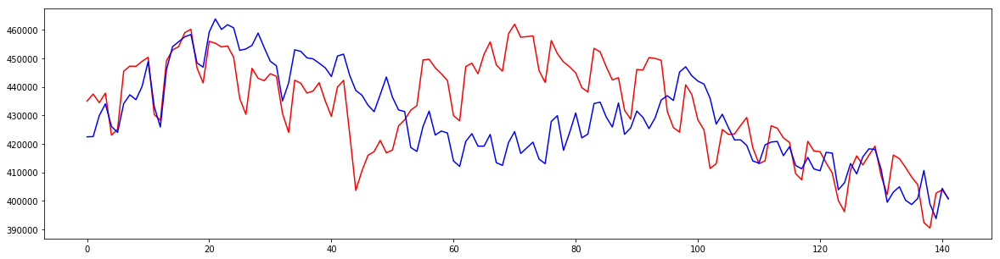

25 :  [0.13804263416174467, 0.066611643304218135, 0.040823372467421723, 0.029169389648174063]


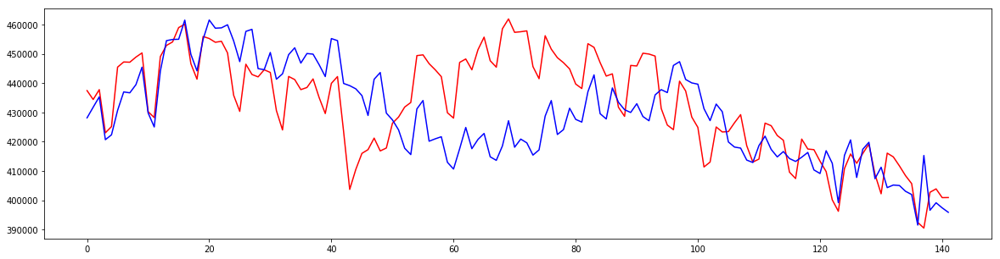

26 :  [0.13917744205346425, 0.068064380261364438, 0.036698400622557782, 0.028135839572659187]


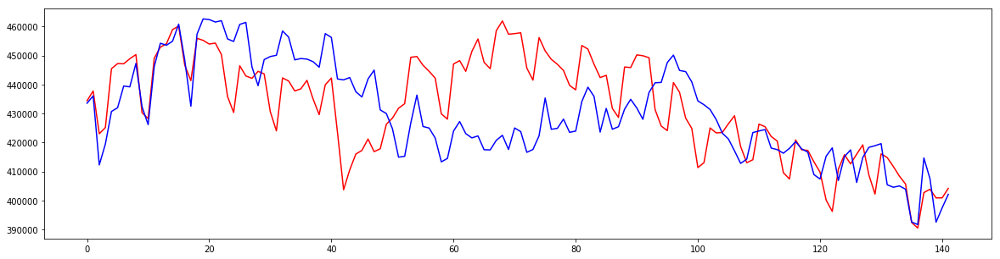

27 :  [0.15116842392726035, 0.068716368826567731, 0.035985347207951997, 0.029740508267203234]


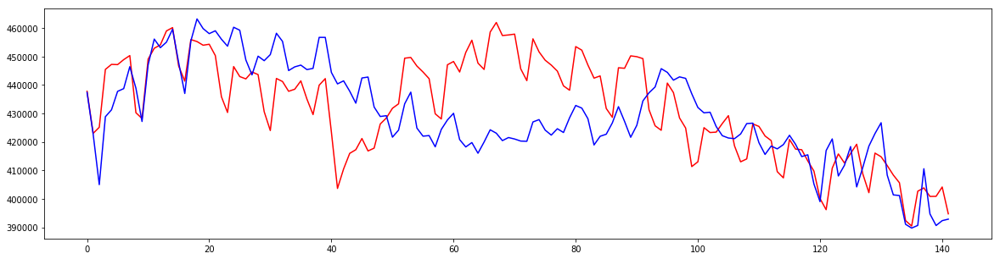

28 :  [0.1526766210982104, 0.06754242160737188, 0.039863700334636376, 0.029974802260174422]


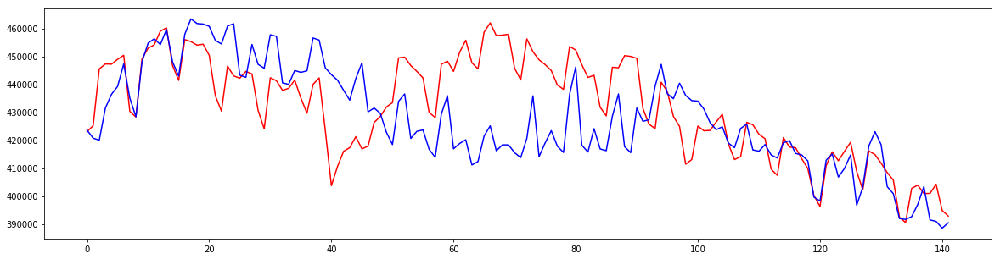

29 :  [0.15441396601393476, 0.069715044553547476, 0.041406153598449028, 0.029786837568173994]


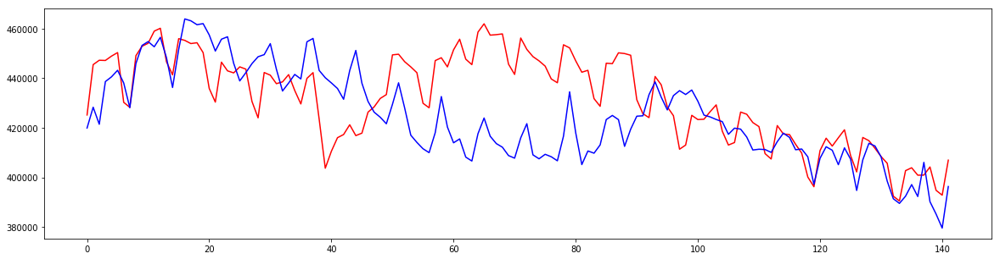

30 :  [0.15806863666817325, 0.071835872525046668, 0.040142694722463422, 0.03368726203383679]
----------------------------
ts id =  14


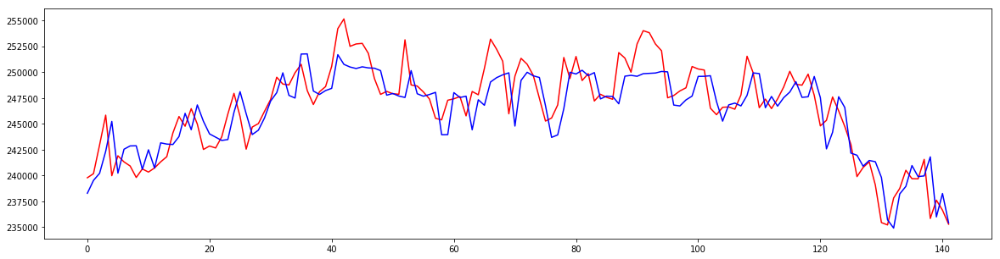

0 :  [0.058060889681713822, 0.013571928139413904, 0.0061125089695006508, 0.0071749645787928199]


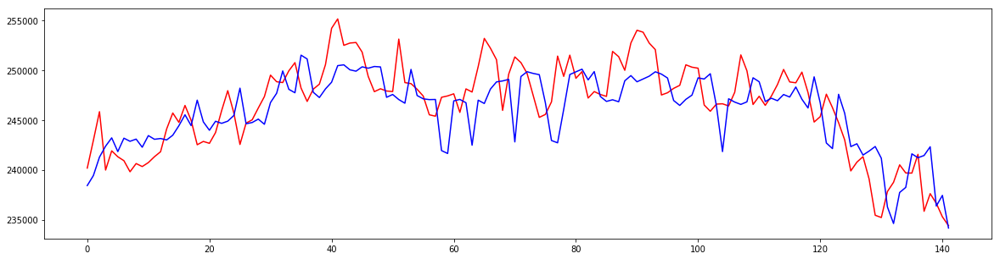

1 :  [0.066988013261235255, 0.015961685925498594, 0.0081672248354131421, 0.009832959289121472]


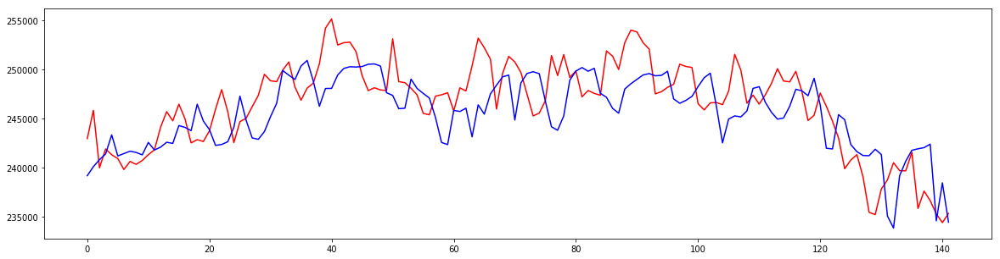

2 :  [0.071746859076369476, 0.018210369018455005, 0.0092700094162137363, 0.011362144406256849]


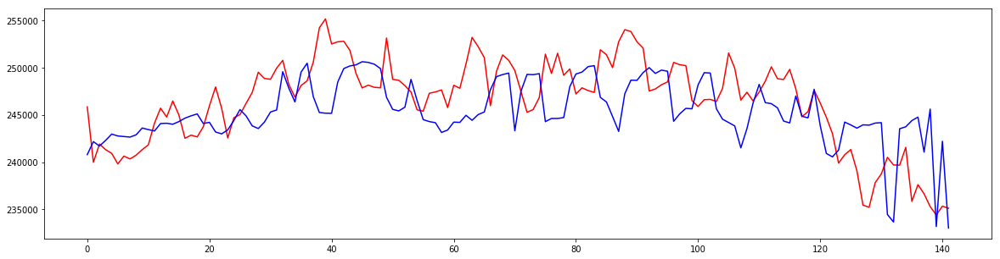

3 :  [0.074325680406408606, 0.018195677789941935, 0.010671021346532779, 0.013707681292715639]


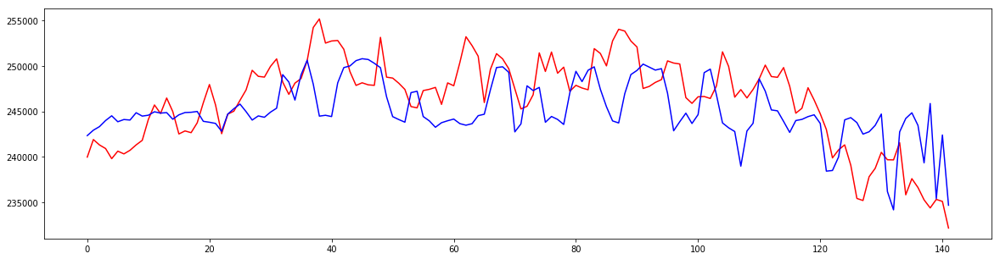

4 :  [0.078435082993834629, 0.017088760624877204, 0.011943867574420289, 0.014238807271549065]


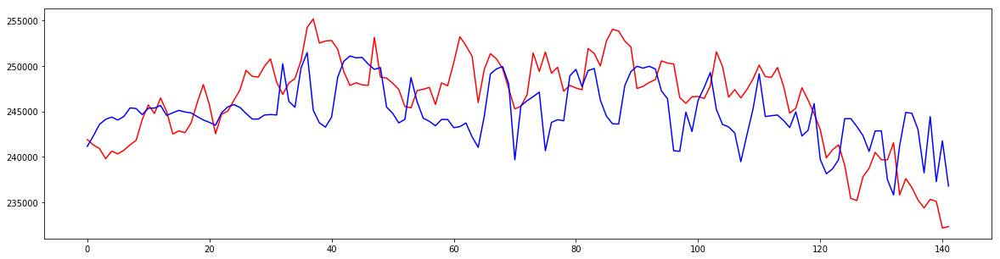

5 :  [0.082161145035695521, 0.019000899942161545, 0.013078856367240292, 0.015075901794694393]


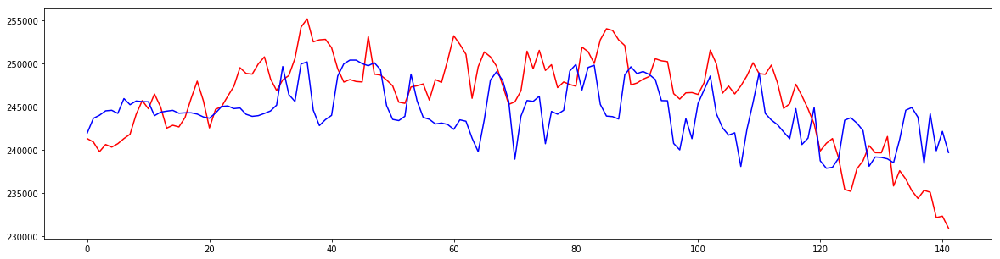

6 :  [0.086045916041739792, 0.020350061107571225, 0.014107276035695032, 0.016162470723567451]


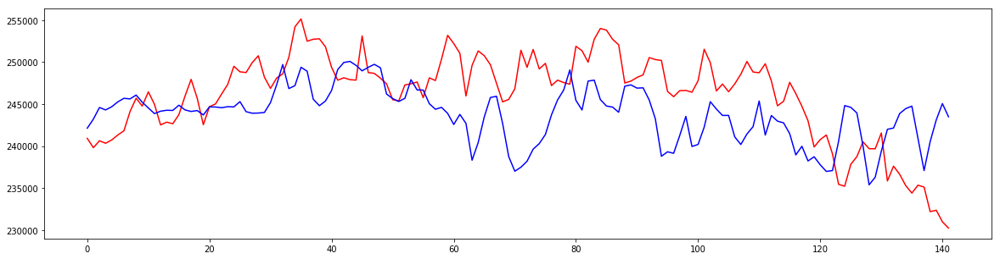

7 :  [0.087059148089471197, 0.020509478162967068, 0.015748350959551915, 0.018814945951279406]


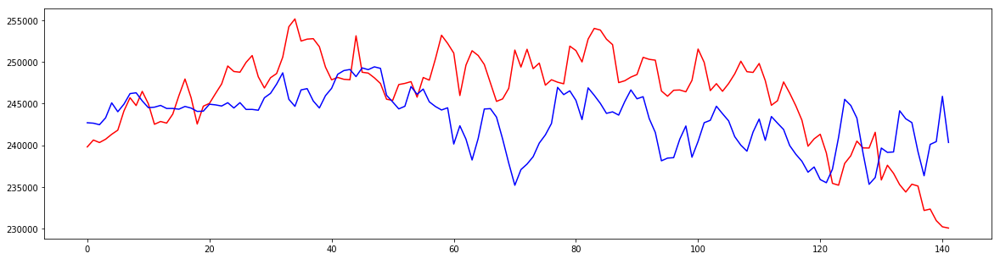

8 :  [0.090741334612828448, 0.021947430270907176, 0.016685536303581227, 0.019661017924918305]


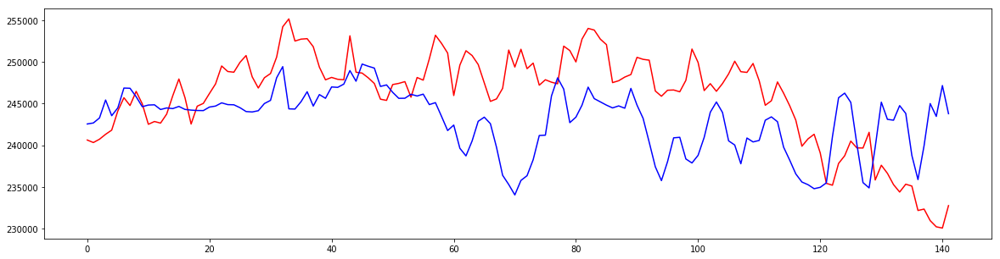

9 :  [0.093321562500850538, 0.024975142348576996, 0.018464400943103702, 0.02205110200339052]


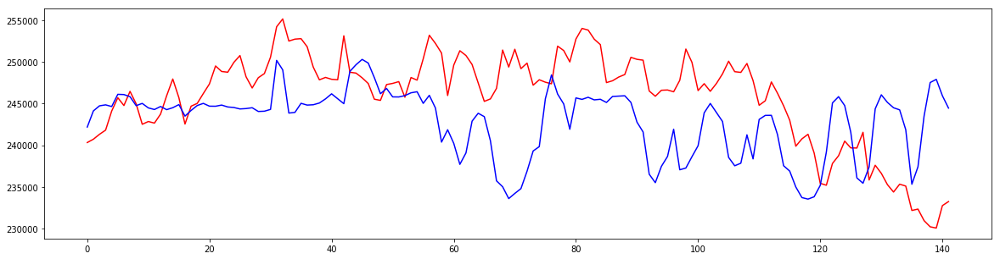

10 :  [0.09349504526175427, 0.026491640585577632, 0.019988094691407471, 0.023238314400170722]


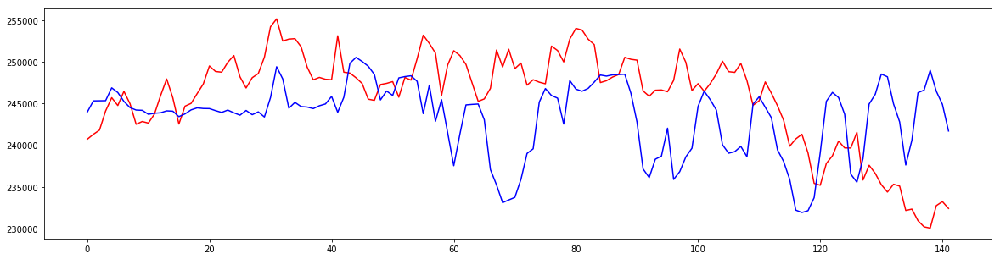

11 :  [0.094985237644855766, 0.021706399447337481, 0.020449220034353212, 0.023195262072939437]


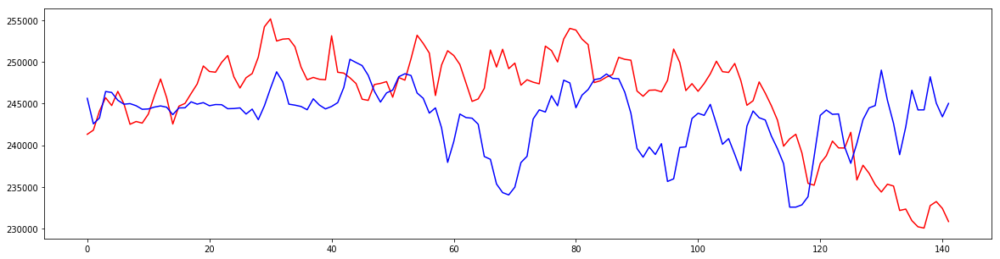

12 :  [0.097662423039857282, 0.02824412369076406, 0.022556462626930184, 0.022744152651971081]


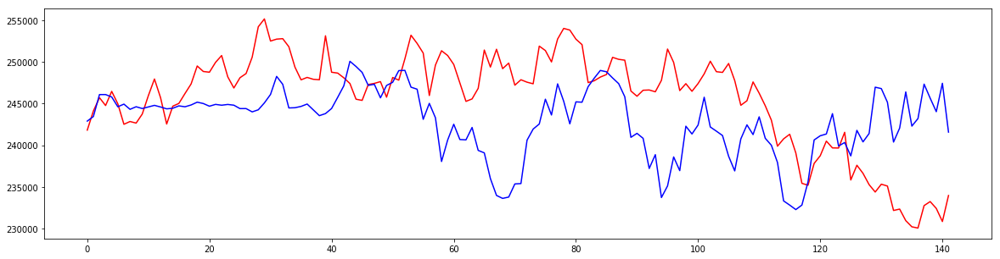

13 :  [0.098261056483787315, 0.030792334756948127, 0.02315138782829497, 0.023222585362308472]


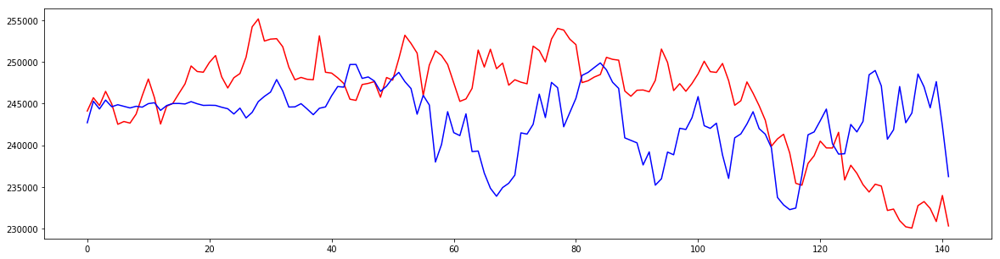

14 :  [0.099364474638554731, 0.031047072403208979, 0.023438708838345632, 0.023203965027667903]


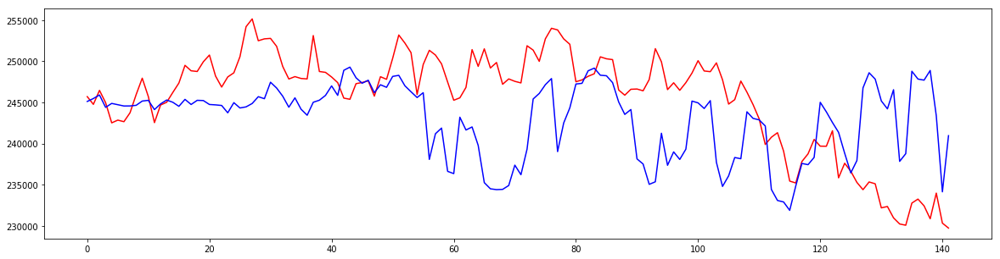

15 :  [0.10170275040183628, 0.037026117397032078, 0.025365006299206839, 0.023591855037784892]


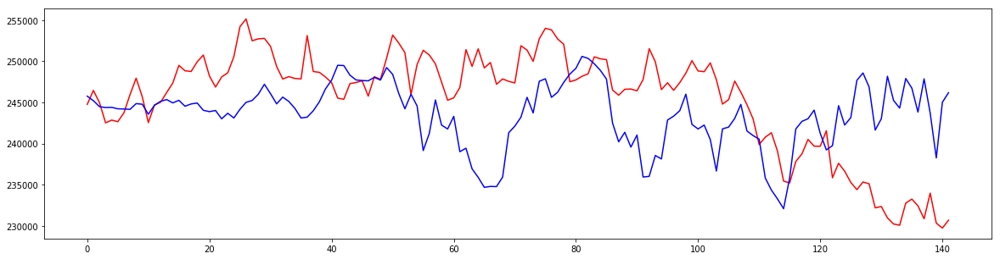

16 :  [0.1030078941232182, 0.037496014117830621, 0.026955290192831671, 0.02374769779721821]


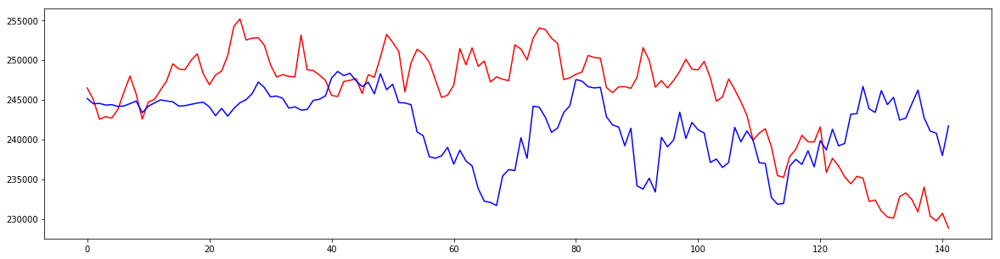

17 :  [0.10398013975316134, 0.038065337997862304, 0.028059222258501278, 0.026832085697391948]


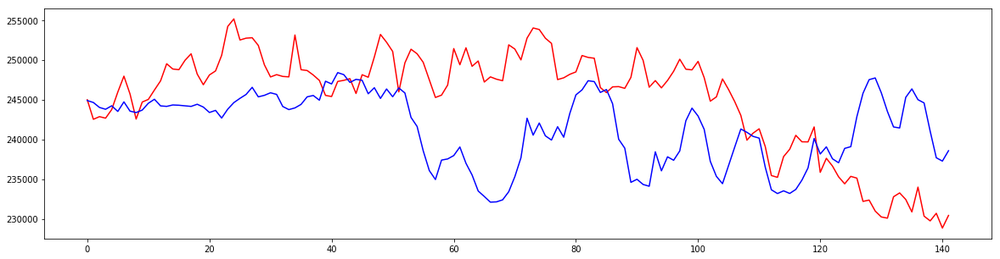

18 :  [0.10530996936533474, 0.039680166660253036, 0.029033037922342249, 0.027767827248281127]


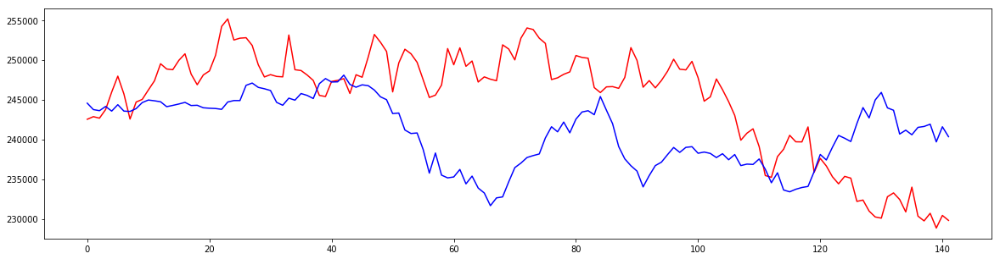

19 :  [0.10904319232122402, 0.040979082611499573, 0.032954120155225475, 0.02904842674957997]


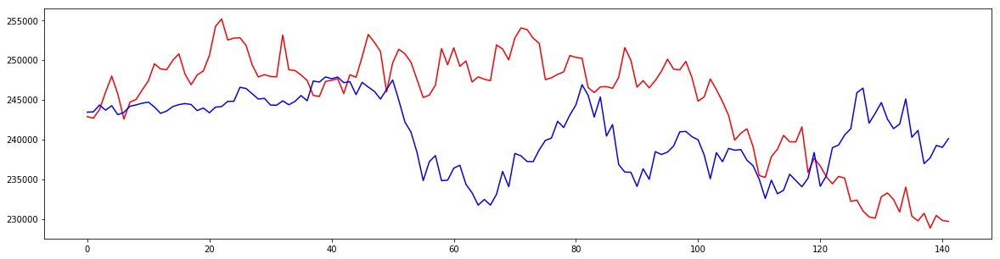

20 :  [0.10972983942131295, 0.034239983081147257, 0.035884398891854567, 0.028692091476803738]


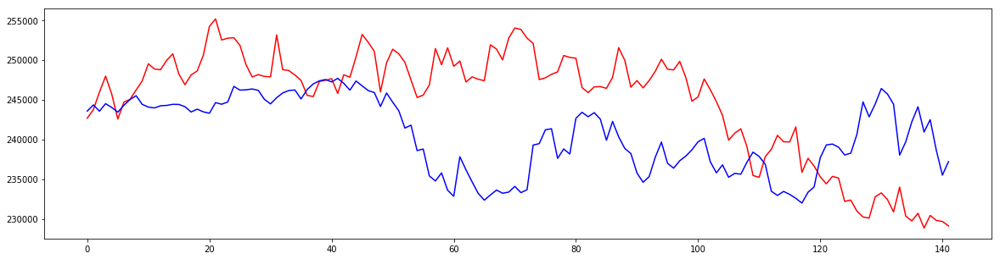

21 :  [0.10805280861262372, 0.03644328264811722, 0.038263209234285729, 0.029986090584663831]


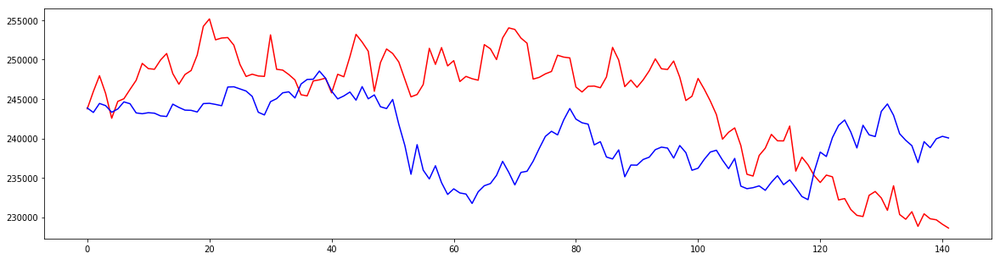

22 :  [0.11174198106933195, 0.04540224354735628, 0.039728413332274885, 0.030604724203970656]


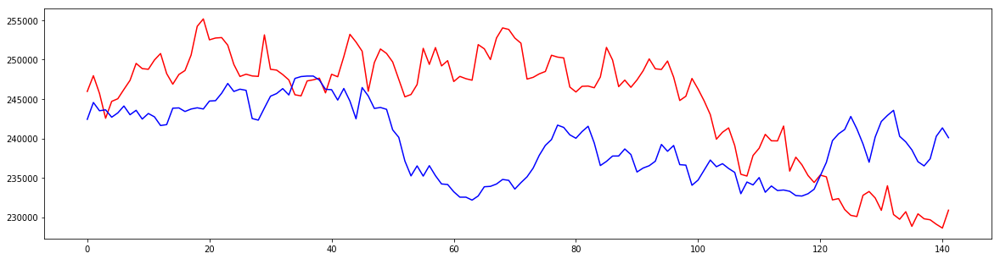

23 :  [0.11300742612816711, 0.044125508735278894, 0.0400708783035163, 0.03181762619139443]


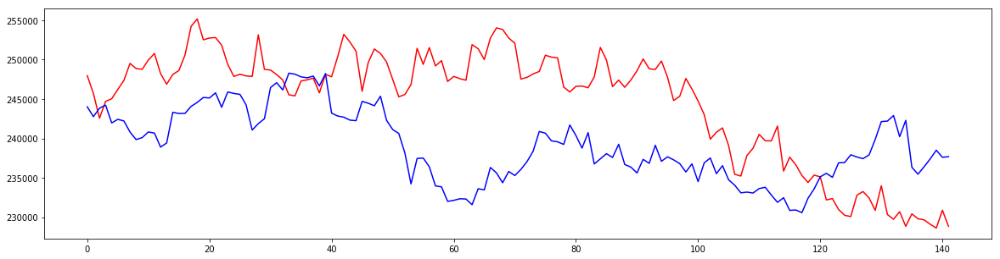

24 :  [0.11525061501910291, 0.046047292782794784, 0.043176231666843472, 0.032032345207483874]


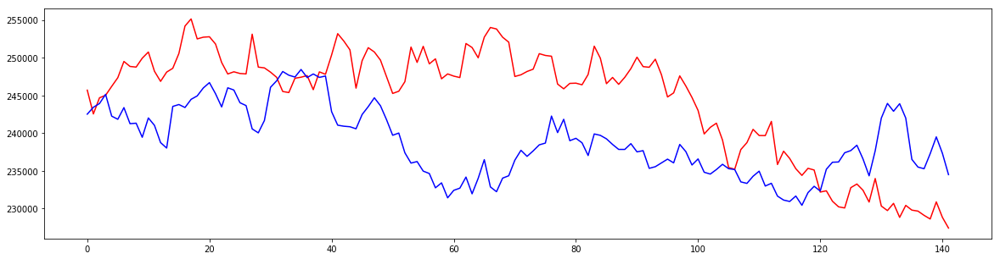

25 :  [0.1145460779181607, 0.04330727288889144, 0.045308098423552955, 0.03230643364782651]


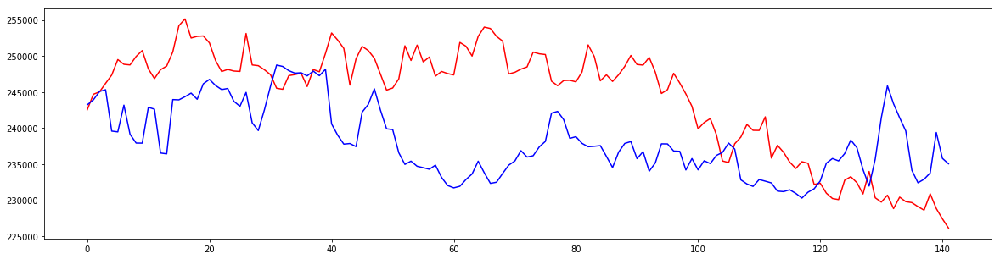

26 :  [0.11631609348567576, 0.042996856620928108, 0.045744153559122869, 0.033513542993643813]


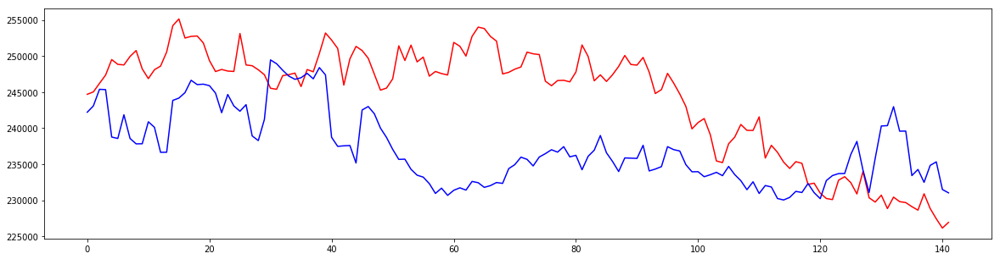

27 :  [0.11660338157459371, 0.044344582921053428, 0.048627677823091991, 0.035446273009184175]


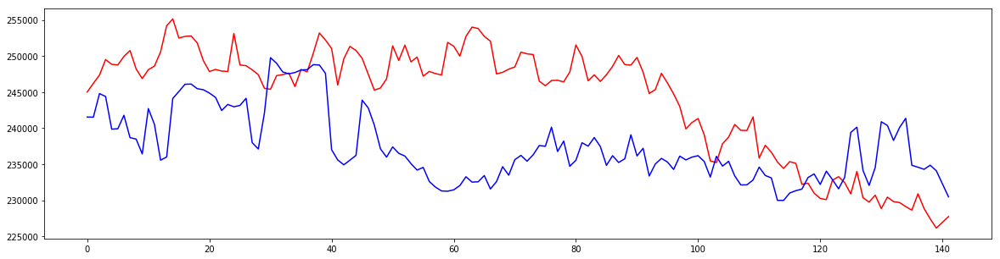

28 :  [0.1140905993236619, 0.049041033488156464, 0.050968523584434405, 0.034648960290353303]


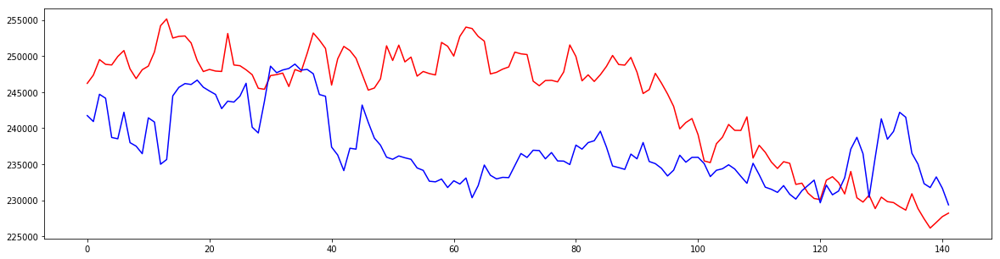

29 :  [0.11635953520070935, 0.047669111972625904, 0.049829723632360247, 0.034313191358554367]


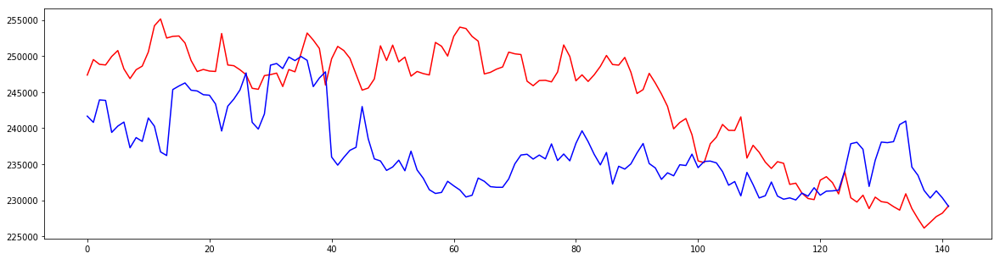

30 :  [0.11648365451917411, 0.049256829275117486, 0.049447290004172494, 0.034972657320522627]


In [259]:
models = [RandomForestRegressor(n_estimators=60, criterion='mse', n_jobs=10) for i in range(31)]
for i in range(15):
    check_ts(models, i)

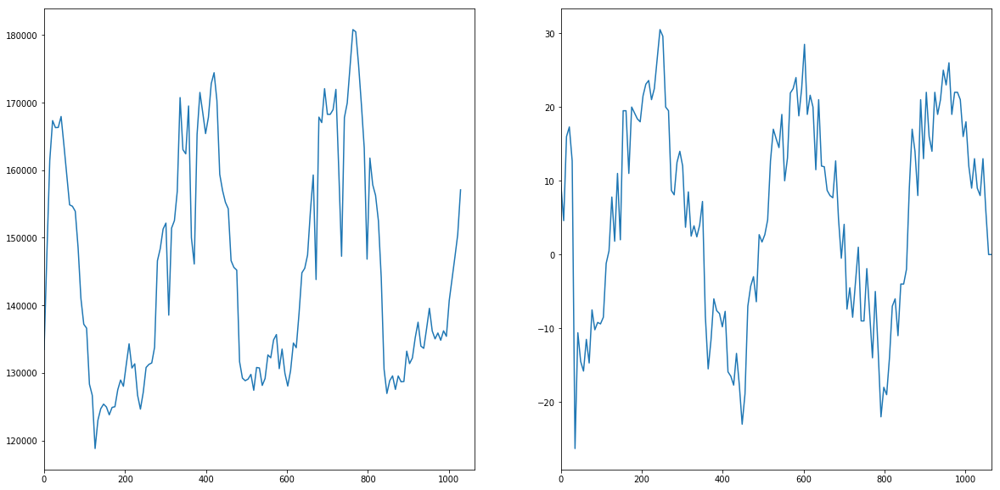

In [255]:
plot_ts(ts_data[5])

## Cоздание данных для предсказания

In [48]:
def generate_last_feachures(data):
    factors = data.copy(deep=True)
#     factors['Date'] = pd.to_datetime(factors['Date'], format='%d.%m.%Y').astype(int)
#     factors['Date'] -= factors['Date'].min()
#     factors['Date'] /= factors['Date'].max()
    factors['Delta'] = np.zeros(len(factors.index))
#     factors['TodayTemp'] = factors['Temp']
#     factors['TodaySaturday'] = factors['Saturday']
#     factors['TodaySunday'] = factors['Sunday']
    factors.drop(labels=['tsID', 'ID', 'Date'], inplace=True, axis=1)
    factors = factors[NUMBER_OF_PREV_DAYS:]
    for i in range(1, NUMBER_OF_PREV_DAYS):
        factors['Day' + str(i)] = np.roll(np.array(factors['ACTUAL']), i)
    factors.drop(labels=['ACTUAL'], inplace=True, axis=1)
    factors = factors.fillna(0)
    return factors.iloc[-30]

def fit_models(data):
    # models = [CatBoostRegressor(depth=7) for i in range(30)]
    # models = [LinearRegression(n_jobs=10) for i in range(30)]
    models = [RandomForestRegressor(n_estimators=60, criterion='mse', n_jobs=10) for i in range(30)]
    # models = [RandomForestRegressor(n_estimators=60, criterion='mse', n_jobs=10) for i in range(30)]
    factors, targets = create_factors_targets(data)
    for i in range(1, len(factors)):
        models[i - 1].fit(factors[i], targets[i], sample_weight=(1+np.arange(len(factors[i])))**1.1)
        print(i - 1, end=' ')
    return models

def count_actual(models, data):
    last_feachures = generate_last_feachures(data)
    # display(last_feachures)
    predicted = pd.DataFrame(columns=['ID', 'PREDICTED'])
    predicted['ID'] = data.iloc[-30:]['ID']
    # display(predicted)
    predicted['PREDICTED'] = np.array([model.predict(np.array(last_feachures).reshape(1, -1)) for model in models])
    return predicted

In [49]:
final_forecast = pd.DataFrame(columns=['ID', 'PREDICTED'])
for i in range(len(ts_data)):
    print('\n', i, 'is counting      ', end='')
    if len(ts_data[i])> 0:
        print('model fitting: ', end='')
        models = fit_models(ts_data[i])
        final_forecast = final_forecast.append(count_actual(models, ts_data[i]))
display(final_forecast)


 0 is counting      
 1 is counting      model fitting: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 
 2 is counting      model fitting: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 
 3 is counting      model fitting: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 
 4 is counting      model fitting: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 
 5 is counting      model fitting: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 
 6 is counting      model fitting: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 
 7 is counting      model fitting: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 
 8 is counting      model fitting: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 
 9 is counting      model fitting: 0 1 2 3 4 5 6 7

,ID,PREDICTED
1035,16707,105751.616667
1036,16708,99095.816667
1037,16709,99235.016667
1038,16710,109643.650000
1039,16711,109231.300000
1040,16712,110491.516667
1041,16713,108292.516667
1042,16714,108958.583333
1043,16715,101707.883333
1044,16716,100907.316667


In [50]:
# save forecast to disk for further submission
final_forecast = final_forecast.astype(int)
final_forecast.to_csv('result.csv', index=False)

In [288]:
models[30].is_fitted_

False